## Shaft model for PDF shaping (656 samples)

This uses the new object oriented class for PDF shaping

This model uses the CFD Shaft data with 656 samples

## Web application 6 inputs and 6 outputs

Run interactively on the web at:

## Inputs

(1, 'i_pul_coal_inj_kg_thm')

(2, 'i_nat_gas_inj_kg_thm')

(3, 'i_nat_gas_t_k')

(4, 'i_o2_vol_perce')

(9, 'i_ore_moisture_weight_perce')

(11, 'i_ore_weight_kg')

## Outputs

(20, 'o_shaft_h2_utiliz')

(21, 'o_shaft_top_gas_temp_c')

(22, 'o_shaft_press_drop_pa')

(23, 'o_shaft_coke_rate_kg_thm')

(25, 'o_shaft_co_v_perc')

(26, 'o_shaft_co2_v_perc')



In [1]:

import torch
import numpy as np
import pandas as pd
import sklearn
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import math
import seaborn as sns
import random
import functorch

from numpy.random import normal
from scipy.stats import norm
import scipy.stats as stats
from numpy import hstack
from numpy import vstack
from numpy import exp
from sklearn.neighbors import KernelDensity

##from typing import Optional

from torch import Tensor


from torch.utils.data import TensorDataset, DataLoader

from mlxtend.plotting import heatmap

## coefficient of determination (R**2)
from sklearn.metrics import r2_score

np.set_printoptions(suppress=True)
torch.set_printoptions(sci_mode=False)


In [2]:
import PDFshapingUtils as PDF_tk

In [3]:
PDFshapingOBJ = PDF_tk.PDFshapingUtils()

In [4]:

PDFshapingOBJ.std_impulse = 1.5

PDFshapingOBJ.initializeImpulseGaussian()

print(PDFshapingOBJ.x_range_impulse_func )
print(PDFshapingOBJ.impulse_func_vector_vals )
print(PDFshapingOBJ.x_range_impulse_func.shape )
print(PDFshapingOBJ.impulse_func_vector_vals.shape )
 
print( sum(PDFshapingOBJ.impulse_func_vector_vals) )      ## should add up to 100 (i.e. 1.0 prob density)

tensor([-20.0000, -19.9900, -19.9800,  ...,  19.9700,  19.9800,  19.9900])
tensor([0., 0., 0.,  ..., 0., 0., 0.])
torch.Size([4000])
torch.Size([4000])
tensor(99.9999)


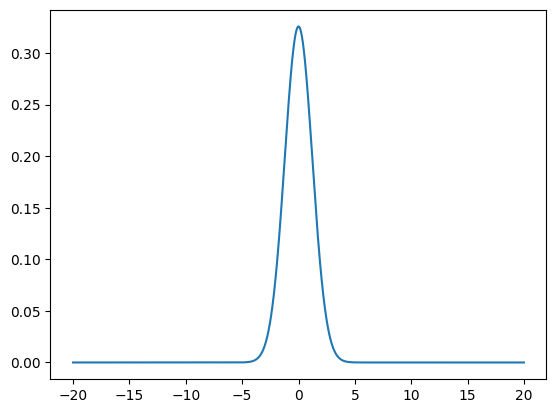

In [5]:
plt.plot(PDFshapingOBJ.x_range_impulse_func, PDFshapingOBJ.impulse_func_vector_vals)
plt.show()

torch.Size([400, 5])


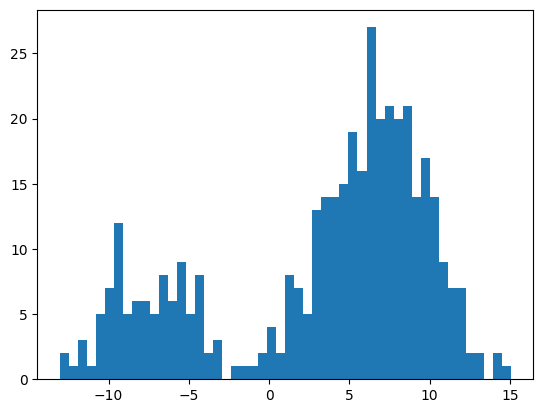

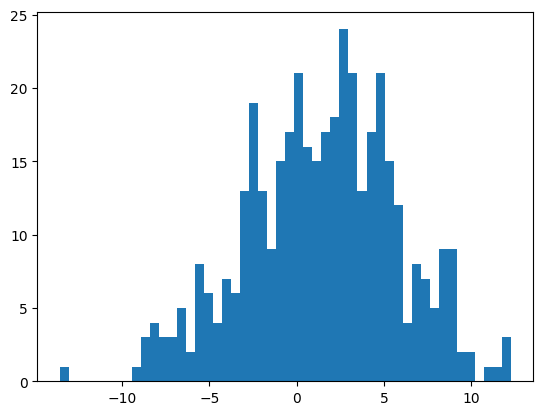

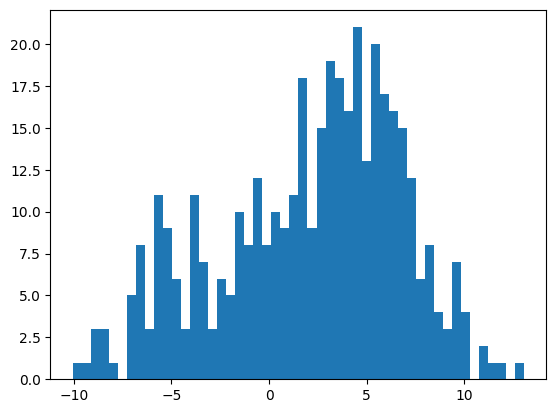

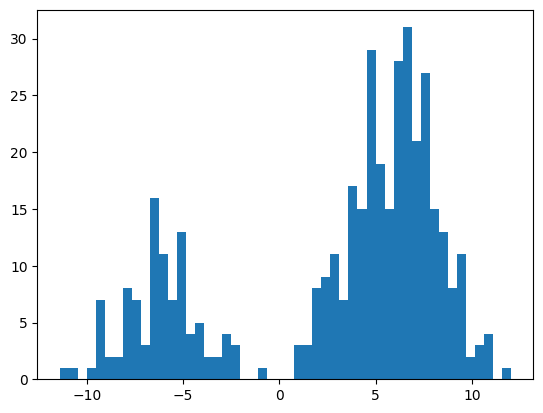

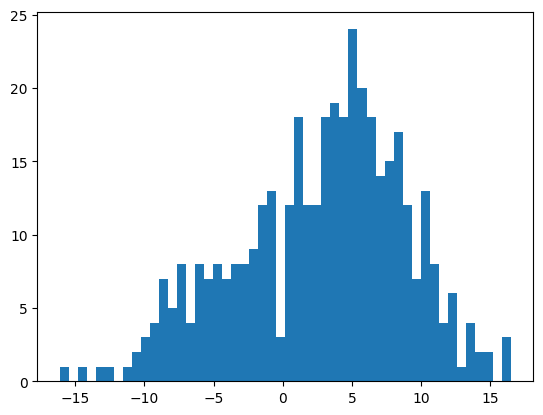

torch.Size([400, 5])
tensor([[ 12.9256,  -4.2652,   2.0591,   5.2018,   5.4249],
        [  8.2075,  -0.8777,   2.9062,   7.3648,   0.5099],
        [ 11.8756,   4.4437,   1.6288,   6.0859,   6.5688],
        ...,
        [ -7.0345,  -7.2616, -10.0482,  -4.7424,  -3.5200],
        [ -7.6740,  -6.6463,  -5.8510,  -5.1636,   4.5565],
        [-11.5586,  -2.7382,  -3.7775,  -6.6989,   1.2611]],
       dtype=torch.float64)
5
0
torch.Size([400])
1
torch.Size([400])
2
torch.Size([400])
3
torch.Size([400])
4
torch.Size([400])
torch.Size([4000, 5])


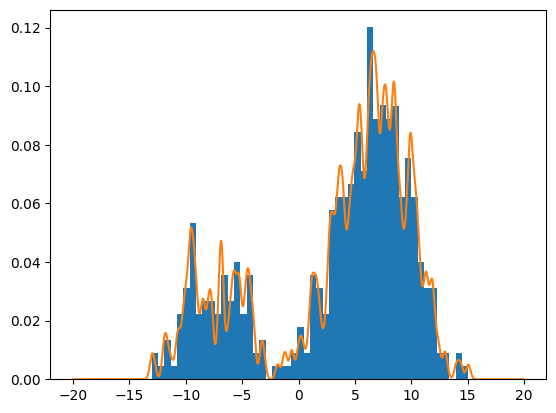

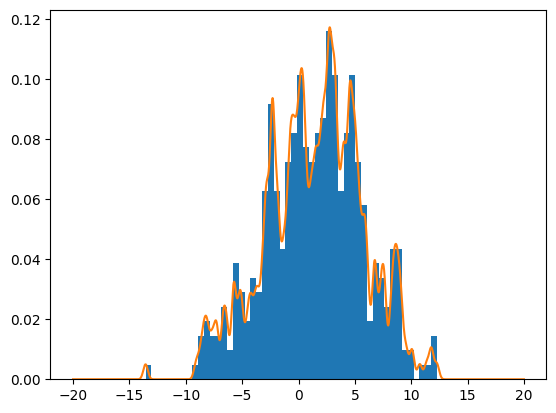

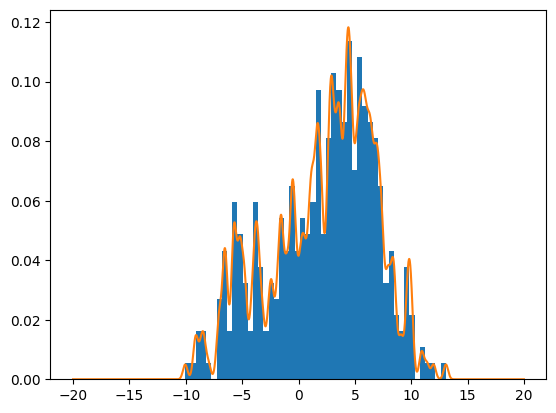

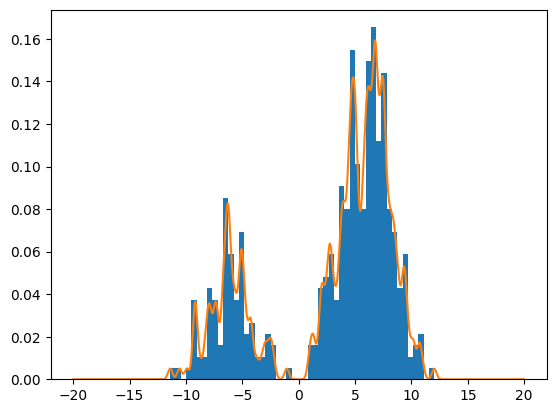

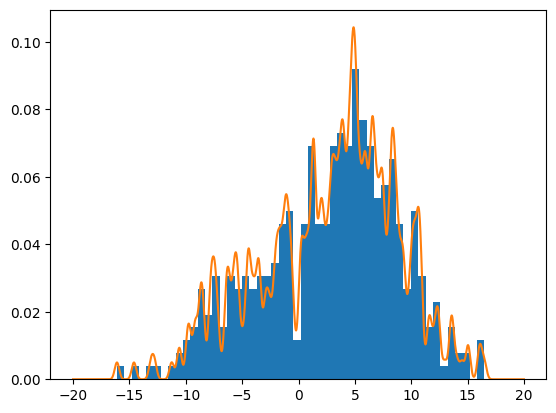

tensor(100.0000, dtype=torch.float64)
tensor(100.0000, dtype=torch.float64)
tensor(100.0000, dtype=torch.float64)
tensor(100.0000, dtype=torch.float64)
tensor(100.0000, dtype=torch.float64)


In [6]:
PDFshapingOBJ.test_torchKDE_with_fake_data()

In [7]:
PDFshapingOBJ.read_csv_file_with_pandas('CFD.10.2022.csv')

In [8]:
PDFshapingOBJ.CFD_raw_data

,index,i_pul_coal_inj_kg_thm,i_nat_gas_inj_kg_thm,i_nat_gas_t_k,i_o2_vol_perce,i_bf_windrate_nm3_hr,i_hb_moist_g_nm3,i_hot_blast_press_pa,i_hot_blast_temp_k,i_ore_moisture_weight_perce,...,o_shaft_co_utiliz,o_shaft_h2_utiliz,o_shaft_top_gas_temp_c,o_shaft_press_drop_pa,o_shaft_coke_rate_kg_thm,o_shaft_cohesive_zone_tip_height_m,o_shaft_co_v_perc,o_shaft_co2_v_perc,o_shaft_h2_v_perce,o_shaft_n2_v_perc
0,1,0,37.9,300,21,308750.365,12.154,359906.3,1459.817,7,...,47.20085,42.99392,118.8785,108434.33,462.73655,31.83963,0.217192,0.194163,0.043833,0.544812
1,2,0,37.9,300,24,308750.365,12.154,359906.3,1459.817,7,...,49.15851,44.99764,95.7563,108381.02,480.82105,31.83963,0.226098,0.218613,0.040343,0.514946
2,3,0,37.9,300,27,308750.365,12.154,359906.3,1459.817,7,...,49.30602,44.48147,84.8519,112232.83,500.10050,31.75963,0.241959,0.235334,0.037726,0.484981
3,4,0,37.9,300,30,308750.365,12.154,359906.3,1459.817,7,...,47.22992,46.37194,66.3779,118634.40,521.58650,31.55962,0.267702,0.239597,0.035448,0.457252
4,5,0,70.0,300,21,308750.365,12.154,359906.3,1459.817,7,...,46.66340,41.83302,130.4139,106947.64,422.57185,31.75963,0.211014,0.184613,0.071127,0.533246
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
651,652,0,120.0,500,30,308750.365,12.154,359906.3,1459.817,9,...,47.41156,42.97594,74.4270,126346.30,431.25740,31.67963,0.245133,0.221001,0.092536,0.441330
652,653,0,150.0,400,24,308750.365,12.154,359906.3,1459.817,9,...,46.31040,39.61361,117.9872,165428.30,363.68950,25.67391,0.213303,0.183986,0.128155,0.474555
653,654,0,150.0,400,30,308750.365,12.154,359906.3,1459.817,9,...,48.11906,41.08141,87.3410,146633.70,405.76215,31.60023,0.234814,0.217787,0.113598,0.433801
654,655,0,150.0,500,24,308750.365,12.154,359906.3,1459.817,9,...,46.78804,39.49208,115.3140,160121.70,360.38705,25.75400,0.212202,0.186584,0.126846,0.474368


In [9]:
PDFshapingOBJ.print_headers_list()

['index', 'i_pul_coal_inj_kg_thm', 'i_nat_gas_inj_kg_thm', 'i_nat_gas_t_k', 'i_o2_vol_perce', 'i_bf_windrate_nm3_hr', 'i_hb_moist_g_nm3', 'i_hot_blast_press_pa', 'i_hot_blast_temp_k', 'i_ore_moisture_weight_perce', 'i_coke_weight_kg', 'i_ore_weight_kg', 'o_production_rate_thmperday', 'o_tuyere_exit_velo_m_s', 'o_tuyere_t_k', 'o_raceway_flame_temp_k', 'o_raceway_coal_burn_perce', 'o_raceway_volume_m', 'o_raceway_depth_m', 'o_shaft_co_utiliz', 'o_shaft_h2_utiliz', 'o_shaft_top_gas_temp_c', 'o_shaft_press_drop_pa', 'o_shaft_coke_rate_kg_thm', 'o_shaft_cohesive_zone_tip_height_m', 'o_shaft_co_v_perc', 'o_shaft_co2_v_perc', 'o_shaft_h2_v_perce', 'o_shaft_n2_v_perc']
29
(0, 'index')
(1, 'i_pul_coal_inj_kg_thm')
(2, 'i_nat_gas_inj_kg_thm')
(3, 'i_nat_gas_t_k')
(4, 'i_o2_vol_perce')
(5, 'i_bf_windrate_nm3_hr')
(6, 'i_hb_moist_g_nm3')
(7, 'i_hot_blast_press_pa')
(8, 'i_hot_blast_temp_k')
(9, 'i_ore_moisture_weight_perce')
(10, 'i_coke_weight_kg')
(11, 'i_ore_weight_kg')
(12, 'o_production_rate_

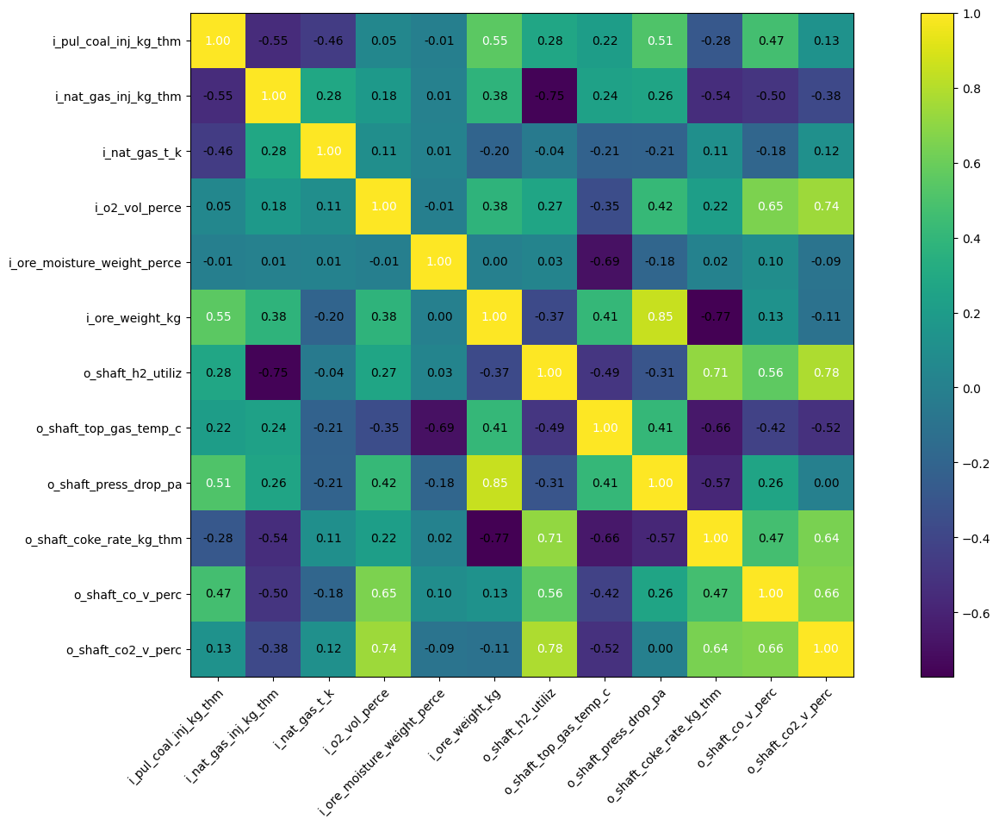

In [10]:

PDFshapingOBJ.list_of_selected_column_names = ['i_pul_coal_inj_kg_thm','i_nat_gas_inj_kg_thm',
            'i_nat_gas_t_k','i_o2_vol_perce', 'i_ore_moisture_weight_perce', 'i_ore_weight_kg', 
            'o_shaft_h2_utiliz', 'o_shaft_top_gas_temp_c', 'o_shaft_press_drop_pa', 
            'o_shaft_coke_rate_kg_thm', 'o_shaft_co_v_perc', 'o_shaft_co2_v_perc']

PDFshapingOBJ.print_correlation_coefficients()


In [11]:

PDFshapingOBJ.convert_pd_data_to_numpy()


[[  1.           0.          37.9        ...   0.1941631    0.0438327
    0.5448123 ]
 [  2.           0.          37.9        ...   0.2186134    0.04034286
    0.5149459 ]
 [  3.           0.          37.9        ...   0.2353341    0.03772617
    0.4849808 ]
 ...
 [654.           0.         150.         ...   0.2177873    0.1135979
    0.4338012 ]
 [655.           0.         150.         ...   0.1865845    0.1268458
    0.4743676 ]
 [656.           0.         150.         ...   0.2246319    0.1110198
    0.4373359 ]]
(656, 29)


In [12]:
PDFshapingOBJ.gen_X_y_for_selected_indeces(  
                   inputs=[1, 2, 3, 4, 9, 11] , 
                   outputs=[20, 21, 22, 23, 25, 26]   
)

6
6


In [13]:
print(PDFshapingOBJ.X.shape)
print(PDFshapingOBJ.y.shape)

(656, 6)
(656, 6)


In [14]:
PDFshapingOBJ.random_seed = int( random.random() * 100  )         ## defautl is 42

In [15]:
PDFshapingOBJ.split_np_data_train_test(selected_test_size=0.3)

(459, 6)
(197, 6)
(459, 6)
(197, 6)


In [16]:
PDFshapingOBJ.convert_dataset_from_np_to_torch()

In [17]:
PDFshapingOBJ.standardize_X_scales()
PDFshapingOBJ.standardize_y_scales()

In [18]:
PDFshapingOBJ.gen_Dataloader_train()

PDFshapingOBJ.train_dl

## NN architectures

In [19]:

#######################################################
## Linear Regression

class LinRegNet_SIO(nn.Module):
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        self.linear1 = nn.Linear(6, 6) 
        
        ## nn.init.xavier_uniform_(self.linear1.weight)
        ## nn.init.zeros_(self.linear1.bias)

    ## perform inference
    def forward(self, x):
        x = (x - self.x_means) / self.x_deviations
        
        y_scaled = self.linear1(x)
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled

    
#############################################################
## Multi-Layer Perceptron

class MLP_Net_SIO(nn.Module):
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        self.linear1 = nn.Linear(6, 10)
        self.act1    = nn.Sigmoid()                       ## Tanh() 
        self.linear2 = nn.Linear(10, 6)
        self.dropout = nn.Dropout(0.25)
        
        ## nn.init.xavier_uniform_(self.linear1.weight)
        ## nn.init.zeros_(self.linear1.bias)
        
        ## nn.init.xavier_uniform_(self.linear2.weight)
        ## nn.init.zeros_(self.linear2.bias)
    
    ## perform inference
    def forward(self, x):
        x = (x - self.x_means) / self.x_deviations
        x = self.linear1(x)
        x = self.act1(x)
        x = self.dropout(x)
        
        y_scaled = self.linear2(x)
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled
    

#############################################################
## Deep Learning model with 2 hidden layers


class DL_Net_SIO(nn.Module):
    
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        self.linear1 = nn.Linear(6, 10)
        self.act1    = nn.Sigmoid()                       ## Tanh() 
        self.linear2 = nn.Linear(10, 6)
        self.act2    = nn.Sigmoid() 
        self.linear3 = nn.Linear(6, 6)
        self.dropout = nn.Dropout(0.25)
        
        ## nn.init.xavier_uniform_(self.linear1.weight)
        ## nn.init.zeros_(self.linear1.bias)
        
        ## nn.init.xavier_uniform_(self.linear2.weight)
        ## nn.init.zeros_(self.linear2.bias)
        
        ## nn.init.xavier_uniform_(self.linear3.weight)
        ## nn.init.zeros_(self.linear3.bias)
    
    ## perform inference
    def forward(self, x):
        
        x = (x - self.x_means) / self.x_deviations
        x = self.linear1(x)
        x = self.act1(x)
        x = self.dropout(x)
        x = self.linear2(x)
        x = self.act2(x)
        x = self.dropout(x)
        
        y_scaled = self.linear3(x)
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled

      
#############################################################


In [20]:

#############################################################
##   F1      plus       F2
## Linear     +      Nonlinear

class F1plusF2_SIO(nn.Module):
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        ## F1
        self.f1_linear1 = nn.Linear(6, 6)       
        
        ## F2
        self.f2_linear1 = nn.Linear(6, 10)
        self.f2_act1    = nn.Sigmoid()                    ## Tanh()                       
        self.f2_linear2 = nn.Linear(10, 6)       
        self.f2_dropout = nn.Dropout(0.25)
        
        
    ## perform inference
    def forward(self, x):
        x = (x - self.x_means) / self.x_deviations
        
        ## F1
        f1 = self.f1_linear1(x)
        
        ## F2
        f2 = self.f2_linear1(x)
        f2 = self.f2_act1(f2)
        f2 = self.f2_dropout(f2)
        f2 = self.f2_linear2(f2)
        
        
        y_scaled   = f1 + f2
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled
    


## VERY BASIC CLASS 

In [21]:

class VeryBasicMLP_Removed_Best_Practices(nn.Module):
    
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        self.linear1 = nn.Linear(6, 20)
        self.act1    = nn.Sigmoid()                       ## Tanh() 
        self.linear2 = nn.Linear(20, 6)
        
        nn.init.zeros_(self.linear1.weight)   ## intitializing to all ones to see PDF shaping effect, remove
        nn.init.zeros_(self.linear1.bias) 

        nn.init.zeros_(self.linear2.weight) 
        nn.init.zeros_(self.linear2.bias) 
        
    
    ## perform inference
    def forward(self, x):
        x = (x - self.x_means) / self.x_deviations
        
        x = self.linear1(x)
        x = self.act1(x)
        
        y_scaled = self.linear2(x)
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled
    

## Sigma weighing scheme

In [22]:

class SigmaNN(nn.Module):
    ## initialize the layers
    def __init__(self):
        super().__init__()
        
     
        self.linear1 = nn.Linear(4000, 2000)
        self.act1    = nn.GELU()        ## nn.Tanh()                 ## Sigmoid()                      
        self.linear2 = nn.Linear(2000, 1000)     
        self.act2    = nn.GELU()        ## nn.Tanh()                ## Sigmoid()  
        self.linear3 = nn.Linear(1000, 4000)  
        self.act3    = nn.Sigmoid()
        self.dropout = nn.Dropout(0.50)
        
        
    ## perform inference
    def forward(self, x):
     
    
        f = self.linear1(x)
        f = self.act1(f)
        f = self.dropout(f)
        f = self.linear2(f)
        f = self.act2(f)
        f = self.dropout(f)
        f = self.linear3(f)
        f = self.act3(f)
        
        return f
    


In [23]:

def my_loss_UNKNOWN_error_PDF(epoch, output, target):
    error = output.float() - target.float()                            ## 400 X 5
    impulseFunc = ImpulseGaussian(x, mean_impulse, std_impulse**2)        ## 4000 X 1
    basisFunc = train_multiple_kernels_per_output(x, error, bandwidth)    ## 4000 x 5
    
    if epoch % 50 == 0:
        print_errors_kdes(error, x, basisFunc)
        print(impulseFunc.shape)
        print(basisFunc.shape)
    
    basisFunc = basisFunc.T
    diff = ( basisFunc.float() -  impulseFunc.float()  )                 ## 4000 x 5
    loss = torch.mean(   (   diff  )**2    )   
    ## reg_sigma_func = (loss ** 2) * use_regularization
    ## loss = loss * ( 1.0 + reg_sigma_func )
    return loss


In [24]:

def my_loss_known_is_gauss(output, target):
       
    error = output.float() - target.float() 
    basisFunc   =  kernel_density(x, error, h)
    diff = ( basisFunc.float() -  impulseFunc.float()  )        
    loss = torch.mean(   (   diff  )**2    )    ## / h
    return loss



## Results for g(x) = Basic MLP with No PDF shaping

F1 = Linear

F2 = Nonlinear


In [ ]:
def fit_y_scaled(num_epochs, model, loss_fn, opt):
    
    PDFshapingOBJ.list_metric = []
    for epoch in range(num_epochs):
        for xb, yb in PDFshapingOBJ.train_dl:
            pred_descaled, pred_scaled = model(xb)
            loss = loss_fn(pred_scaled, yb)
            loss.backward()
            opt.step()
            opt.zero_grad()
        
        if epoch % 200 == 0:
            print(epoch, " loss= ", loss)
            
            
        pred_descaled, pred_scaled = model(PDFshapingOBJ.X_train_tr)
        r2_avg = torch.mean(
            torch.tensor(
                r2_score( pred_scaled.detach().numpy(),  PDFshapingOBJ.y_train_tr_scaled.numpy()   )
            )
        )
        PDFshapingOBJ.list_metric.append(  r2_avg.detach().numpy()  )
            
    PDFshapingOBJ.func_plot_performance()
            
    pred_descaled, pred_scaled = model(PDFshapingOBJ.X_train_tr)
    print('Training loss:', loss_fn(  pred_scaled,           PDFshapingOBJ.y_train_tr_scaled          ))
    print('Training R**2:', r2_score( pred_scaled.detach().numpy(), PDFshapingOBJ.y_train_tr_scaled.numpy()  ))
    

In [ ]:
PDFshapingOBJ.the_string           = "No_PDF_shaping"
PDFshapingOBJ.furnace_model_name   = "shaft"

In [ ]:
model = VeryBasicMLP_Removed_Best_Practices(
             PDFshapingOBJ.x_means, 
             PDFshapingOBJ.x_deviations, 
             PDFshapingOBJ.y_means, 
             PDFshapingOBJ.y_deviations
)

opt = torch.optim.Adam(   model.parameters(), lr=PDFshapingOBJ.learning_rate   )
loss_fn = F.mse_loss


fit_y_scaled(PDFshapingOBJ.N_EPOCHS, model, loss_fn, opt)


pred_descaled, pred_scaled = model(PDFshapingOBJ.X_test_tr)
print('Test loss - scaled:',   loss_fn(     pred_scaled,         PDFshapingOBJ.y_test_tr_scaled          ))
print('Test loss - descaled:', loss_fn(     pred_descaled,       PDFshapingOBJ.y_test_tr                 ))
print('Testing R**2 - scaled:', r2_score( pred_scaled.detach().numpy(), PDFshapingOBJ.y_test_tr_scaled.numpy() ))
print('Testing R**2 - descaled:', r2_score( pred_descaled.detach().numpy(), PDFshapingOBJ.y_test_tr.numpy()    ))

PDFshapingOBJ.print_individual_Rsquare(pred_descaled, PDFshapingOBJ.y_test_tr)

In [ ]:
list_preds = []
list_reals = []

for i in range(len(PDFshapingOBJ.X_test_tr)):
    print("**************************************************")
    print("preds, real")
    preds_descaled, preds_scaled = model(PDFshapingOBJ.X_test_tr[i])

    np_pred = preds_descaled[0].detach().numpy()              ## [0]
    np_real = PDFshapingOBJ.y_test_tr[i].detach().numpy()

    for j in range(len(np_pred)):
        print((np_pred[j], np_real[j]))
        list_preds.append(np_pred[j])
        list_reals.append(np_real[j])

In [ ]:
PDFshapingOBJ.plot_preds_vs_reals( list_preds, list_reals )

## Results for g(x) = Basic MLP with PDF shaping

F1 = Linear

F2 = Nonlinear

In [25]:
def fit_y_scaled_PDF(num_epochs, num_epochs_pdf, model, loss_fn, opt, modelSigma, opt_sigma):
    
    PDFshapingOBJ.list_metric = []
    
    PDFshapingOBJ.initializeSigmaVector()
   
    
    for epoch in range(num_epochs):
        for xb, yb in PDFshapingOBJ.train_dl:
            
            pred_descaled, pred_scaled = model(xb)
            loss = loss_fn(pred_scaled, yb)
            loss.backward()
            opt.step()
            opt.zero_grad()
            
        if epoch % 200 == 0:
            print(epoch, " loss= ", loss)
        
        pred_descaled, pred_scaled = model(PDFshapingOBJ.X_train_tr)
        r2_avg = torch.mean(torch.tensor(
                r2_score( pred_scaled.detach().numpy(),  PDFshapingOBJ.y_train_tr_scaled.numpy()  )
        ))
        PDFshapingOBJ.list_metric.append(r2_avg.detach().numpy())
        
        
    ## opt = torch.optim.Adam(   model.parameters(), lr=learning_rate_pdfcontrol   )    
        
    for epoch in range(num_epochs_pdf):
        
        pred_descaled, pred_scaled = model(PDFshapingOBJ.X_train_tr)
        
        ## pred_sigma_vector = modelSigma(  PDFshapingOBJ.x_range_impulse_func  )
        
        error     = pred_scaled.float() - PDFshapingOBJ.y_train_tr_scaled.float()        ## 524  X 6
        basisFunc = PDFshapingOBJ.train_multiple_kernels_per_output( error )         ## 4000 x 6
        
        ## print(epoch, " loss= ", loss)
        if epoch == 0:
            print(error.shape)
            print(basisFunc.shape)
            PDFshapingOBJ.print_errors_kdes(  error, basisFunc )
            print(PDFshapingOBJ.impulse_func_vector_vals.shape)
        
        diff = ( basisFunc.float() - PDFshapingOBJ.impulse_func_vector_vals.unsqueeze(1).float() )  ## 4000 x 6

        ## diff = diff * PDFshapingOBJ.sigma_func_vector_vals.unsqueeze(1)            ## sigma weightinng
        ## diff = diff * pred_sigma_vector.unsqueeze(1)                               ## NN sigma weightinng
        
        
        loss = torch.mean(   (   diff  )**2    )  
        loss.backward()
        
        opt.step()
        opt.zero_grad()
        
        opt_sigma.step()
        opt_sigma.zero_grad()
        
  
        print(epoch, " loss= ", loss)
        if epoch % 100 == 0:
            print(error.shape)
            print(basisFunc.shape)
            PDFshapingOBJ.print_errors_kdes(  error, basisFunc )
            print(PDFshapingOBJ.impulse_func_vector_vals.shape)
            
            
        
        if epoch == int(    num_epochs_pdf*0.5    ):
            PDFshapingOBJ.updateImpulseGaussian_with_new_standard_deviation(0.1)
            PDFshapingOBJ.N_error_range = 5
            opt = torch.optim.Adam(   model.parameters(), lr=0.001   ) 
            
            
            
        r2_avg = torch.mean(torch.tensor(
                 r2_score( pred_scaled.detach().numpy(),  PDFshapingOBJ.y_train_tr_scaled.numpy()  )
        ))
        PDFshapingOBJ.list_metric.append(  r2_avg.detach().numpy()  )
        
        
            
    PDFshapingOBJ.func_plot_performance()
            
    pred_descaled, pred_scaled = model(PDFshapingOBJ.X_train_tr)
    print('Training loss:', loss_fn(  pred_scaled,       PDFshapingOBJ.y_train_tr_scaled          ))
    print('Training R**2:', r2_score( pred_scaled.detach().numpy(), PDFshapingOBJ.y_train_tr_scaled.numpy() ))
    

In [26]:
PDFshapingOBJ.the_string           = "With_PDF_shaping"
PDFshapingOBJ.furnace_model_name   = "shaft"
PDFshapingOBJ.learning_rate        = 0.0001
PDFshapingOBJ.N_EPOCHS             = 0
PDFshapingOBJ.N_EPOCHS_PDF         = 12000
PDFshapingOBJ.N_error_range        = 10
PDFshapingOBJ.initializeImpulseGaussian()


torch.Size([459, 6])
torch.Size([2000, 6])


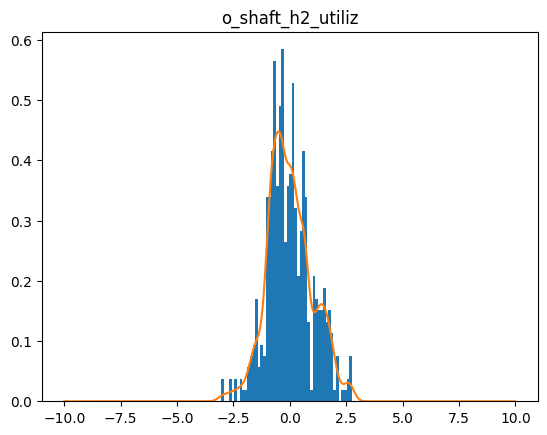

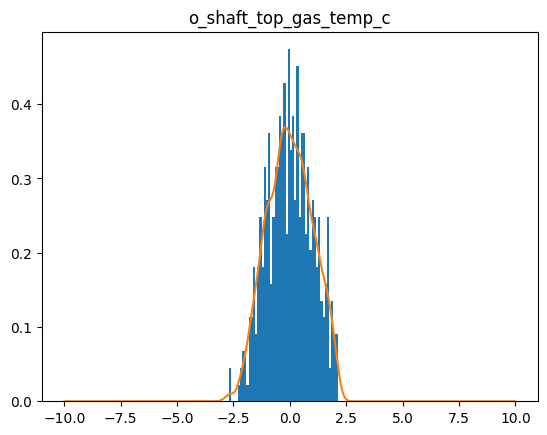

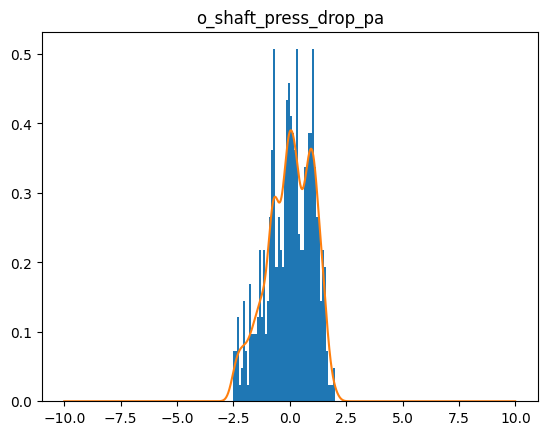

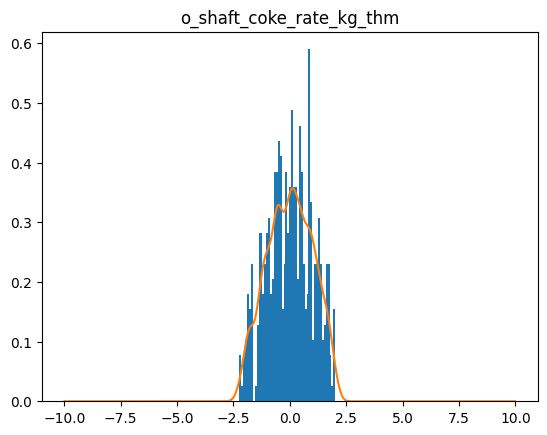

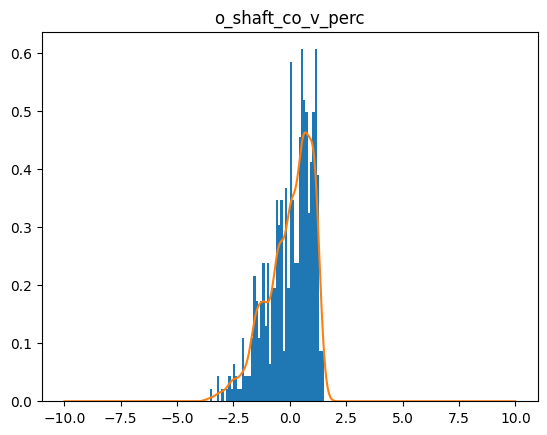

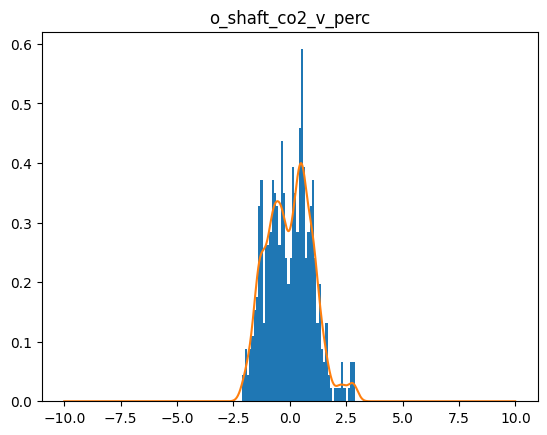

torch.Size([2000])
0  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
torch.Size([459, 6])
torch.Size([2000, 6])


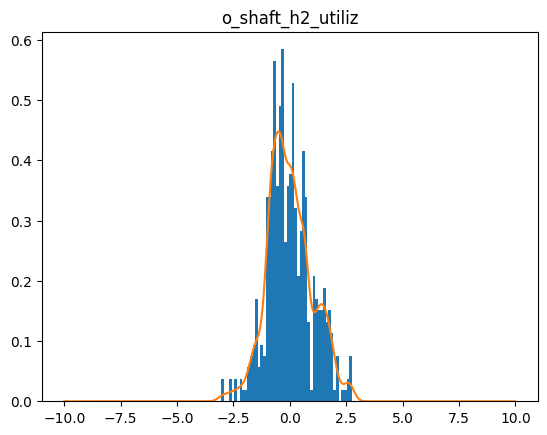

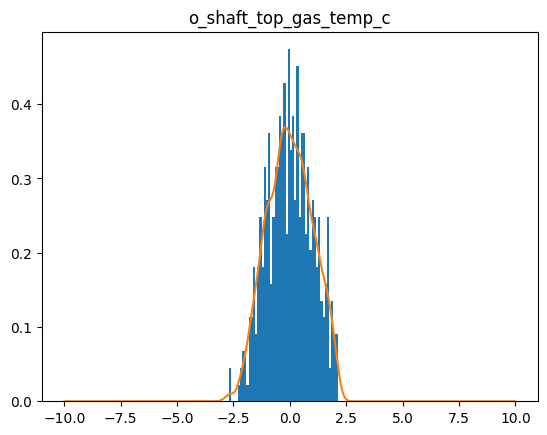

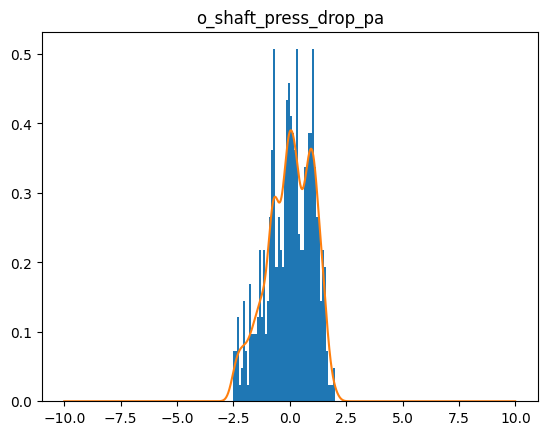

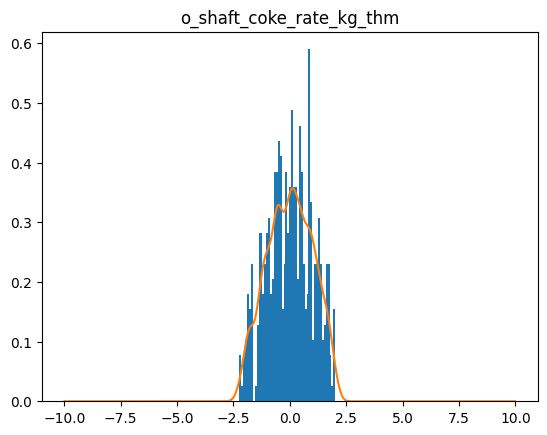

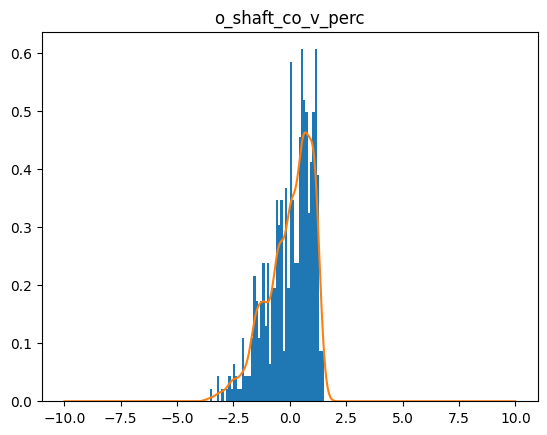

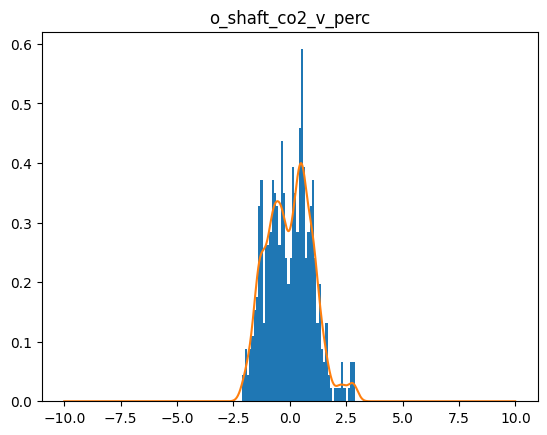

torch.Size([2000])
1  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
2  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
3  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
4  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
5  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
6  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
7  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
8  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
9  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
10  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
11  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
12  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
13  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
14  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
15  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
16  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
17  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
18  loss=  tensor(0.0008, grad_fn=<MeanBackward0>)
19  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
20  loss=  tensor(0.0

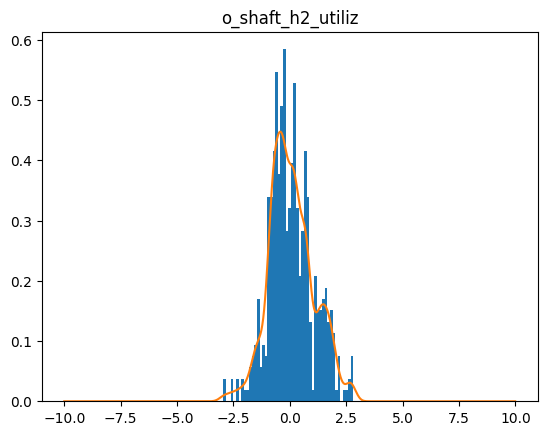

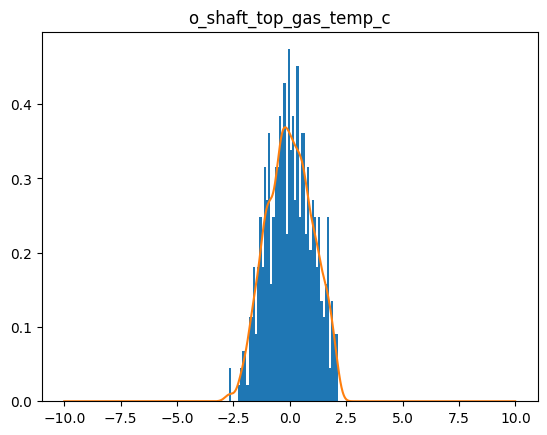

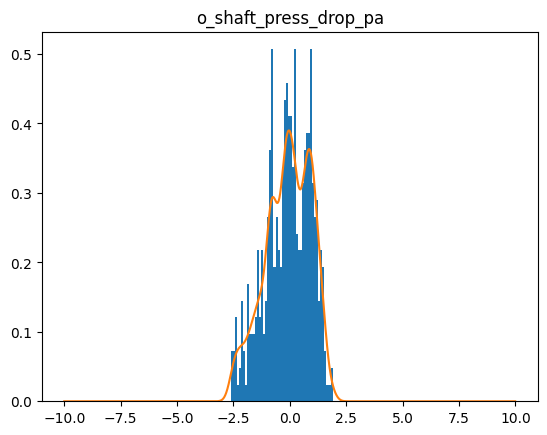

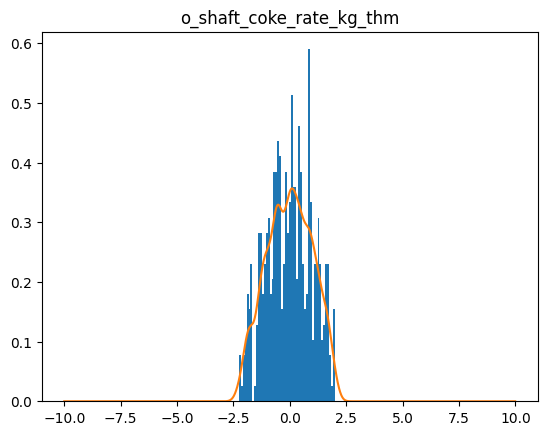

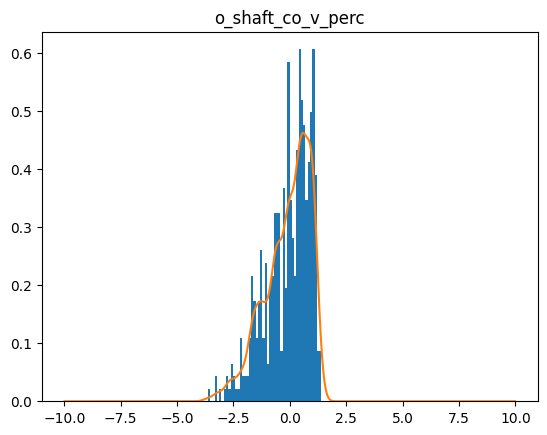

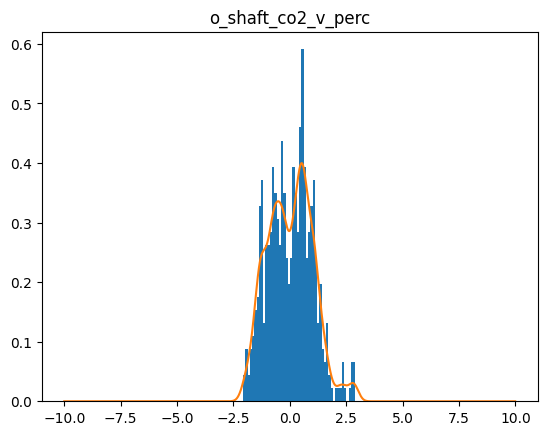

torch.Size([2000])
101  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
102  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
103  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
104  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
105  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
106  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
107  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
108  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
109  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
110  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
111  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
112  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
113  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
114  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
115  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
116  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
117  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
118  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
119  loss=  tensor(0.0007, grad_fn=<MeanBackw

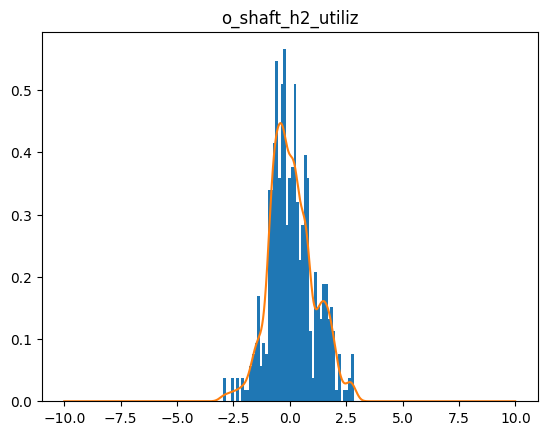

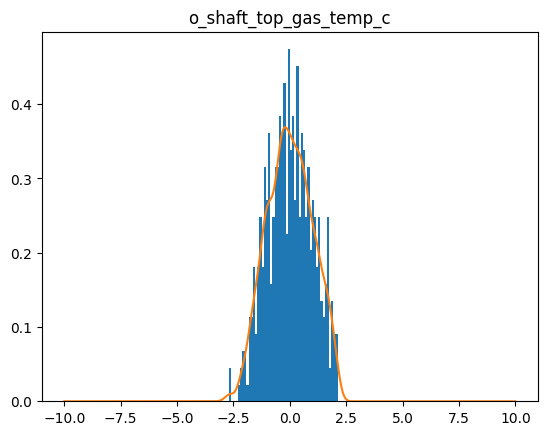

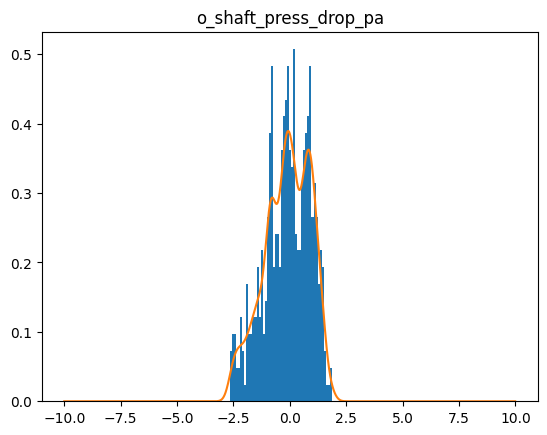

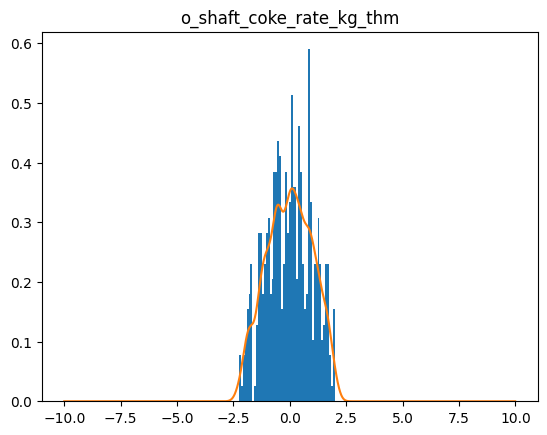

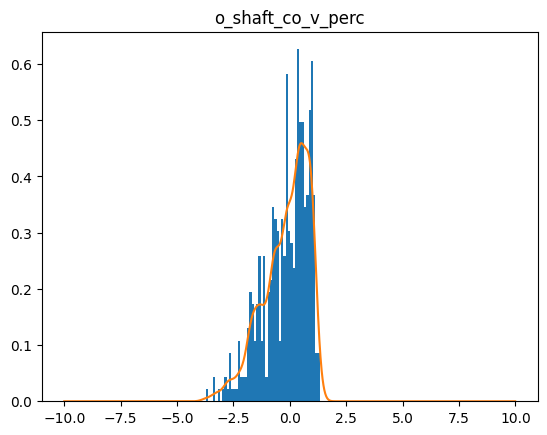

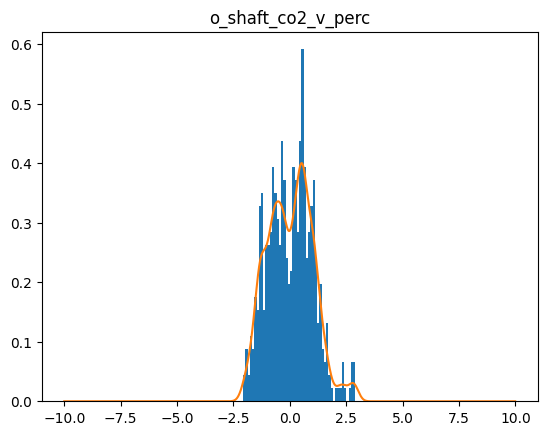

torch.Size([2000])
201  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
202  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
203  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
204  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
205  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
206  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
207  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
208  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
209  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
210  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
211  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
212  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
213  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
214  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
215  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
216  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
217  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
218  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
219  loss=  tensor(0.0007, grad_fn=<MeanBackw

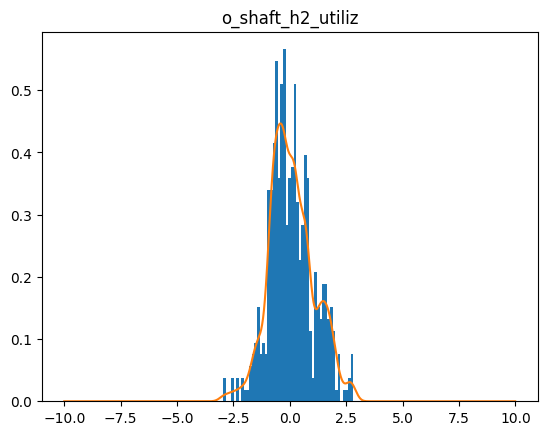

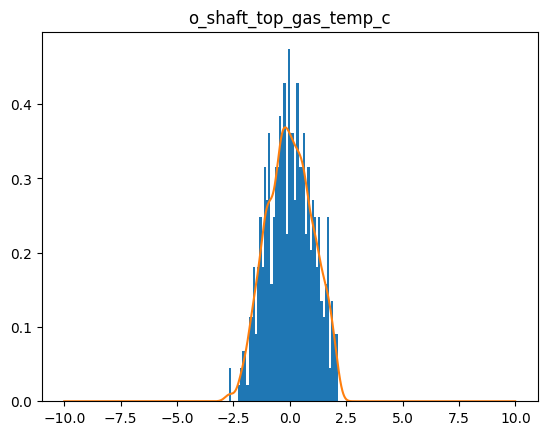

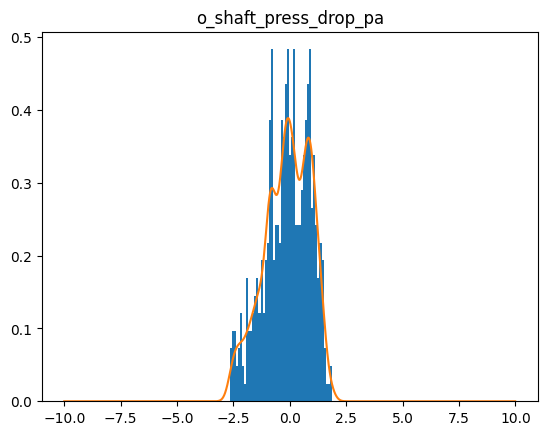

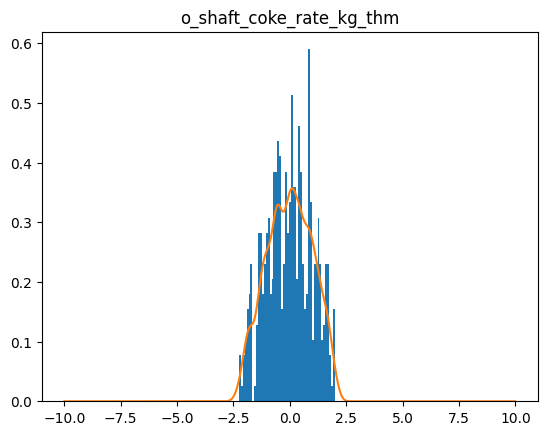

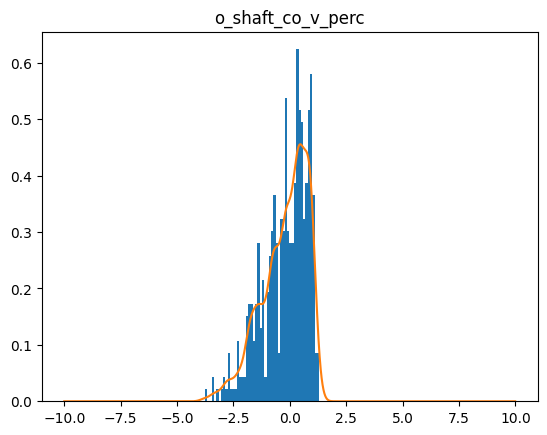

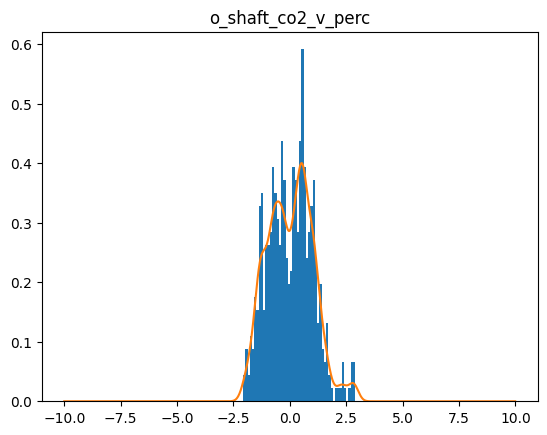

torch.Size([2000])
301  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
302  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
303  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
304  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
305  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
306  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
307  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
308  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
309  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
310  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
311  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
312  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
313  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
314  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
315  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
316  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
317  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
318  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
319  loss=  tensor(0.0007, grad_fn=<MeanBackw

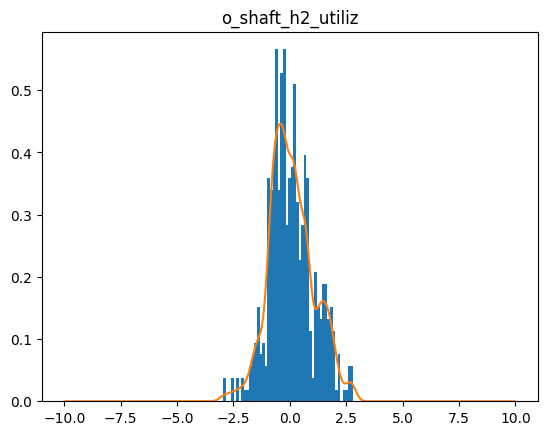

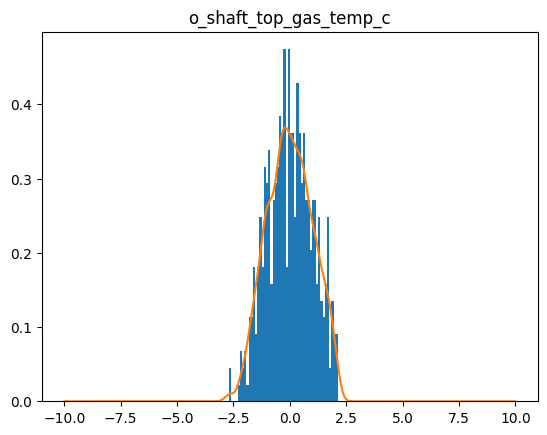

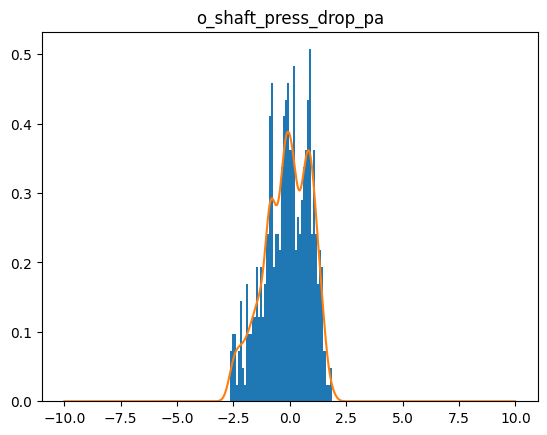

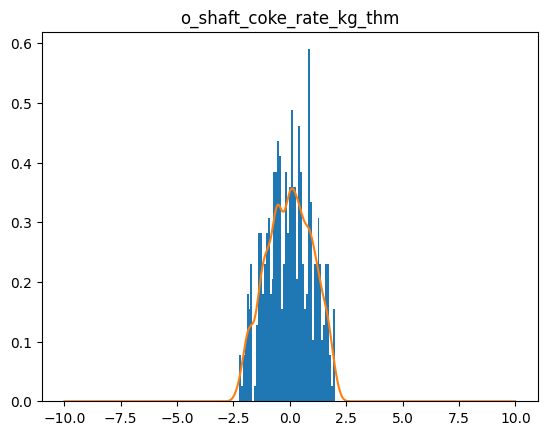

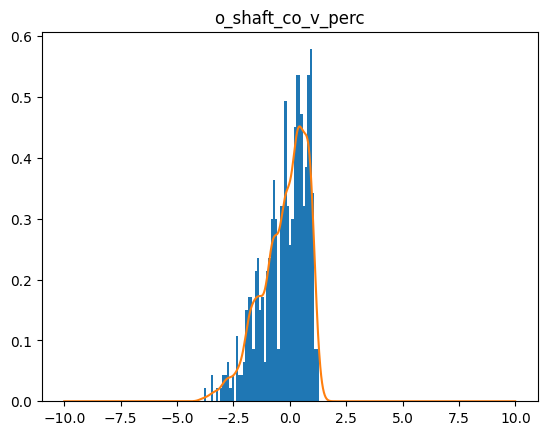

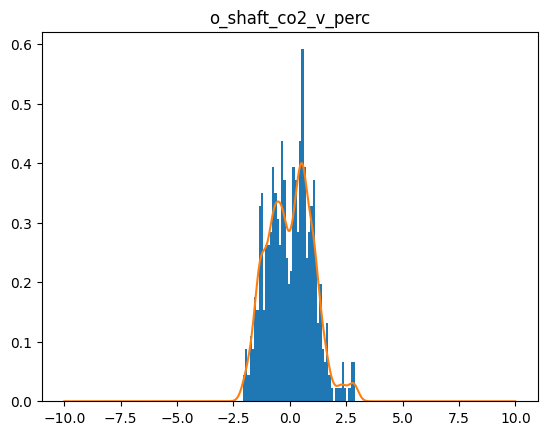

torch.Size([2000])
401  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
402  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
403  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
404  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
405  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
406  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
407  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
408  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
409  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
410  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
411  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
412  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
413  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
414  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
415  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
416  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
417  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
418  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
419  loss=  tensor(0.0007, grad_fn=<MeanBackw

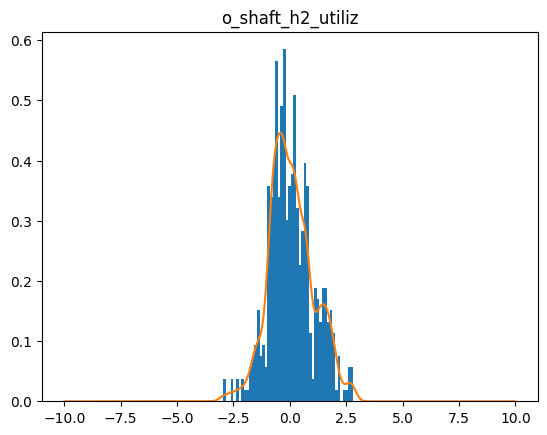

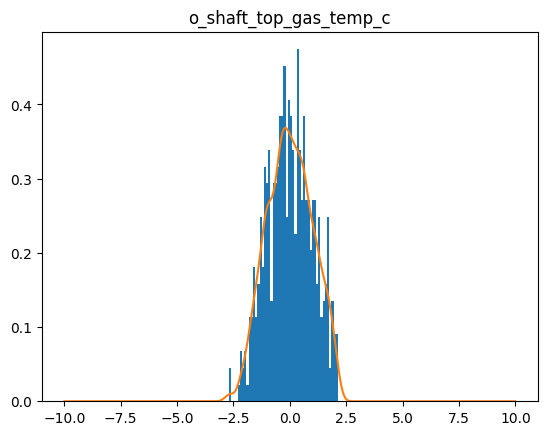

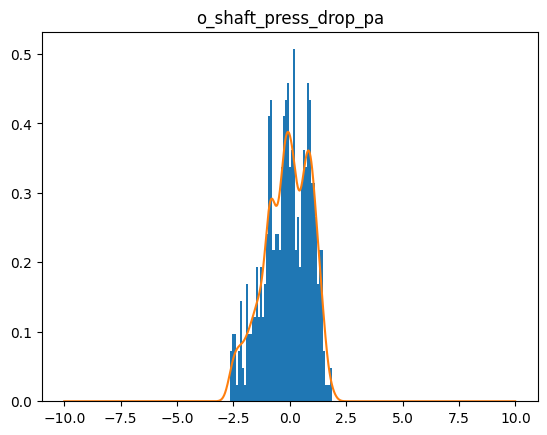

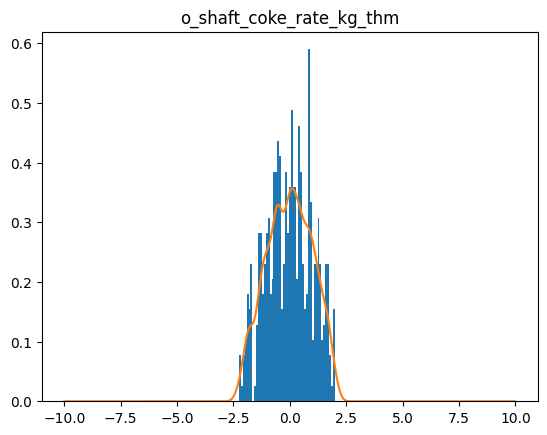

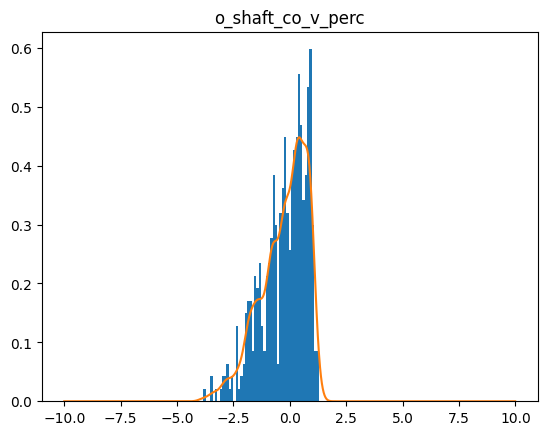

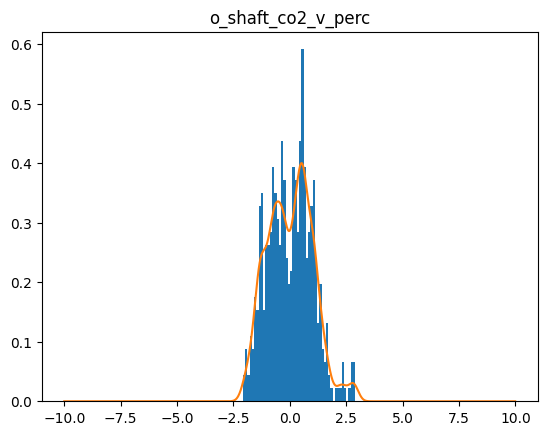

torch.Size([2000])
501  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
502  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
503  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
504  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
505  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
506  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
507  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
508  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
509  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
510  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
511  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
512  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
513  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
514  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
515  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
516  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
517  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
518  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
519  loss=  tensor(0.0007, grad_fn=<MeanBackw

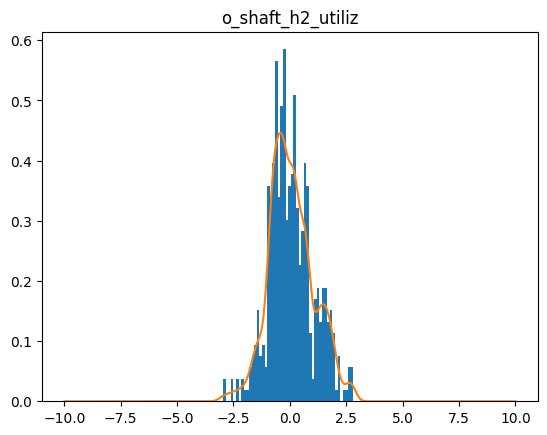

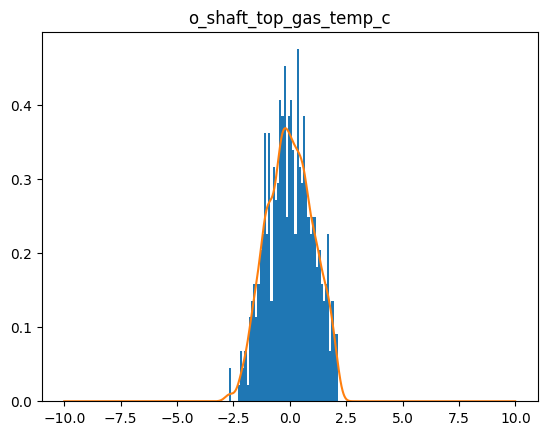

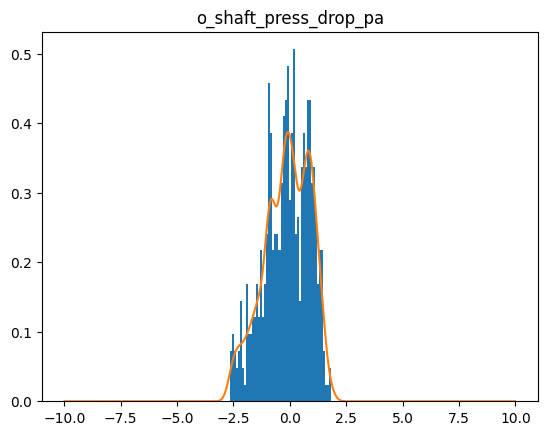

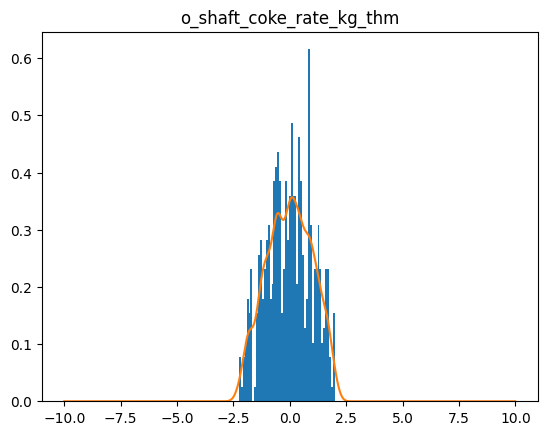

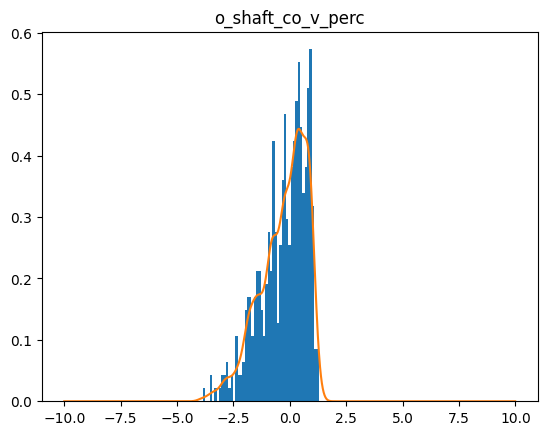

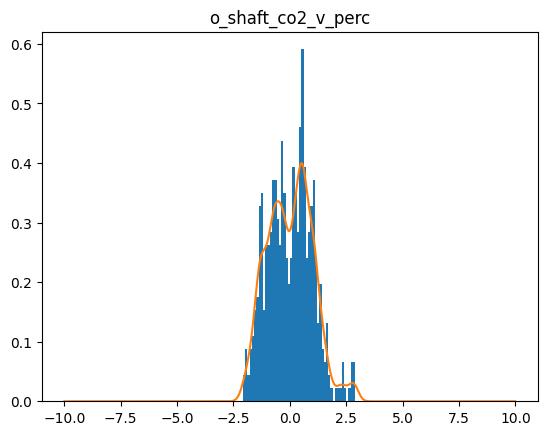

torch.Size([2000])
601  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
602  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
603  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
604  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
605  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
606  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
607  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
608  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
609  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
610  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
611  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
612  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
613  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
614  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
615  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
616  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
617  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
618  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
619  loss=  tensor(0.0007, grad_fn=<MeanBackw

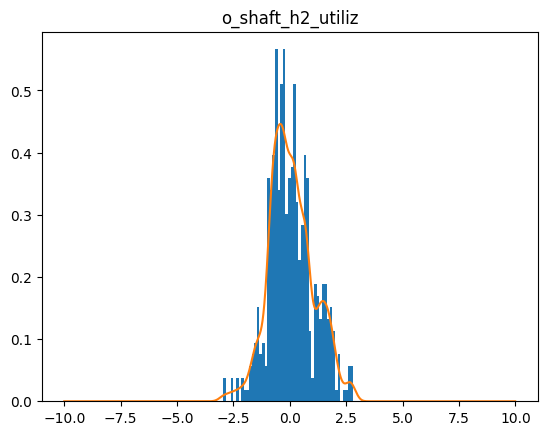

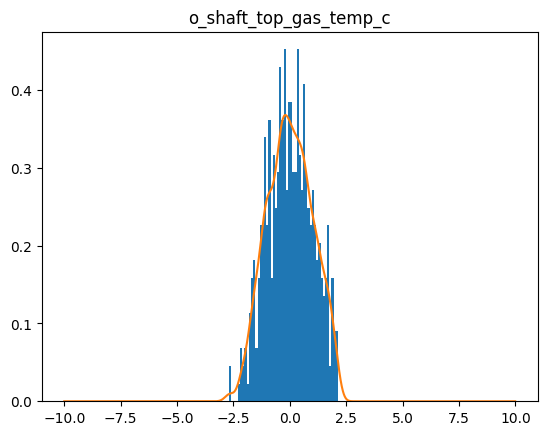

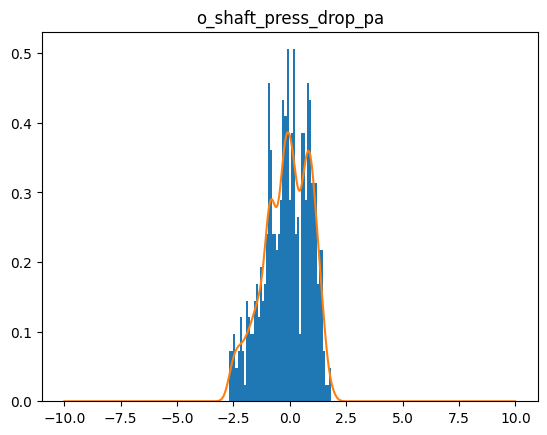

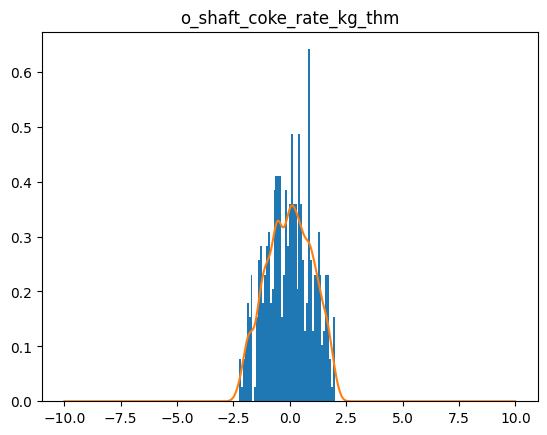

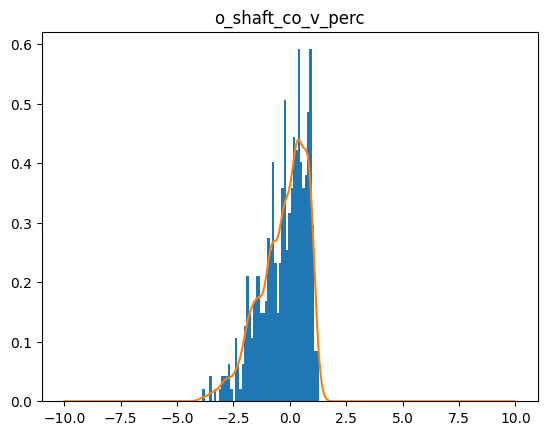

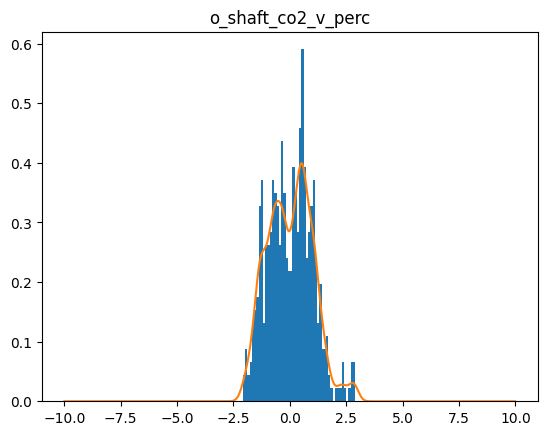

torch.Size([2000])
701  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
702  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
703  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
704  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
705  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
706  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
707  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
708  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
709  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
710  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
711  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
712  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
713  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
714  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
715  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
716  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
717  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
718  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
719  loss=  tensor(0.0007, grad_fn=<MeanBackw

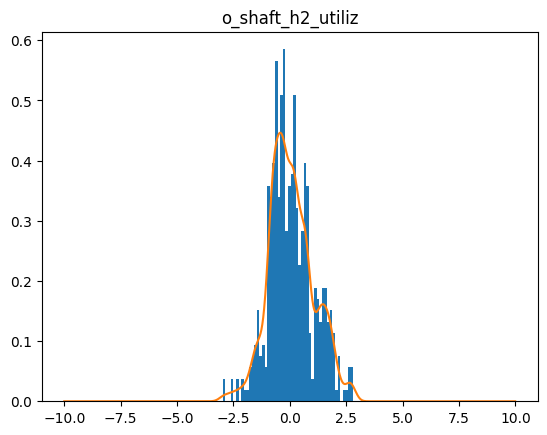

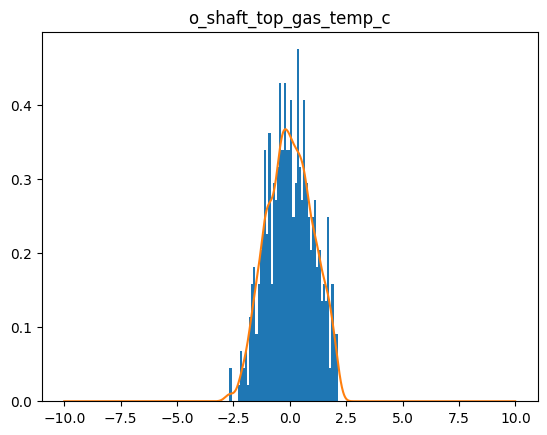

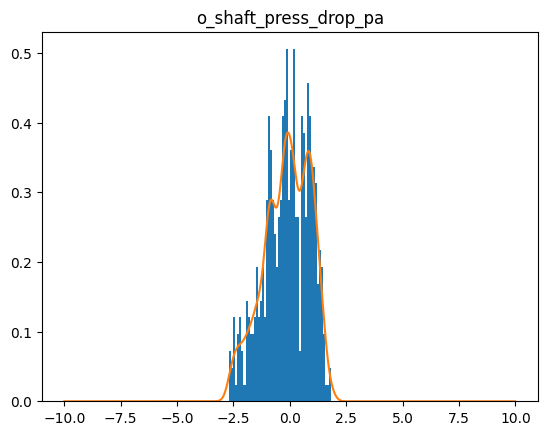

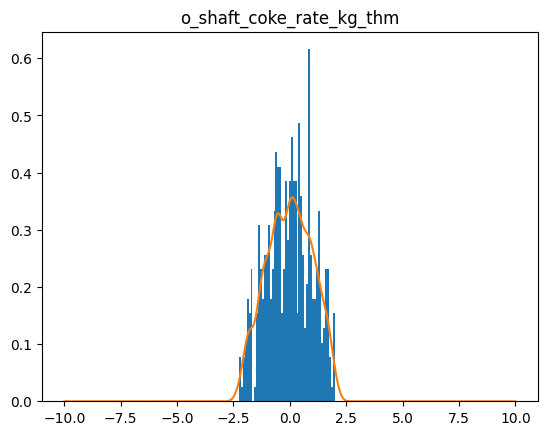

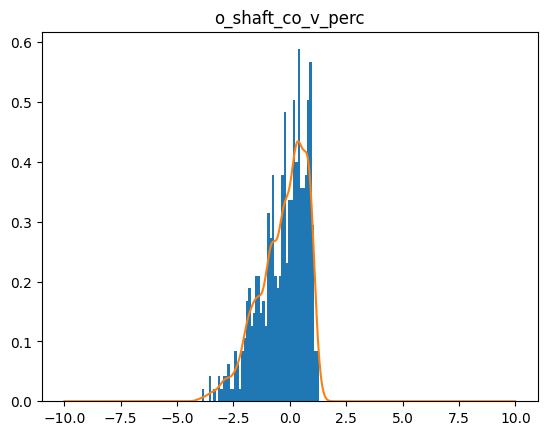

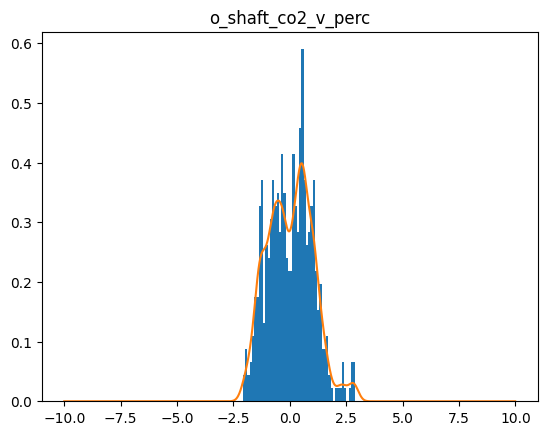

torch.Size([2000])
801  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
802  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
803  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
804  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
805  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
806  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
807  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
808  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
809  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
810  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
811  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
812  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
813  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
814  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
815  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
816  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
817  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
818  loss=  tensor(0.0007, grad_fn=<MeanBackward0>)
819  loss=  tensor(0.0007, grad_fn=<MeanBackw

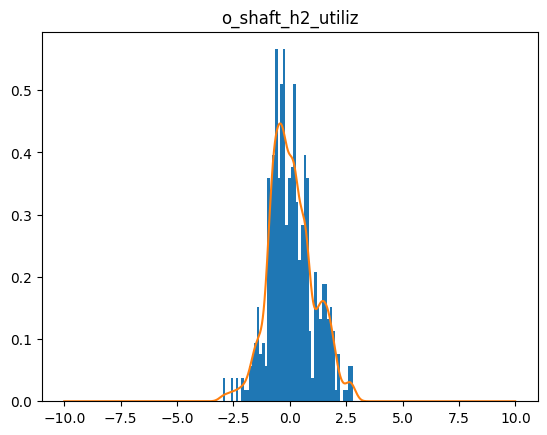

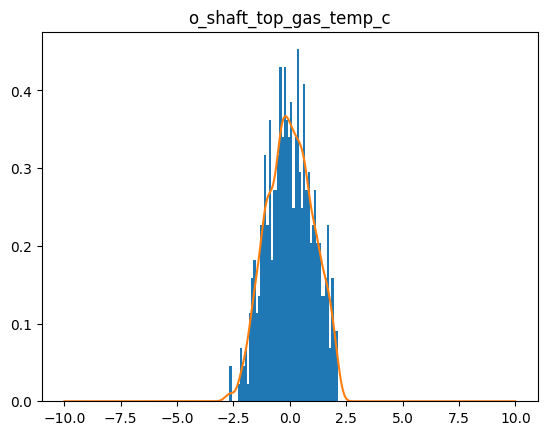

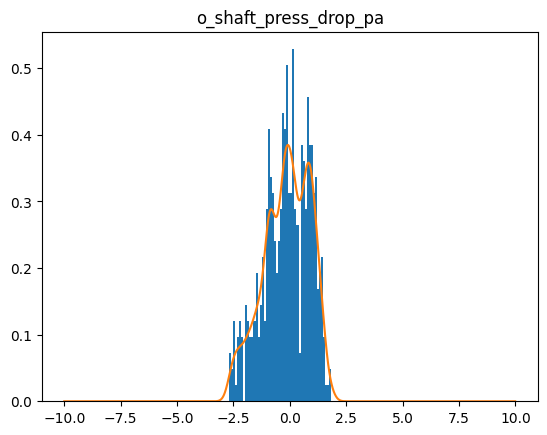

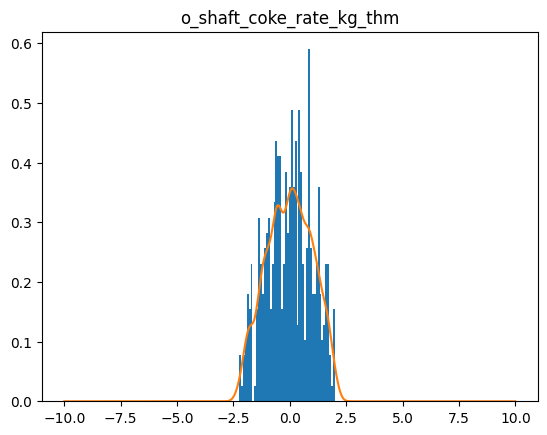

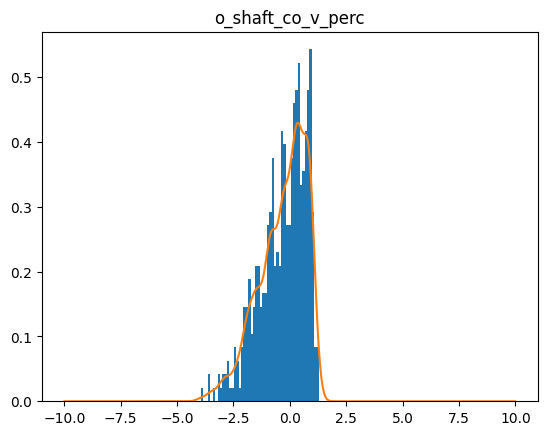

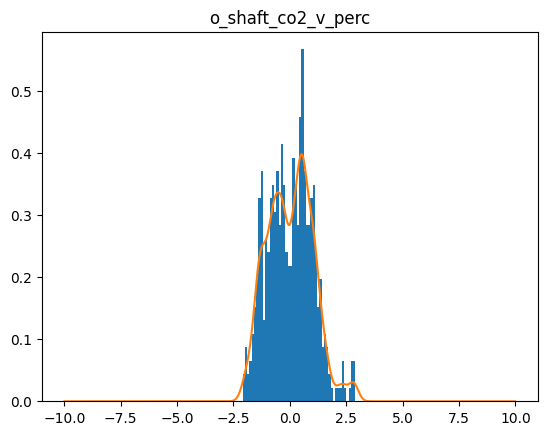

torch.Size([2000])
901  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
902  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
903  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
904  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
905  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
906  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
907  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
908  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
909  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
910  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
911  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
912  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
913  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
914  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
915  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
916  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
917  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
918  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
919  loss=  tensor(0.0006, grad_fn=<MeanBackw

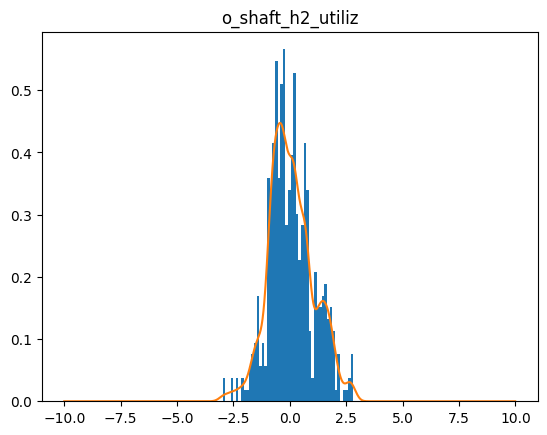

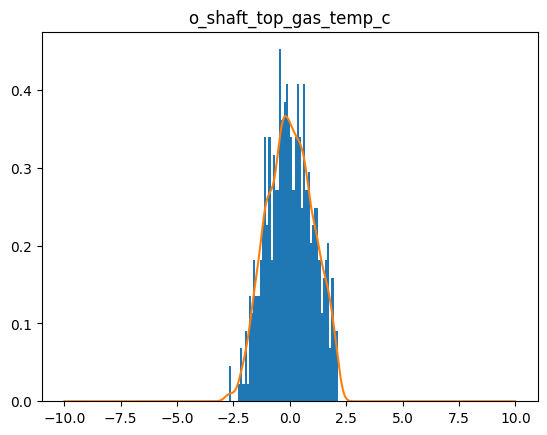

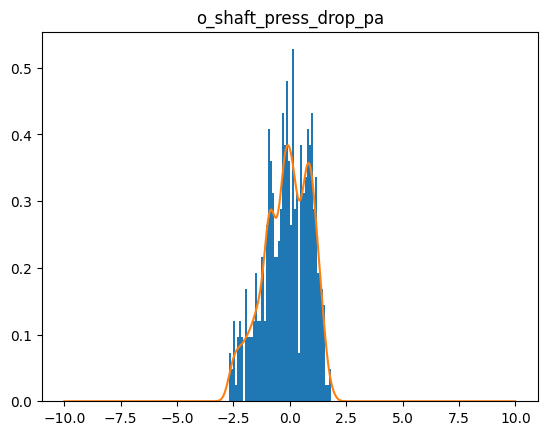

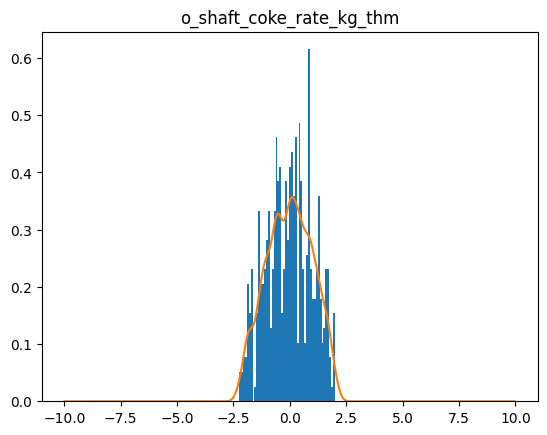

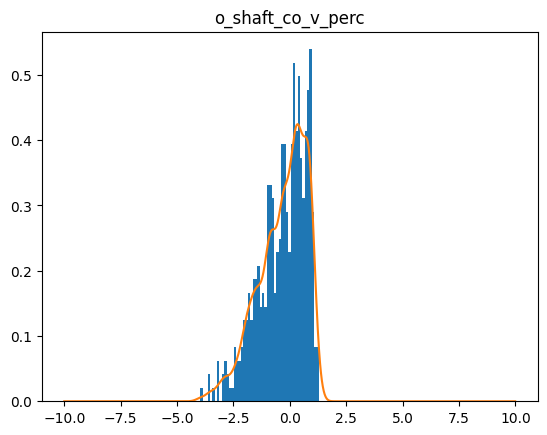

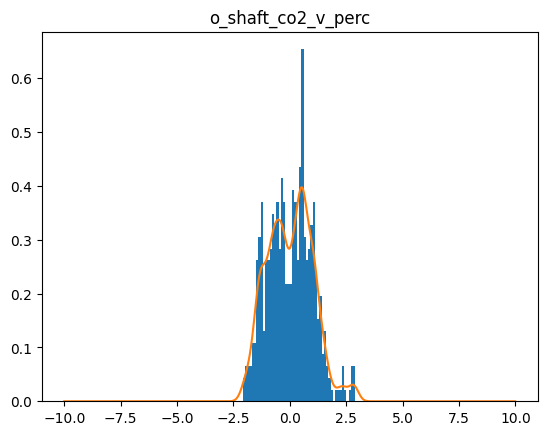

torch.Size([2000])
1001  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1002  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1003  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1004  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1005  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1006  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1007  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1008  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1009  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1010  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1011  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1012  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1013  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1014  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1015  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1016  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1017  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1018  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1019  loss=  tensor(0.0006,

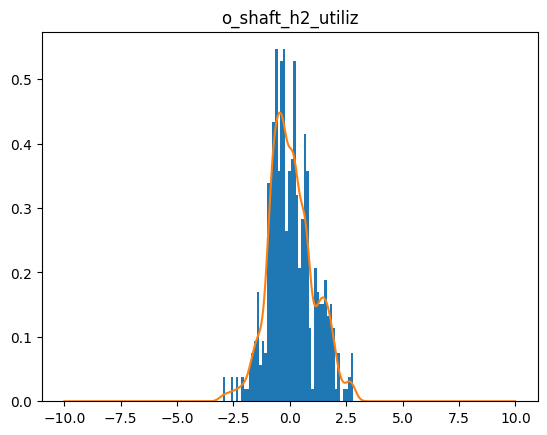

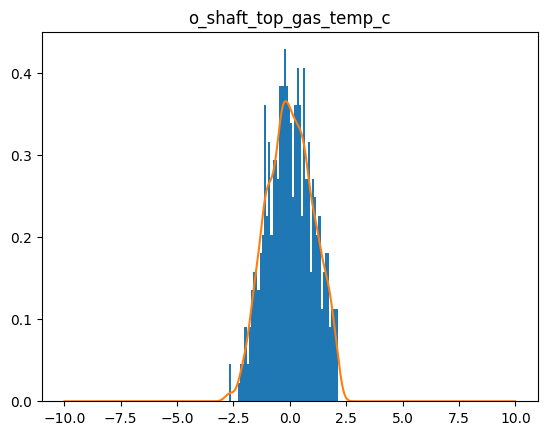

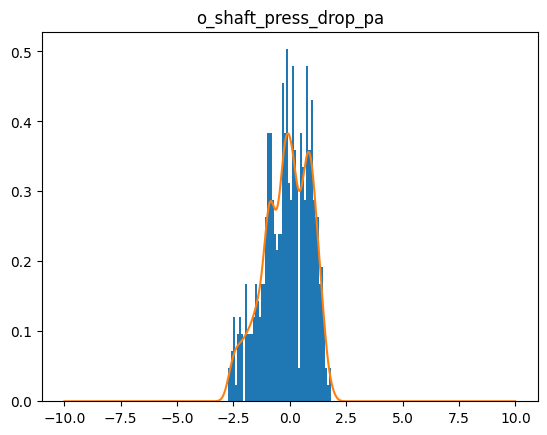

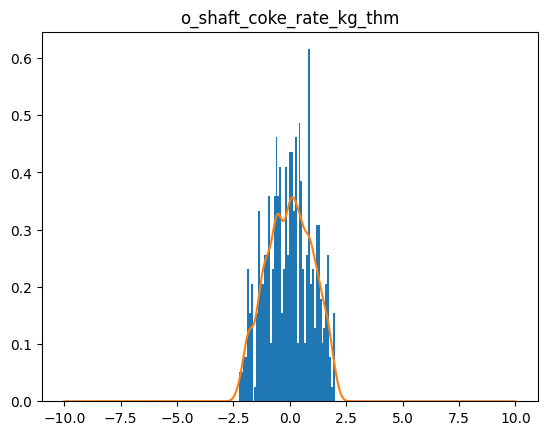

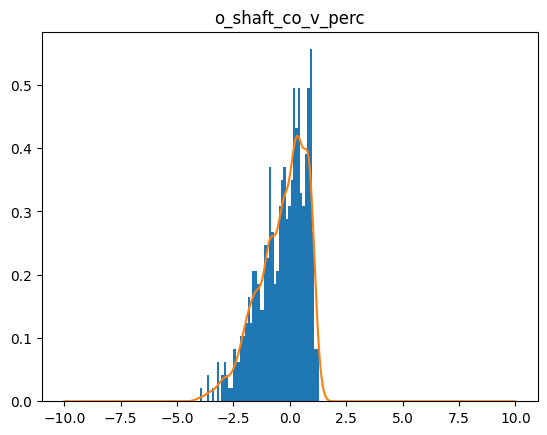

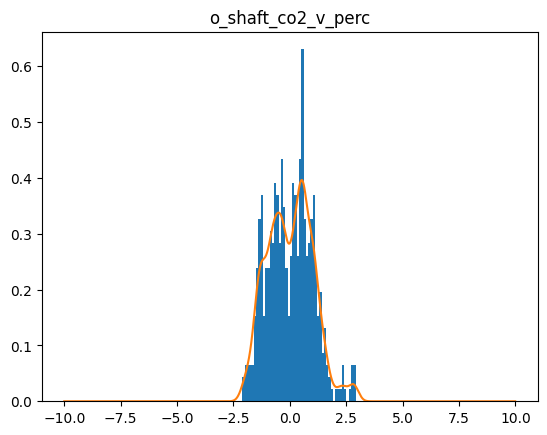

torch.Size([2000])
1101  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1102  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1103  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1104  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1105  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1106  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1107  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1108  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1109  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1110  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1111  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1112  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1113  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1114  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1115  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1116  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1117  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1118  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1119  loss=  tensor(0.0006,

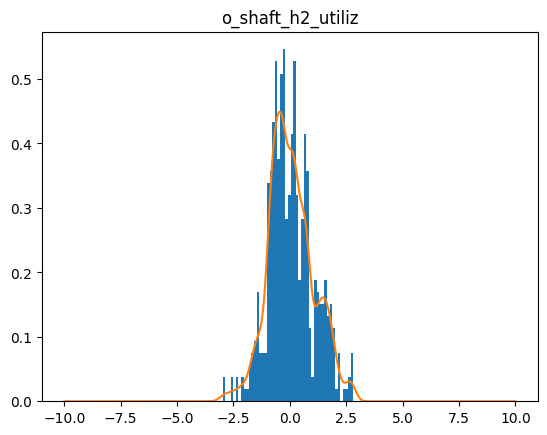

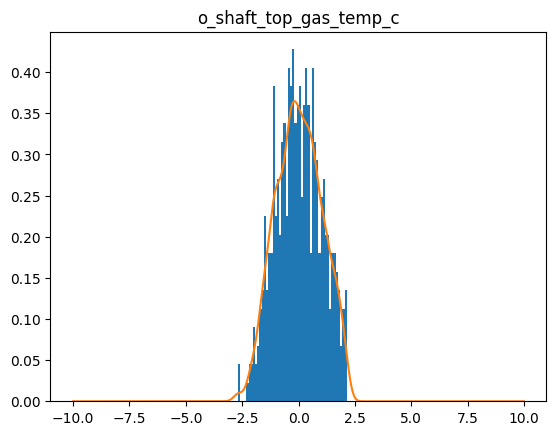

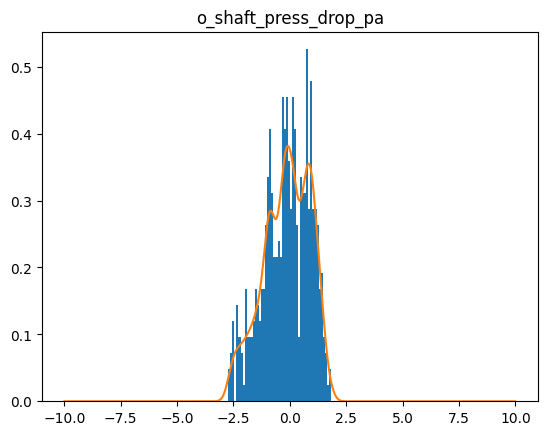

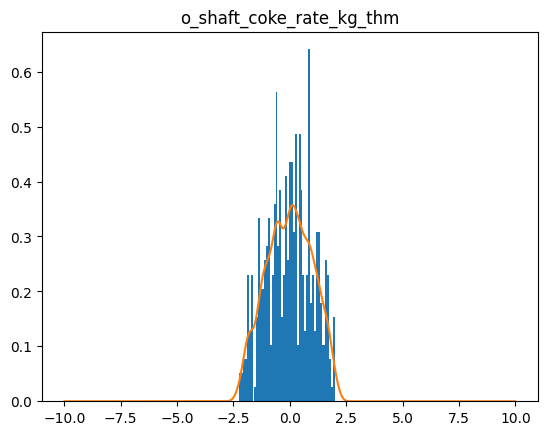

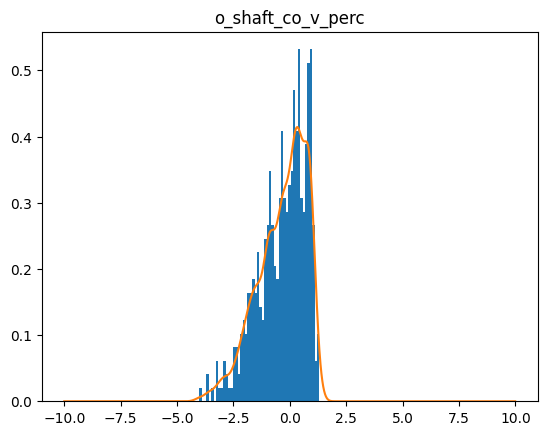

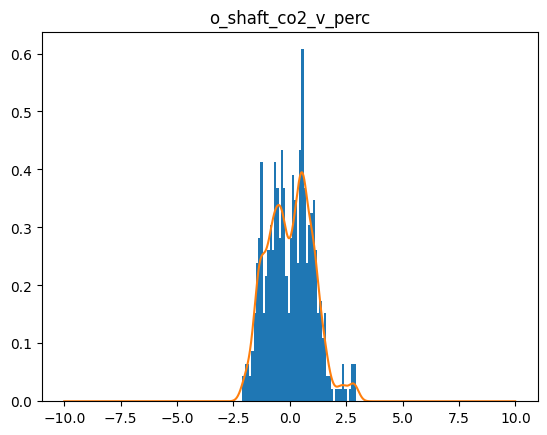

torch.Size([2000])
1201  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1202  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1203  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1204  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1205  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1206  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1207  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1208  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1209  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1210  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1211  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1212  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1213  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1214  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1215  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1216  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1217  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1218  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1219  loss=  tensor(0.0006,

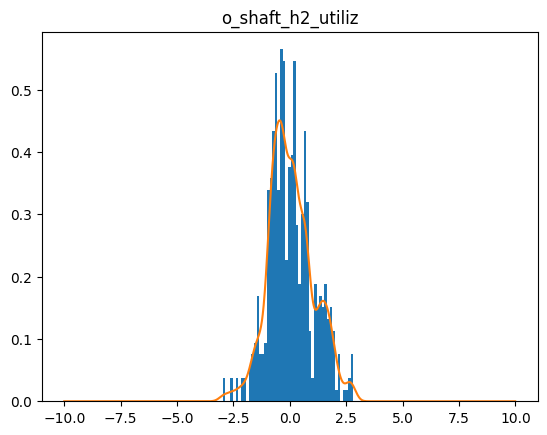

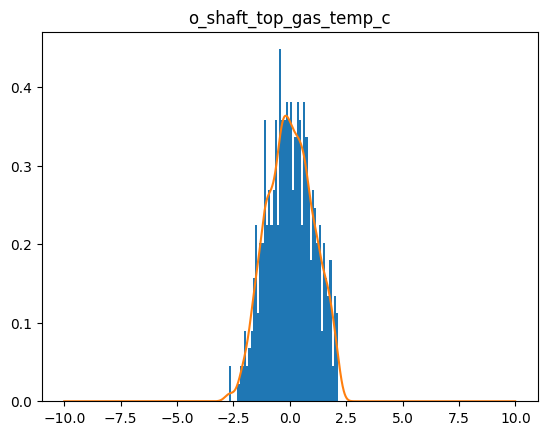

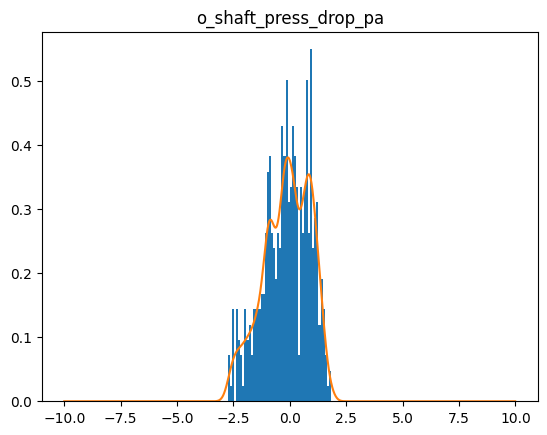

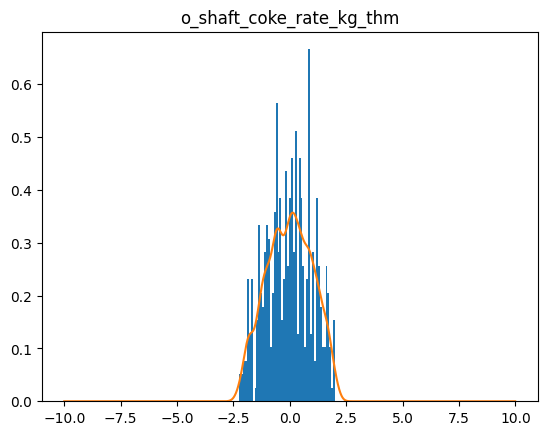

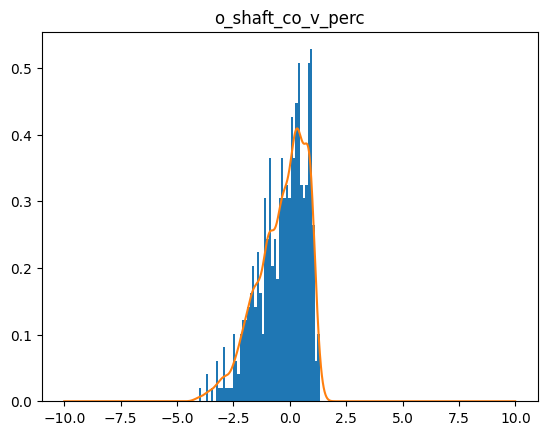

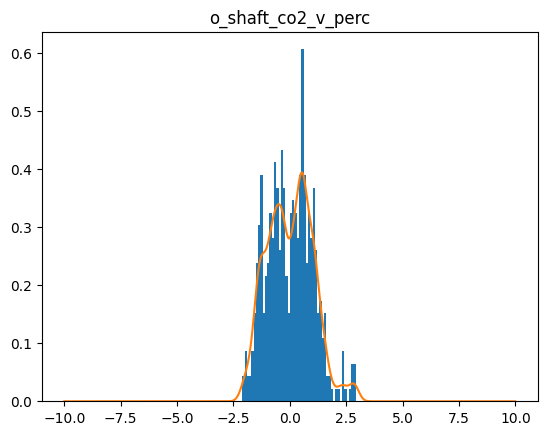

torch.Size([2000])
1301  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1302  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1303  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1304  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1305  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1306  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1307  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1308  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1309  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1310  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1311  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1312  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1313  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1314  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1315  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1316  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1317  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1318  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1319  loss=  tensor(0.0006,

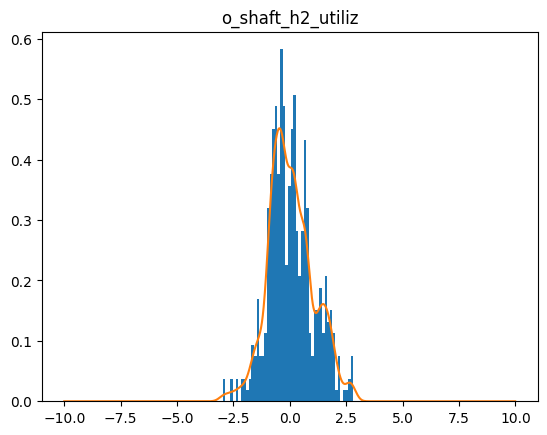

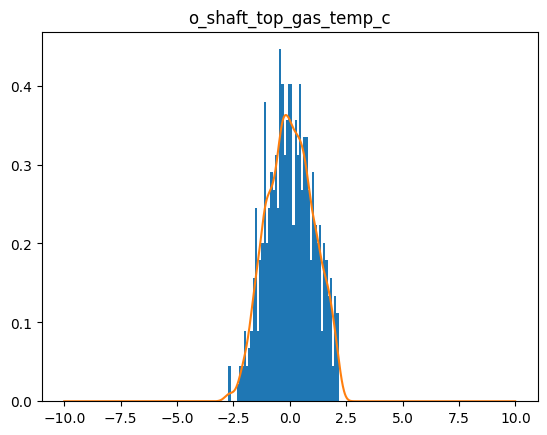

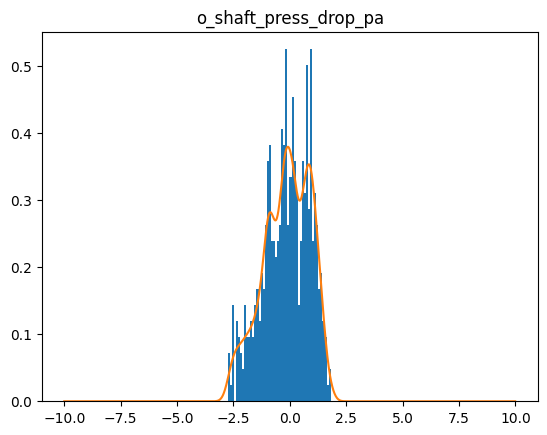

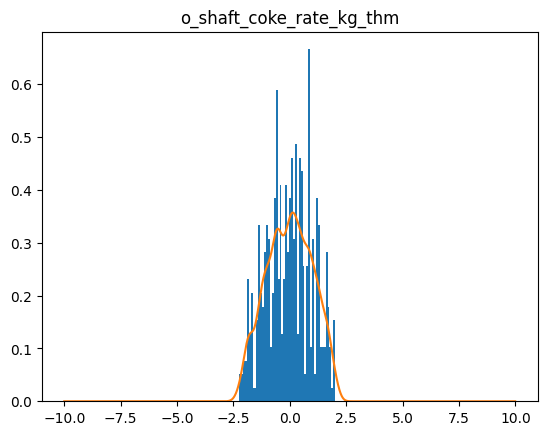

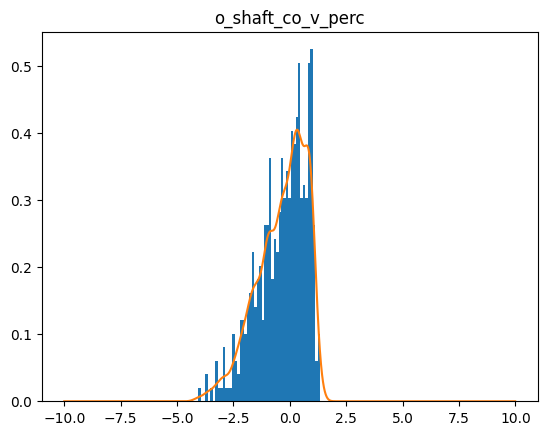

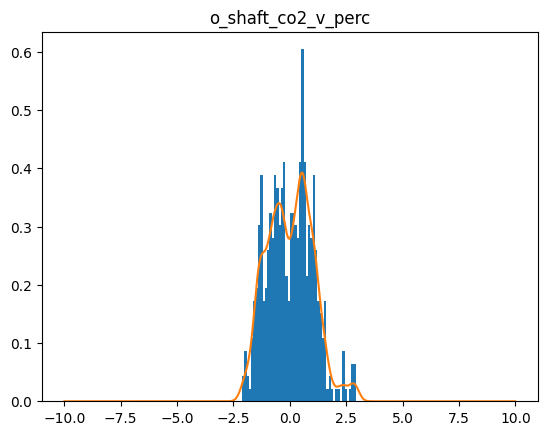

torch.Size([2000])
1401  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1402  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1403  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1404  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1405  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1406  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1407  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1408  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1409  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1410  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1411  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1412  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1413  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1414  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1415  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1416  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1417  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1418  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1419  loss=  tensor(0.0006,

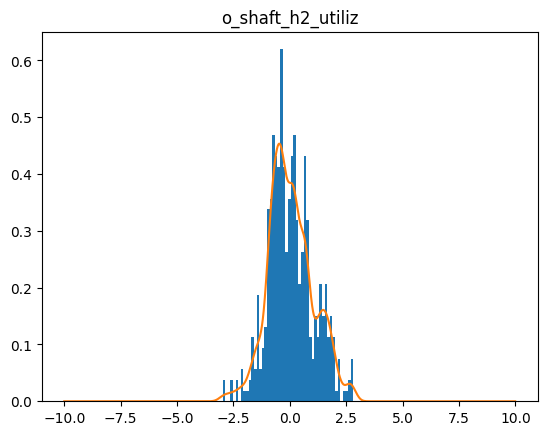

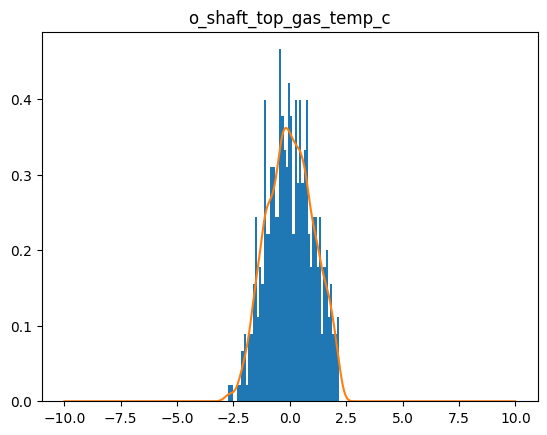

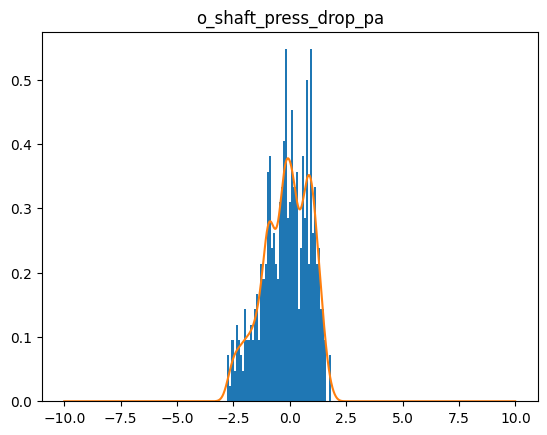

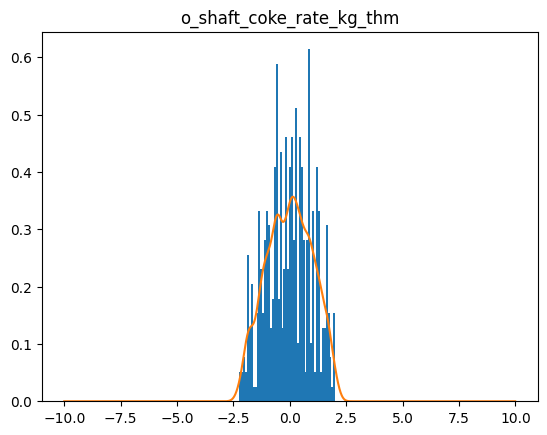

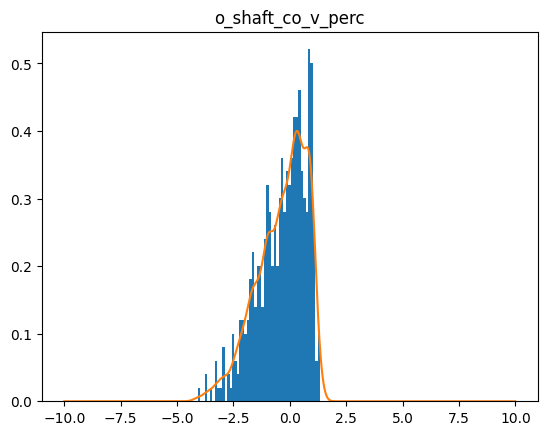

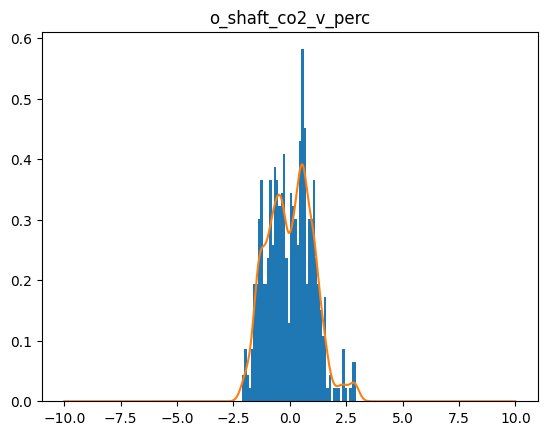

torch.Size([2000])
1501  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1502  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1503  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1504  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1505  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1506  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1507  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1508  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1509  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1510  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1511  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1512  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1513  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1514  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1515  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1516  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1517  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1518  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1519  loss=  tensor(0.0006,

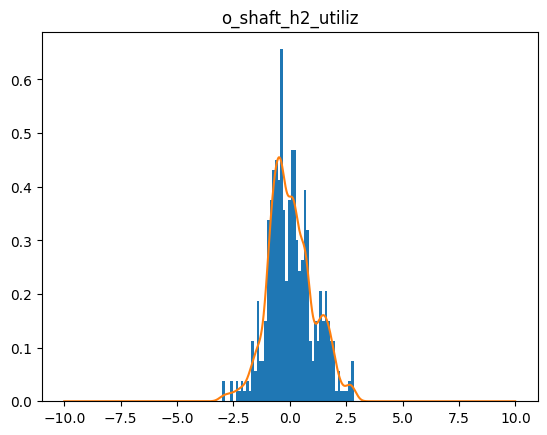

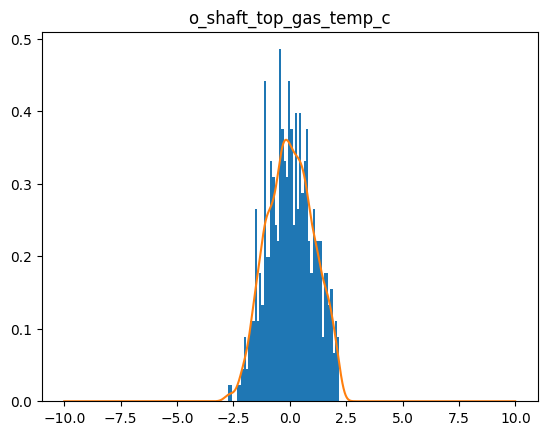

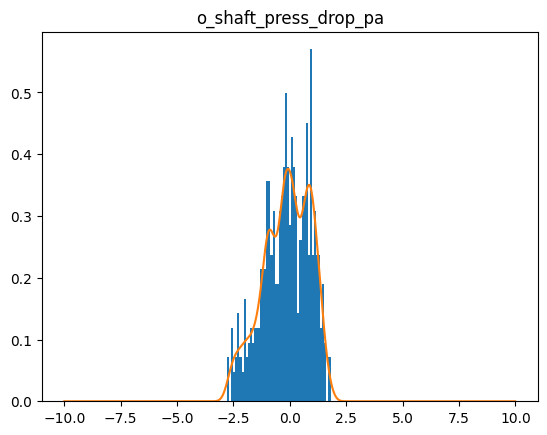

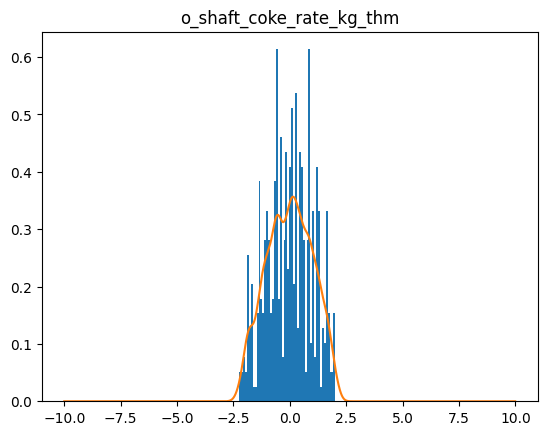

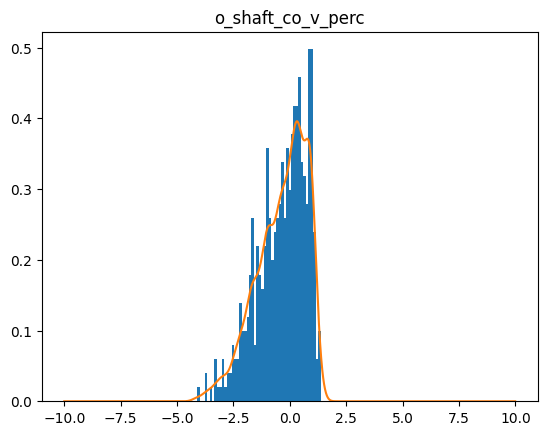

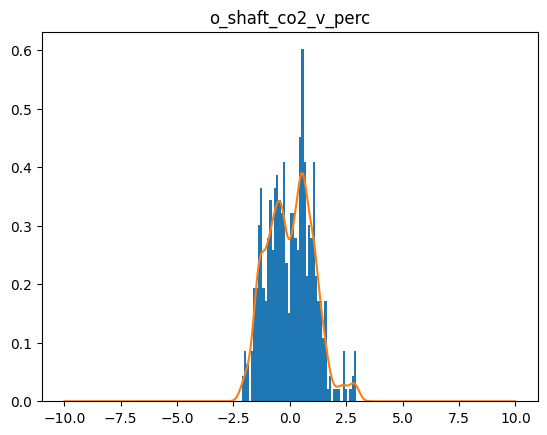

torch.Size([2000])
1601  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1602  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1603  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1604  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1605  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1606  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1607  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1608  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1609  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1610  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1611  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1612  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1613  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1614  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1615  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1616  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1617  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1618  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1619  loss=  tensor(0.0006,

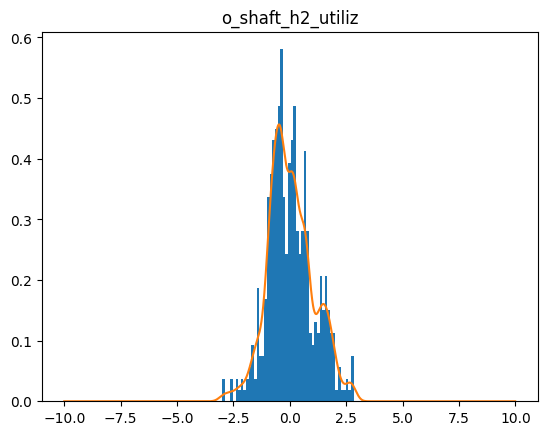

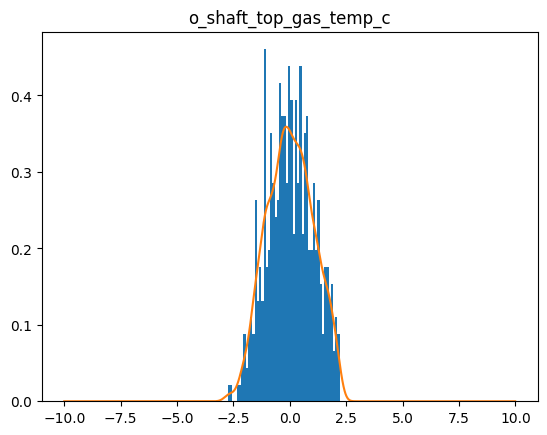

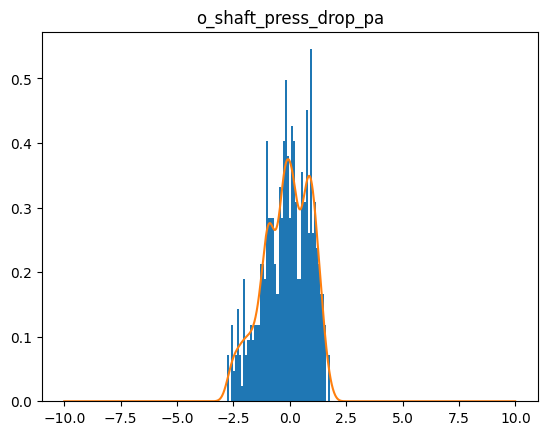

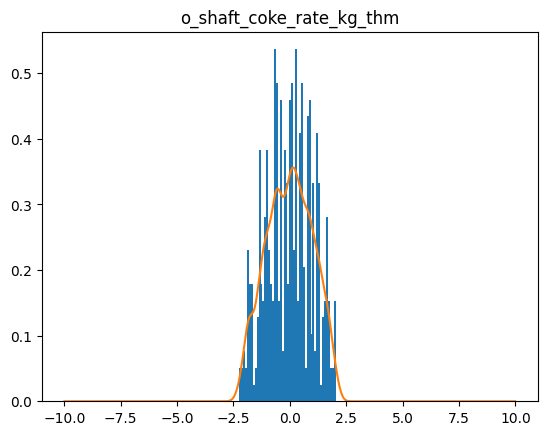

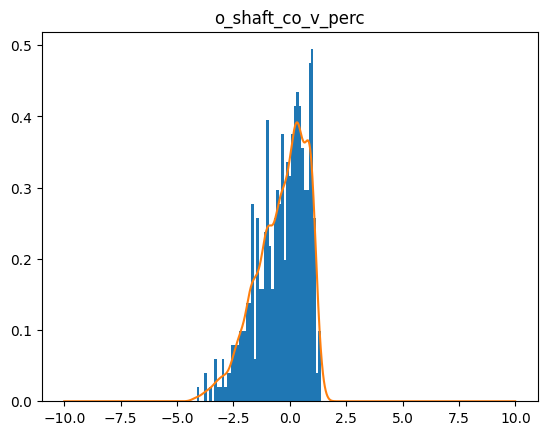

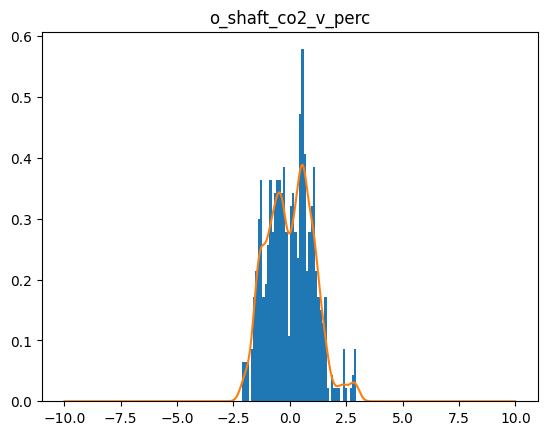

torch.Size([2000])
1701  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1702  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1703  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1704  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1705  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1706  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1707  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1708  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1709  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1710  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1711  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1712  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1713  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1714  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1715  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1716  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1717  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1718  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1719  loss=  tensor(0.0006,

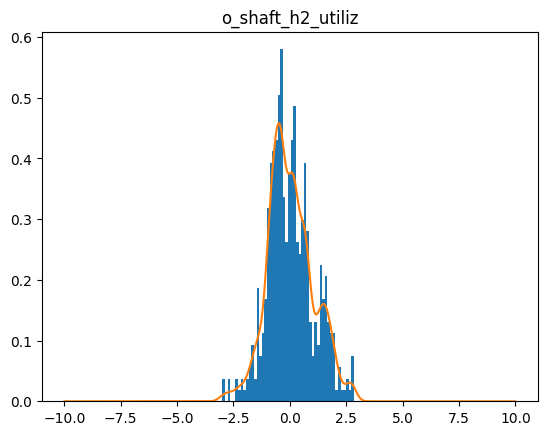

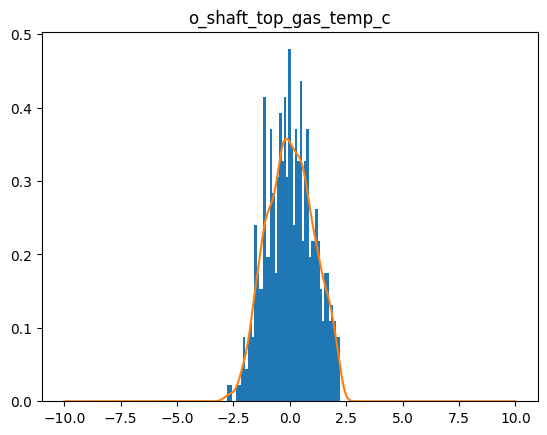

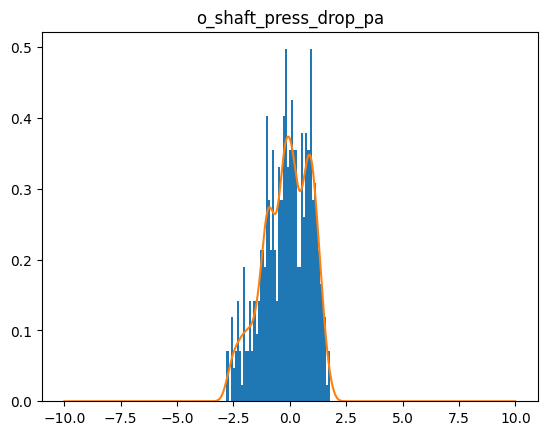

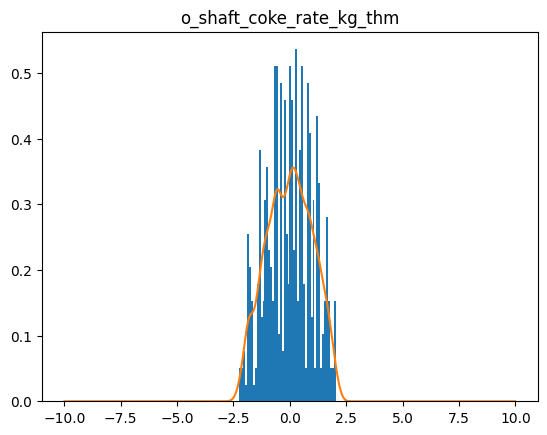

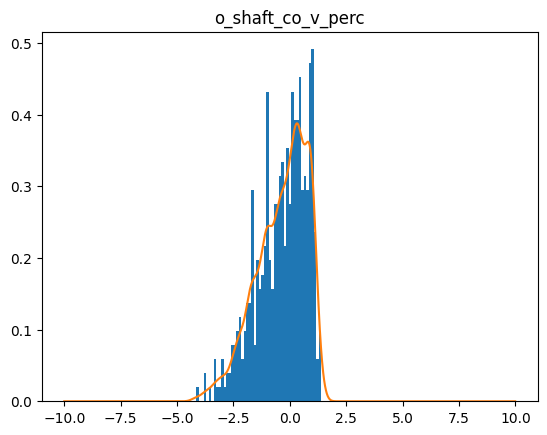

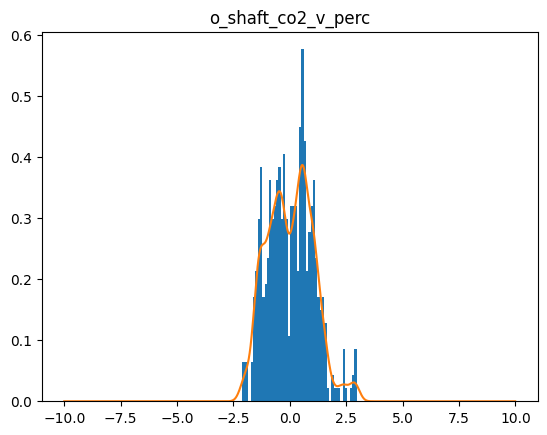

torch.Size([2000])
1801  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1802  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1803  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1804  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1805  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1806  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1807  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1808  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1809  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1810  loss=  tensor(0.0006, grad_fn=<MeanBackward0>)
1811  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1812  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1813  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1814  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1815  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1816  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1817  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1818  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1819  loss=  tensor(0.0005,

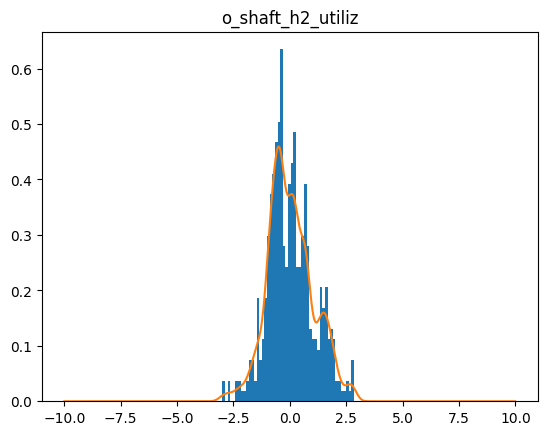

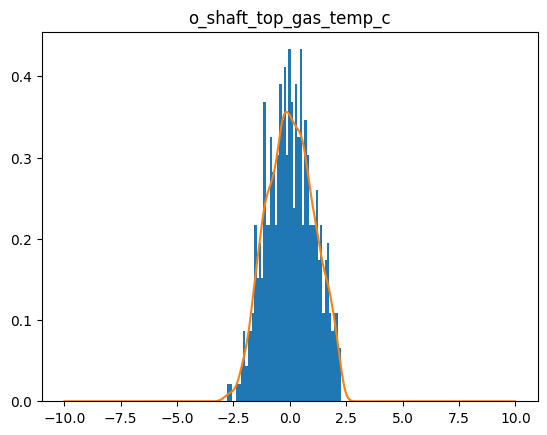

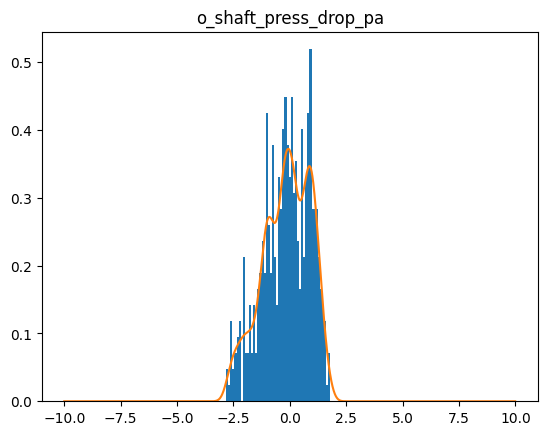

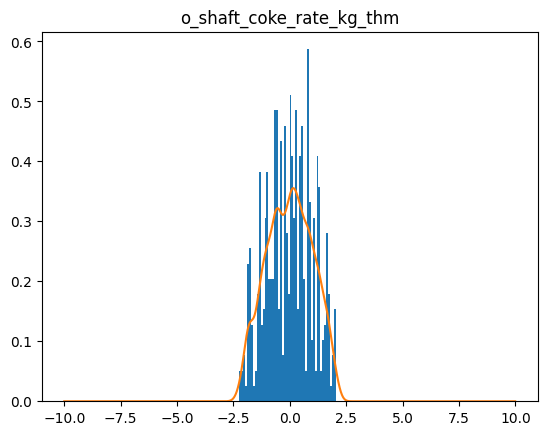

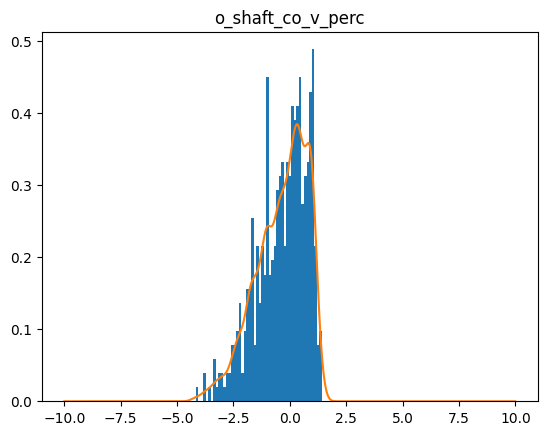

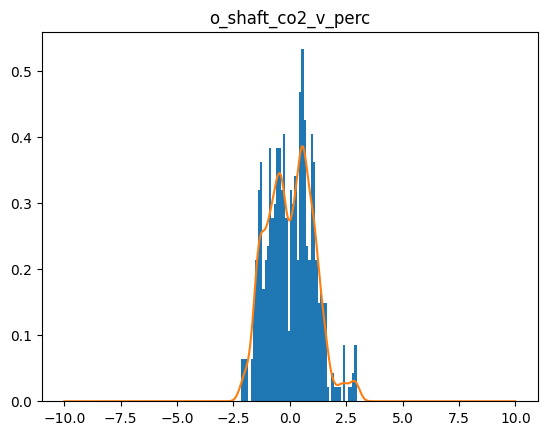

torch.Size([2000])
1901  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1902  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1903  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1904  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1905  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1906  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1907  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1908  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1909  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1910  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1911  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1912  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1913  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1914  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1915  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1916  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1917  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1918  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
1919  loss=  tensor(0.0005,

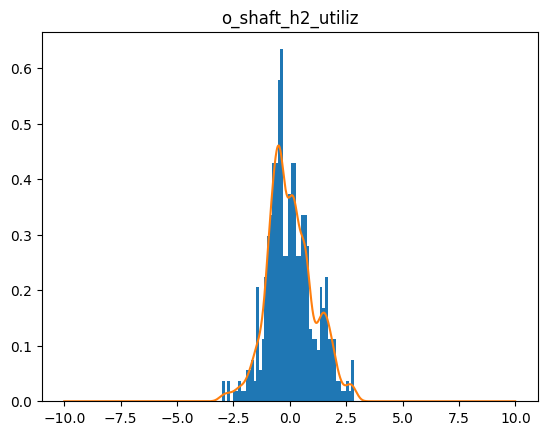

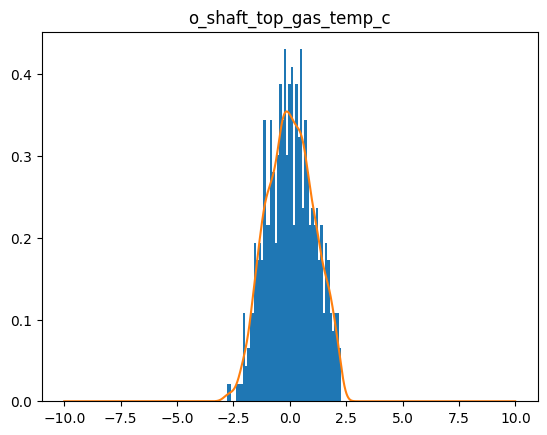

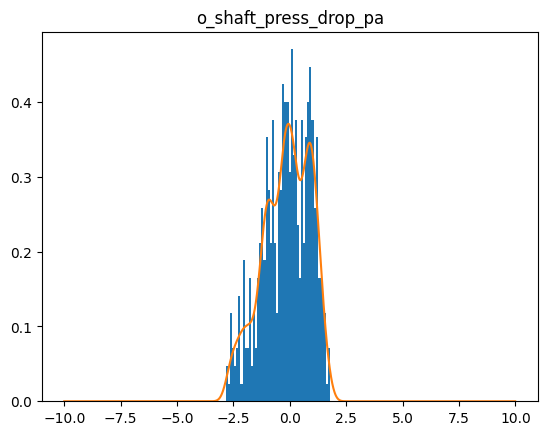

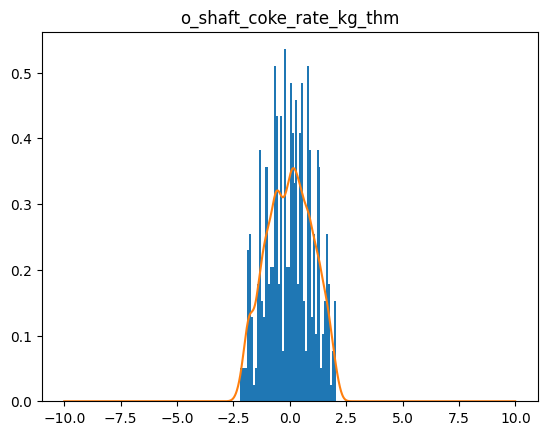

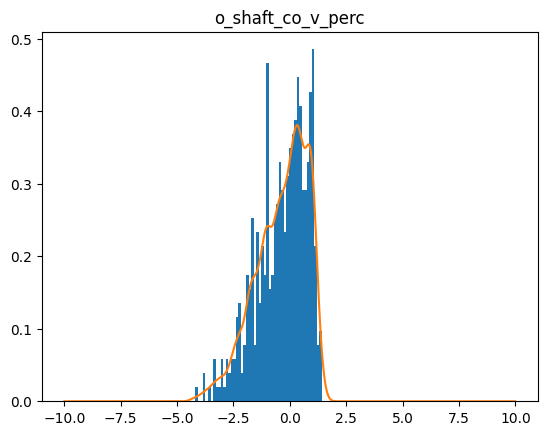

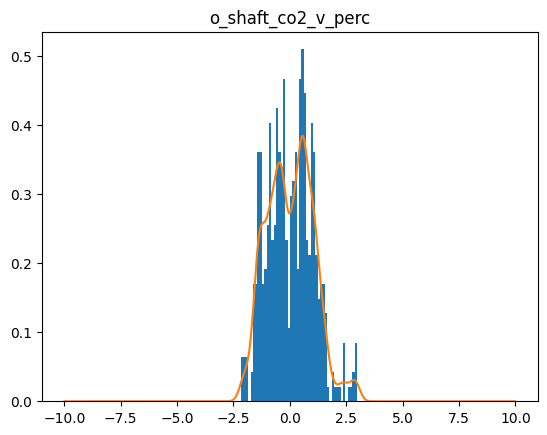

torch.Size([2000])
2001  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2002  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2003  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2004  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2005  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2006  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2007  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2008  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2009  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2010  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2011  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2012  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2013  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2014  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2015  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2016  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2017  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2018  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2019  loss=  tensor(0.0005,

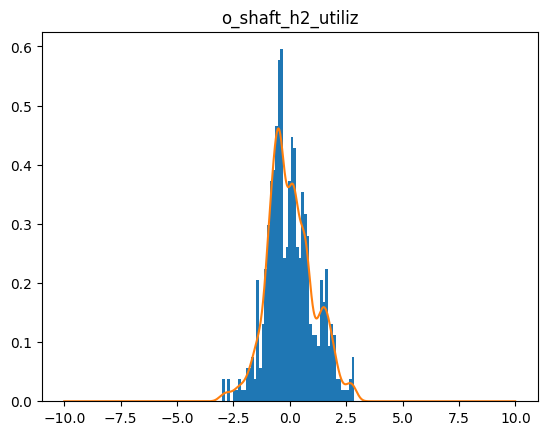

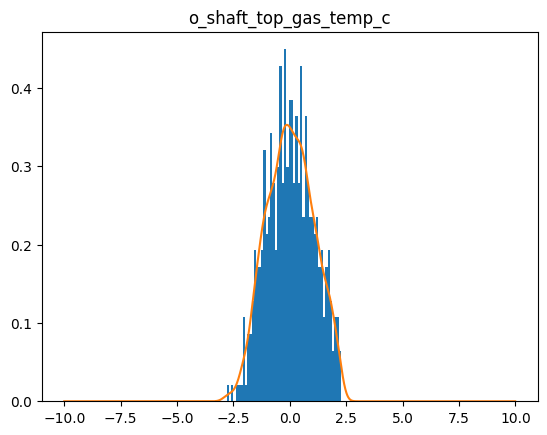

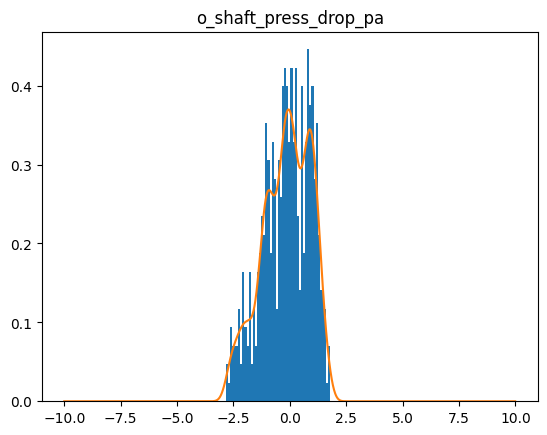

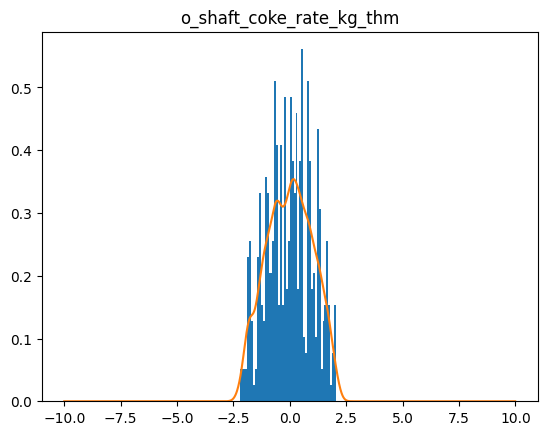

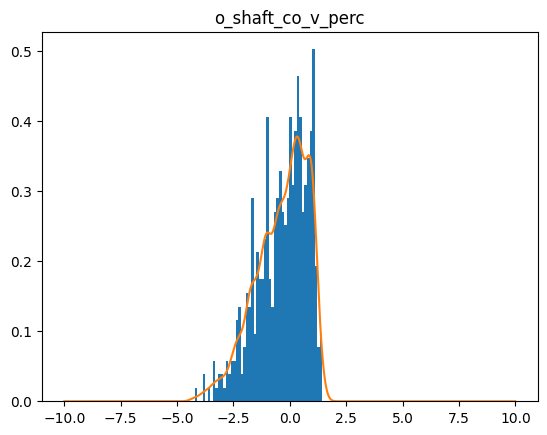

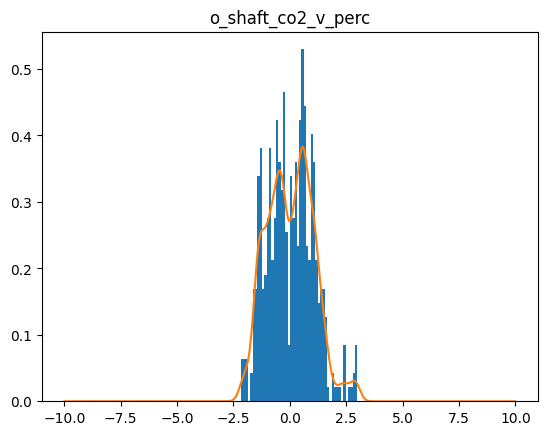

torch.Size([2000])
2101  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2102  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2103  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2104  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2105  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2106  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2107  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2108  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2109  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2110  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2111  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2112  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2113  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2114  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2115  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2116  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2117  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2118  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2119  loss=  tensor(0.0005,

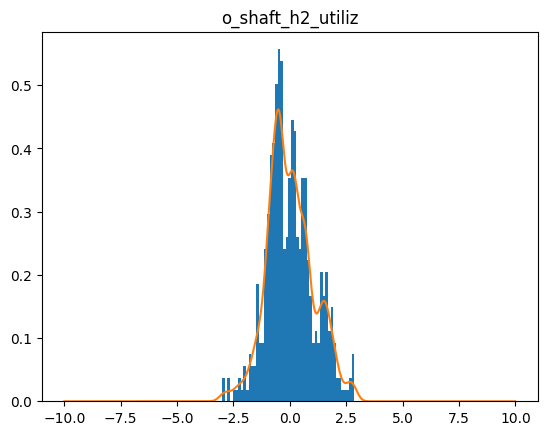

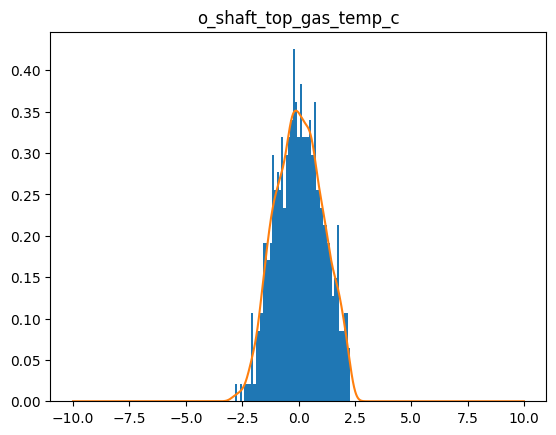

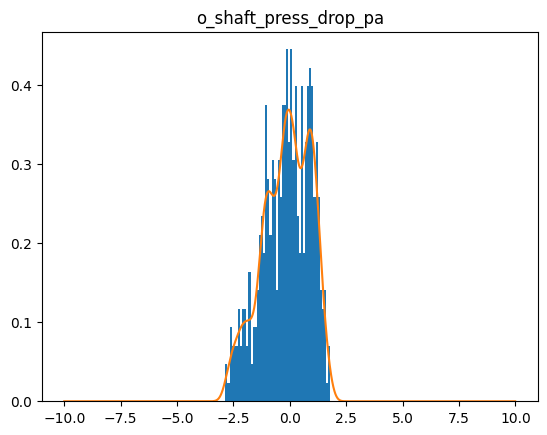

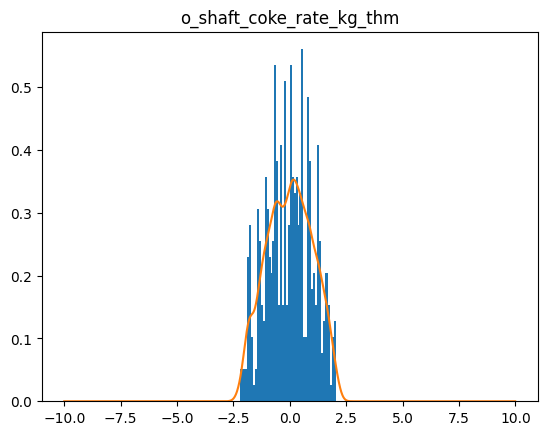

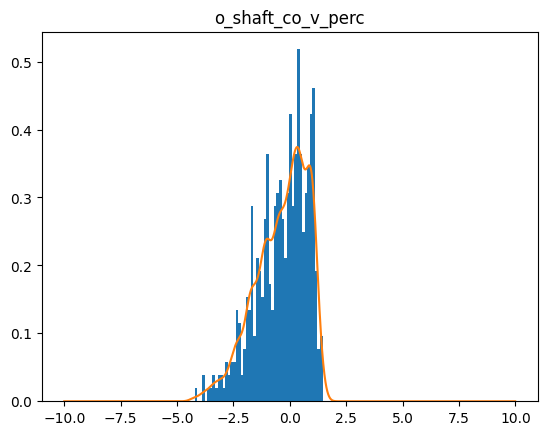

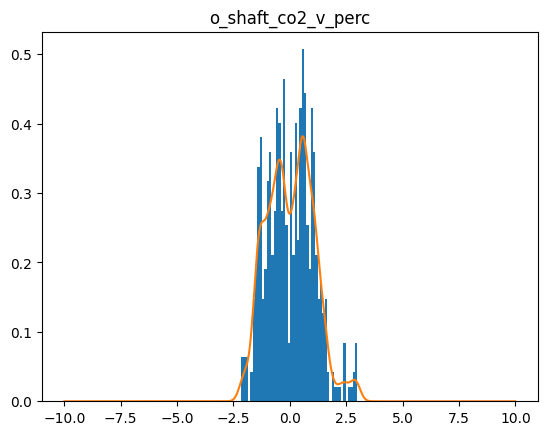

torch.Size([2000])
2201  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2202  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2203  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2204  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2205  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2206  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2207  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2208  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2209  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2210  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2211  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2212  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2213  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2214  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2215  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2216  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2217  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2218  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2219  loss=  tensor(0.0005,

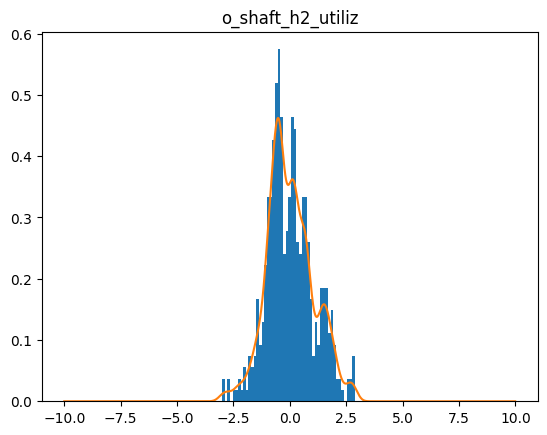

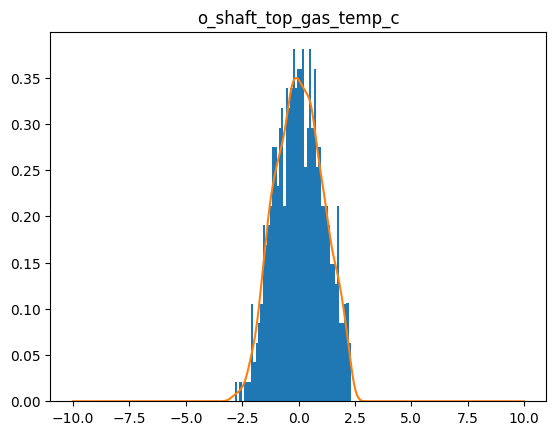

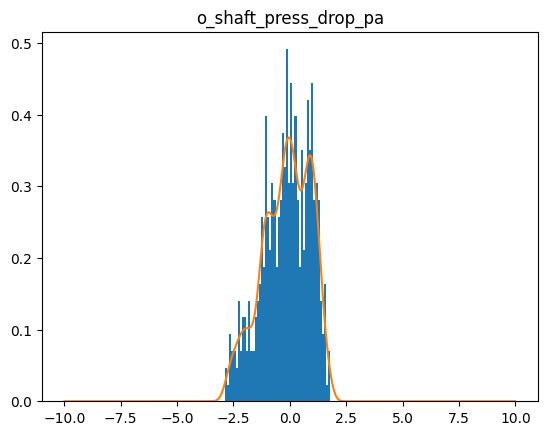

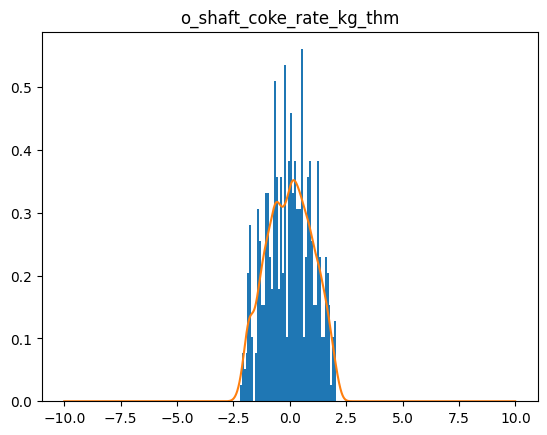

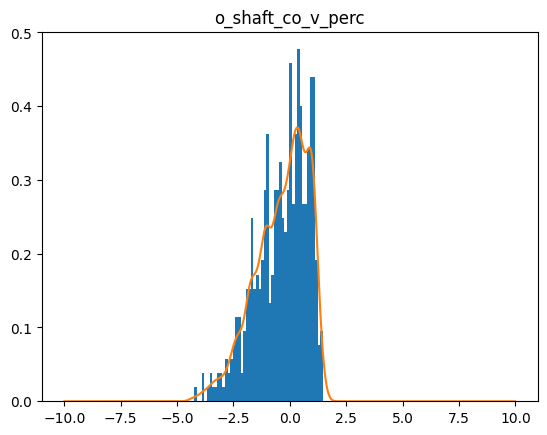

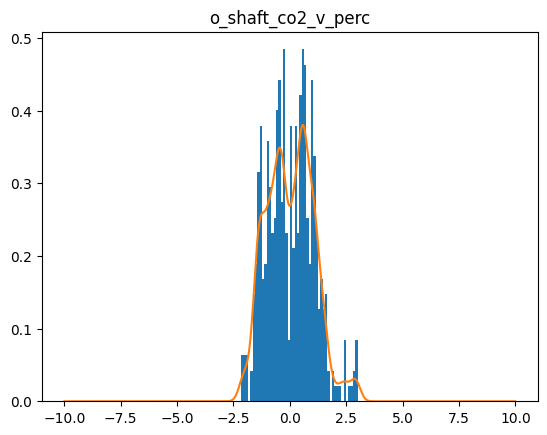

torch.Size([2000])
2301  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2302  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2303  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2304  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2305  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2306  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2307  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2308  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2309  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2310  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2311  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2312  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2313  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2314  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2315  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2316  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2317  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2318  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2319  loss=  tensor(0.0005,

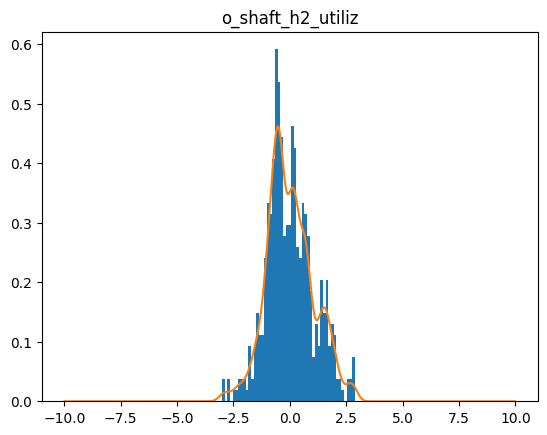

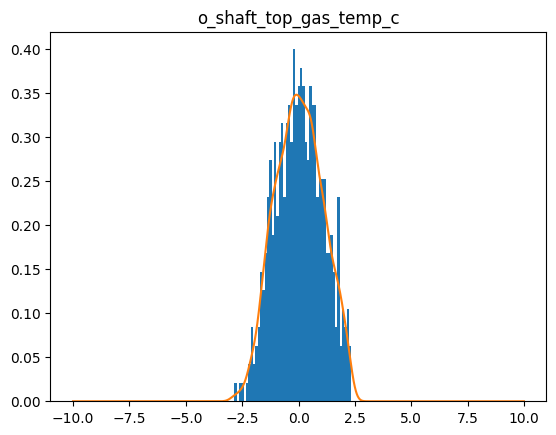

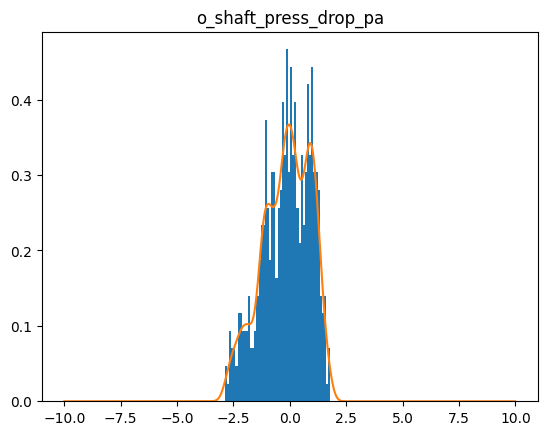

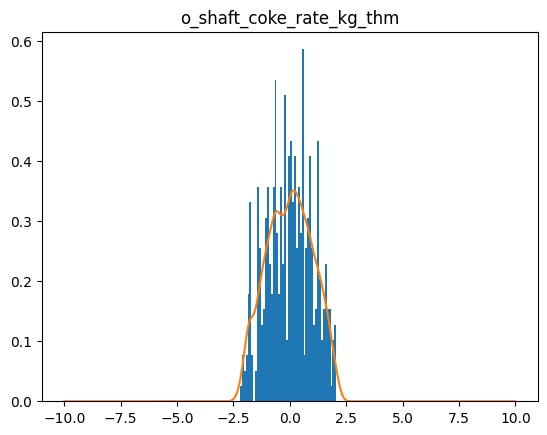

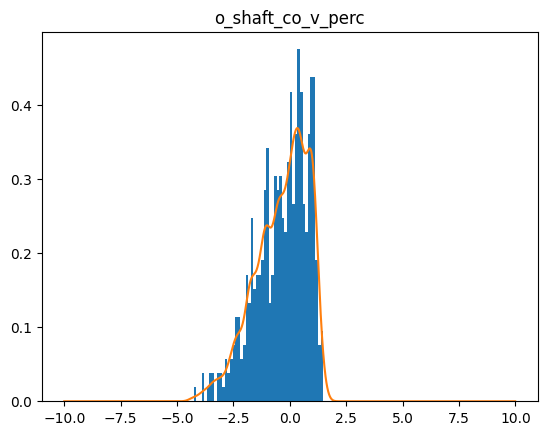

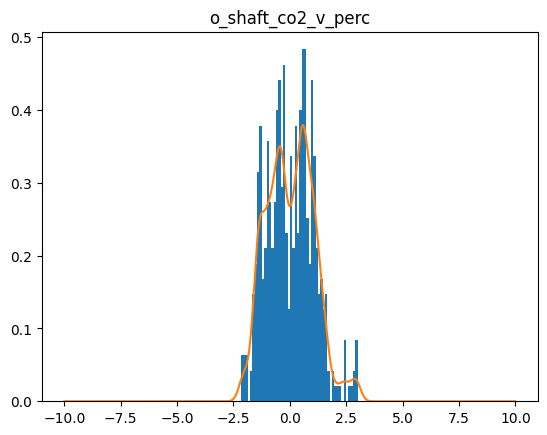

torch.Size([2000])
2401  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2402  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2403  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2404  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2405  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2406  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2407  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2408  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2409  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2410  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2411  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2412  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2413  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2414  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2415  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2416  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2417  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2418  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2419  loss=  tensor(0.0005,

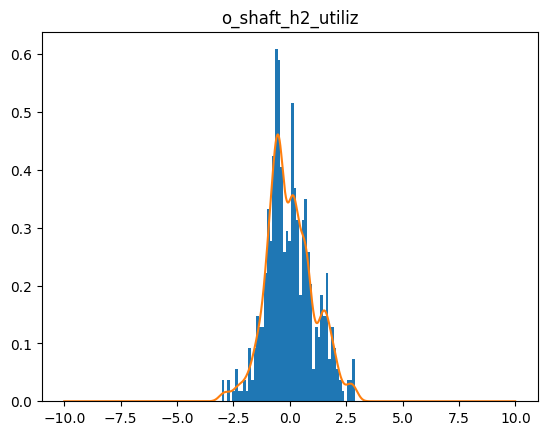

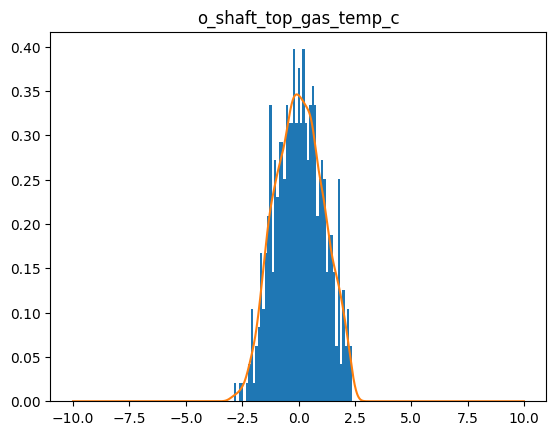

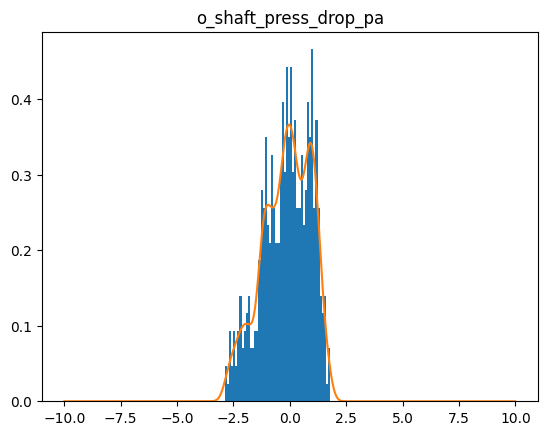

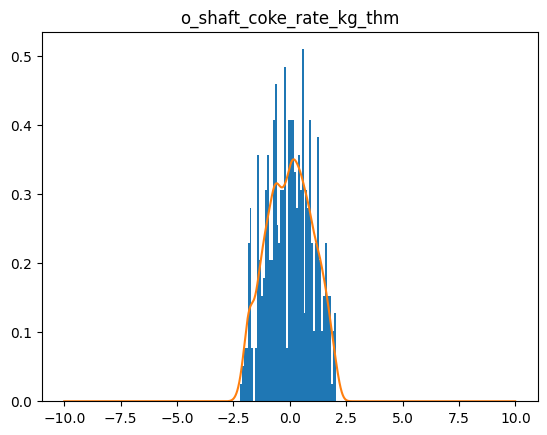

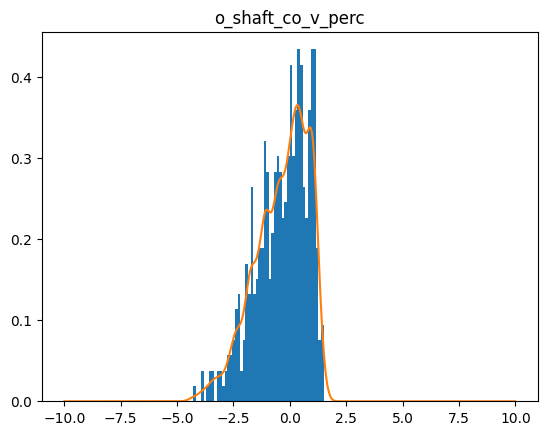

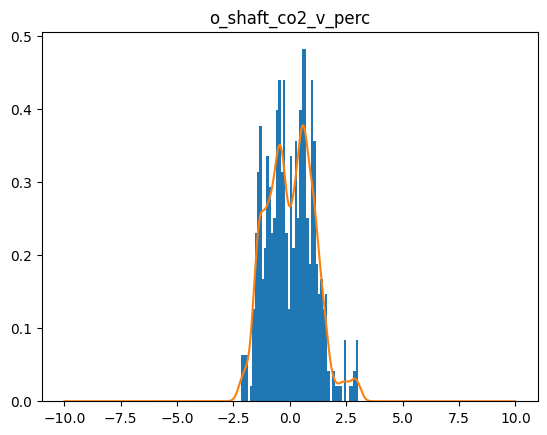

torch.Size([2000])
2501  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2502  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2503  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2504  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2505  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2506  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2507  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2508  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2509  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2510  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2511  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2512  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2513  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2514  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2515  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2516  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2517  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2518  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2519  loss=  tensor(0.0005,

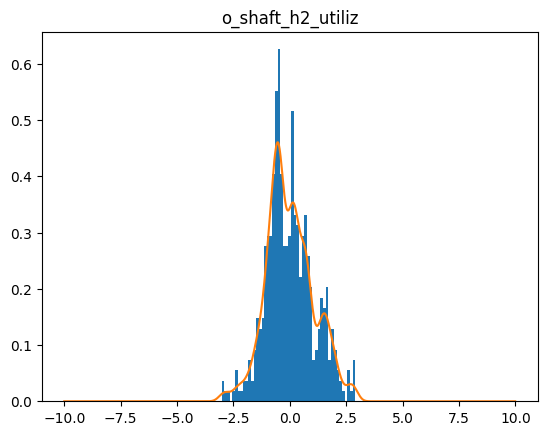

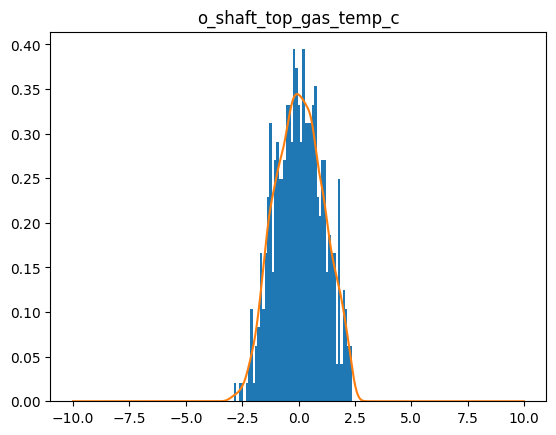

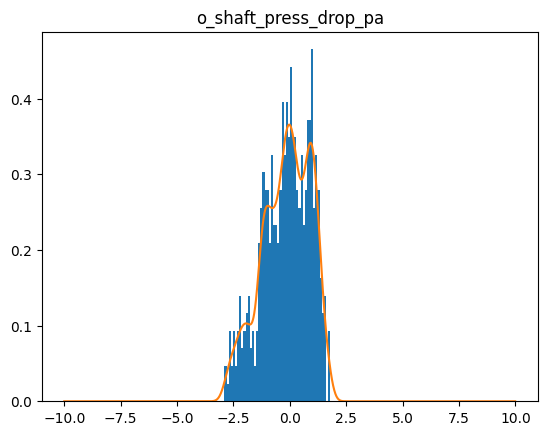

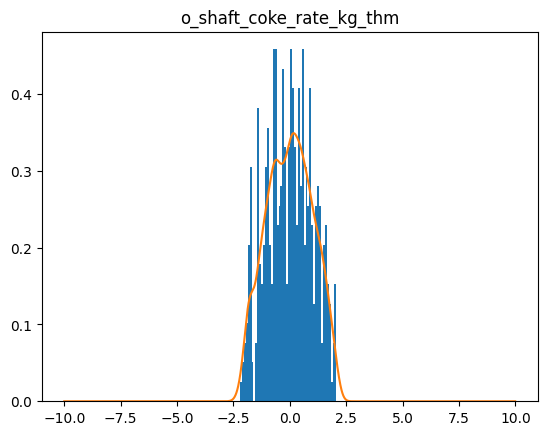

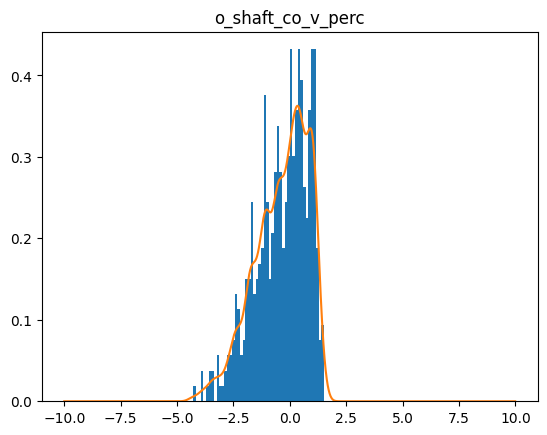

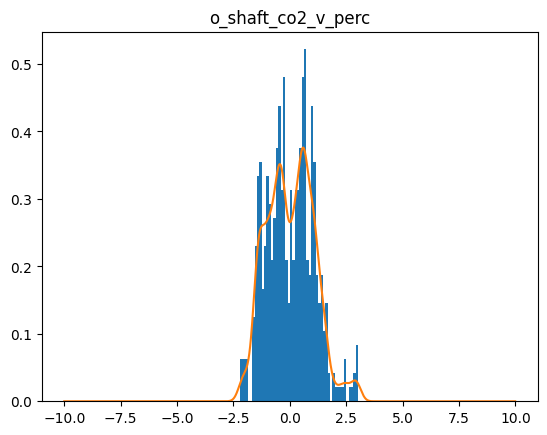

torch.Size([2000])
2601  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2602  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2603  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2604  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2605  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2606  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2607  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2608  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2609  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2610  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2611  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2612  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2613  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2614  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2615  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2616  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2617  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2618  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2619  loss=  tensor(0.0005,

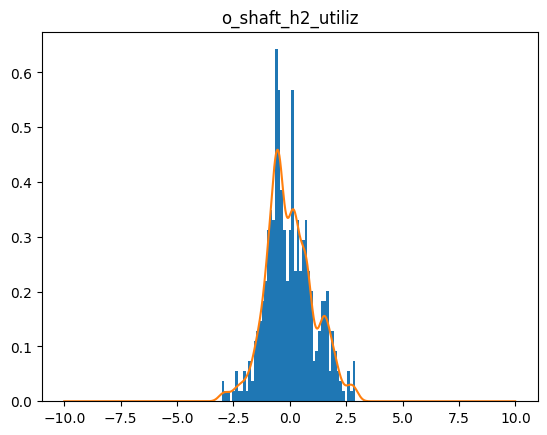

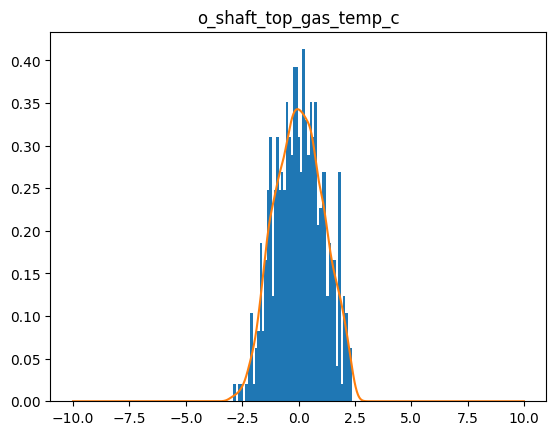

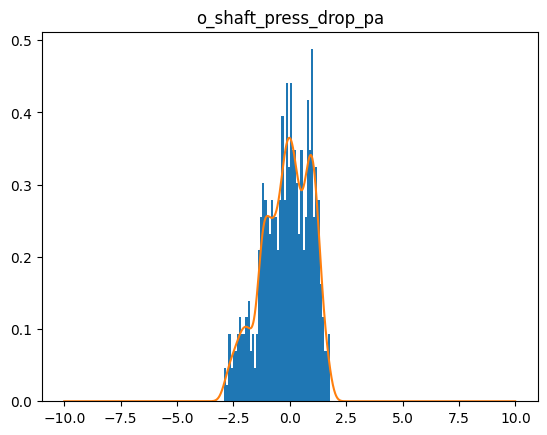

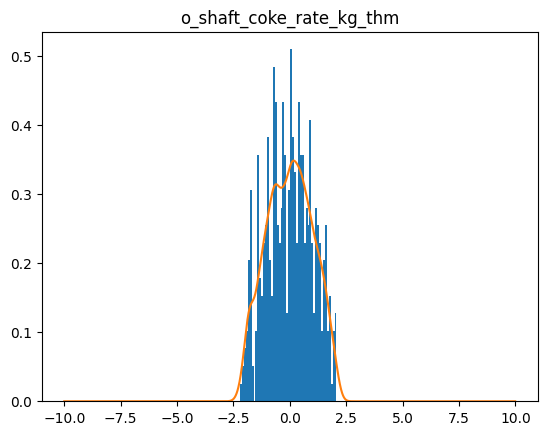

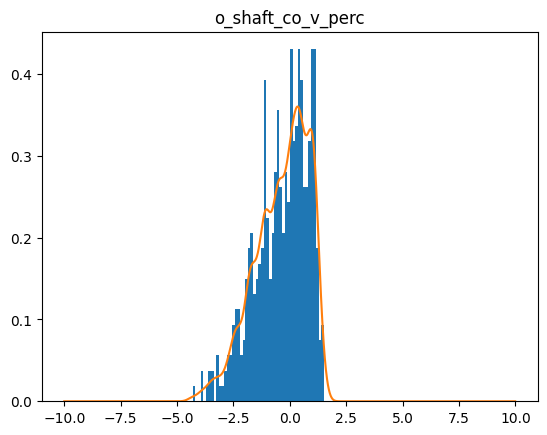

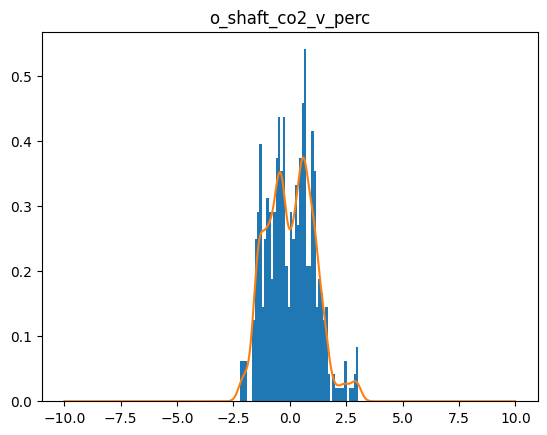

torch.Size([2000])
2701  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2702  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2703  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2704  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2705  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2706  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2707  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2708  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2709  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2710  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2711  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2712  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2713  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2714  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2715  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2716  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2717  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2718  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2719  loss=  tensor(0.0005,

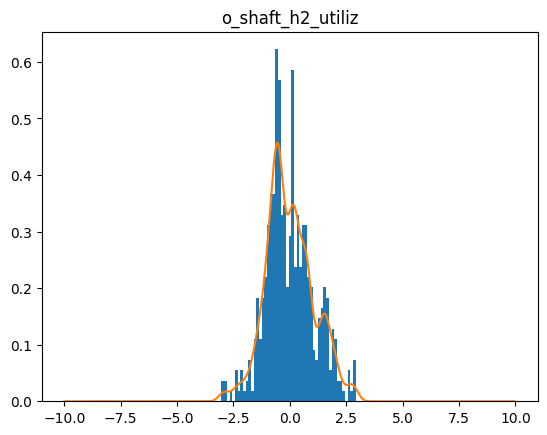

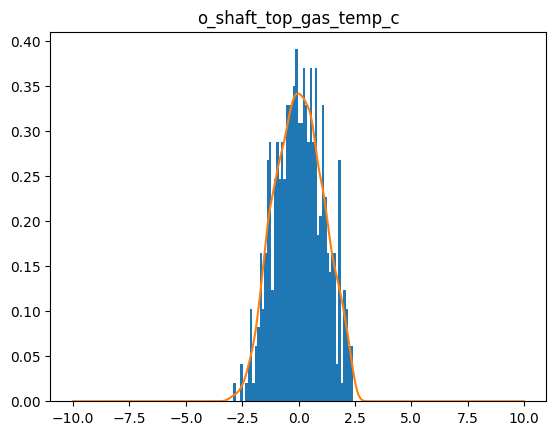

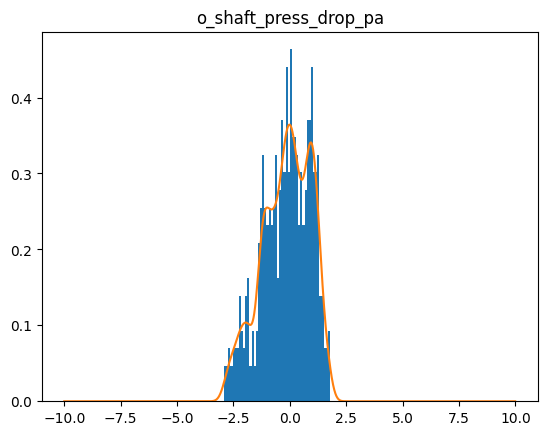

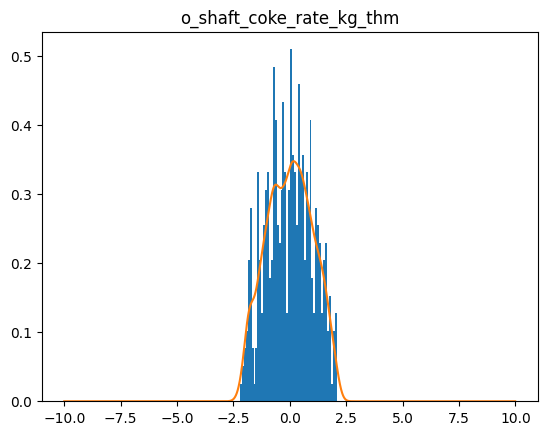

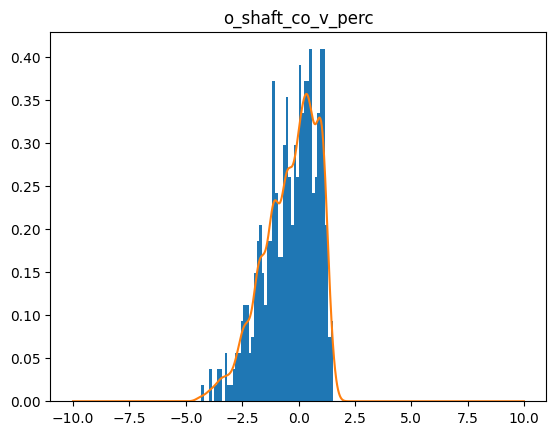

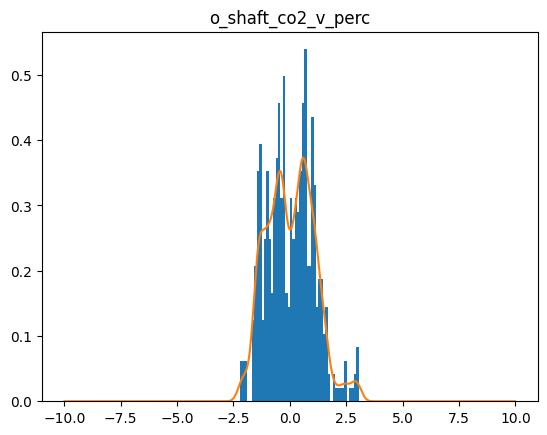

torch.Size([2000])
2801  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2802  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2803  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2804  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2805  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2806  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2807  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2808  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2809  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2810  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2811  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2812  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2813  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2814  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2815  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2816  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2817  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2818  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2819  loss=  tensor(0.0005,

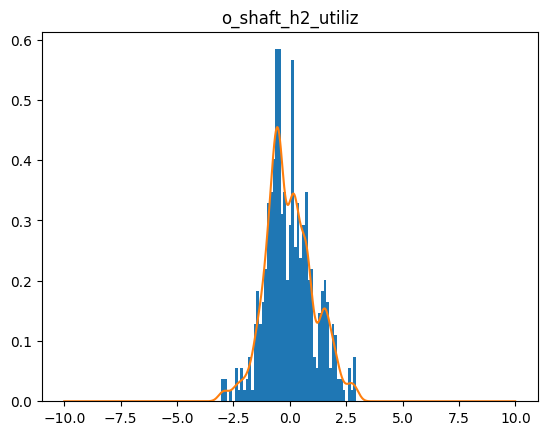

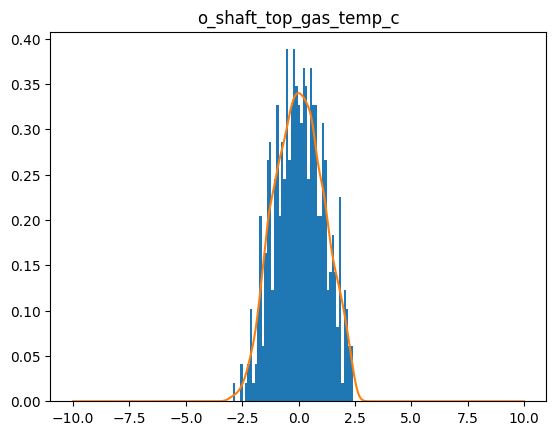

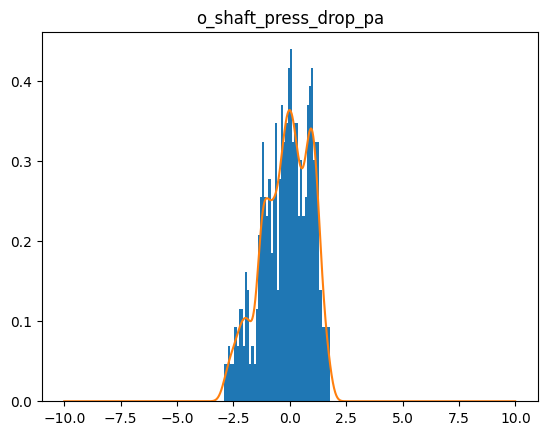

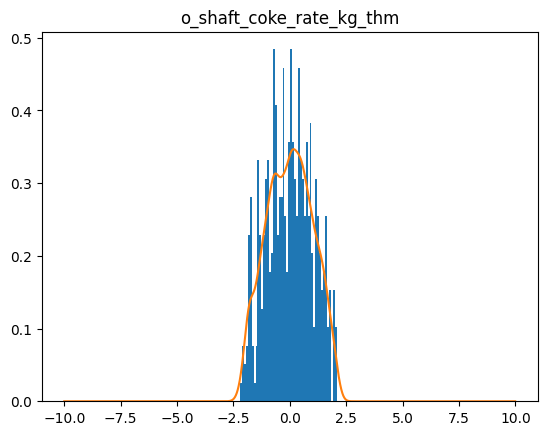

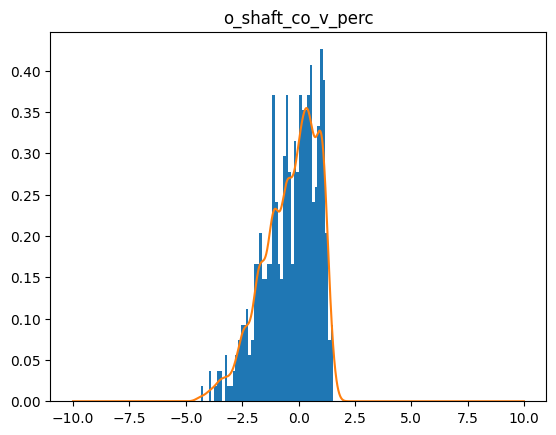

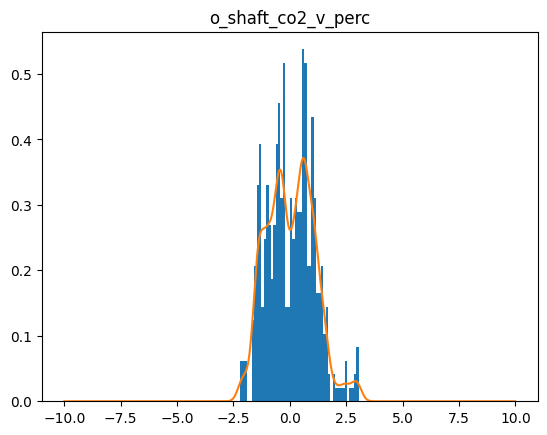

torch.Size([2000])
2901  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2902  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2903  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2904  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2905  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2906  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2907  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2908  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2909  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2910  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2911  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2912  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2913  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2914  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2915  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2916  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2917  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2918  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
2919  loss=  tensor(0.0005,

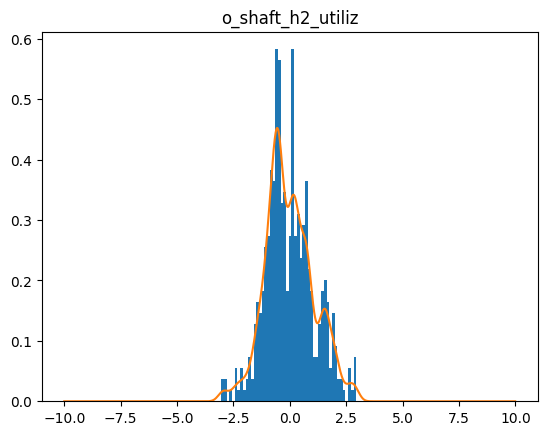

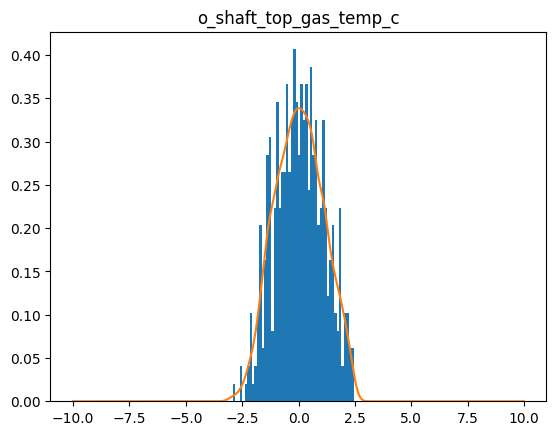

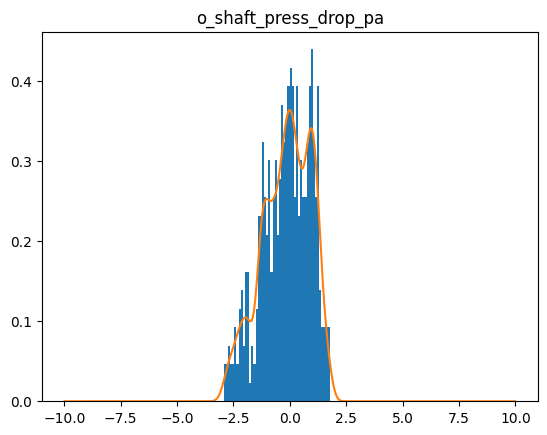

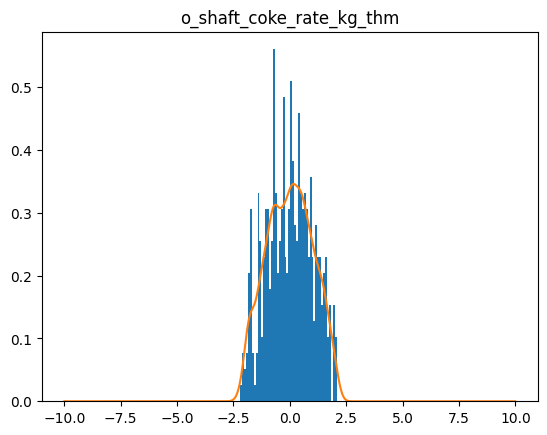

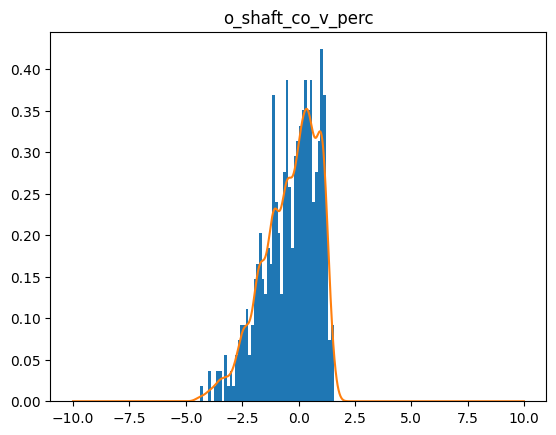

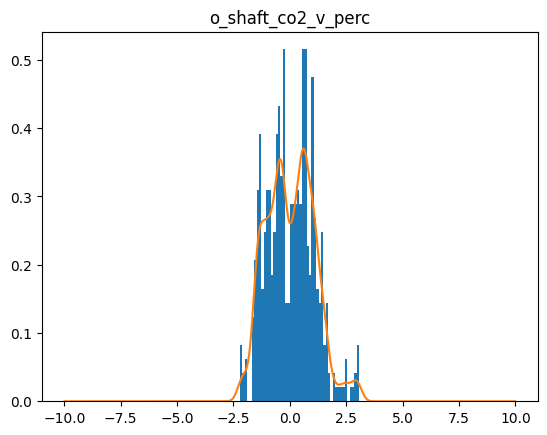

torch.Size([2000])
3001  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3002  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3003  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3004  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3005  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3006  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3007  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3008  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3009  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3010  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3011  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3012  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3013  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3014  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3015  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3016  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3017  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3018  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3019  loss=  tensor(0.0005,

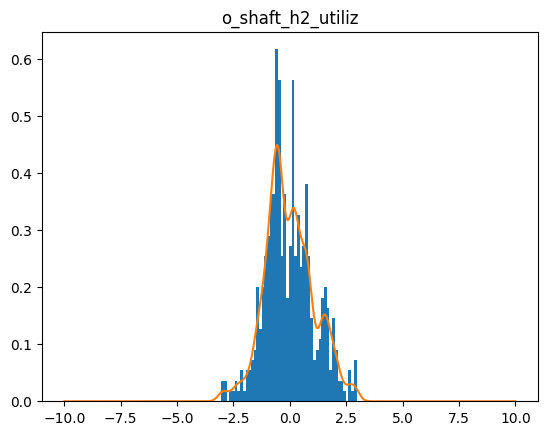

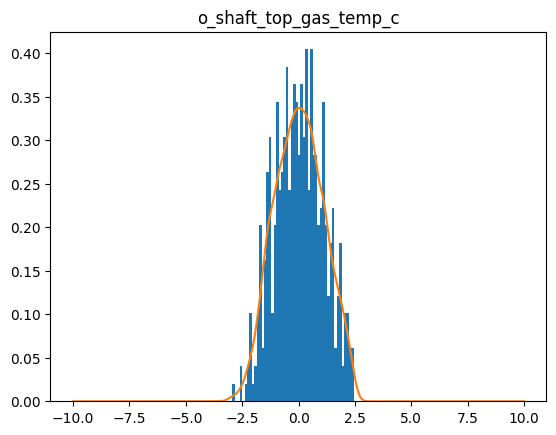

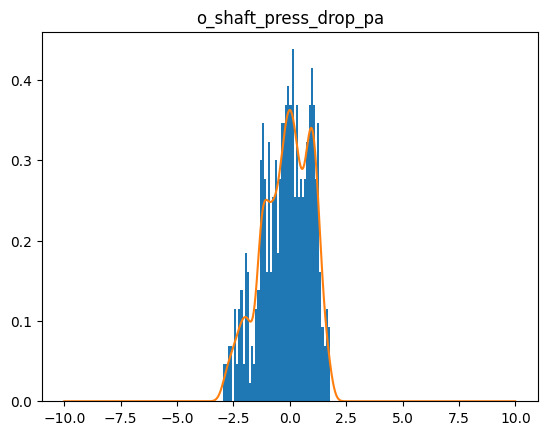

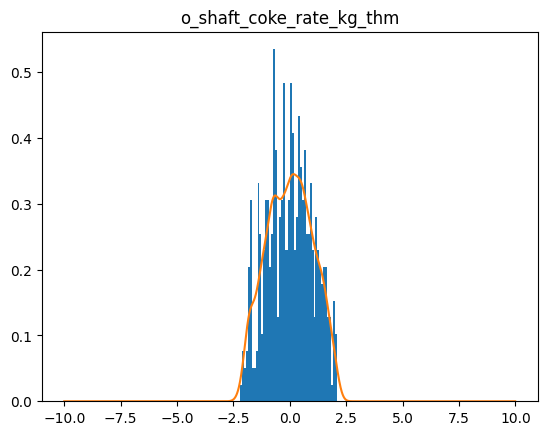

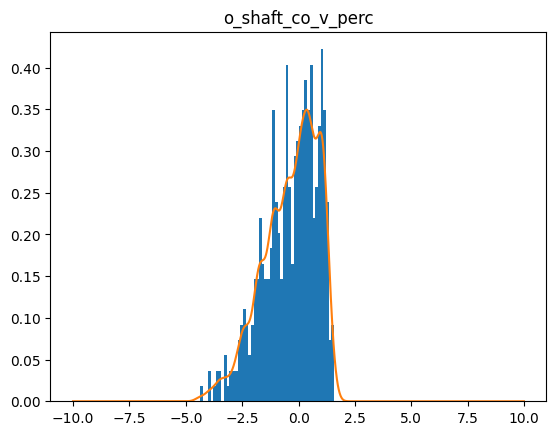

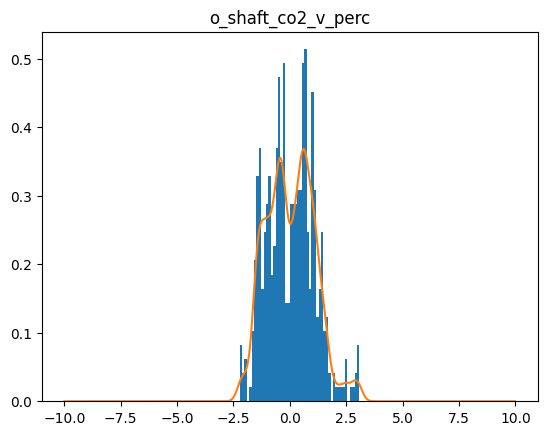

torch.Size([2000])
3101  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3102  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3103  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3104  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3105  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3106  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3107  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3108  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3109  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3110  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3111  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3112  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3113  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3114  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3115  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3116  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3117  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3118  loss=  tensor(0.0005, grad_fn=<MeanBackward0>)
3119  loss=  tensor(0.0005,

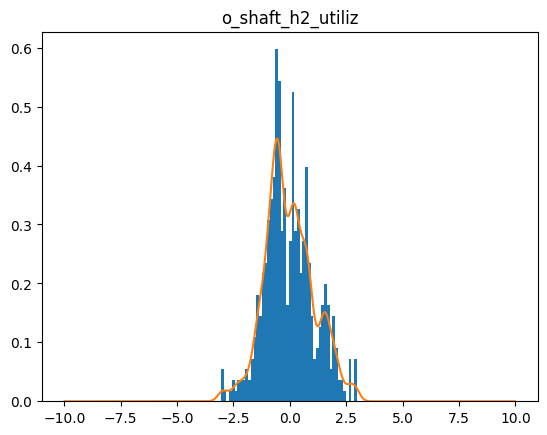

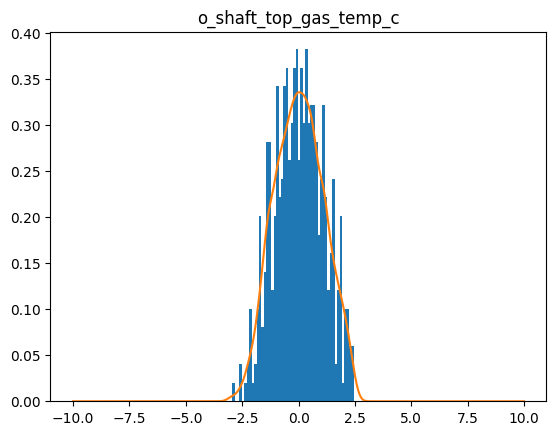

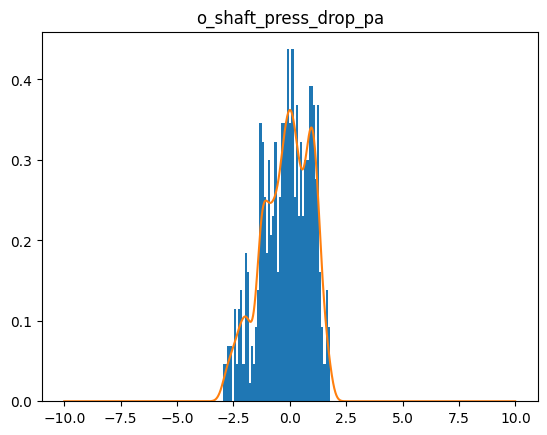

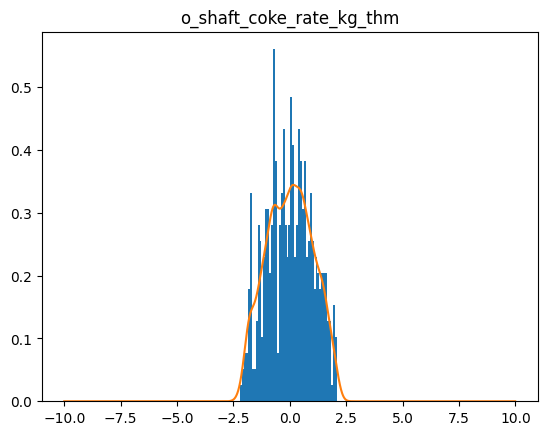

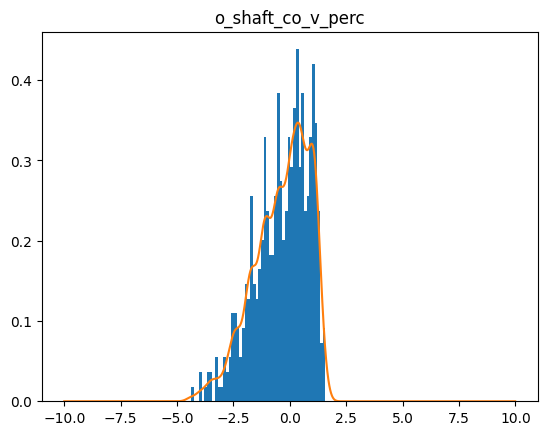

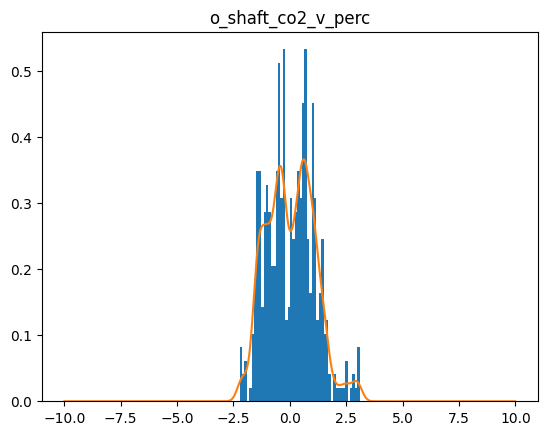

torch.Size([2000])
3201  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3202  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3203  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3204  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3205  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3206  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3207  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3208  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3209  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3210  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3211  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3212  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3213  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3214  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3215  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3216  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3217  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3218  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3219  loss=  tensor(0.0004,

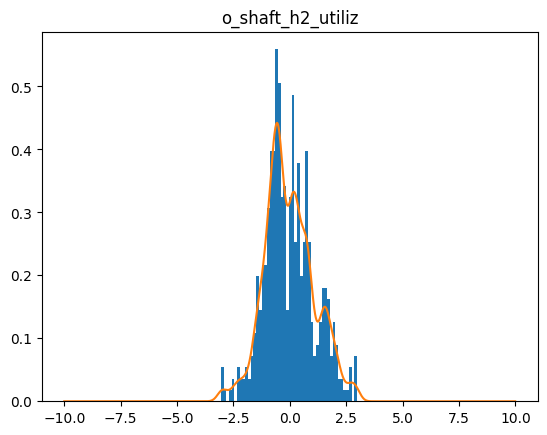

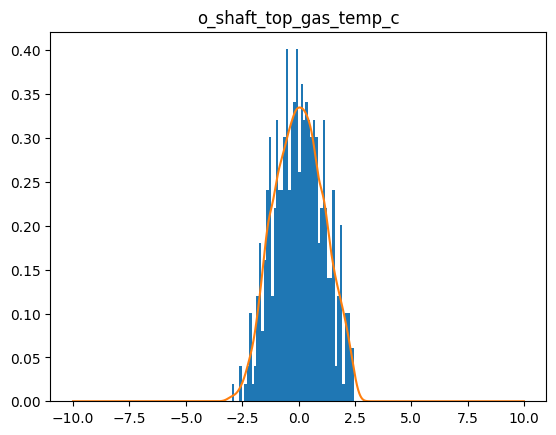

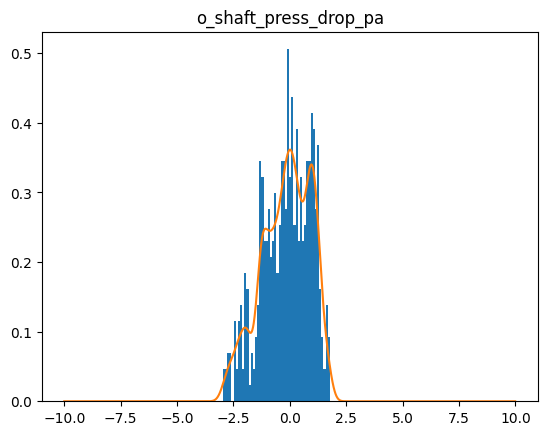

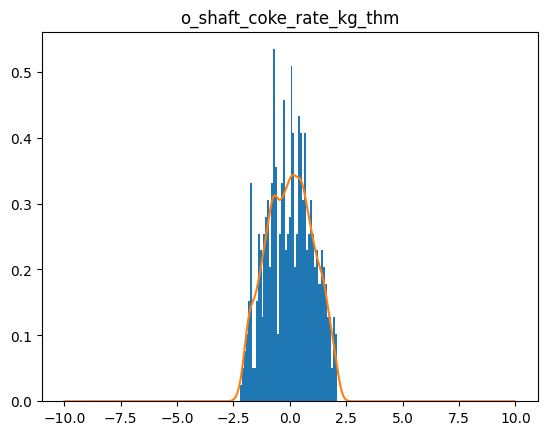

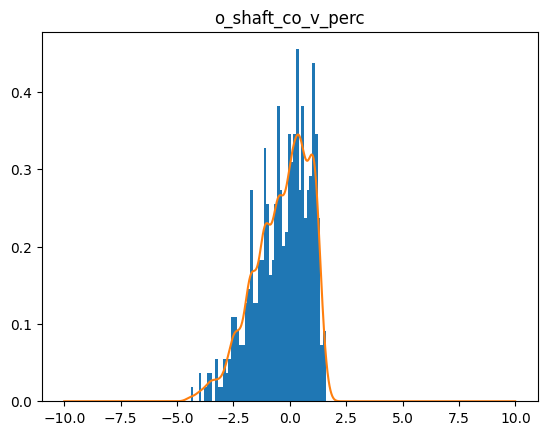

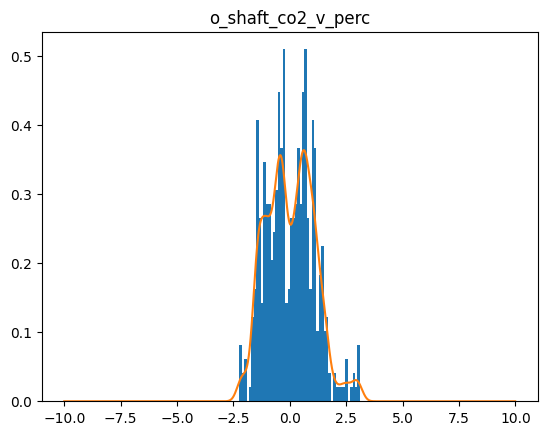

torch.Size([2000])
3301  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3302  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3303  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3304  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3305  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3306  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3307  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3308  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3309  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3310  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3311  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3312  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3313  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3314  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3315  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3316  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3317  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3318  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3319  loss=  tensor(0.0004,

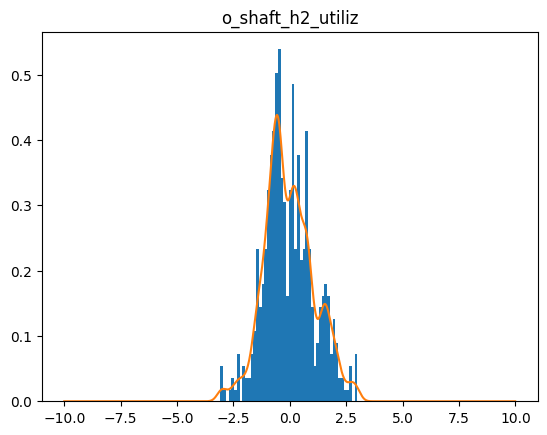

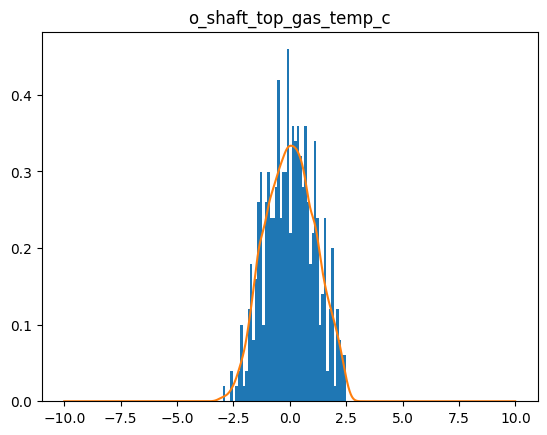

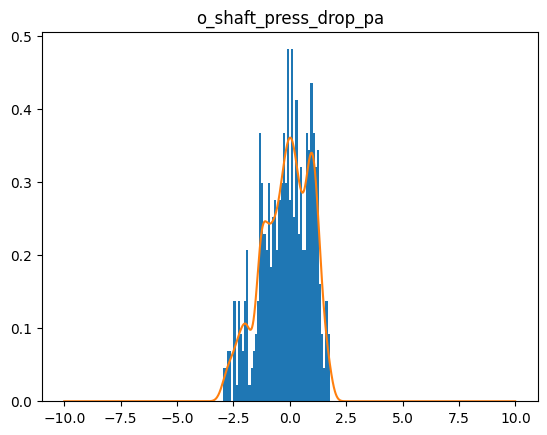

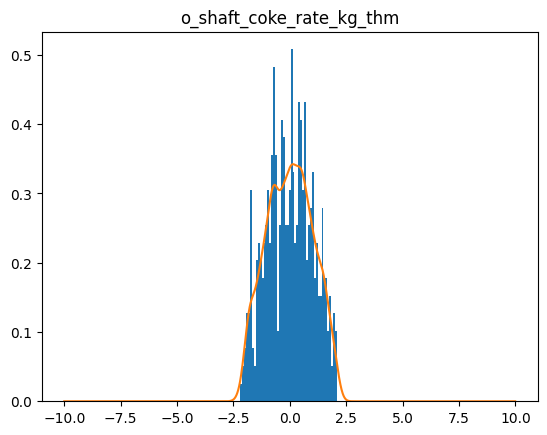

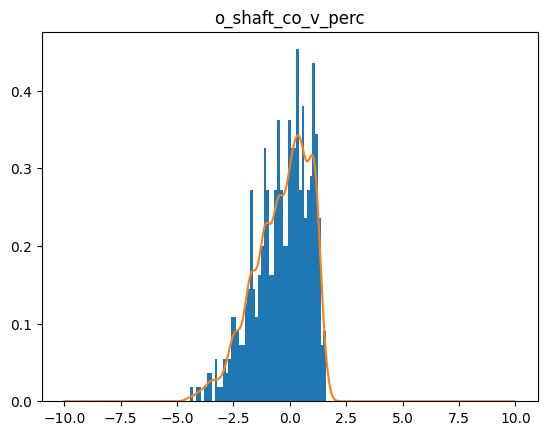

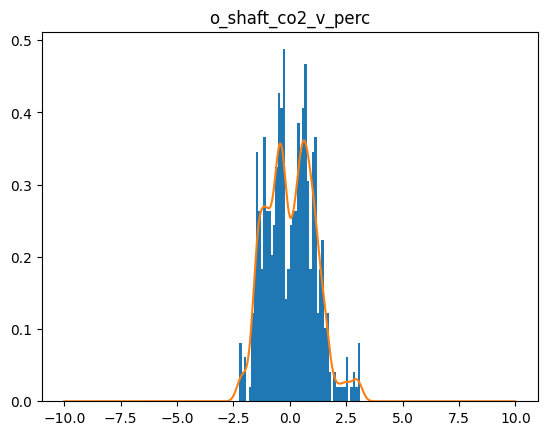

torch.Size([2000])
3401  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3402  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3403  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3404  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3405  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3406  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3407  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3408  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3409  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3410  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3411  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3412  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3413  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3414  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3415  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3416  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3417  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3418  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3419  loss=  tensor(0.0004,

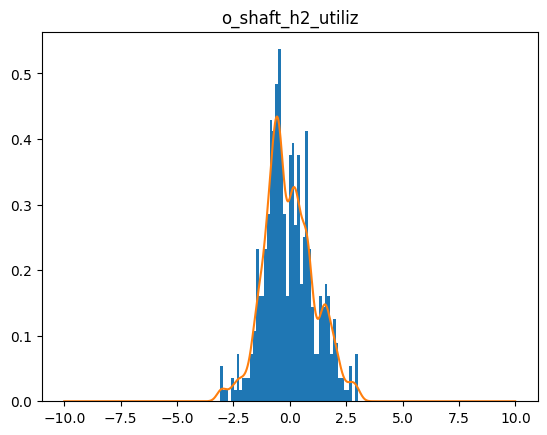

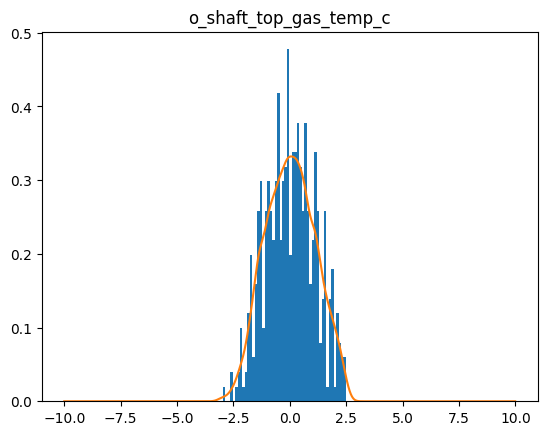

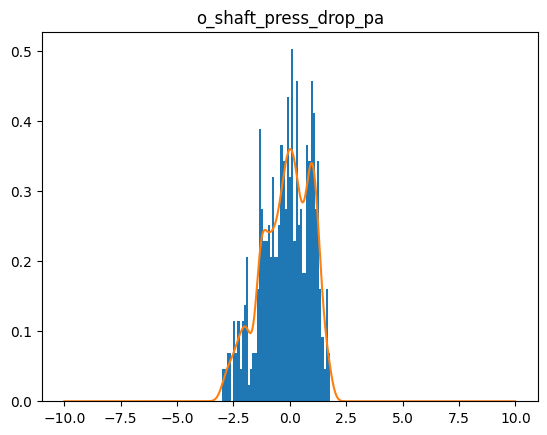

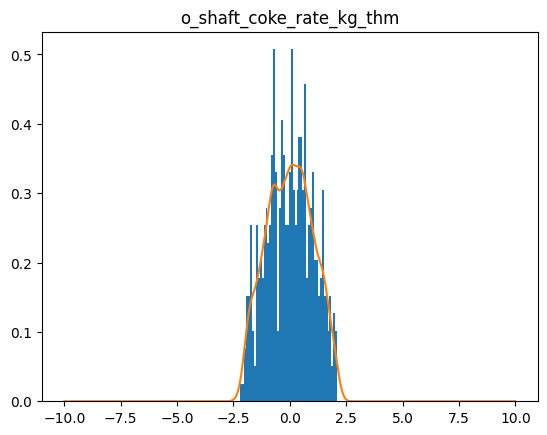

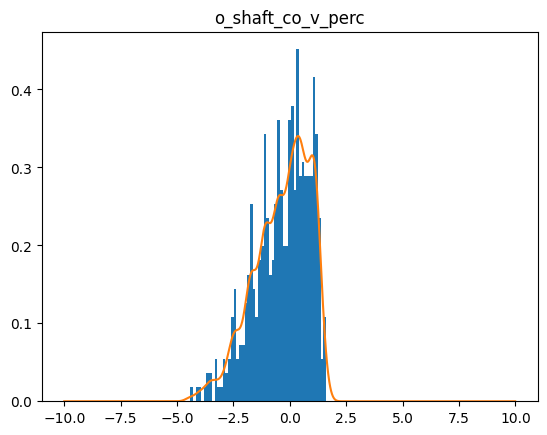

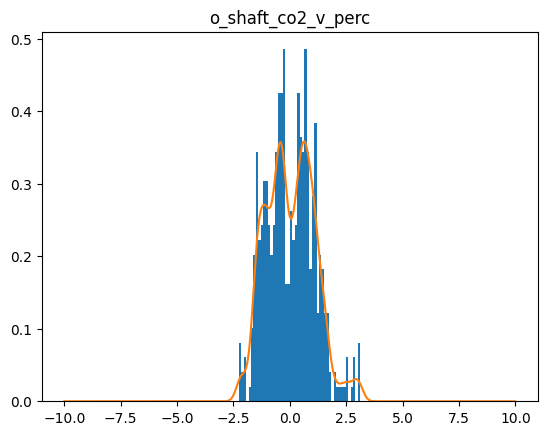

torch.Size([2000])
3501  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3502  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3503  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3504  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3505  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3506  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3507  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3508  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3509  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3510  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3511  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3512  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3513  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3514  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3515  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3516  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3517  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3518  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3519  loss=  tensor(0.0004,

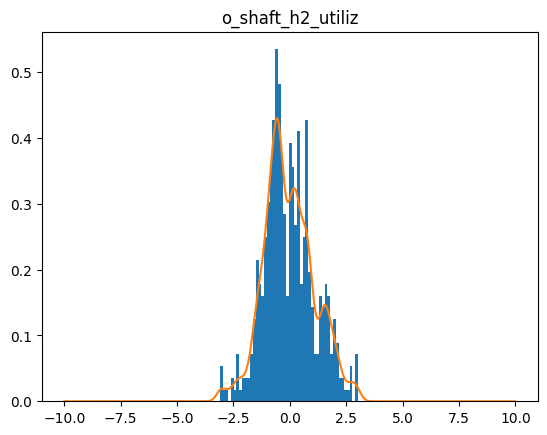

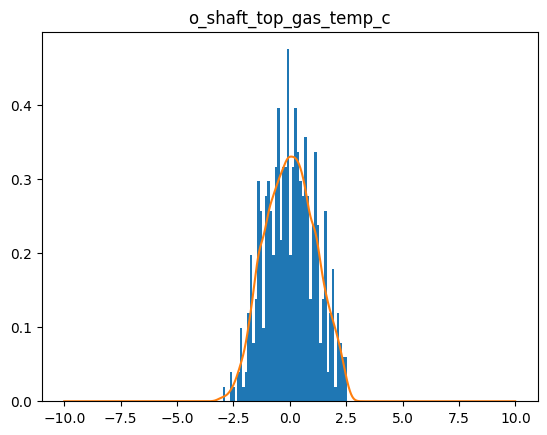

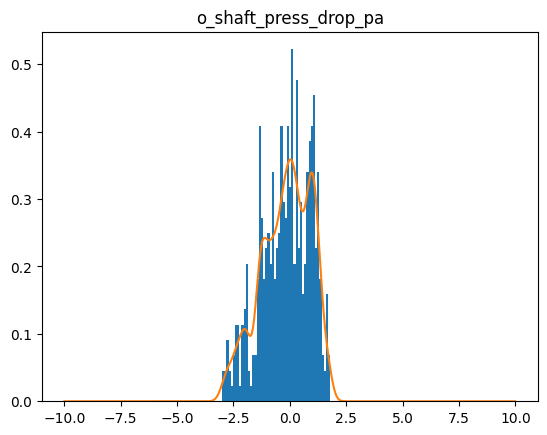

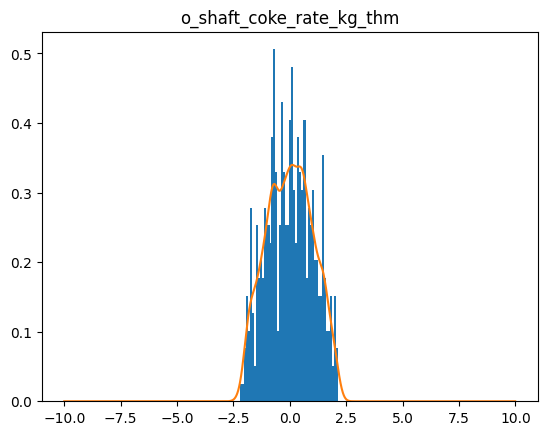

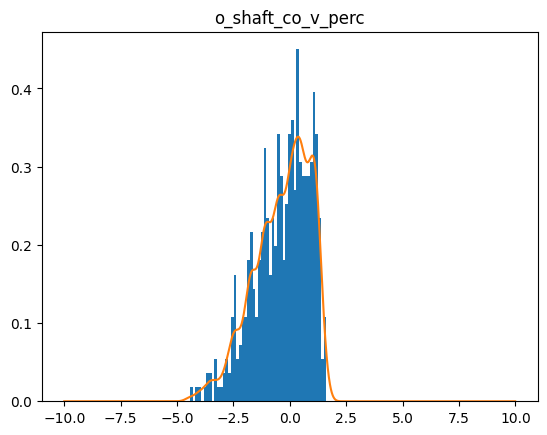

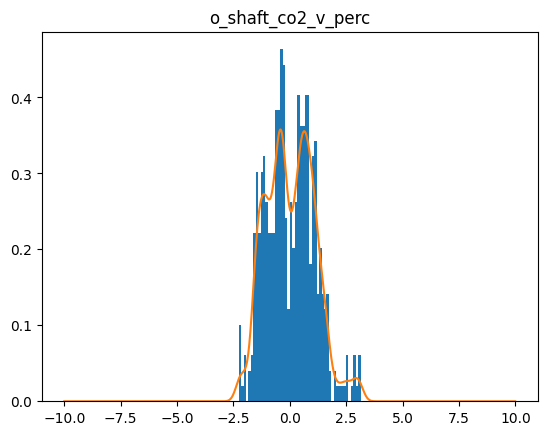

torch.Size([2000])
3601  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3602  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3603  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3604  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3605  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3606  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3607  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3608  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3609  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3610  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3611  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3612  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3613  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3614  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3615  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3616  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3617  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3618  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3619  loss=  tensor(0.0004,

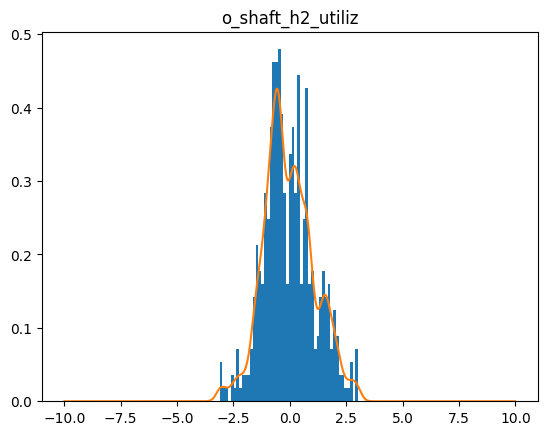

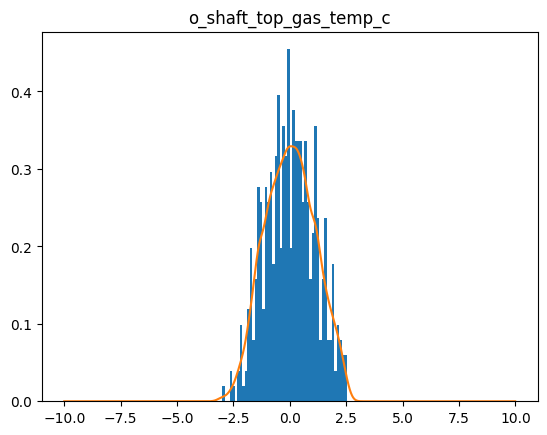

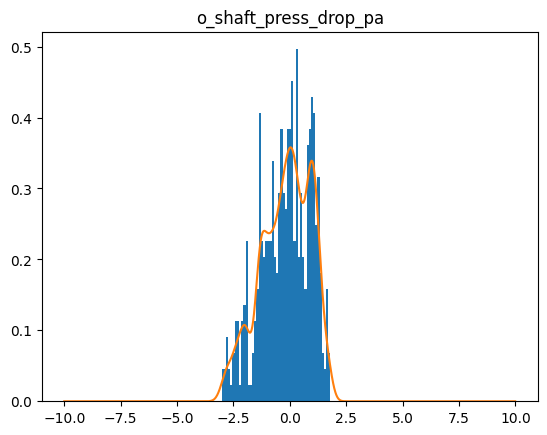

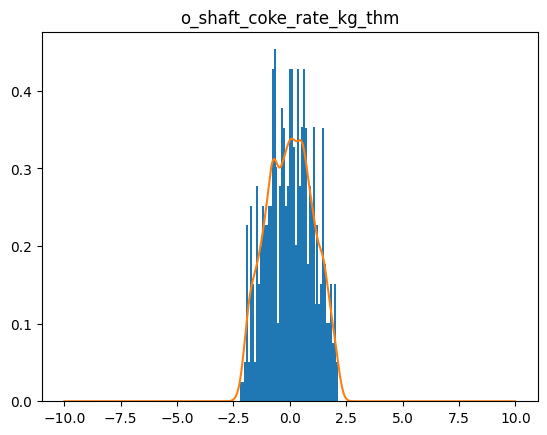

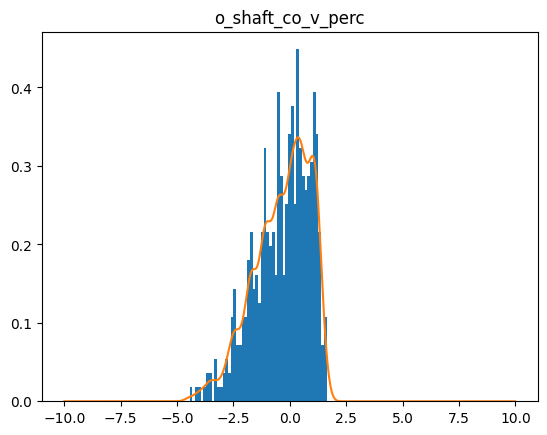

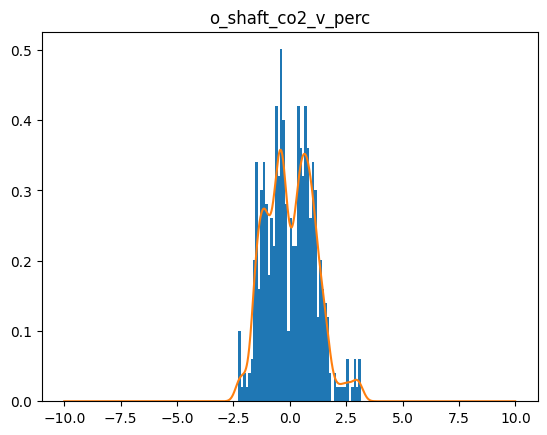

torch.Size([2000])
3701  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3702  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3703  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3704  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3705  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3706  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3707  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3708  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3709  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3710  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3711  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3712  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3713  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3714  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3715  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3716  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3717  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3718  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3719  loss=  tensor(0.0004,

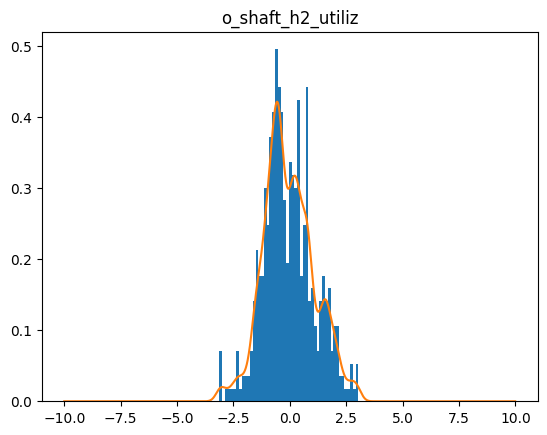

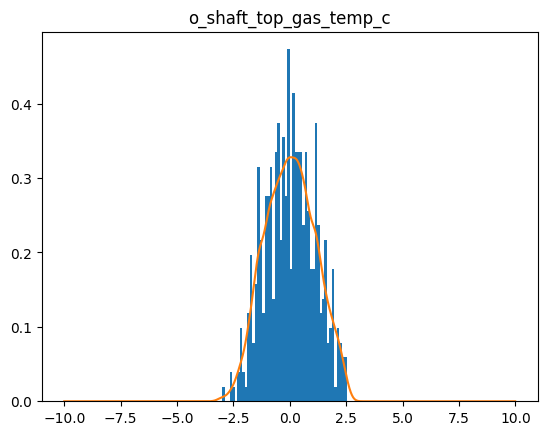

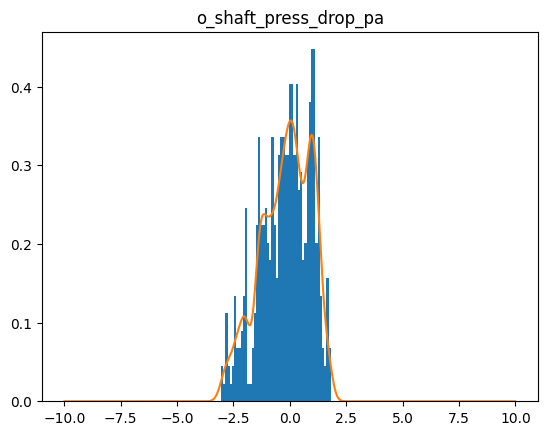

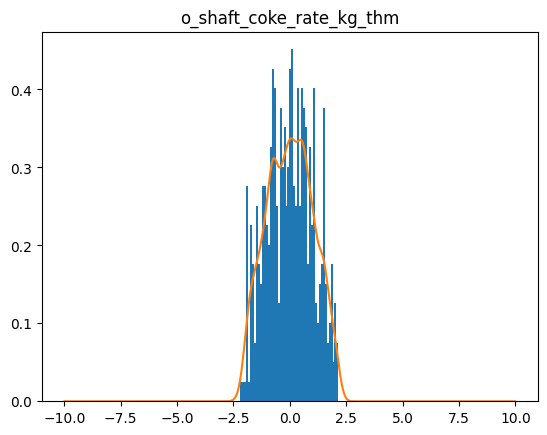

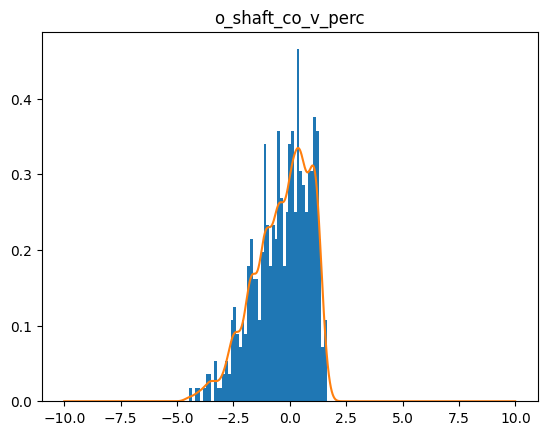

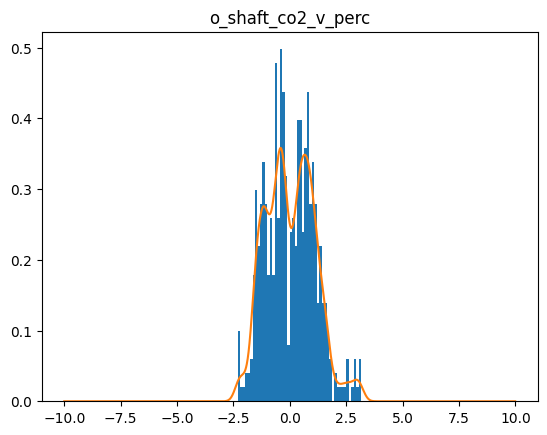

torch.Size([2000])
3801  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3802  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3803  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3804  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3805  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3806  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3807  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3808  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3809  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3810  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3811  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3812  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3813  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3814  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3815  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3816  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3817  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3818  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3819  loss=  tensor(0.0004,

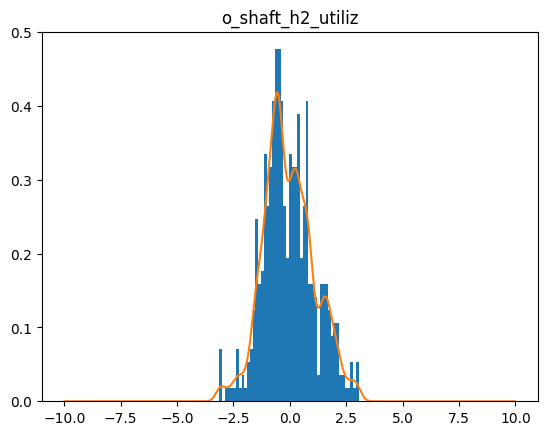

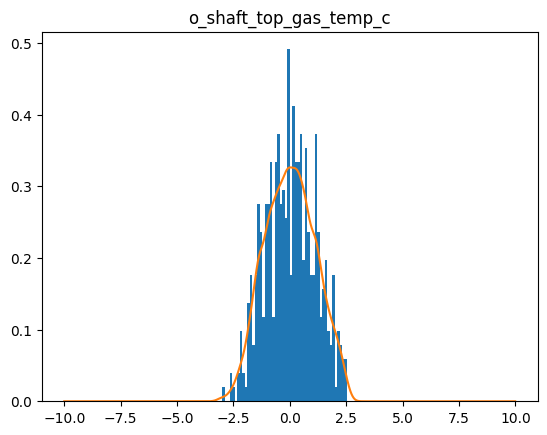

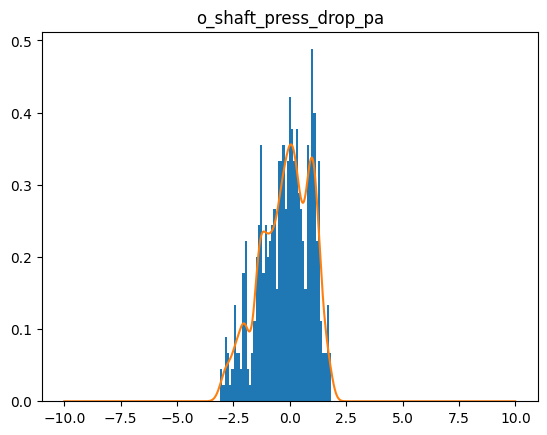

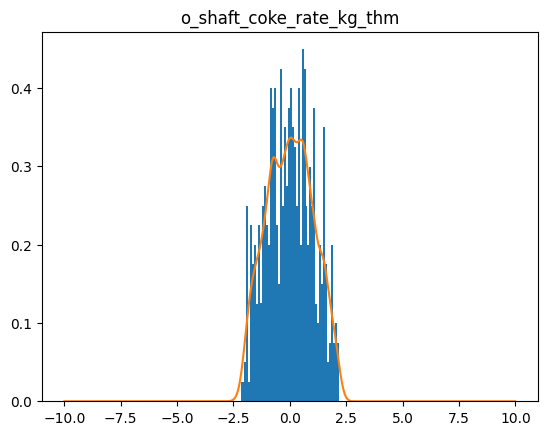

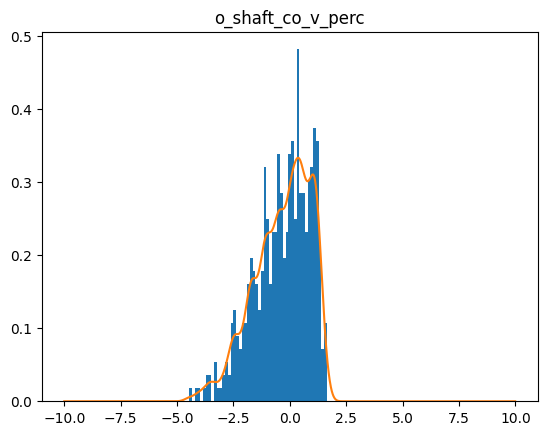

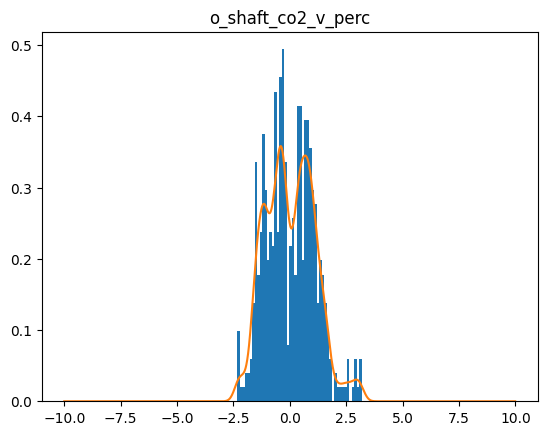

torch.Size([2000])
3901  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3902  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3903  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3904  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3905  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3906  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3907  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3908  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3909  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3910  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3911  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3912  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3913  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3914  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3915  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3916  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3917  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3918  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
3919  loss=  tensor(0.0004,

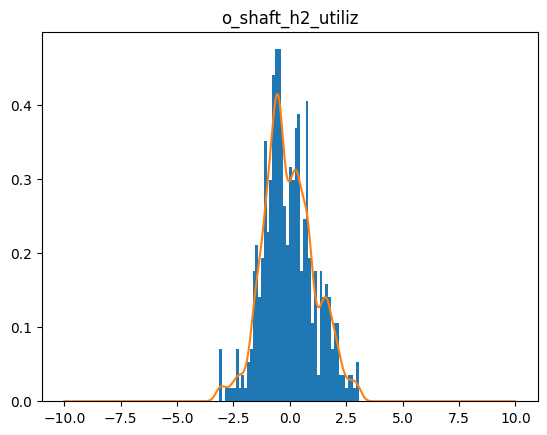

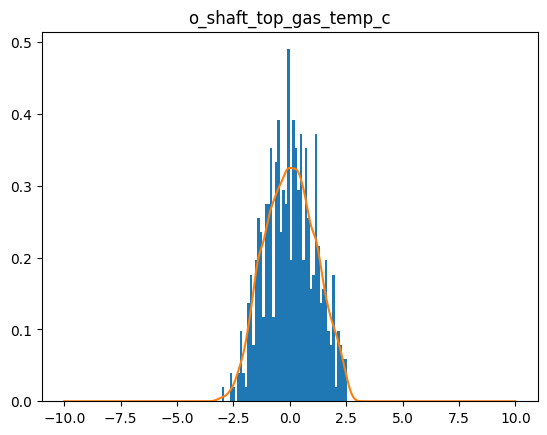

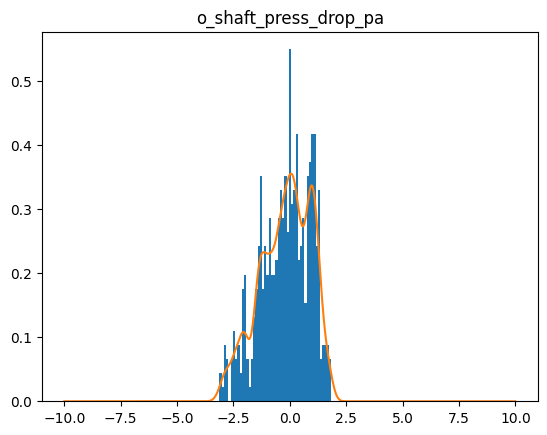

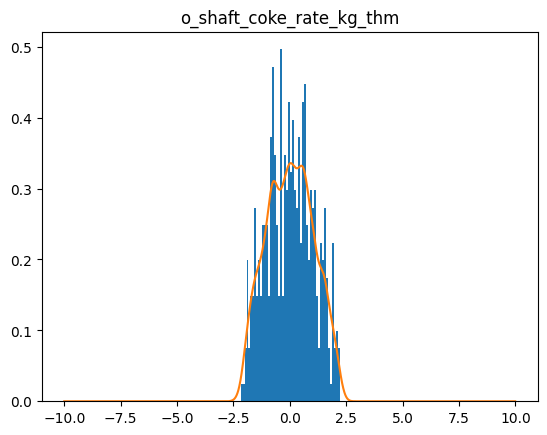

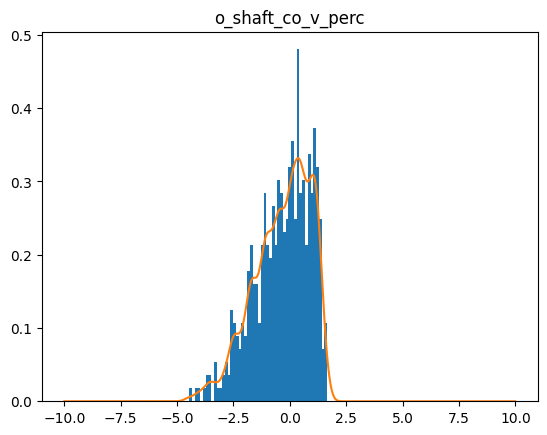

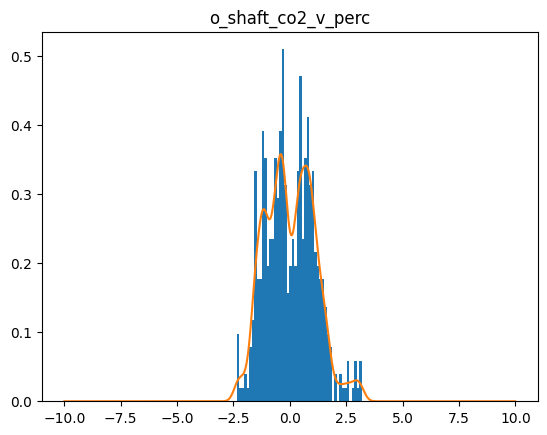

torch.Size([2000])
4001  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4002  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4003  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4004  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4005  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4006  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4007  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4008  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4009  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4010  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4011  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4012  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4013  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4014  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4015  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4016  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4017  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4018  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4019  loss=  tensor(0.0004,

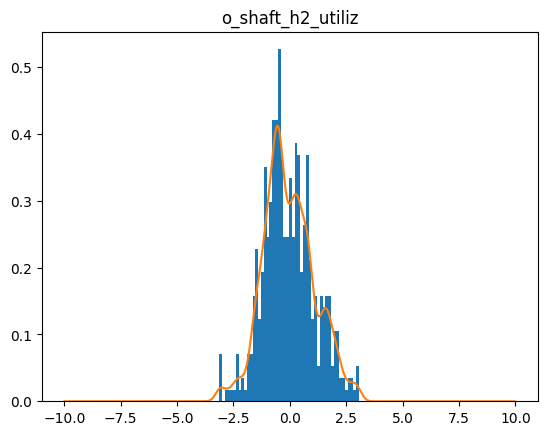

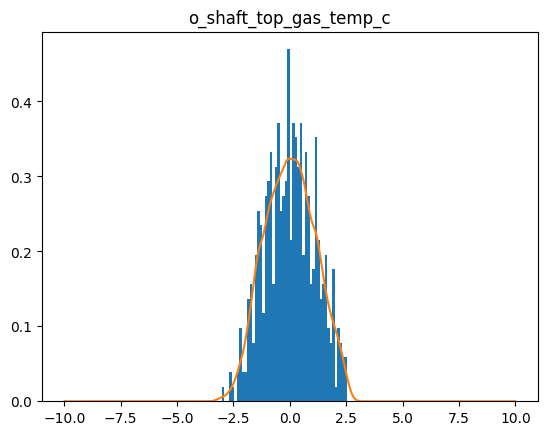

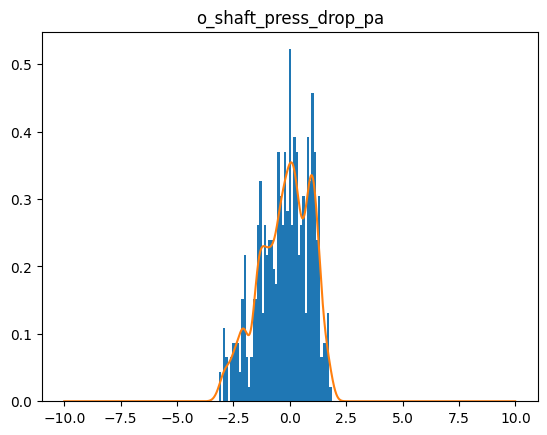

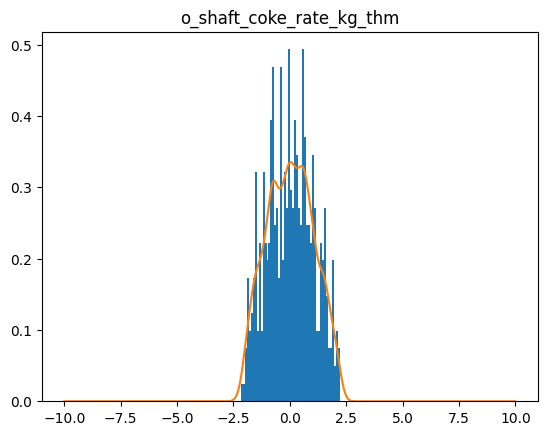

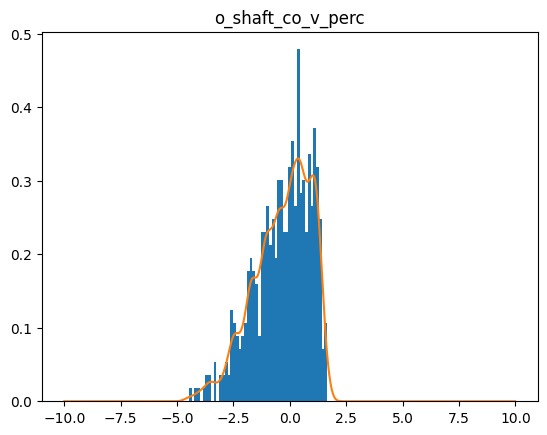

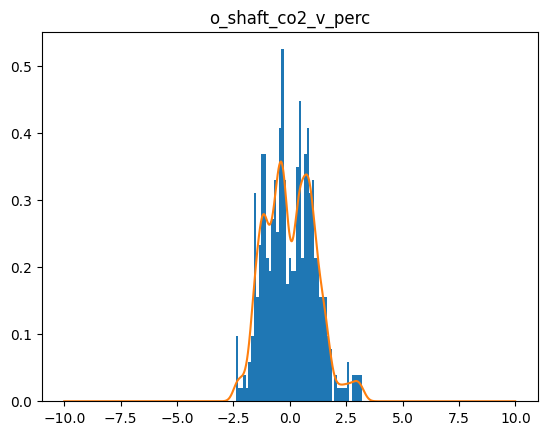

torch.Size([2000])
4101  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4102  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4103  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4104  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4105  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4106  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4107  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4108  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4109  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4110  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4111  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4112  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4113  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4114  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4115  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4116  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4117  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4118  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4119  loss=  tensor(0.0004,

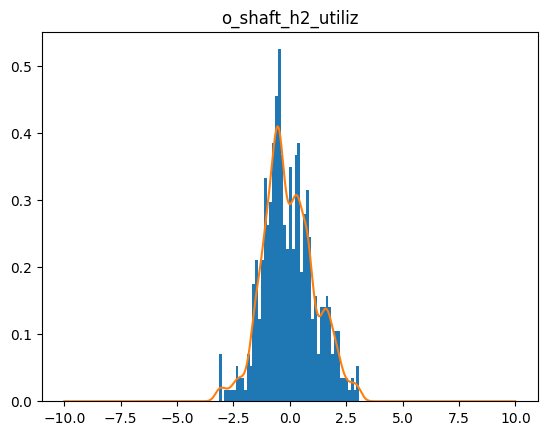

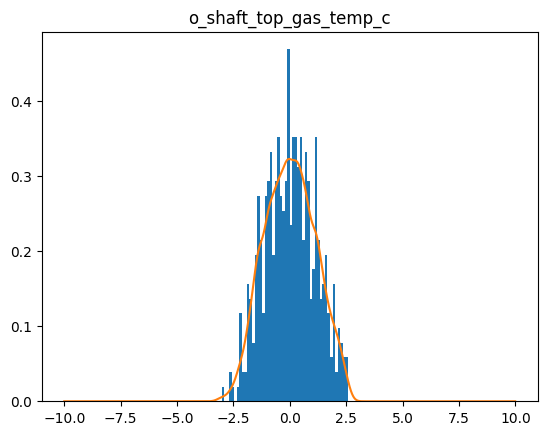

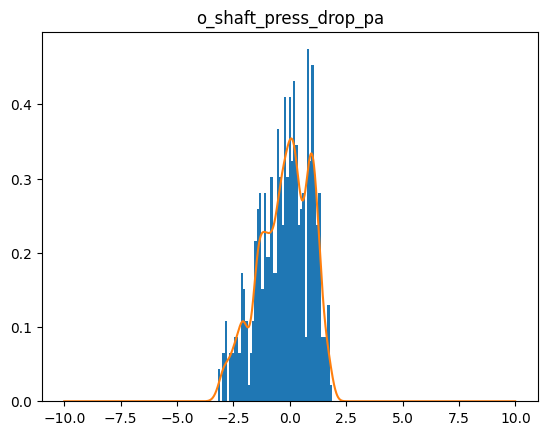

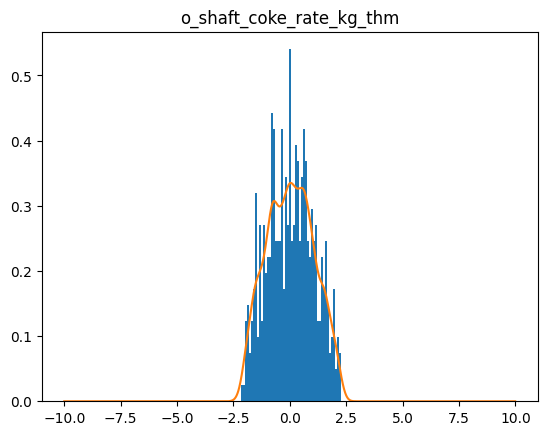

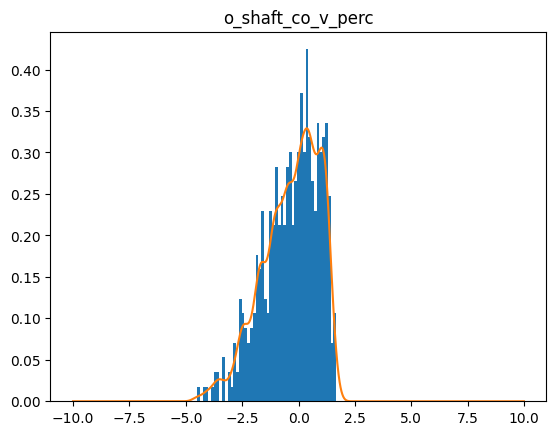

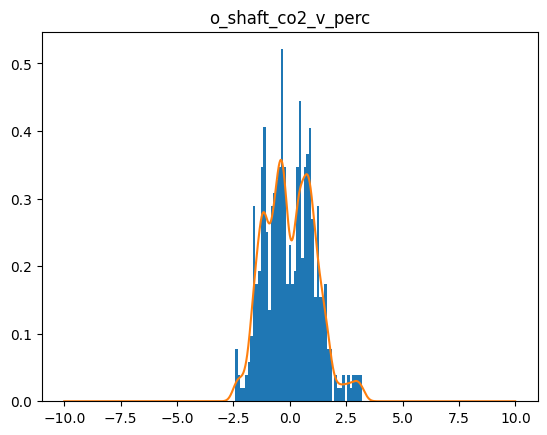

torch.Size([2000])
4201  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4202  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4203  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4204  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4205  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4206  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4207  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4208  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4209  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4210  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4211  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4212  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4213  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4214  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4215  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4216  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4217  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4218  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4219  loss=  tensor(0.0004,

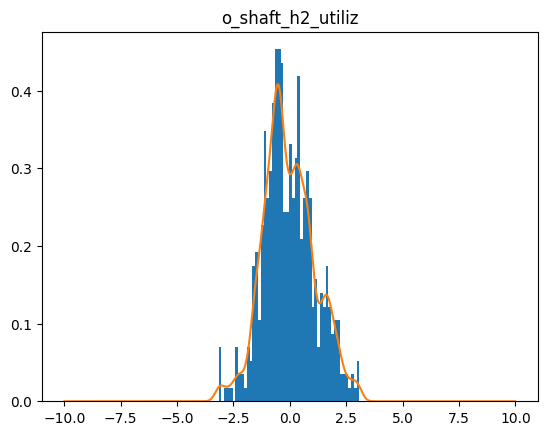

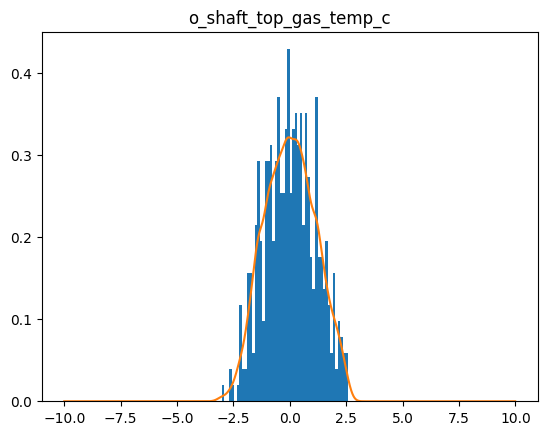

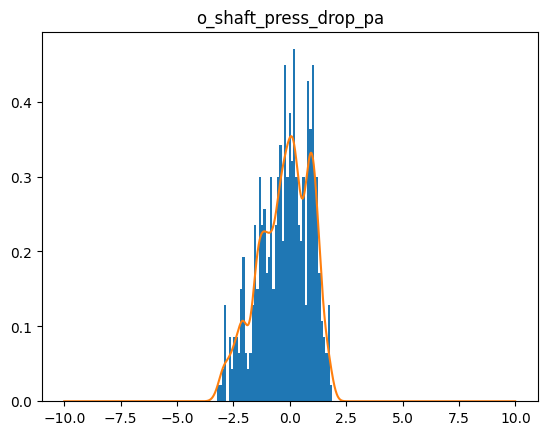

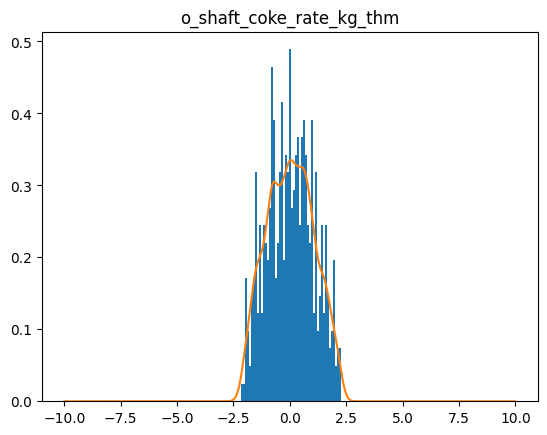

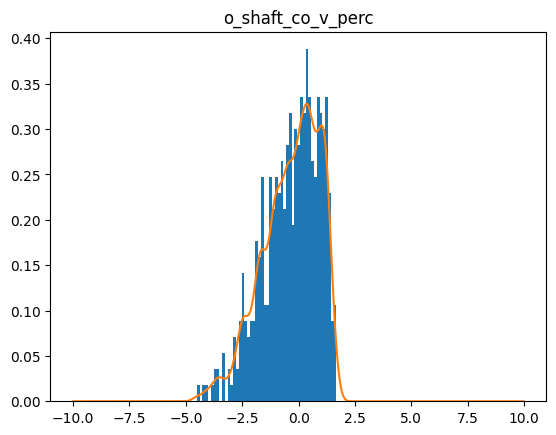

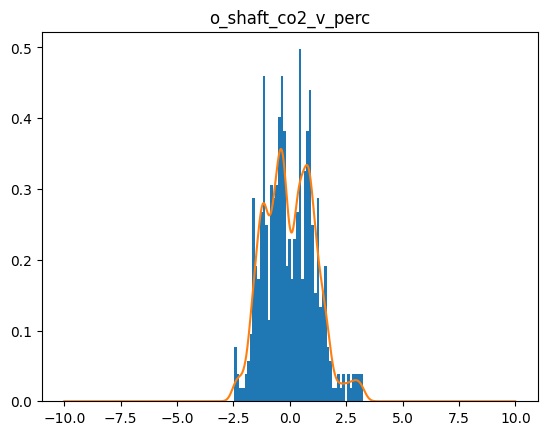

torch.Size([2000])
4301  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4302  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4303  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4304  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4305  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4306  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4307  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4308  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4309  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4310  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4311  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4312  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4313  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4314  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4315  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4316  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4317  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4318  loss=  tensor(0.0004, grad_fn=<MeanBackward0>)
4319  loss=  tensor(0.0004,

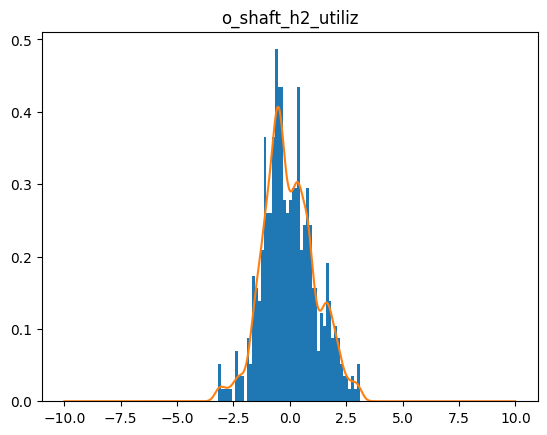

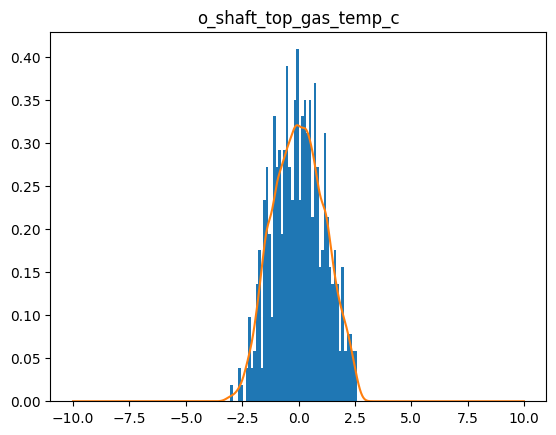

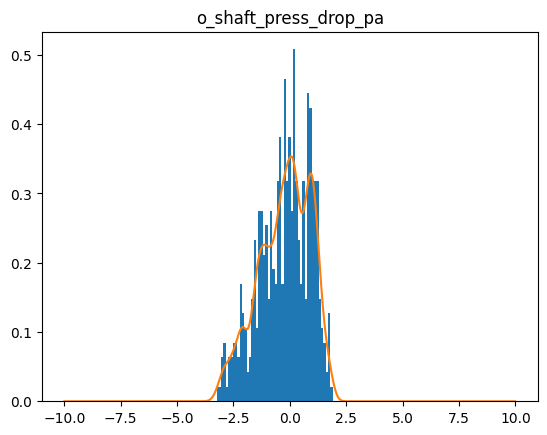

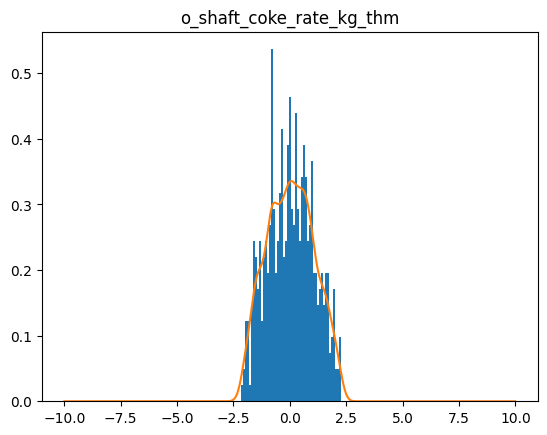

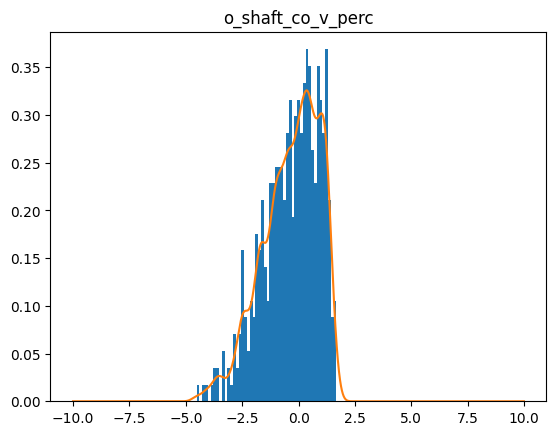

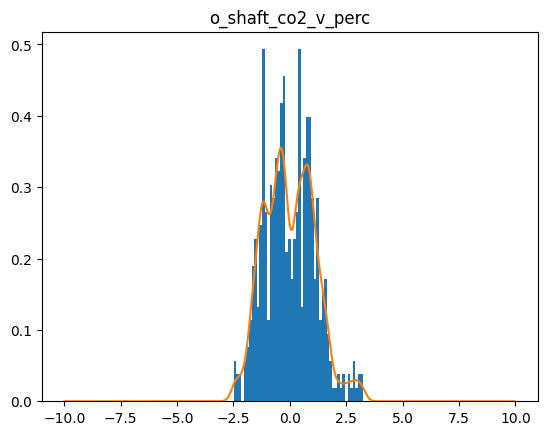

torch.Size([2000])
4401  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4402  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4403  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4404  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4405  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4406  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4407  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4408  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4409  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4410  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4411  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4412  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4413  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4414  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4415  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4416  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4417  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4418  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4419  loss=  tensor(0.0003,

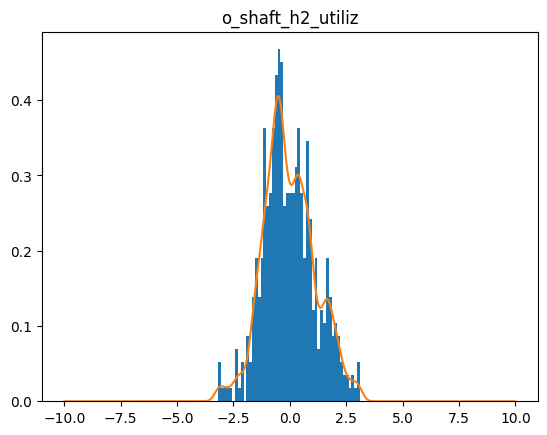

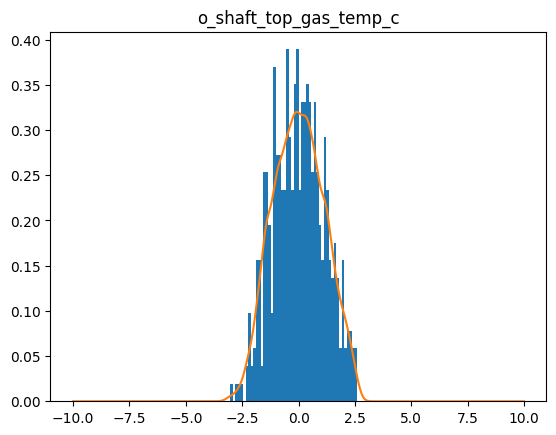

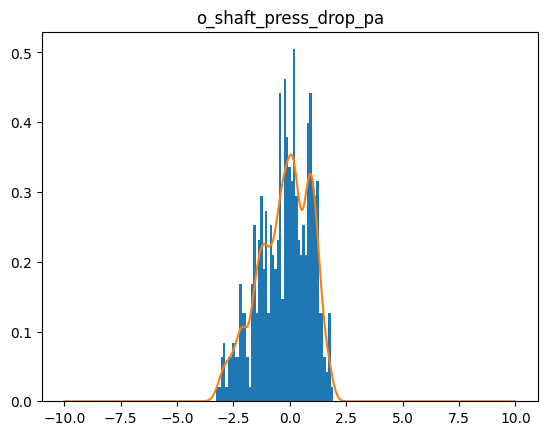

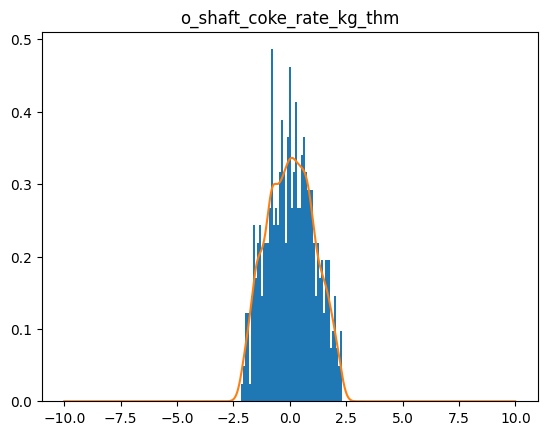

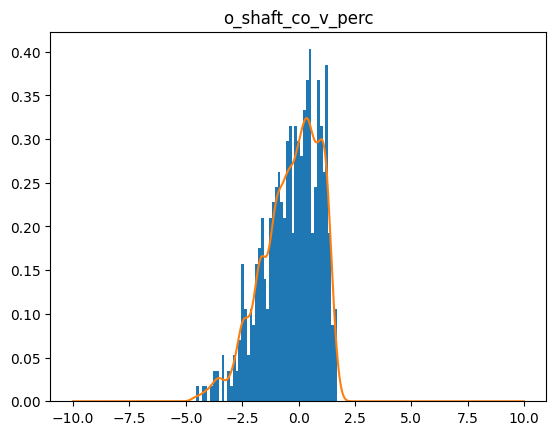

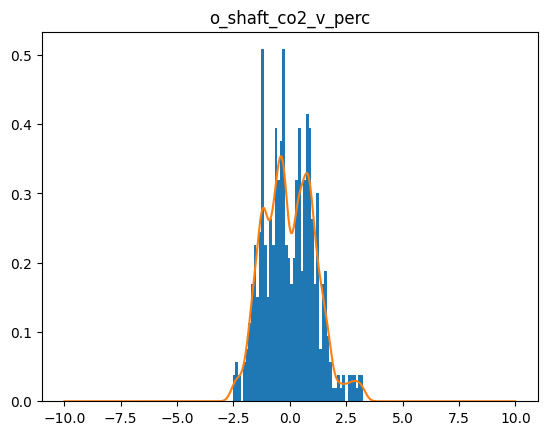

torch.Size([2000])
4501  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4502  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4503  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4504  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4505  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4506  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4507  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4508  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4509  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4510  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4511  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4512  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4513  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4514  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4515  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4516  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4517  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4518  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4519  loss=  tensor(0.0003,

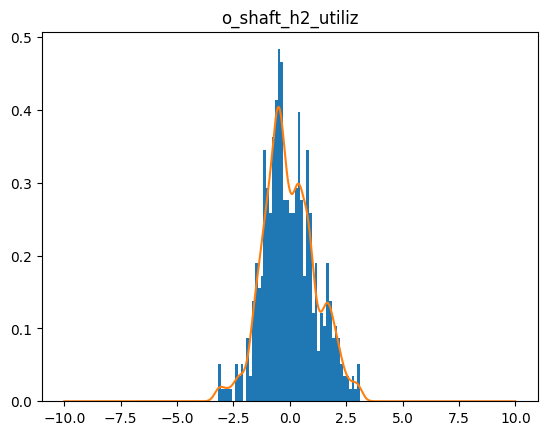

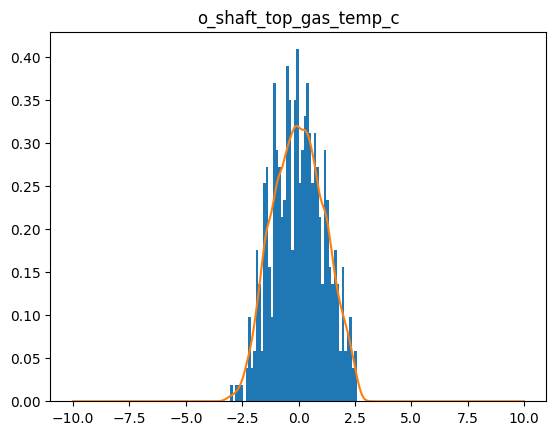

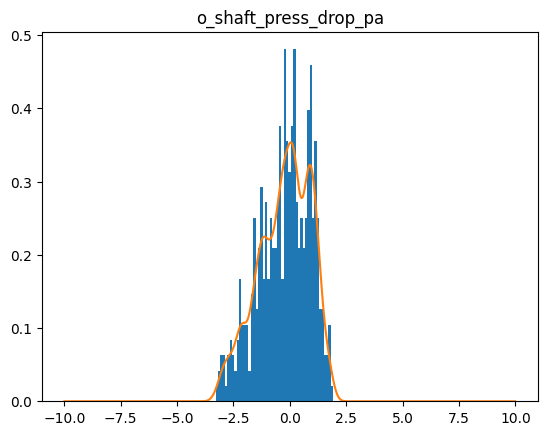

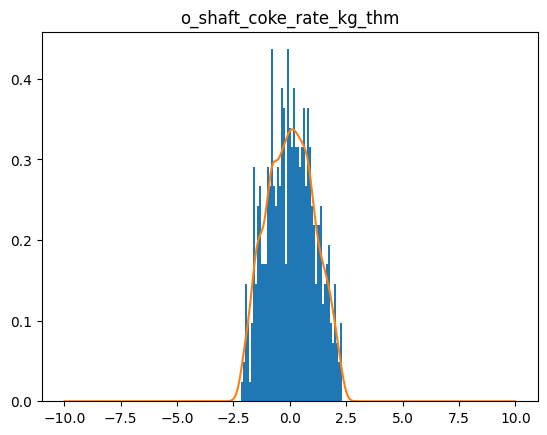

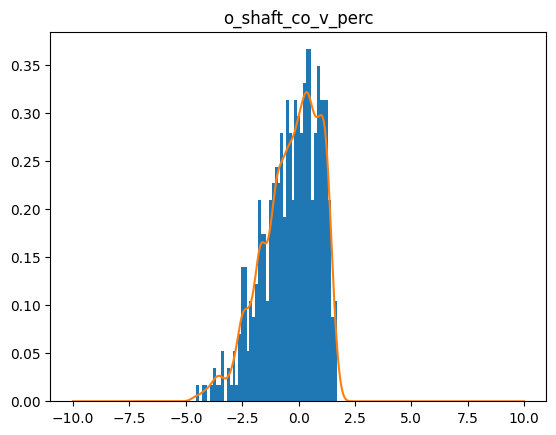

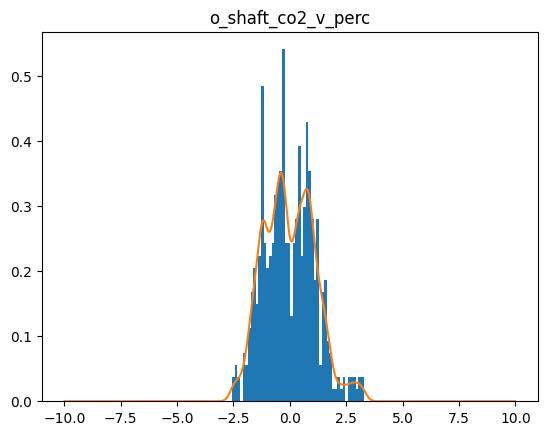

torch.Size([2000])
4601  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4602  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4603  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4604  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4605  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4606  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4607  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4608  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4609  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4610  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4611  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4612  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4613  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4614  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4615  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4616  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4617  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4618  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4619  loss=  tensor(0.0003,

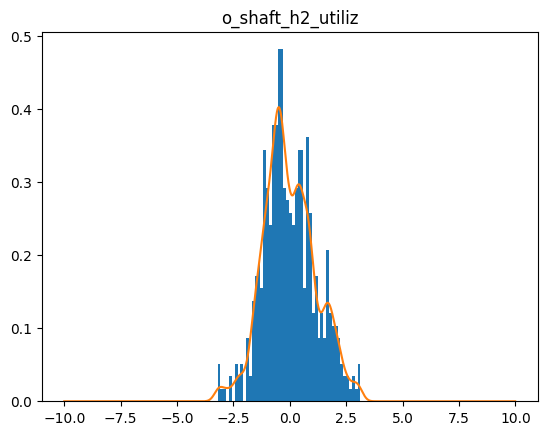

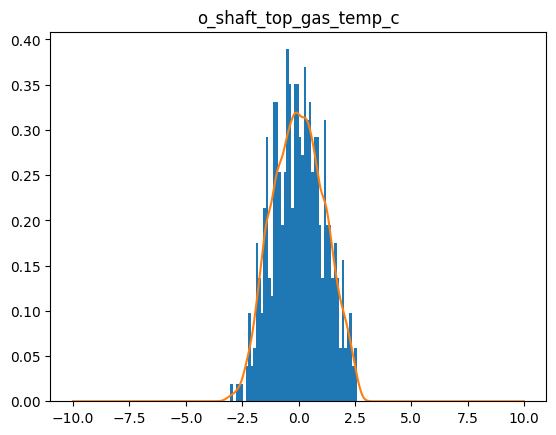

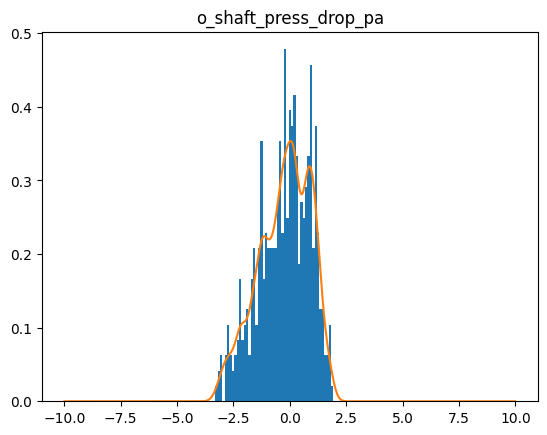

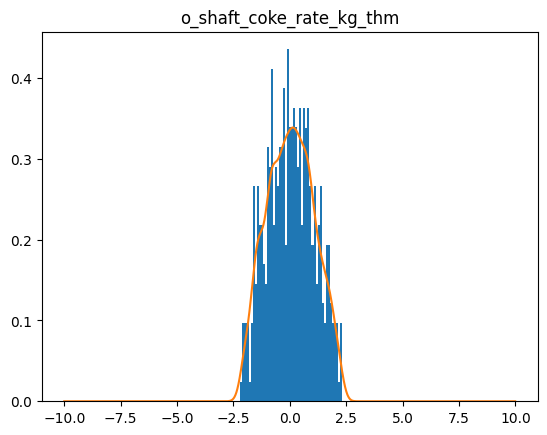

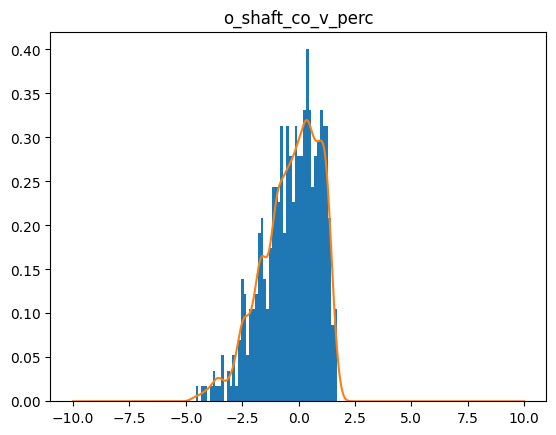

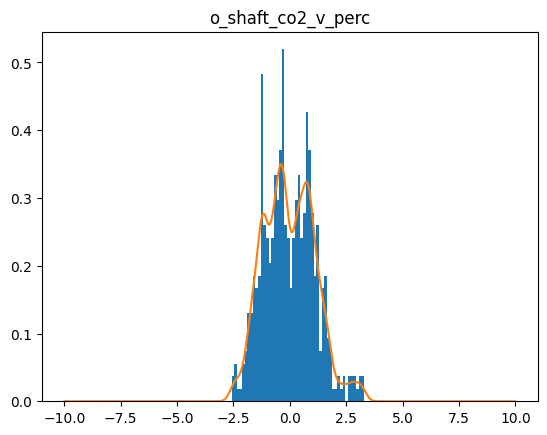

torch.Size([2000])
4701  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4702  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4703  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4704  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4705  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4706  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4707  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4708  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4709  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4710  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4711  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4712  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4713  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4714  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4715  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4716  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4717  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4718  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4719  loss=  tensor(0.0003,

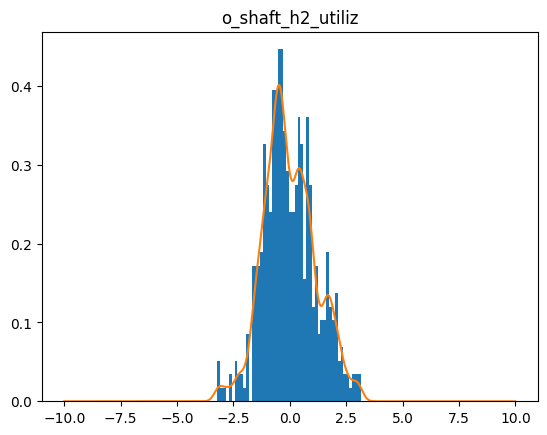

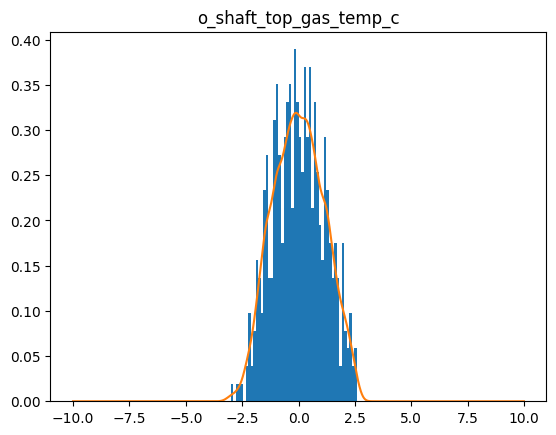

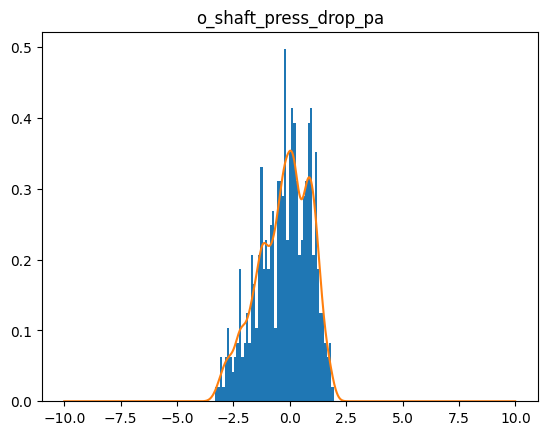

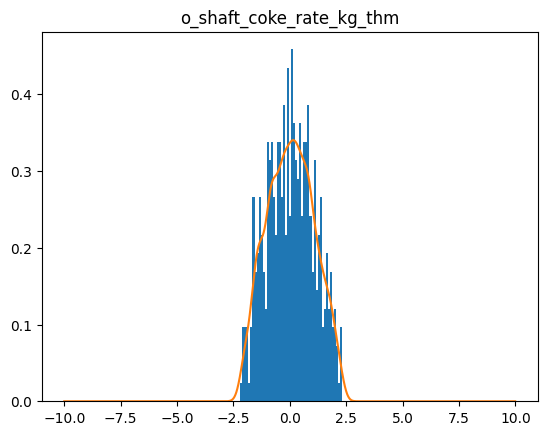

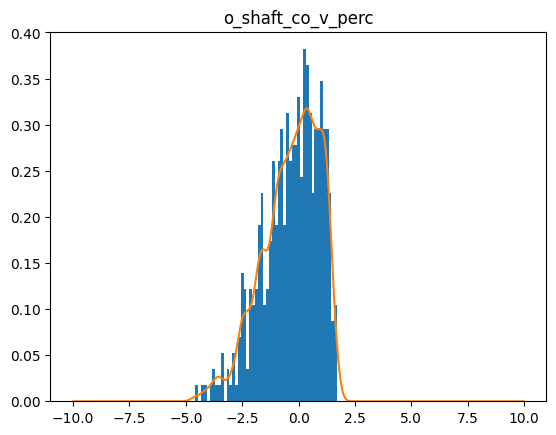

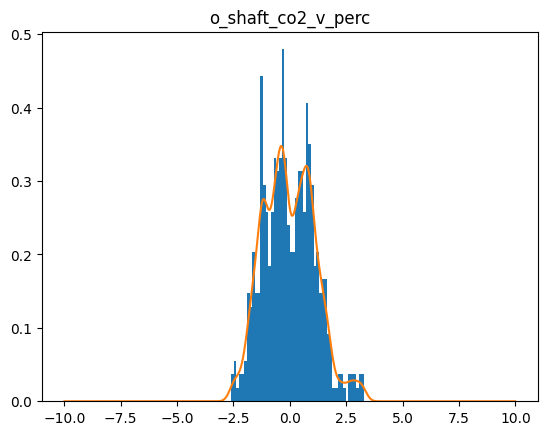

torch.Size([2000])
4801  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4802  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4803  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4804  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4805  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4806  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4807  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4808  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4809  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4810  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4811  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4812  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4813  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4814  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4815  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4816  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4817  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4818  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4819  loss=  tensor(0.0003,

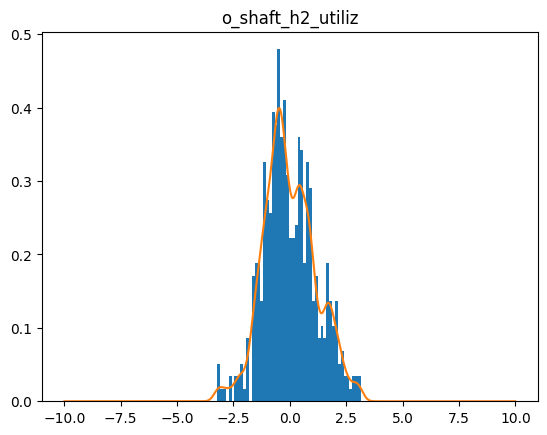

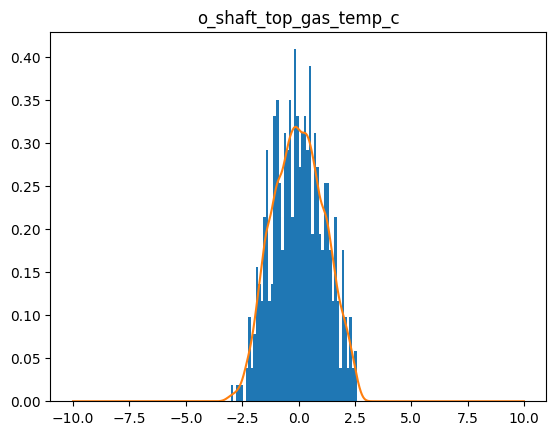

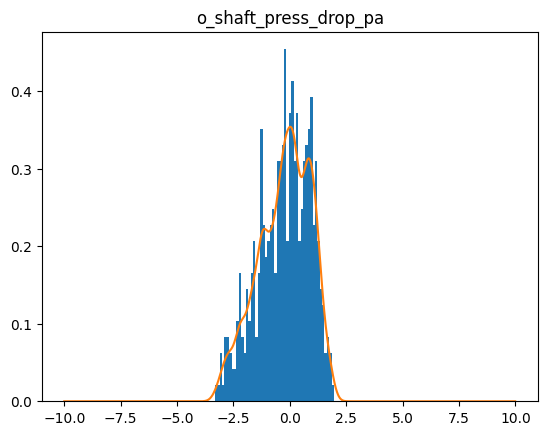

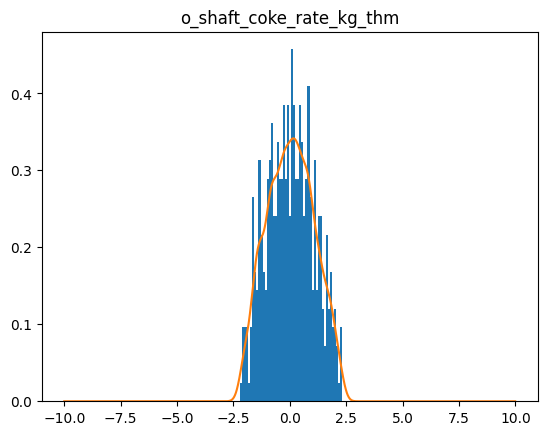

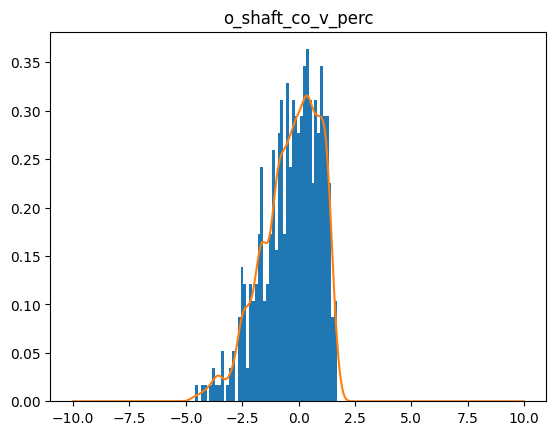

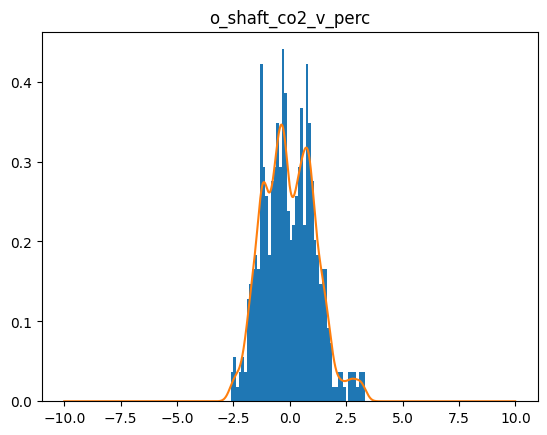

torch.Size([2000])
4901  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4902  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4903  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4904  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4905  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4906  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4907  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4908  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4909  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4910  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4911  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4912  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4913  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4914  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4915  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4916  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4917  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4918  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
4919  loss=  tensor(0.0003,

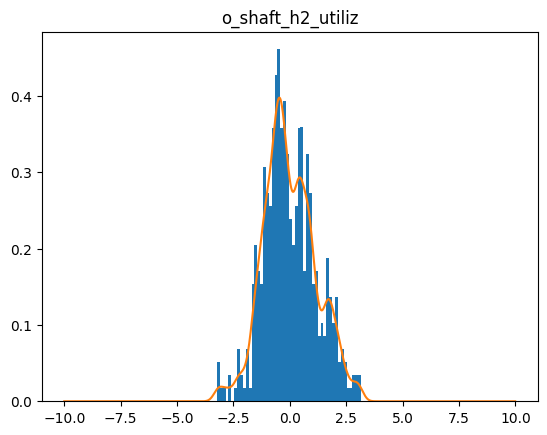

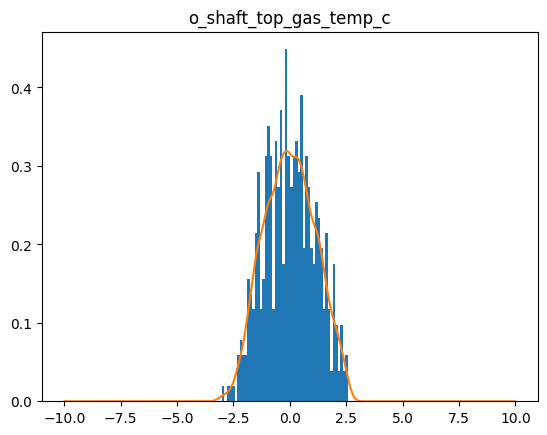

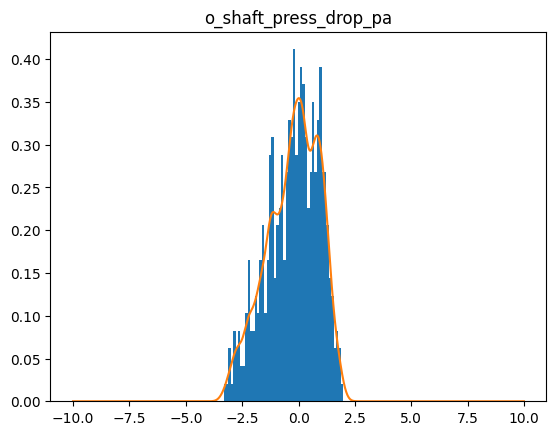

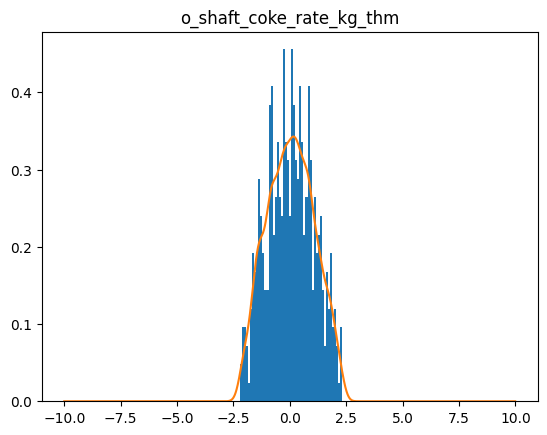

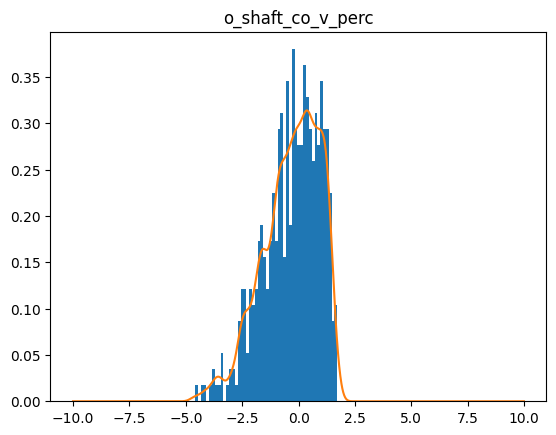

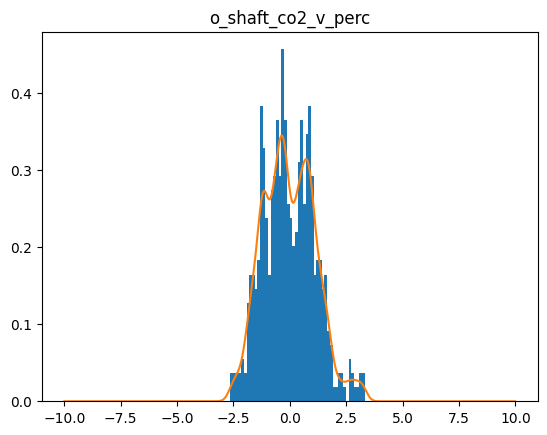

torch.Size([2000])
5001  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5002  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5003  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5004  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5005  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5006  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5007  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5008  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5009  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5010  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5011  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5012  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5013  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5014  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5015  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5016  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5017  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5018  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5019  loss=  tensor(0.0003,

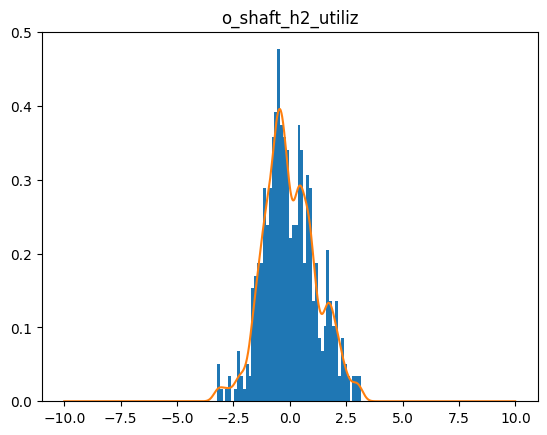

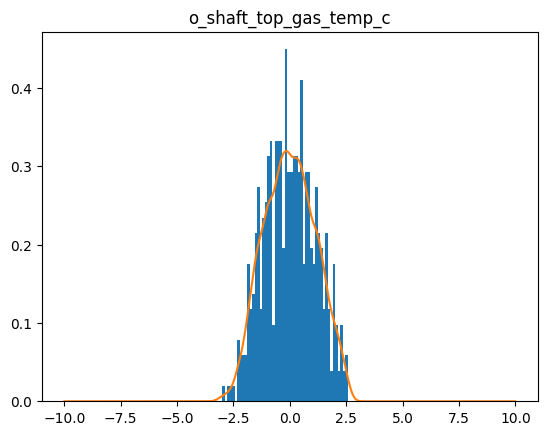

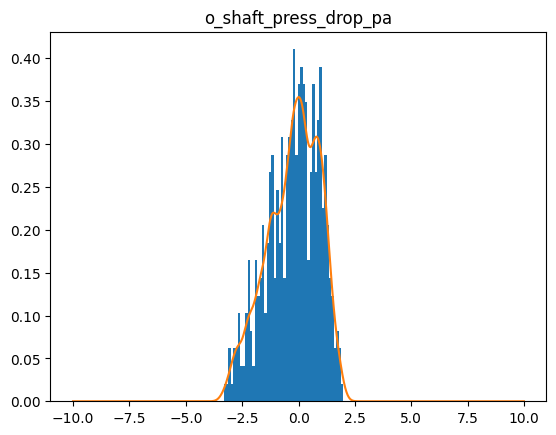

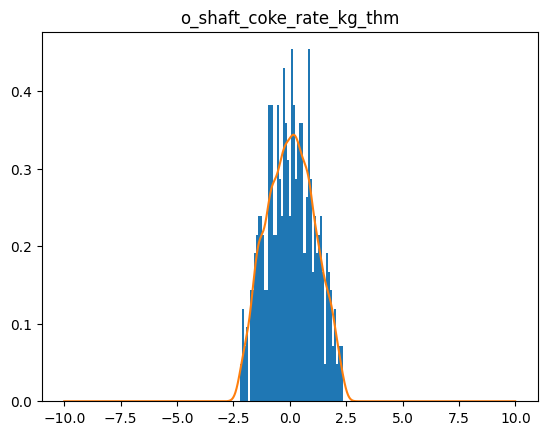

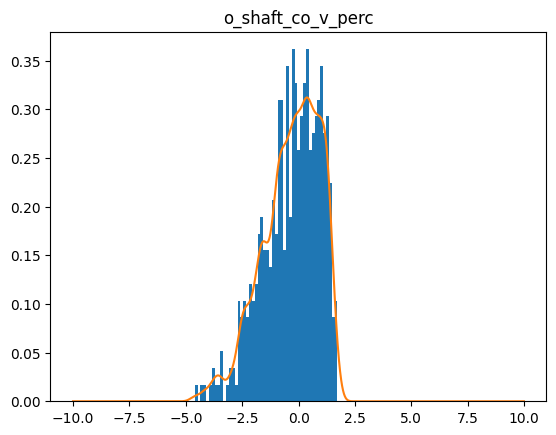

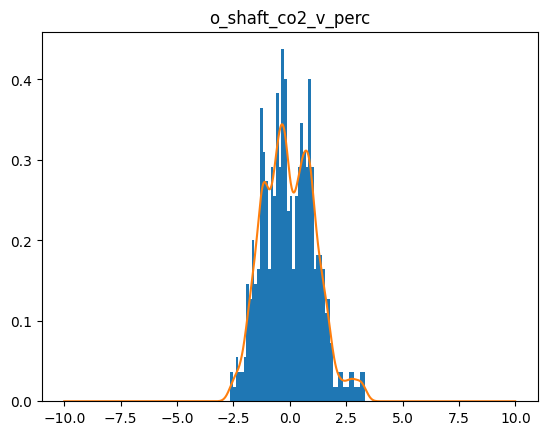

torch.Size([2000])
5101  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5102  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5103  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5104  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5105  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5106  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5107  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5108  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5109  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5110  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5111  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5112  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5113  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5114  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5115  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5116  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5117  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5118  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5119  loss=  tensor(0.0003,

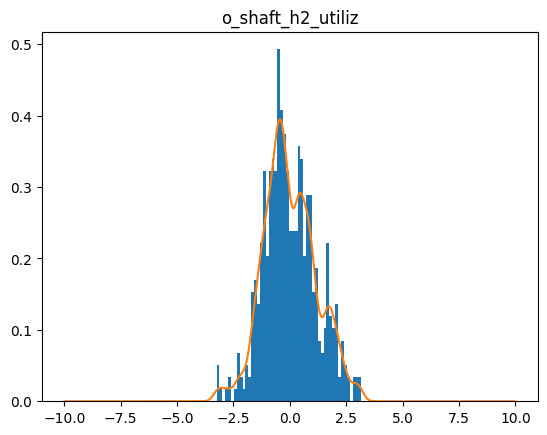

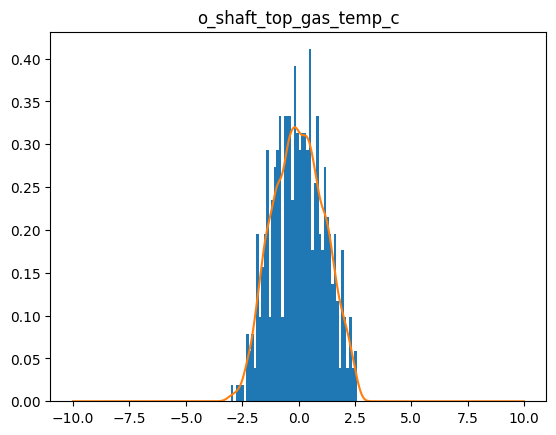

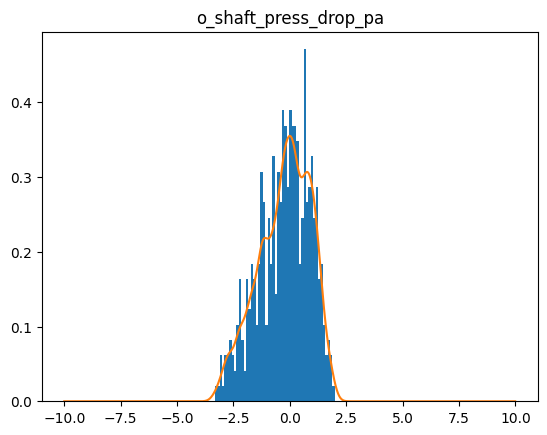

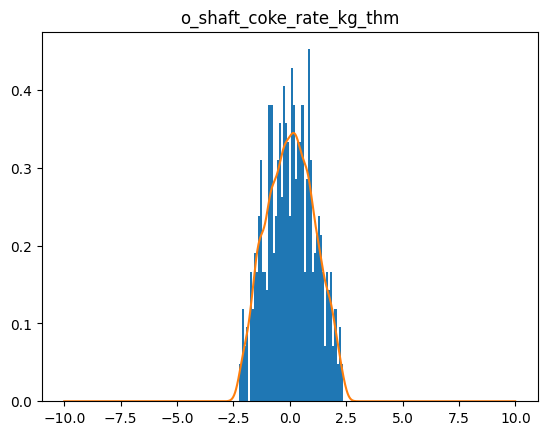

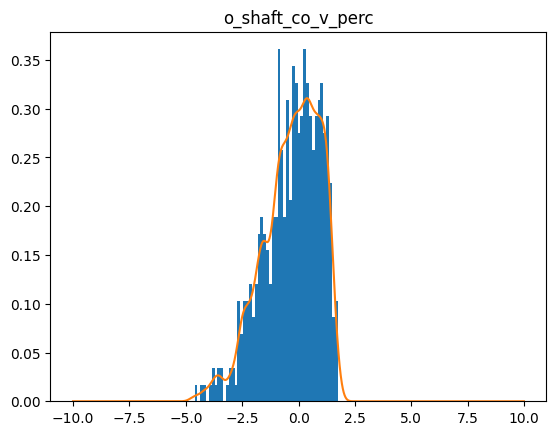

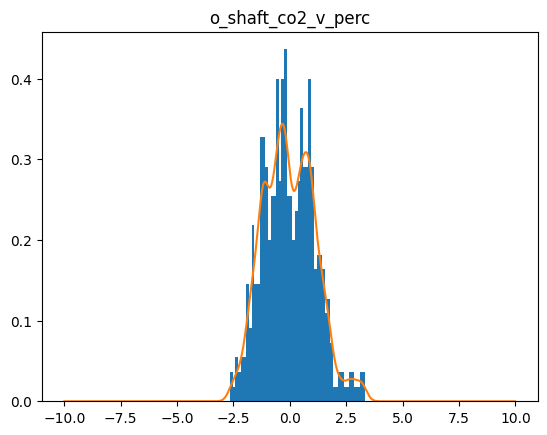

torch.Size([2000])
5201  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5202  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5203  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5204  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5205  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5206  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5207  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5208  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5209  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5210  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5211  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5212  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5213  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5214  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5215  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5216  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5217  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5218  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5219  loss=  tensor(0.0003,

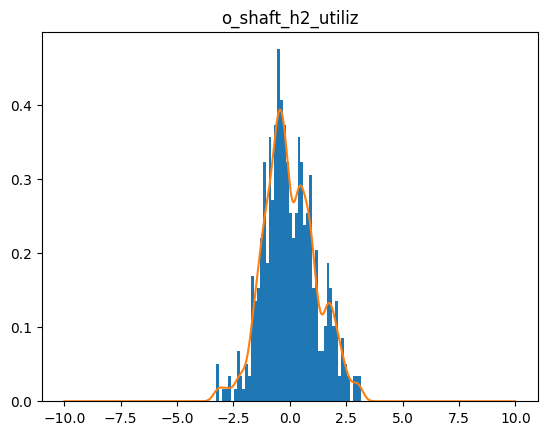

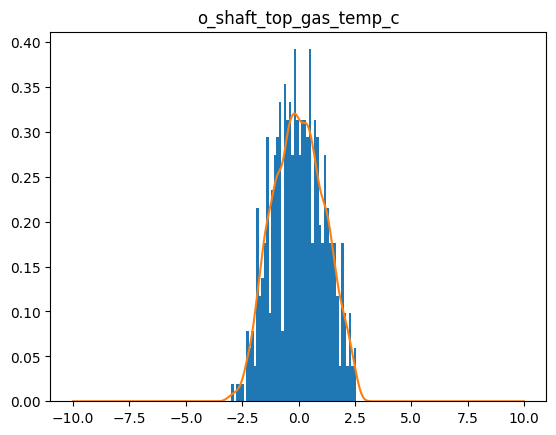

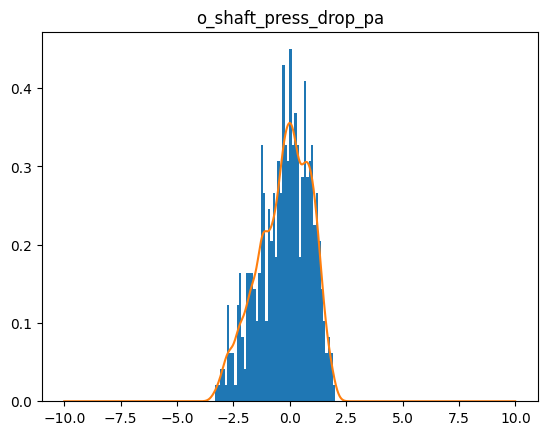

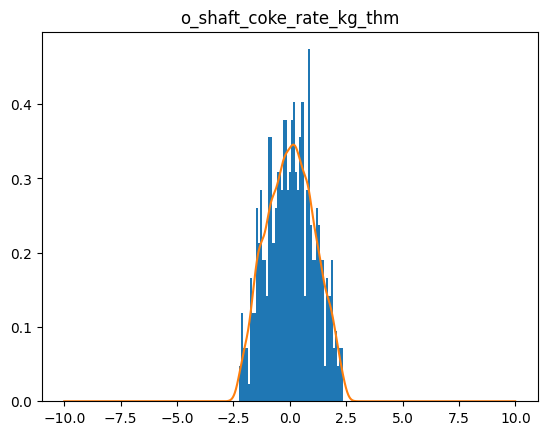

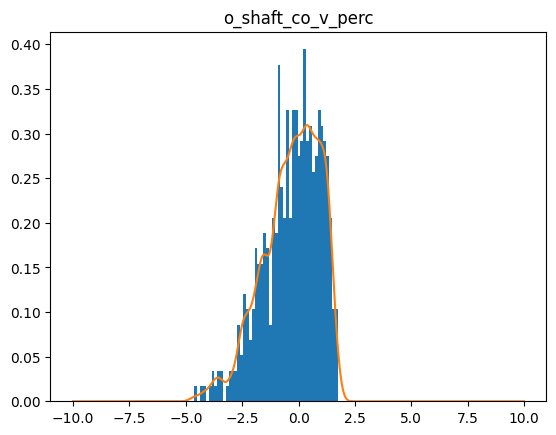

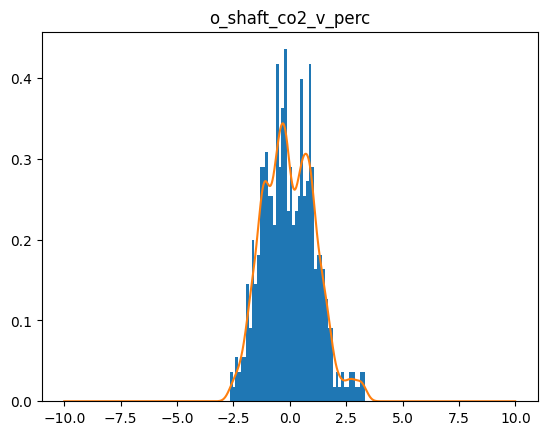

torch.Size([2000])
5301  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5302  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5303  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5304  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5305  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5306  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5307  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5308  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5309  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5310  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5311  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5312  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5313  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5314  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5315  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5316  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5317  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5318  loss=  tensor(0.0003, grad_fn=<MeanBackward0>)
5319  loss=  tensor(0.0003,

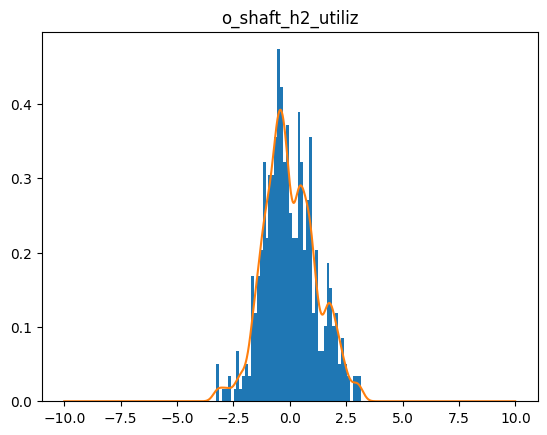

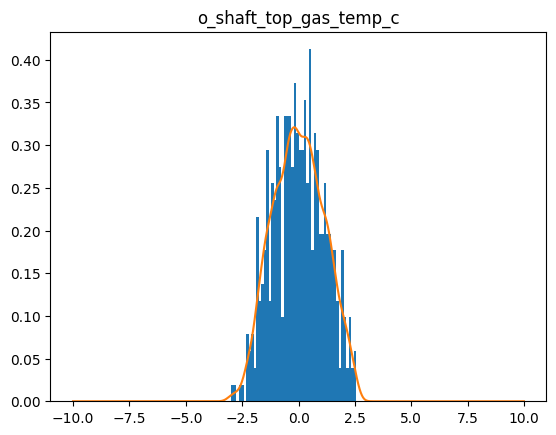

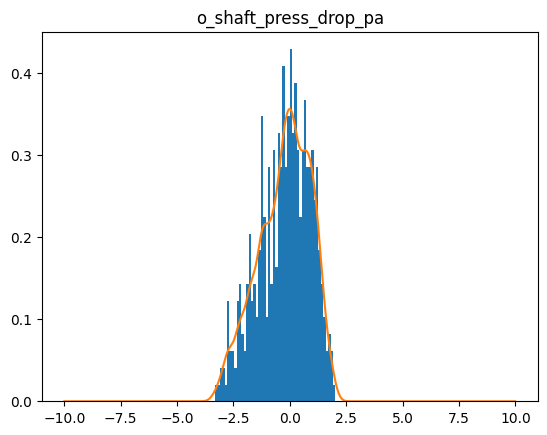

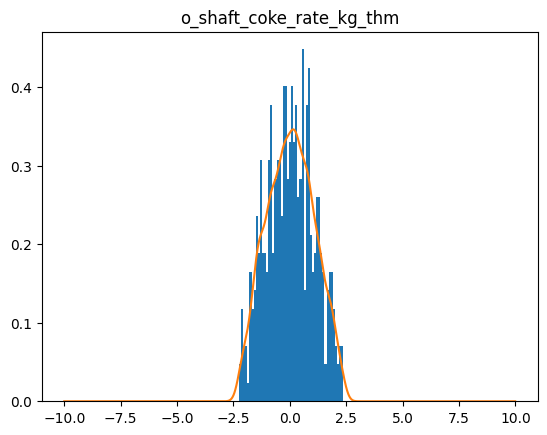

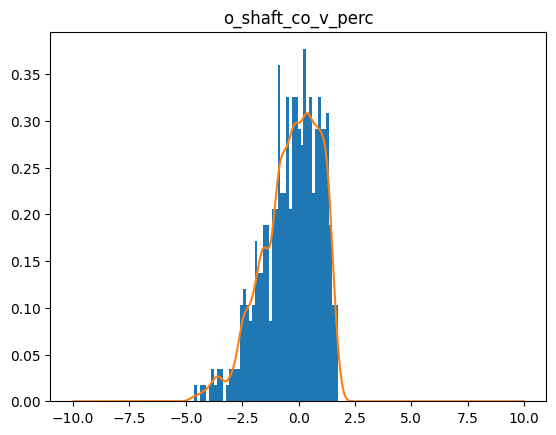

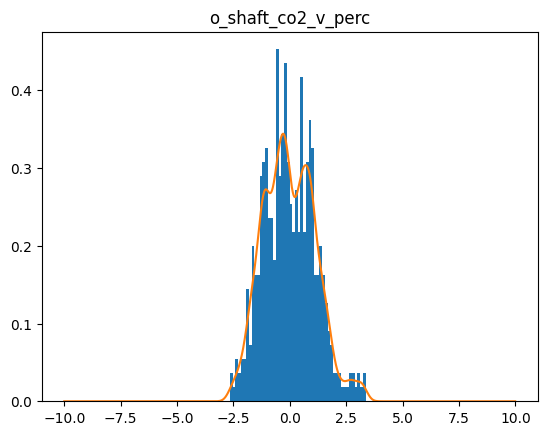

torch.Size([2000])
5401  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5402  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5403  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5404  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5405  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5406  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5407  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5408  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5409  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5410  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5411  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5412  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5413  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5414  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5415  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5416  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5417  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5418  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5419  loss=  tensor(0.0002,

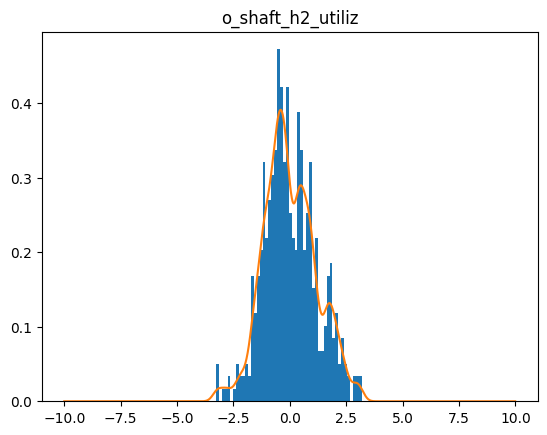

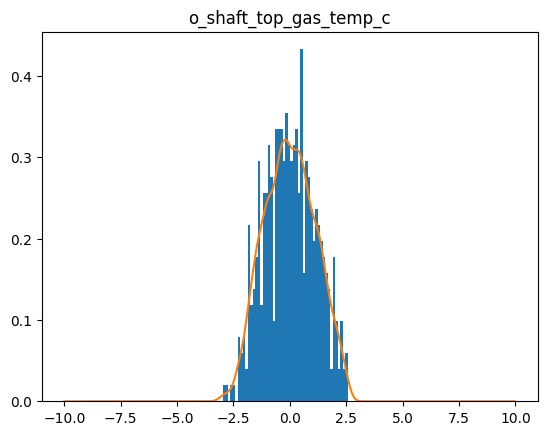

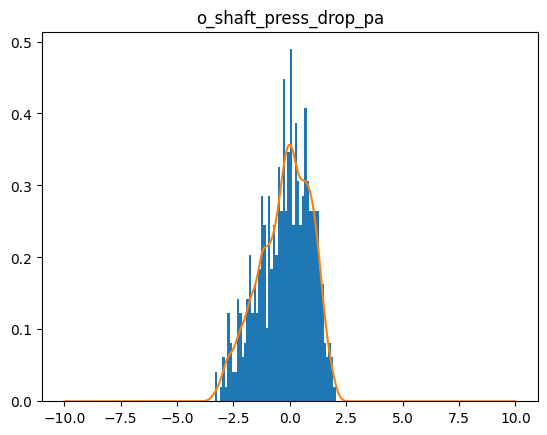

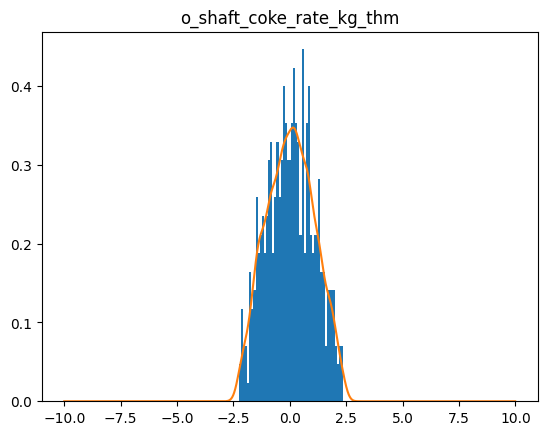

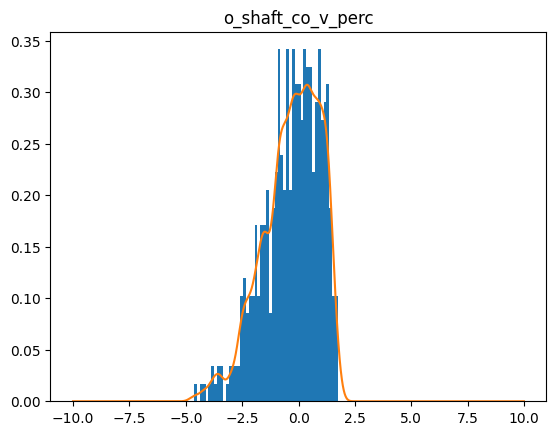

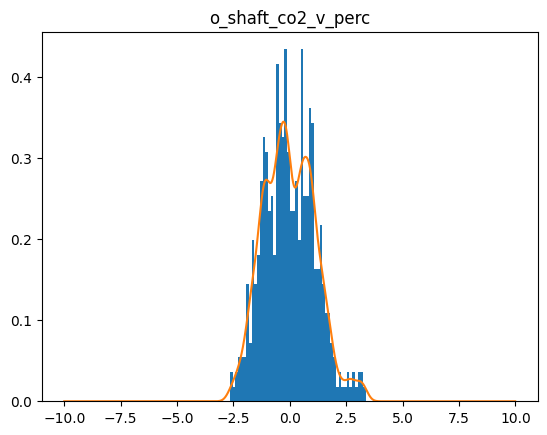

torch.Size([2000])
5501  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5502  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5503  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5504  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5505  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5506  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5507  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5508  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5509  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5510  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5511  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5512  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5513  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5514  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5515  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5516  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5517  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5518  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5519  loss=  tensor(0.0002,

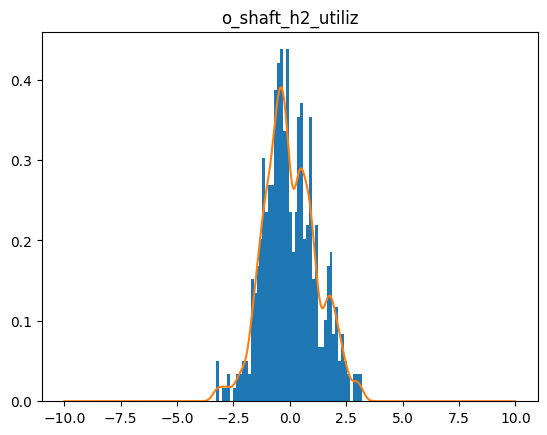

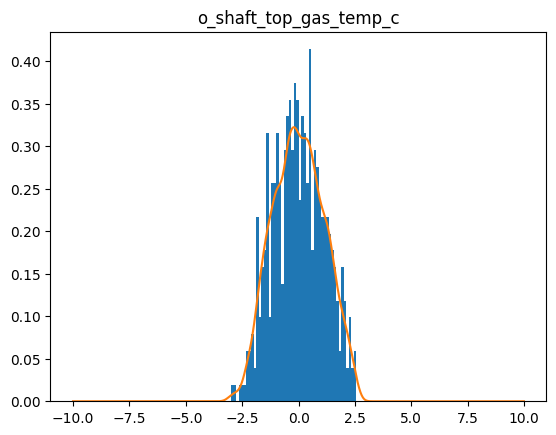

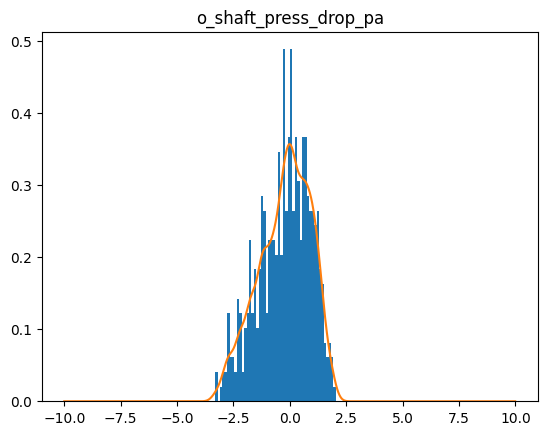

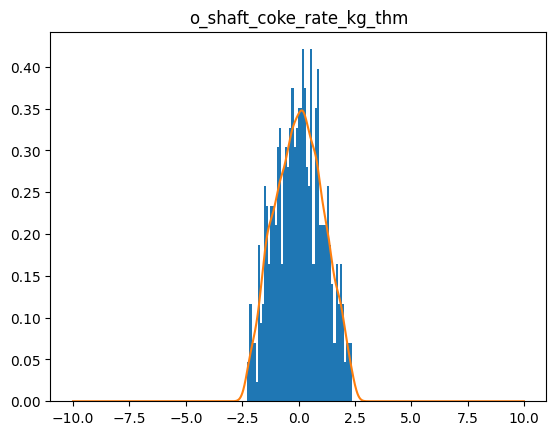

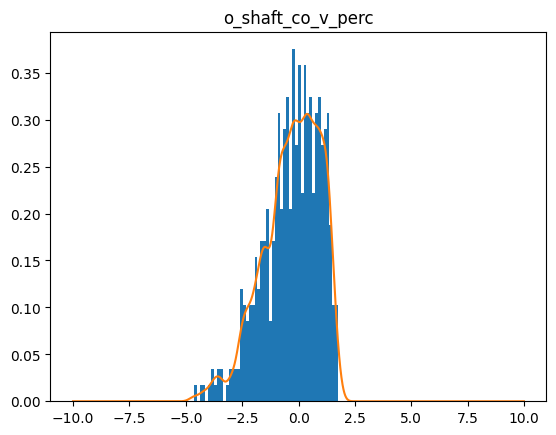

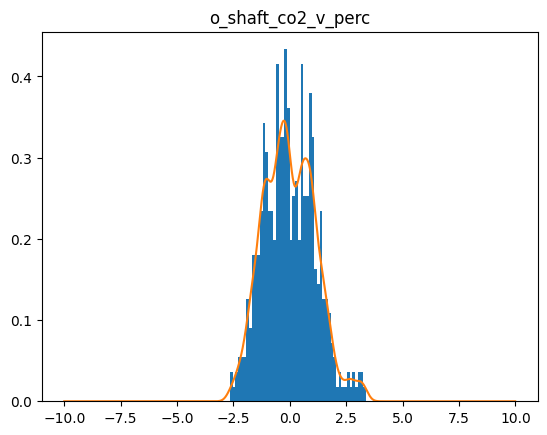

torch.Size([2000])
5601  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5602  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5603  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5604  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5605  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5606  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5607  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5608  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5609  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5610  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5611  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5612  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5613  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5614  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5615  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5616  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5617  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5618  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5619  loss=  tensor(0.0002,

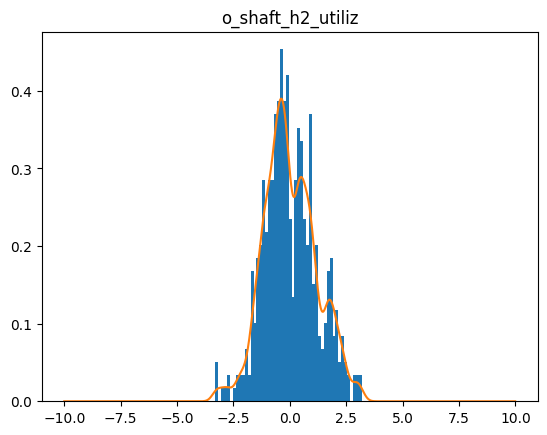

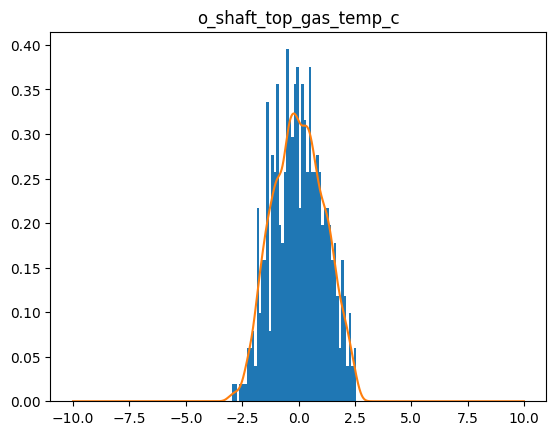

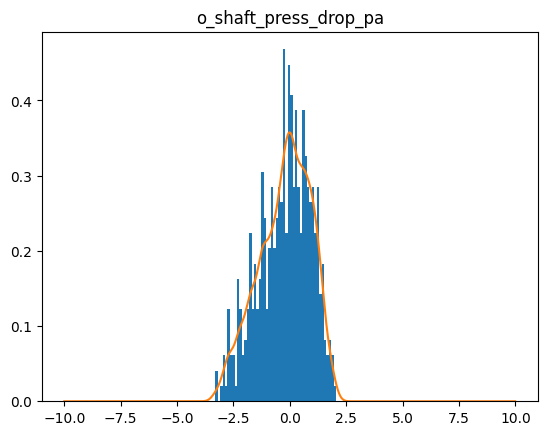

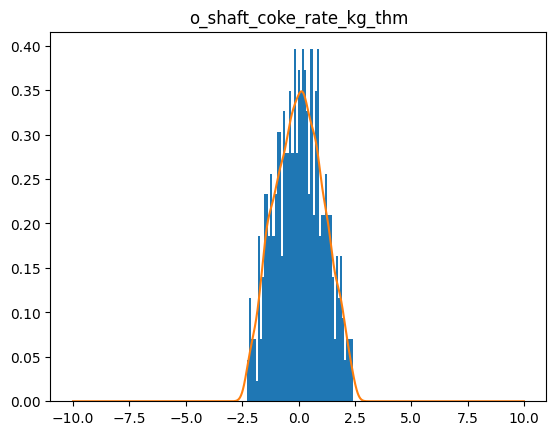

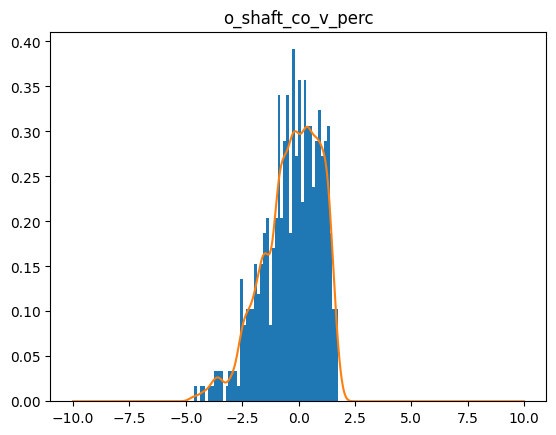

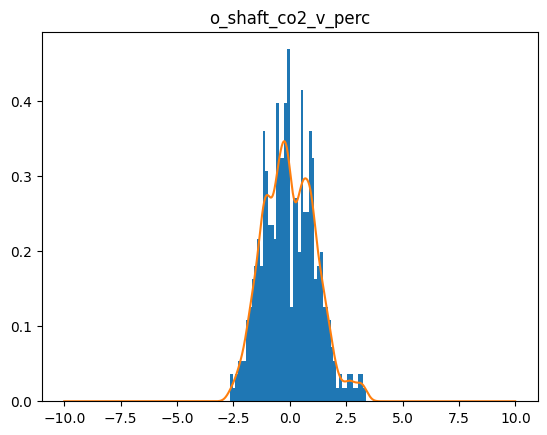

torch.Size([2000])
5701  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5702  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5703  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5704  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5705  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5706  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5707  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5708  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5709  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5710  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5711  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5712  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5713  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5714  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5715  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5716  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5717  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5718  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5719  loss=  tensor(0.0002,

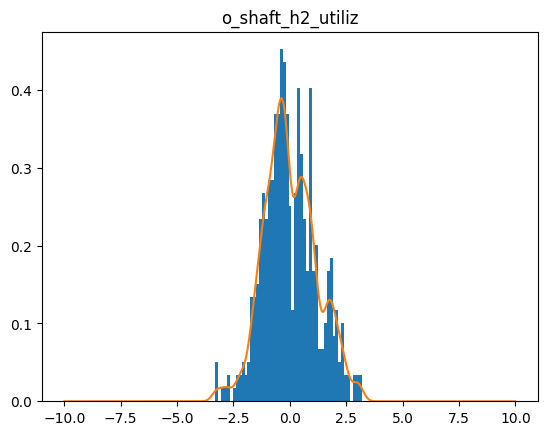

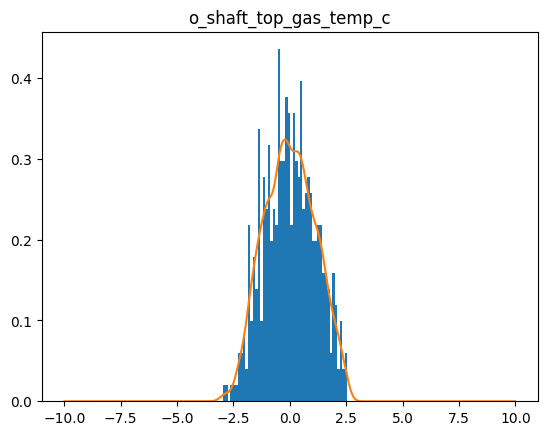

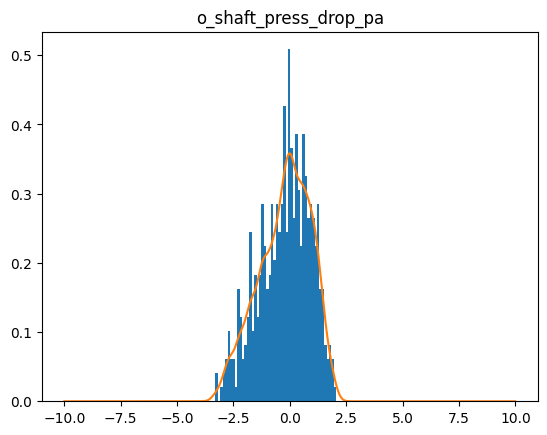

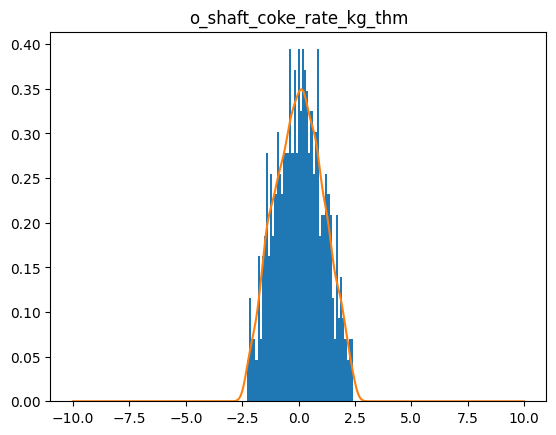

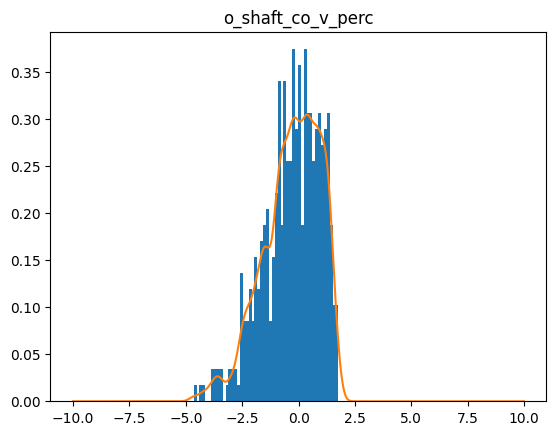

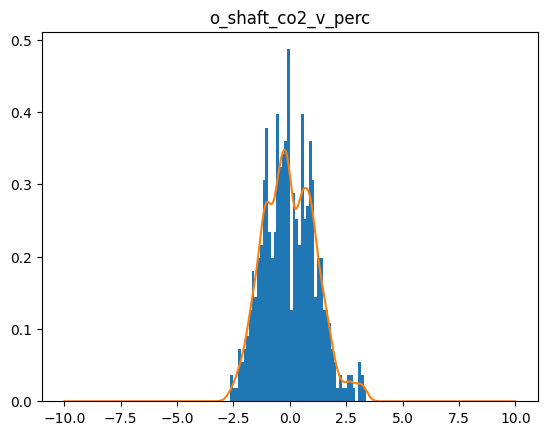

torch.Size([2000])
5801  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5802  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5803  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5804  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5805  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5806  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5807  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5808  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5809  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5810  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5811  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5812  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5813  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5814  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5815  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5816  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5817  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5818  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5819  loss=  tensor(0.0002,

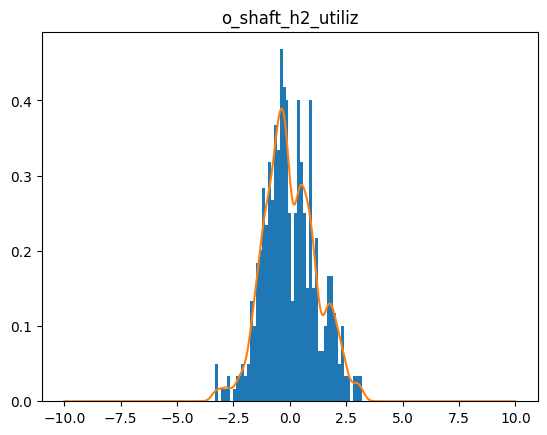

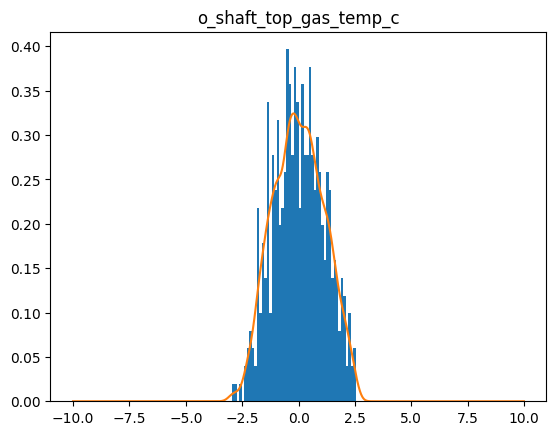

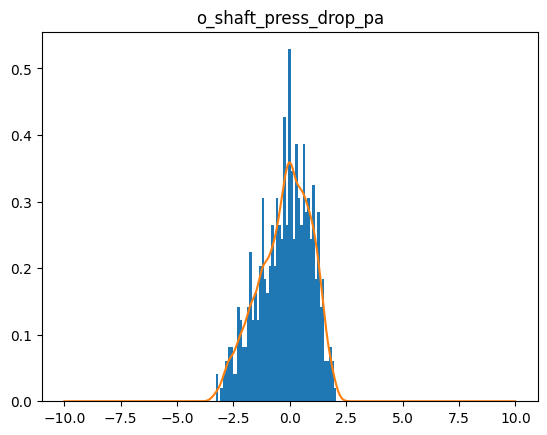

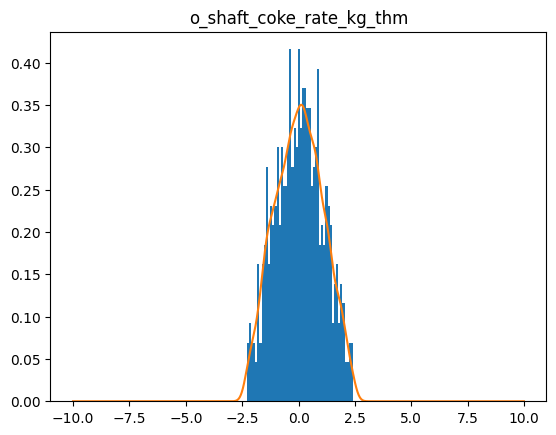

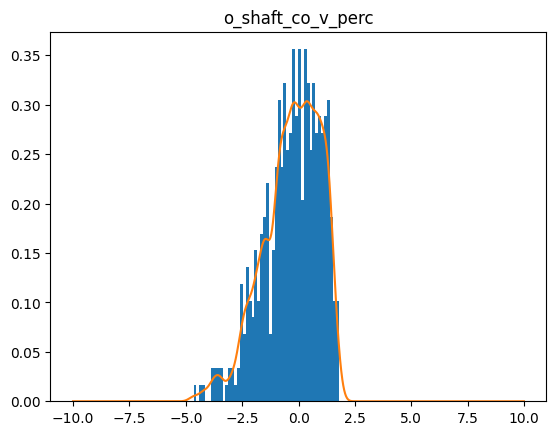

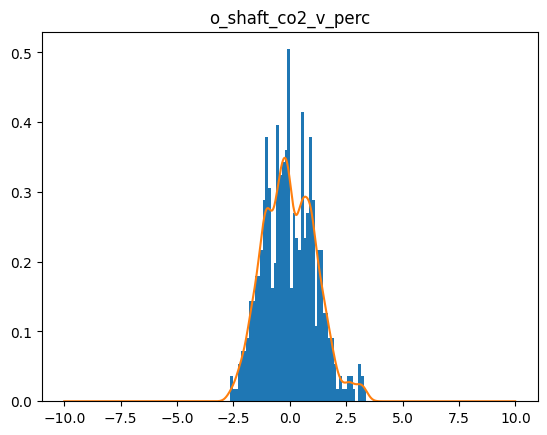

torch.Size([2000])
5901  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5902  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5903  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5904  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5905  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5906  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5907  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5908  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5909  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5910  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5911  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5912  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5913  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5914  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5915  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5916  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5917  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5918  loss=  tensor(0.0002, grad_fn=<MeanBackward0>)
5919  loss=  tensor(0.0002,

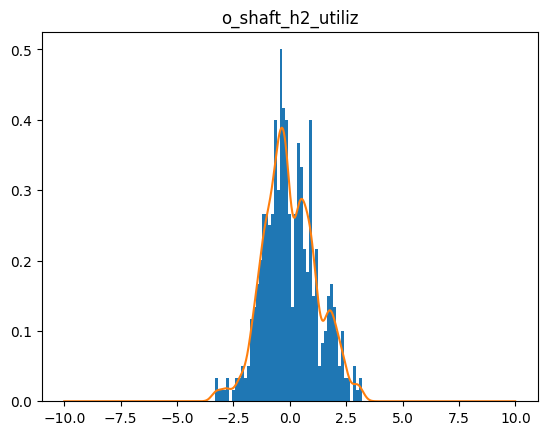

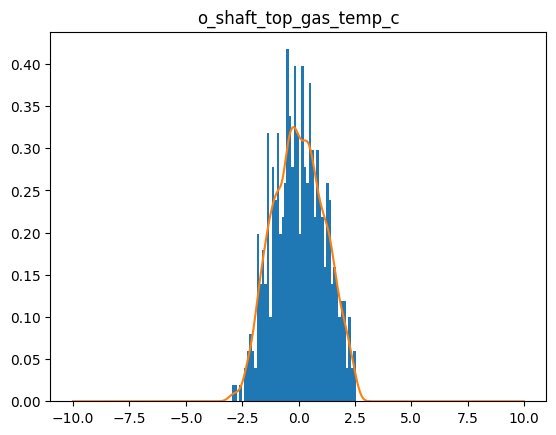

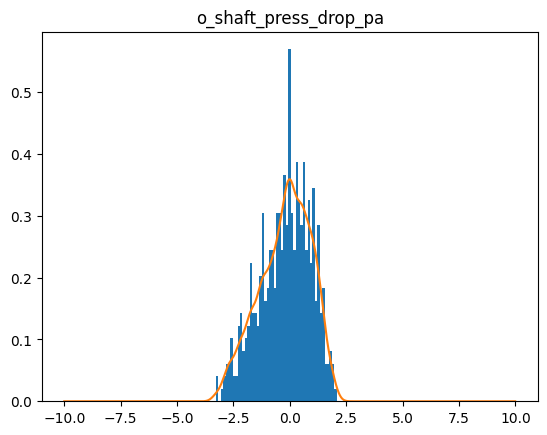

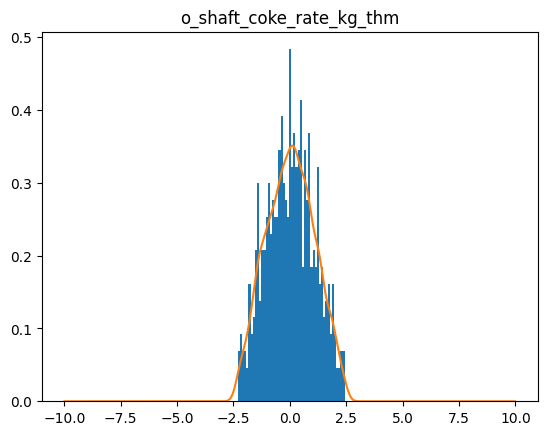

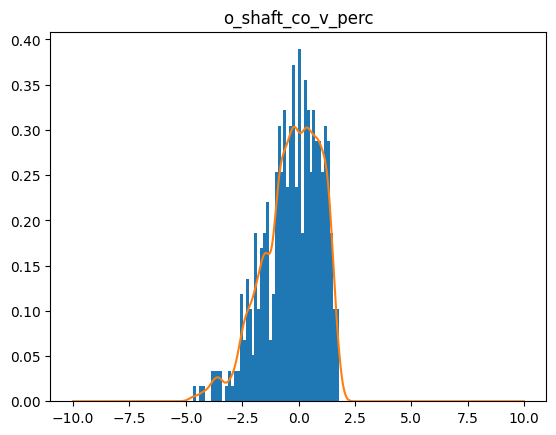

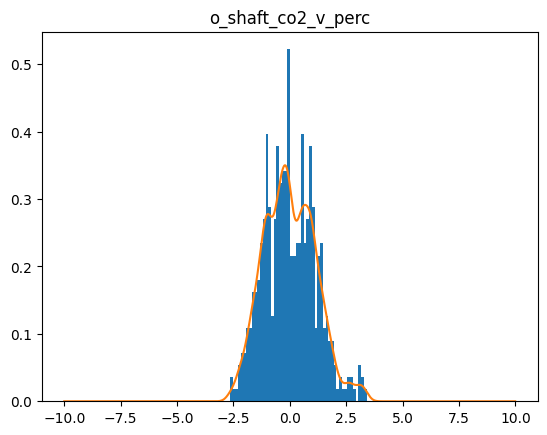

torch.Size([2000])
6001  loss=  tensor(0.0251, grad_fn=<MeanBackward0>)
6002  loss=  tensor(0.0251, grad_fn=<MeanBackward0>)
6003  loss=  tensor(0.0250, grad_fn=<MeanBackward0>)
6004  loss=  tensor(0.0250, grad_fn=<MeanBackward0>)
6005  loss=  tensor(0.0249, grad_fn=<MeanBackward0>)
6006  loss=  tensor(0.0249, grad_fn=<MeanBackward0>)
6007  loss=  tensor(0.0248, grad_fn=<MeanBackward0>)
6008  loss=  tensor(0.0247, grad_fn=<MeanBackward0>)
6009  loss=  tensor(0.0247, grad_fn=<MeanBackward0>)
6010  loss=  tensor(0.0246, grad_fn=<MeanBackward0>)
6011  loss=  tensor(0.0246, grad_fn=<MeanBackward0>)
6012  loss=  tensor(0.0246, grad_fn=<MeanBackward0>)
6013  loss=  tensor(0.0245, grad_fn=<MeanBackward0>)
6014  loss=  tensor(0.0245, grad_fn=<MeanBackward0>)
6015  loss=  tensor(0.0244, grad_fn=<MeanBackward0>)
6016  loss=  tensor(0.0244, grad_fn=<MeanBackward0>)
6017  loss=  tensor(0.0243, grad_fn=<MeanBackward0>)
6018  loss=  tensor(0.0243, grad_fn=<MeanBackward0>)
6019  loss=  tensor(0.0243,

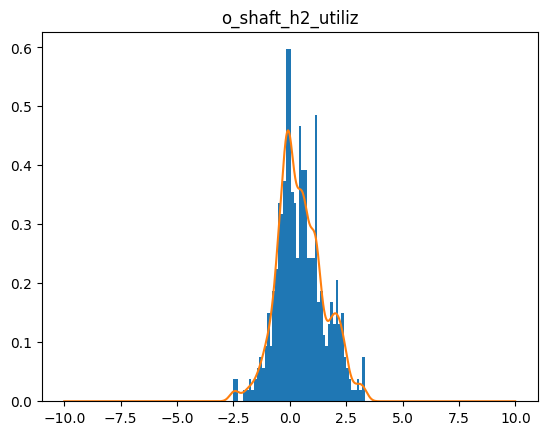

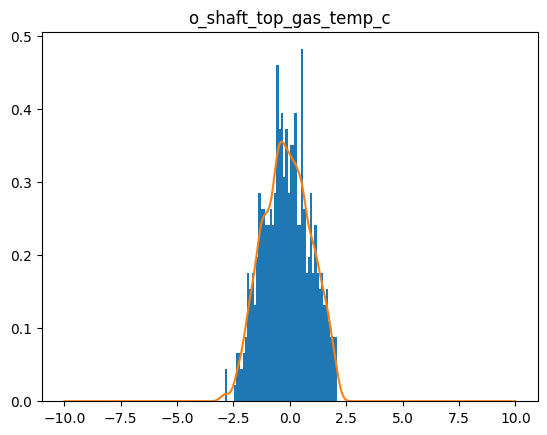

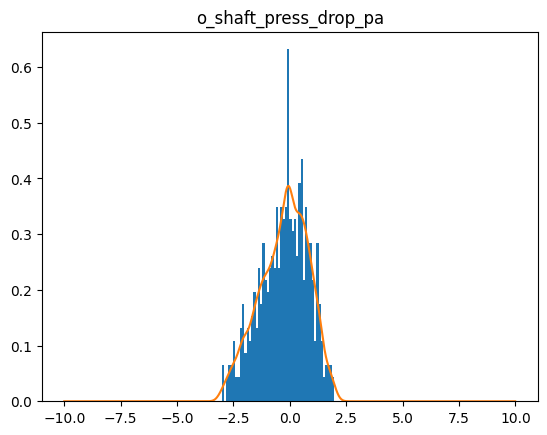

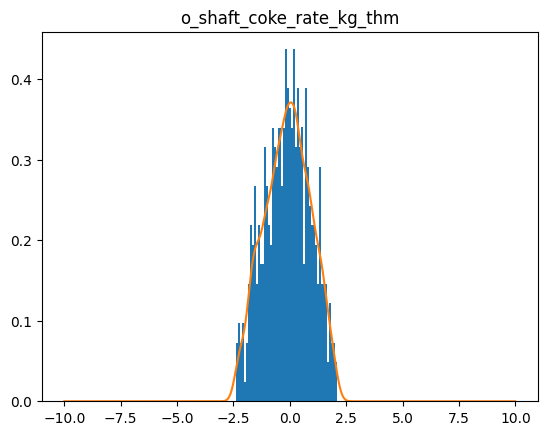

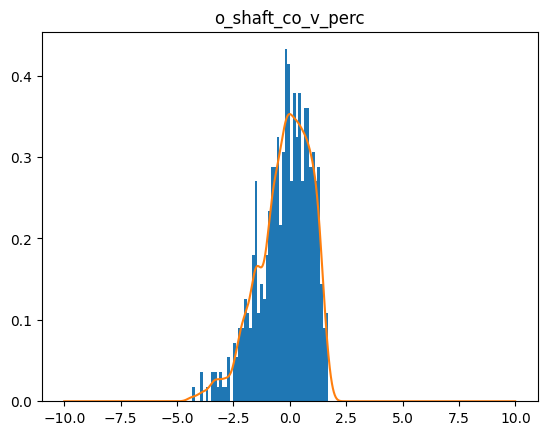

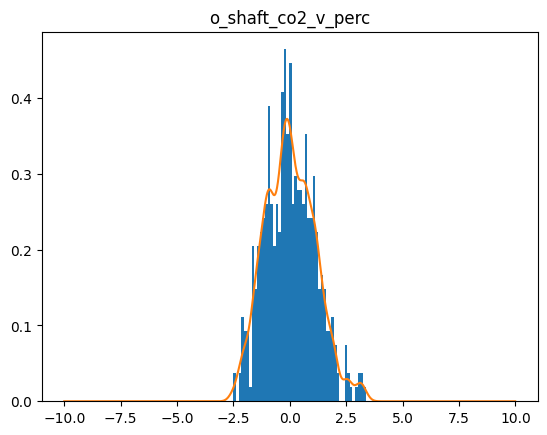

torch.Size([2000])
6101  loss=  tensor(0.0226, grad_fn=<MeanBackward0>)
6102  loss=  tensor(0.0226, grad_fn=<MeanBackward0>)
6103  loss=  tensor(0.0226, grad_fn=<MeanBackward0>)
6104  loss=  tensor(0.0226, grad_fn=<MeanBackward0>)
6105  loss=  tensor(0.0226, grad_fn=<MeanBackward0>)
6106  loss=  tensor(0.0226, grad_fn=<MeanBackward0>)
6107  loss=  tensor(0.0226, grad_fn=<MeanBackward0>)
6108  loss=  tensor(0.0225, grad_fn=<MeanBackward0>)
6109  loss=  tensor(0.0225, grad_fn=<MeanBackward0>)
6110  loss=  tensor(0.0225, grad_fn=<MeanBackward0>)
6111  loss=  tensor(0.0225, grad_fn=<MeanBackward0>)
6112  loss=  tensor(0.0225, grad_fn=<MeanBackward0>)
6113  loss=  tensor(0.0225, grad_fn=<MeanBackward0>)
6114  loss=  tensor(0.0225, grad_fn=<MeanBackward0>)
6115  loss=  tensor(0.0225, grad_fn=<MeanBackward0>)
6116  loss=  tensor(0.0224, grad_fn=<MeanBackward0>)
6117  loss=  tensor(0.0224, grad_fn=<MeanBackward0>)
6118  loss=  tensor(0.0224, grad_fn=<MeanBackward0>)
6119  loss=  tensor(0.0224,

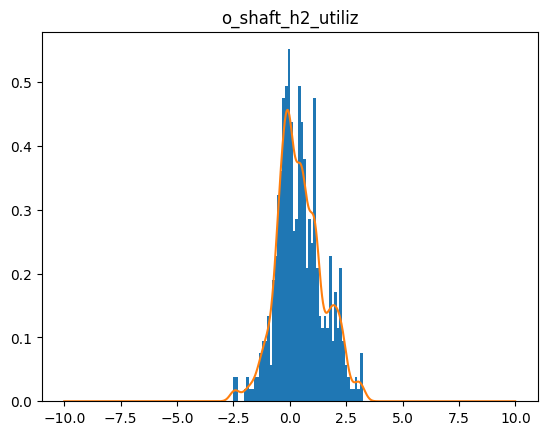

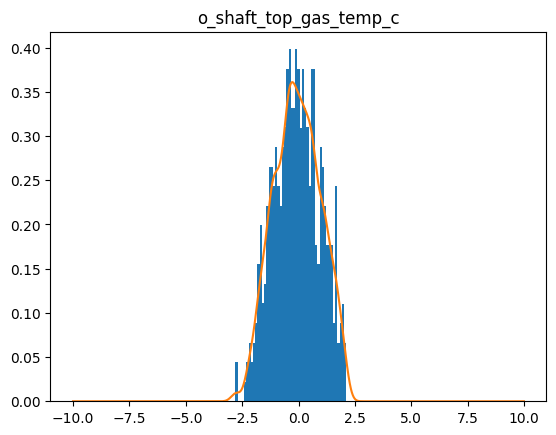

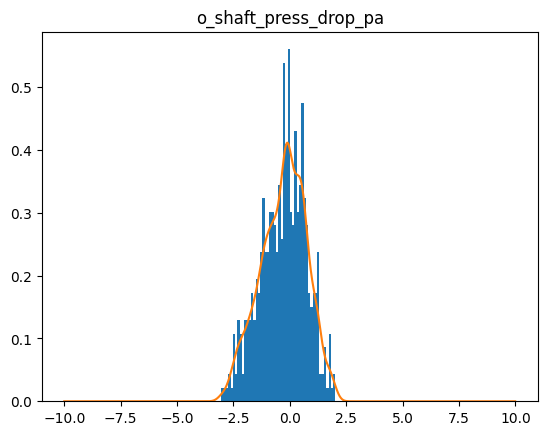

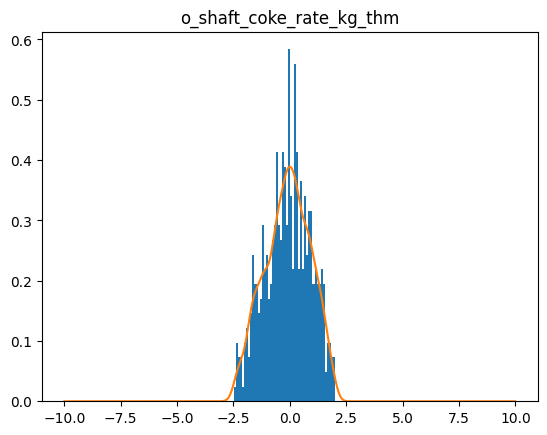

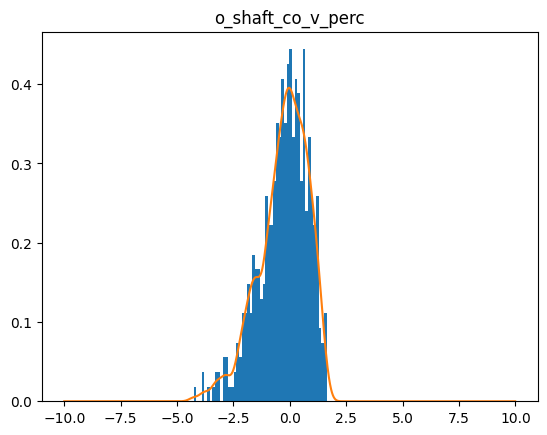

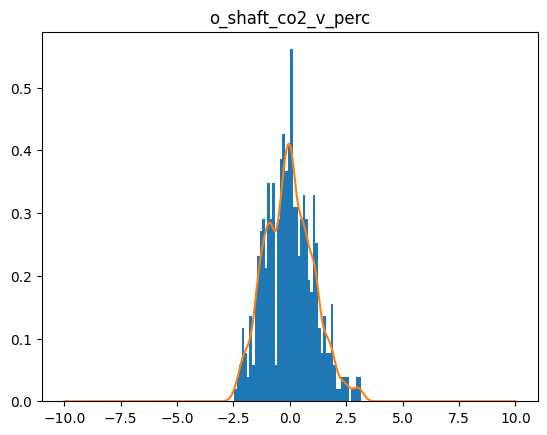

torch.Size([2000])
6201  loss=  tensor(0.0214, grad_fn=<MeanBackward0>)
6202  loss=  tensor(0.0213, grad_fn=<MeanBackward0>)
6203  loss=  tensor(0.0213, grad_fn=<MeanBackward0>)
6204  loss=  tensor(0.0213, grad_fn=<MeanBackward0>)
6205  loss=  tensor(0.0213, grad_fn=<MeanBackward0>)
6206  loss=  tensor(0.0213, grad_fn=<MeanBackward0>)
6207  loss=  tensor(0.0213, grad_fn=<MeanBackward0>)
6208  loss=  tensor(0.0213, grad_fn=<MeanBackward0>)
6209  loss=  tensor(0.0213, grad_fn=<MeanBackward0>)
6210  loss=  tensor(0.0212, grad_fn=<MeanBackward0>)
6211  loss=  tensor(0.0212, grad_fn=<MeanBackward0>)
6212  loss=  tensor(0.0212, grad_fn=<MeanBackward0>)
6213  loss=  tensor(0.0212, grad_fn=<MeanBackward0>)
6214  loss=  tensor(0.0212, grad_fn=<MeanBackward0>)
6215  loss=  tensor(0.0212, grad_fn=<MeanBackward0>)
6216  loss=  tensor(0.0212, grad_fn=<MeanBackward0>)
6217  loss=  tensor(0.0212, grad_fn=<MeanBackward0>)
6218  loss=  tensor(0.0211, grad_fn=<MeanBackward0>)
6219  loss=  tensor(0.0211,

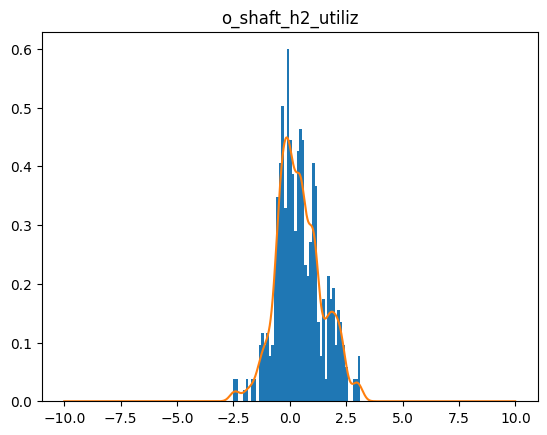

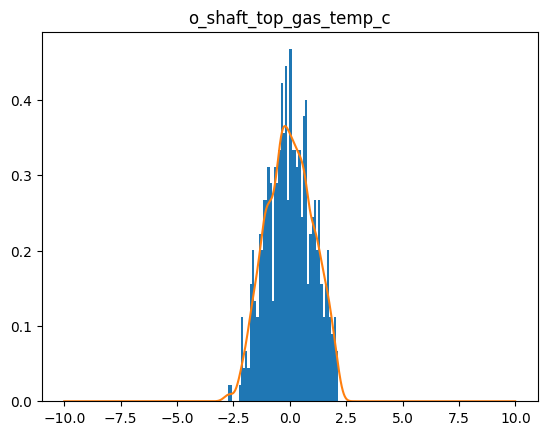

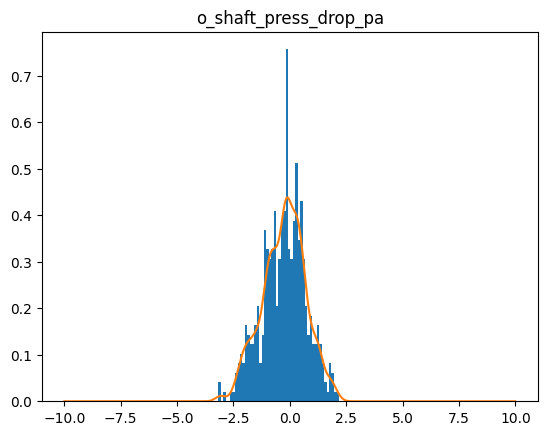

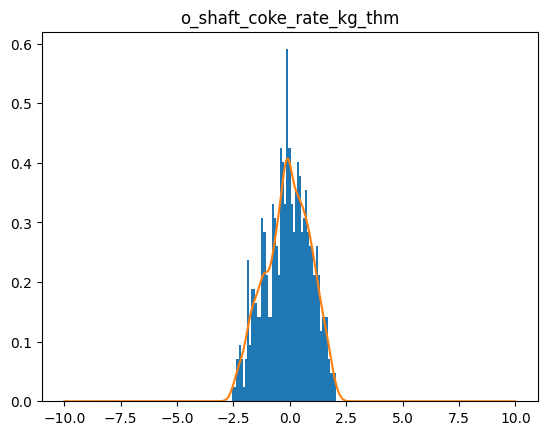

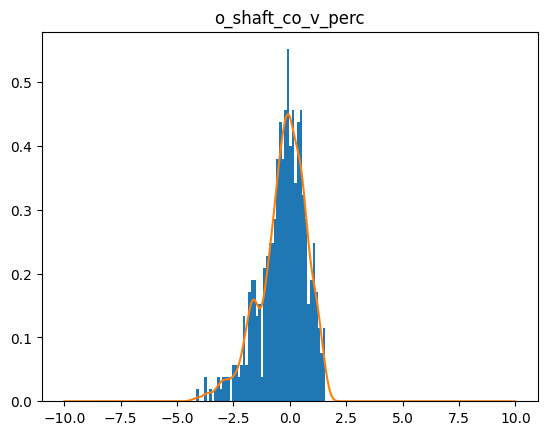

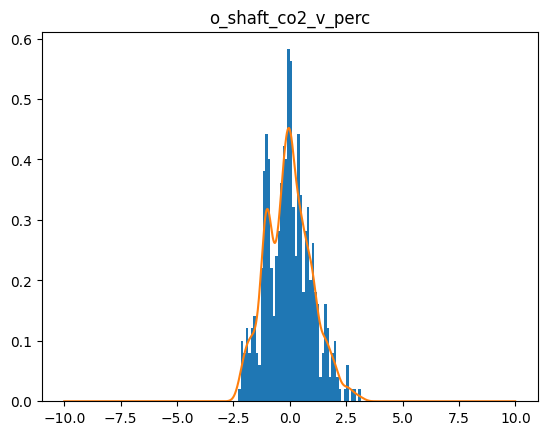

torch.Size([2000])
6301  loss=  tensor(0.0201, grad_fn=<MeanBackward0>)
6302  loss=  tensor(0.0201, grad_fn=<MeanBackward0>)
6303  loss=  tensor(0.0200, grad_fn=<MeanBackward0>)
6304  loss=  tensor(0.0200, grad_fn=<MeanBackward0>)
6305  loss=  tensor(0.0200, grad_fn=<MeanBackward0>)
6306  loss=  tensor(0.0200, grad_fn=<MeanBackward0>)
6307  loss=  tensor(0.0200, grad_fn=<MeanBackward0>)
6308  loss=  tensor(0.0200, grad_fn=<MeanBackward0>)
6309  loss=  tensor(0.0200, grad_fn=<MeanBackward0>)
6310  loss=  tensor(0.0199, grad_fn=<MeanBackward0>)
6311  loss=  tensor(0.0199, grad_fn=<MeanBackward0>)
6312  loss=  tensor(0.0199, grad_fn=<MeanBackward0>)
6313  loss=  tensor(0.0199, grad_fn=<MeanBackward0>)
6314  loss=  tensor(0.0199, grad_fn=<MeanBackward0>)
6315  loss=  tensor(0.0199, grad_fn=<MeanBackward0>)
6316  loss=  tensor(0.0199, grad_fn=<MeanBackward0>)
6317  loss=  tensor(0.0198, grad_fn=<MeanBackward0>)
6318  loss=  tensor(0.0198, grad_fn=<MeanBackward0>)
6319  loss=  tensor(0.0198,

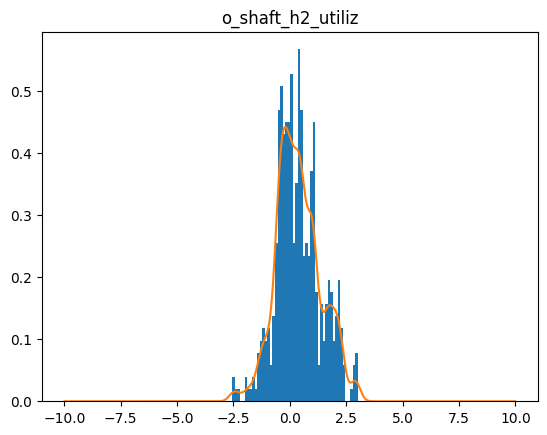

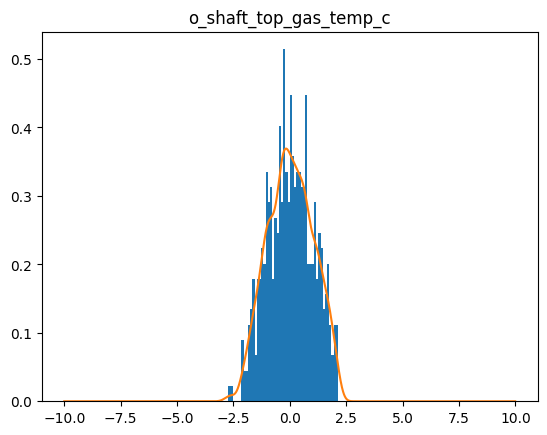

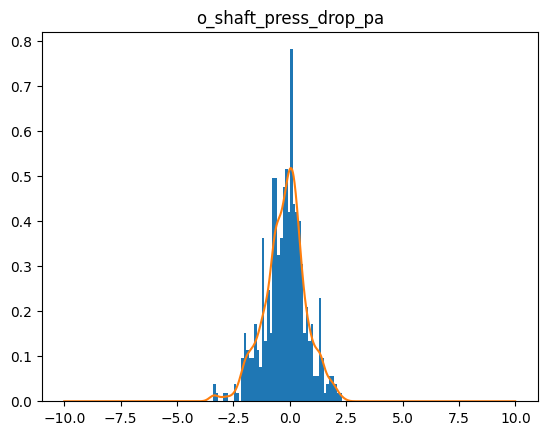

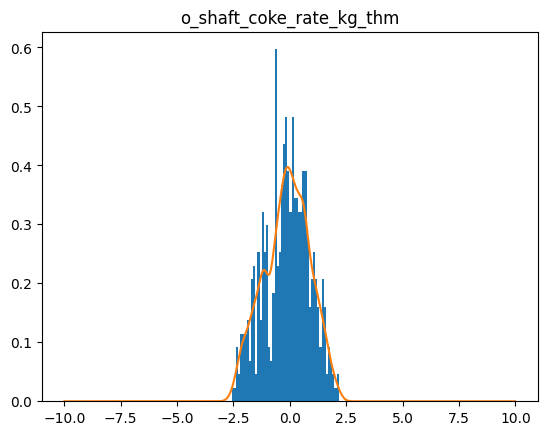

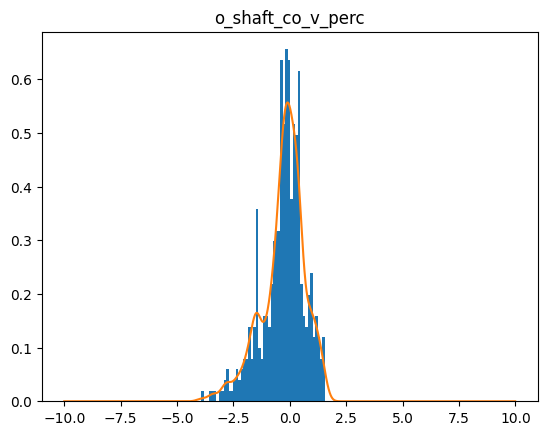

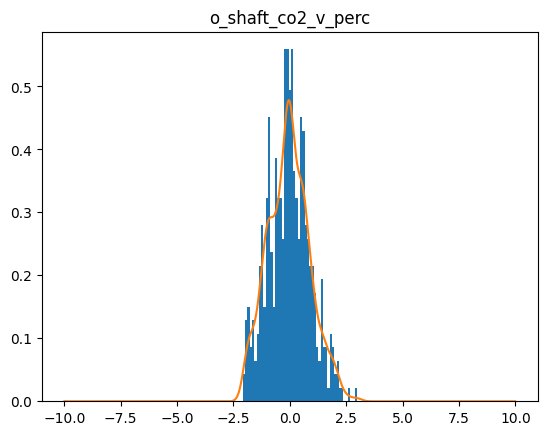

torch.Size([2000])
6401  loss=  tensor(0.0183, grad_fn=<MeanBackward0>)
6402  loss=  tensor(0.0183, grad_fn=<MeanBackward0>)
6403  loss=  tensor(0.0183, grad_fn=<MeanBackward0>)
6404  loss=  tensor(0.0183, grad_fn=<MeanBackward0>)
6405  loss=  tensor(0.0182, grad_fn=<MeanBackward0>)
6406  loss=  tensor(0.0182, grad_fn=<MeanBackward0>)
6407  loss=  tensor(0.0182, grad_fn=<MeanBackward0>)
6408  loss=  tensor(0.0182, grad_fn=<MeanBackward0>)
6409  loss=  tensor(0.0181, grad_fn=<MeanBackward0>)
6410  loss=  tensor(0.0181, grad_fn=<MeanBackward0>)
6411  loss=  tensor(0.0181, grad_fn=<MeanBackward0>)
6412  loss=  tensor(0.0181, grad_fn=<MeanBackward0>)
6413  loss=  tensor(0.0181, grad_fn=<MeanBackward0>)
6414  loss=  tensor(0.0180, grad_fn=<MeanBackward0>)
6415  loss=  tensor(0.0180, grad_fn=<MeanBackward0>)
6416  loss=  tensor(0.0180, grad_fn=<MeanBackward0>)
6417  loss=  tensor(0.0180, grad_fn=<MeanBackward0>)
6418  loss=  tensor(0.0180, grad_fn=<MeanBackward0>)
6419  loss=  tensor(0.0179,

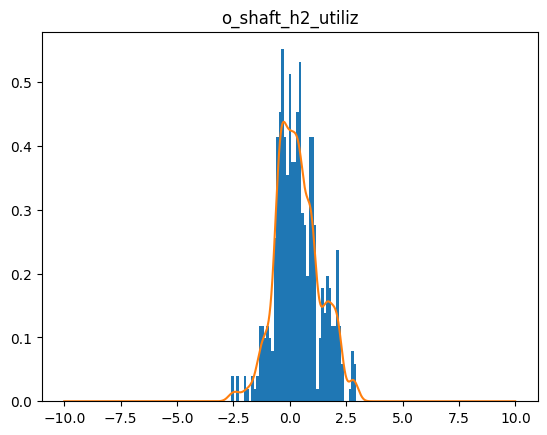

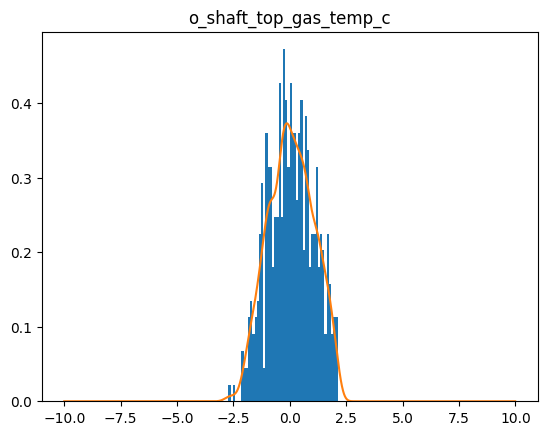

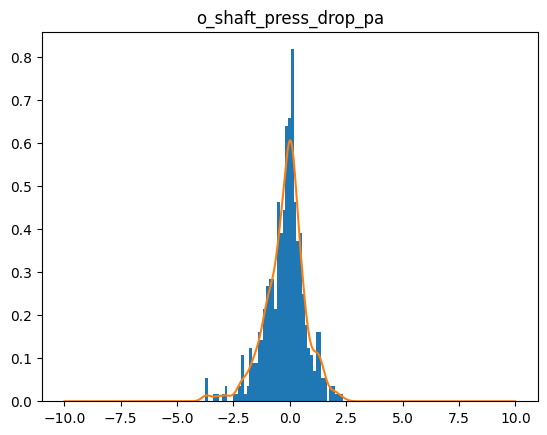

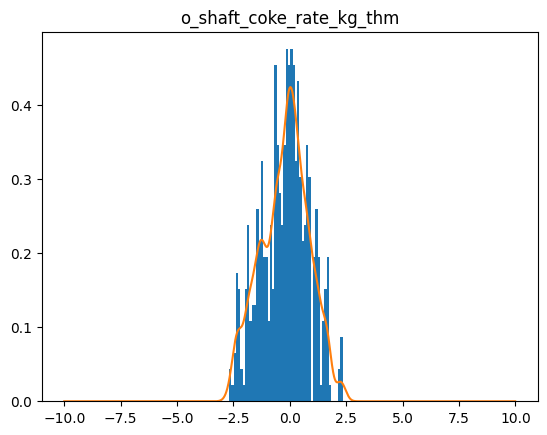

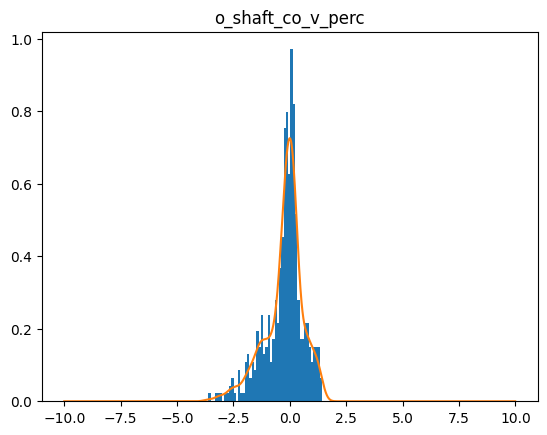

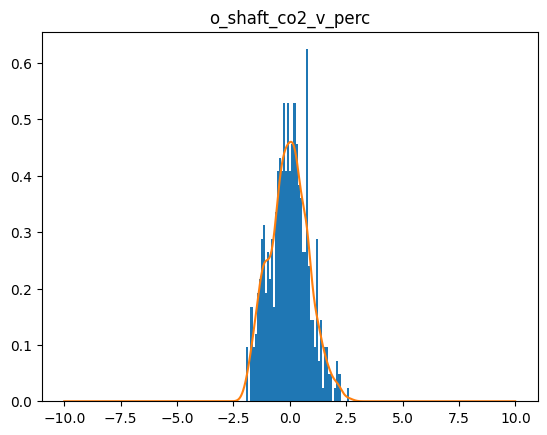

torch.Size([2000])
6501  loss=  tensor(0.0167, grad_fn=<MeanBackward0>)
6502  loss=  tensor(0.0167, grad_fn=<MeanBackward0>)
6503  loss=  tensor(0.0167, grad_fn=<MeanBackward0>)
6504  loss=  tensor(0.0167, grad_fn=<MeanBackward0>)
6505  loss=  tensor(0.0167, grad_fn=<MeanBackward0>)
6506  loss=  tensor(0.0167, grad_fn=<MeanBackward0>)
6507  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6508  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6509  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6510  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6511  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6512  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6513  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6514  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6515  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6516  loss=  tensor(0.0166, grad_fn=<MeanBackward0>)
6517  loss=  tensor(0.0165, grad_fn=<MeanBackward0>)
6518  loss=  tensor(0.0165, grad_fn=<MeanBackward0>)
6519  loss=  tensor(0.0165,

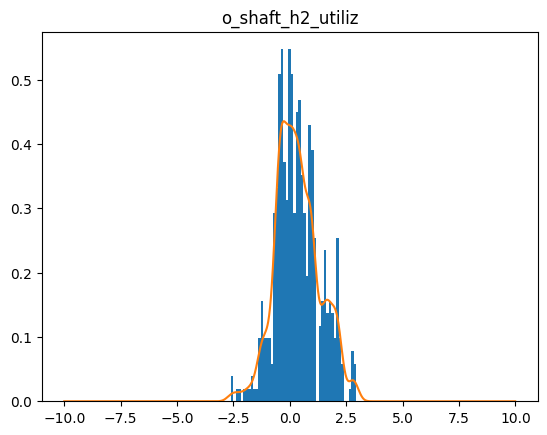

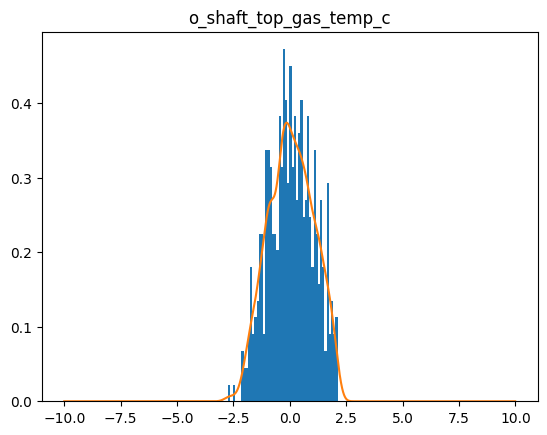

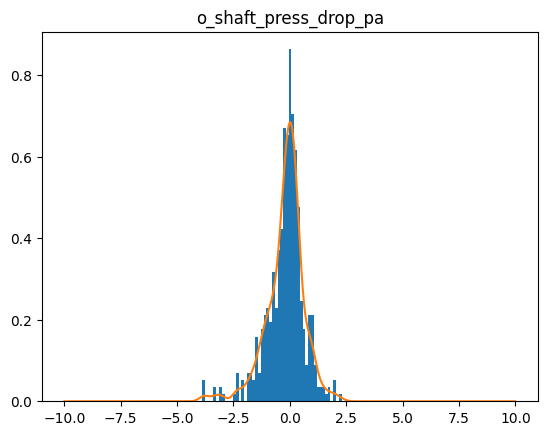

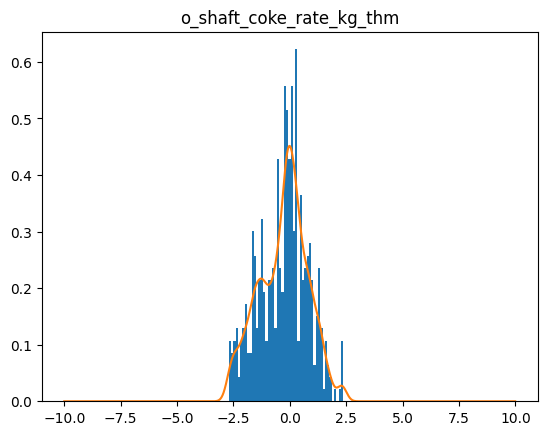

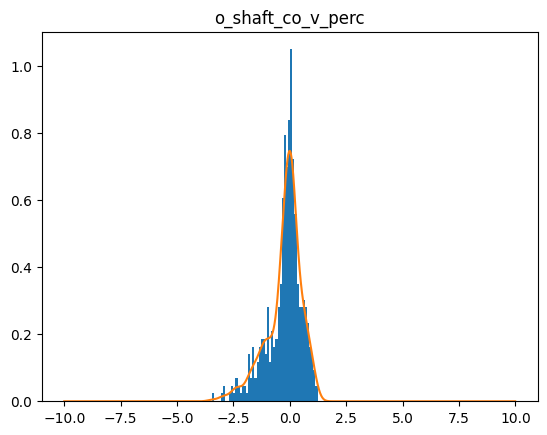

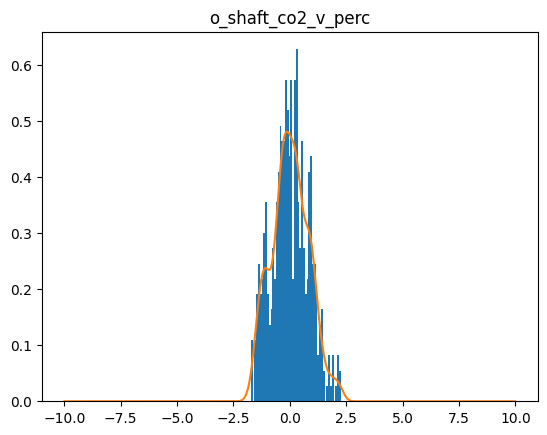

torch.Size([2000])
6601  loss=  tensor(0.0158, grad_fn=<MeanBackward0>)
6602  loss=  tensor(0.0158, grad_fn=<MeanBackward0>)
6603  loss=  tensor(0.0158, grad_fn=<MeanBackward0>)
6604  loss=  tensor(0.0158, grad_fn=<MeanBackward0>)
6605  loss=  tensor(0.0158, grad_fn=<MeanBackward0>)
6606  loss=  tensor(0.0158, grad_fn=<MeanBackward0>)
6607  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6608  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6609  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6610  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6611  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6612  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6613  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6614  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6615  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6616  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6617  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6618  loss=  tensor(0.0157, grad_fn=<MeanBackward0>)
6619  loss=  tensor(0.0157,

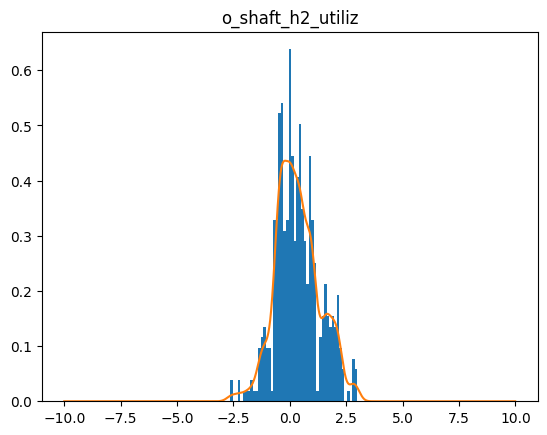

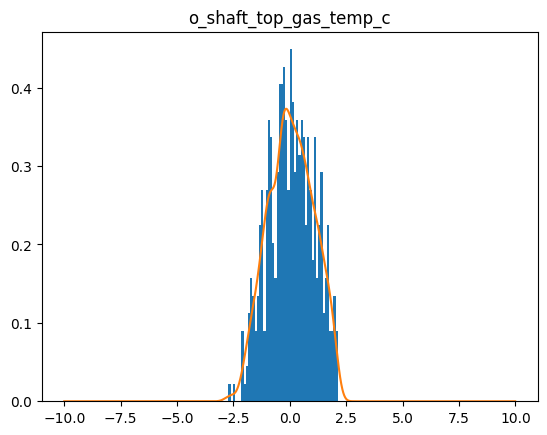

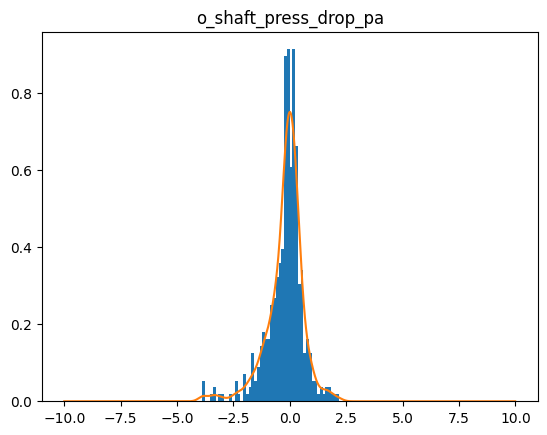

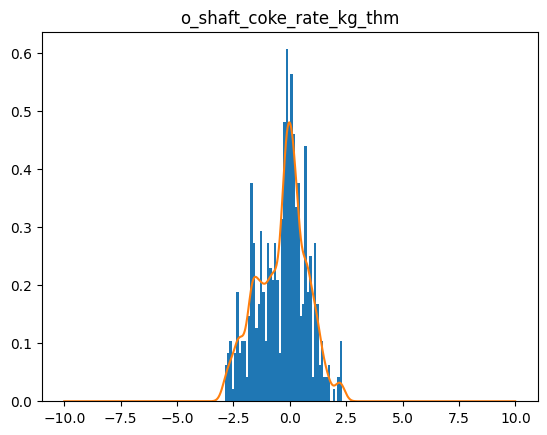

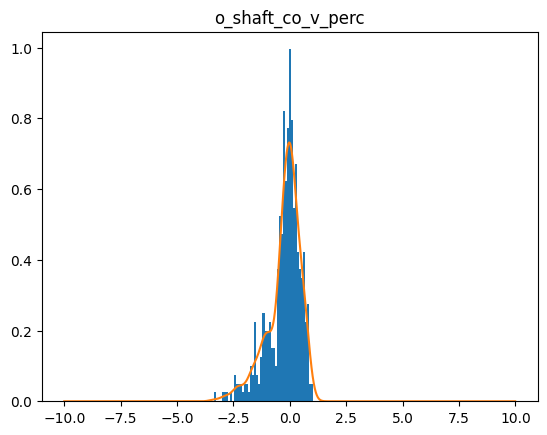

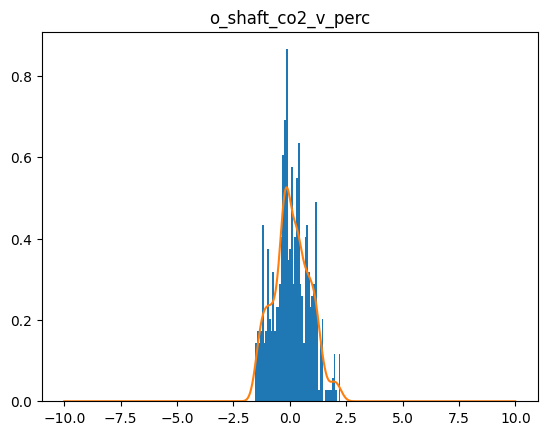

torch.Size([2000])
6701  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6702  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6703  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6704  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6705  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6706  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6707  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6708  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6709  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6710  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6711  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6712  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6713  loss=  tensor(0.0152, grad_fn=<MeanBackward0>)
6714  loss=  tensor(0.0151, grad_fn=<MeanBackward0>)
6715  loss=  tensor(0.0151, grad_fn=<MeanBackward0>)
6716  loss=  tensor(0.0151, grad_fn=<MeanBackward0>)
6717  loss=  tensor(0.0151, grad_fn=<MeanBackward0>)
6718  loss=  tensor(0.0151, grad_fn=<MeanBackward0>)
6719  loss=  tensor(0.0151,

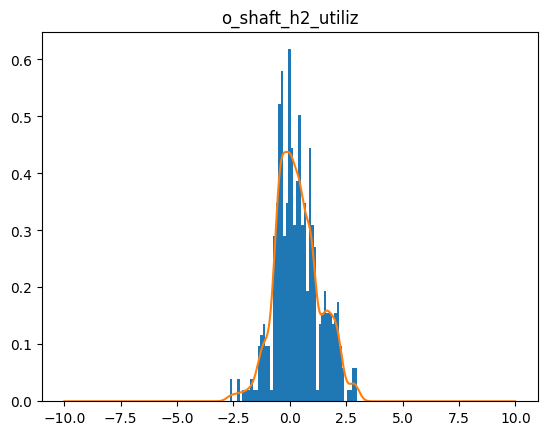

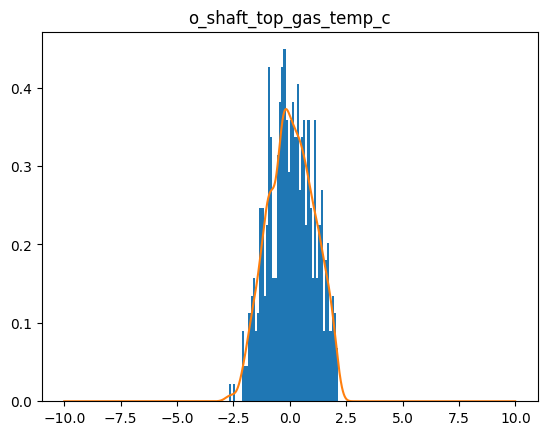

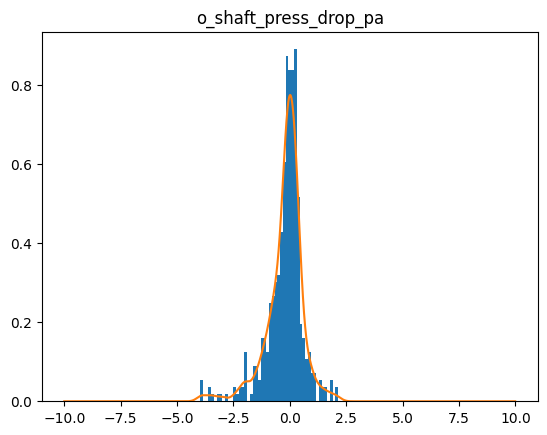

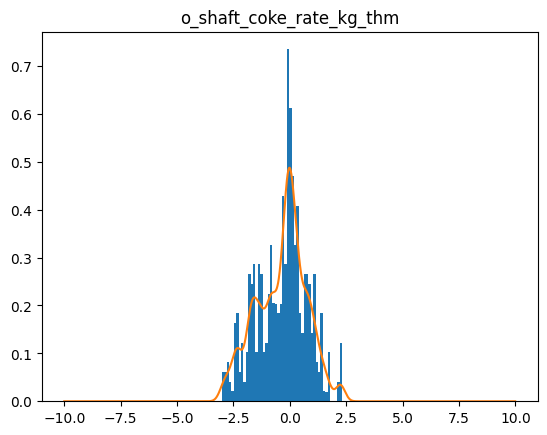

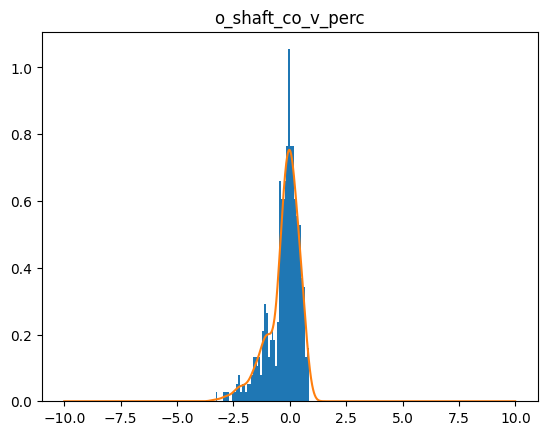

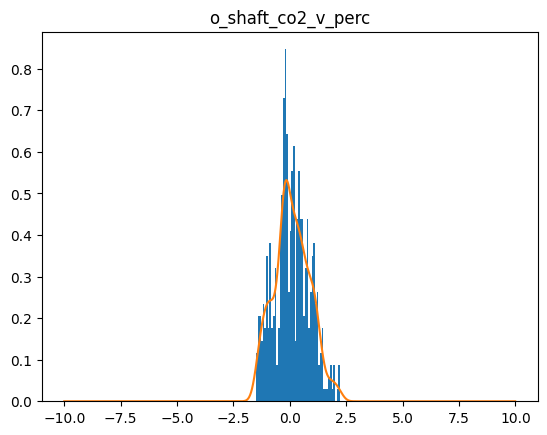

torch.Size([2000])
6801  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6802  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6803  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6804  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6805  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6806  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6807  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6808  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6809  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6810  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6811  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6812  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6813  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6814  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6815  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6816  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6817  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6818  loss=  tensor(0.0149, grad_fn=<MeanBackward0>)
6819  loss=  tensor(0.0149,

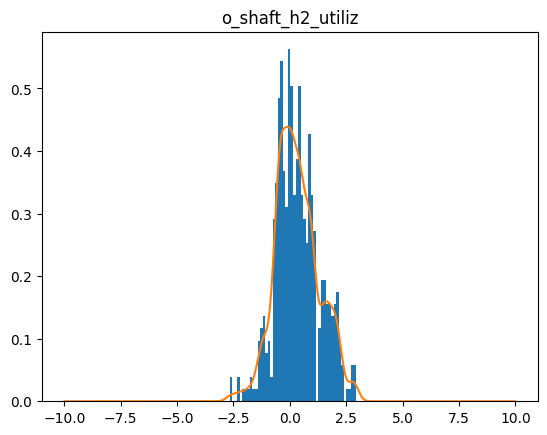

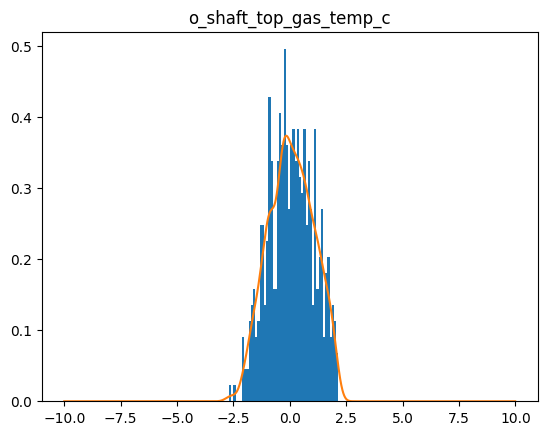

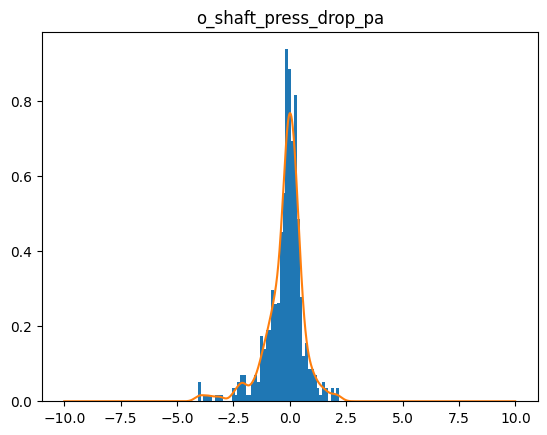

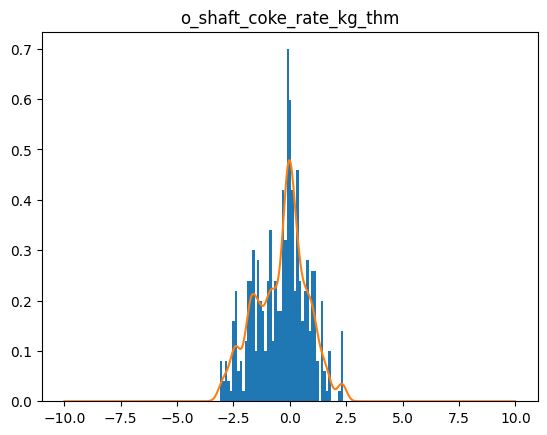

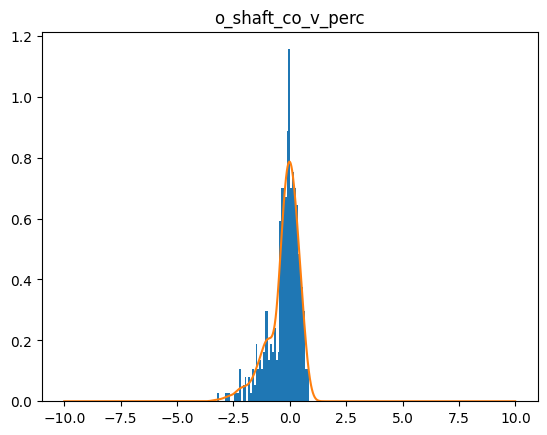

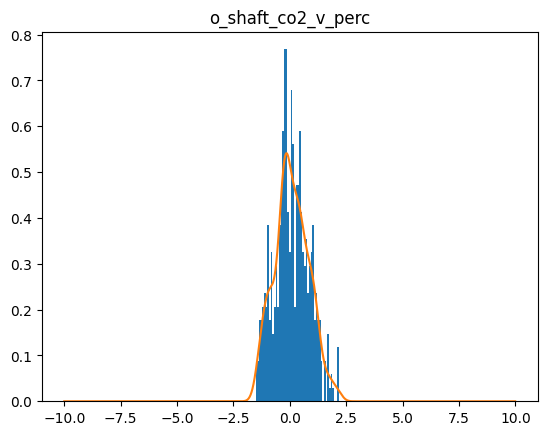

torch.Size([2000])
6901  loss=  tensor(0.0148, grad_fn=<MeanBackward0>)
6902  loss=  tensor(0.0148, grad_fn=<MeanBackward0>)
6903  loss=  tensor(0.0148, grad_fn=<MeanBackward0>)
6904  loss=  tensor(0.0148, grad_fn=<MeanBackward0>)
6905  loss=  tensor(0.0148, grad_fn=<MeanBackward0>)
6906  loss=  tensor(0.0148, grad_fn=<MeanBackward0>)
6907  loss=  tensor(0.0148, grad_fn=<MeanBackward0>)
6908  loss=  tensor(0.0148, grad_fn=<MeanBackward0>)
6909  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6910  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6911  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6912  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6913  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6914  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6915  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6916  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6917  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6918  loss=  tensor(0.0147, grad_fn=<MeanBackward0>)
6919  loss=  tensor(0.0147,

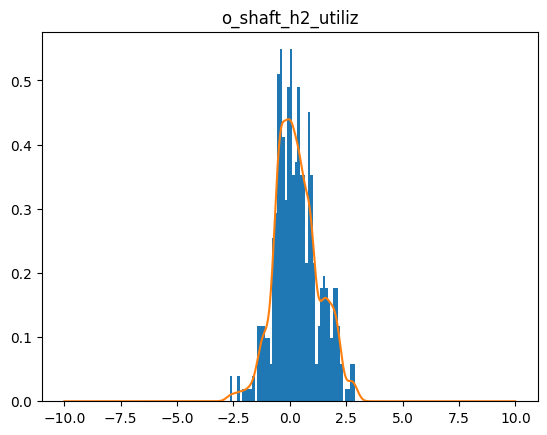

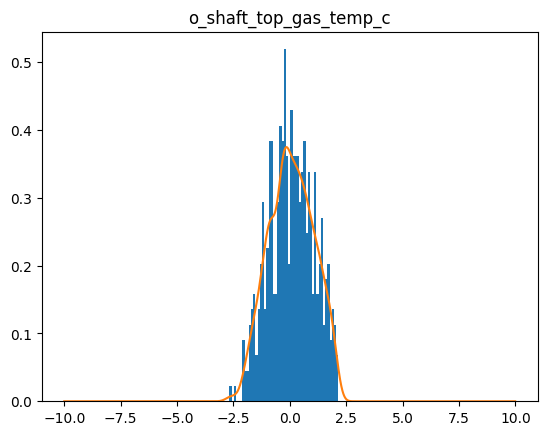

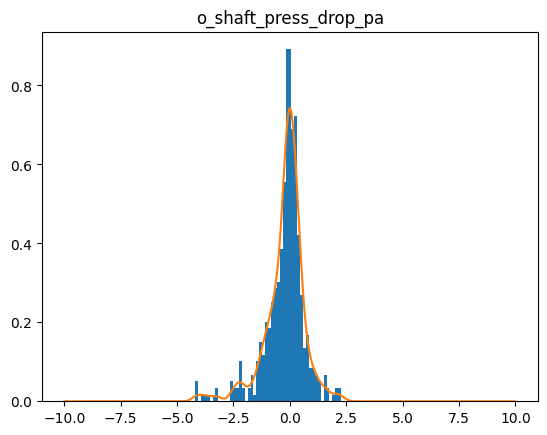

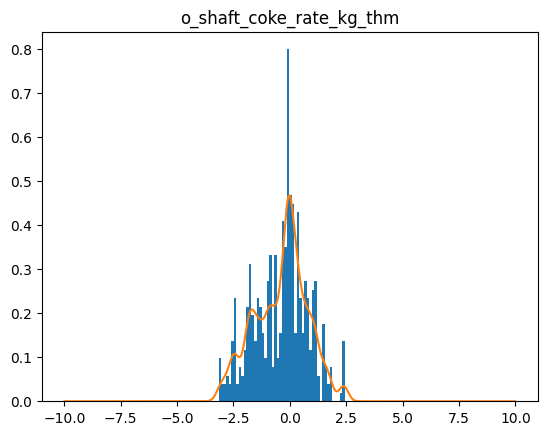

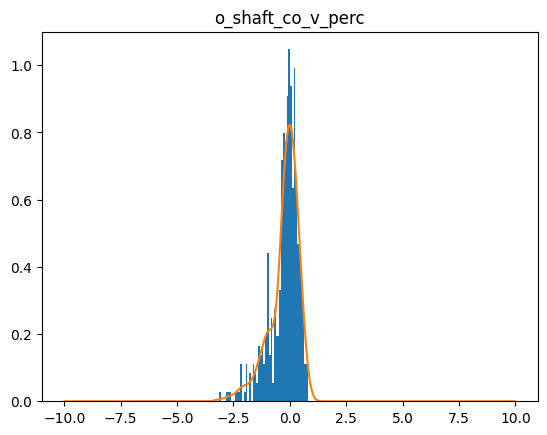

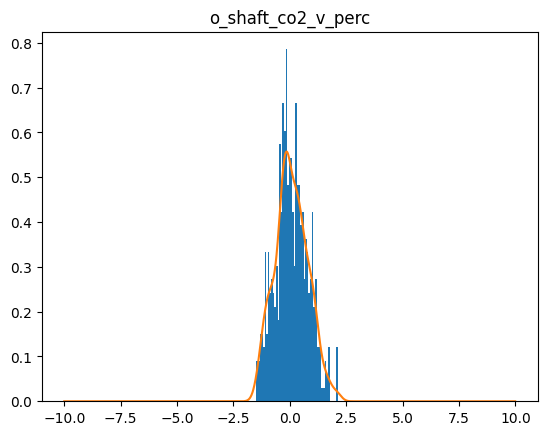

torch.Size([2000])
7001  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7002  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7003  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7004  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7005  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7006  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7007  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7008  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7009  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7010  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7011  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7012  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7013  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7014  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7015  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7016  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7017  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7018  loss=  tensor(0.0146, grad_fn=<MeanBackward0>)
7019  loss=  tensor(0.0146,

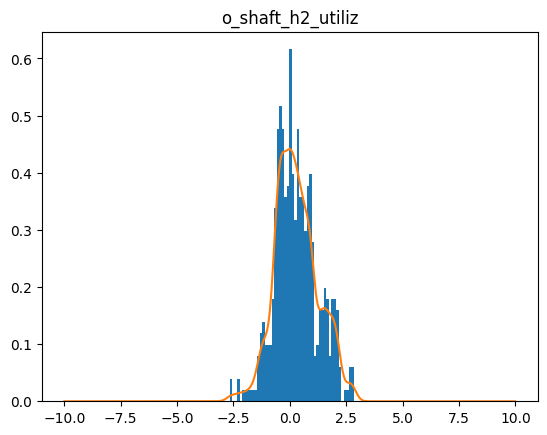

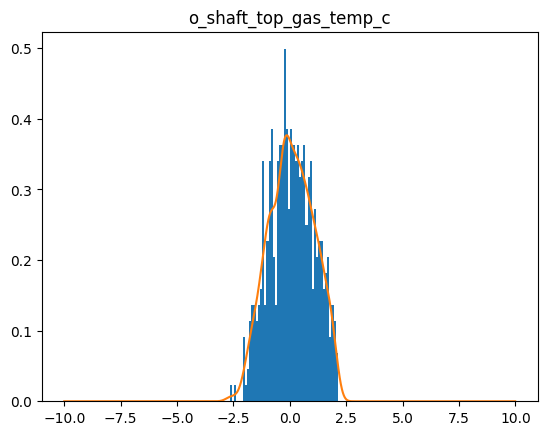

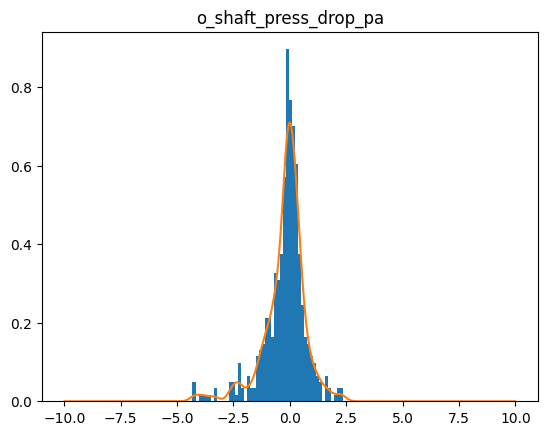

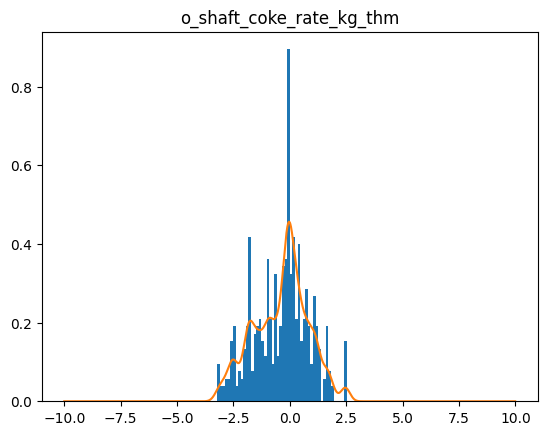

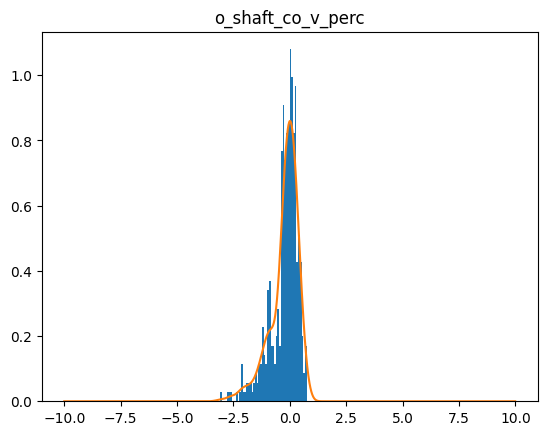

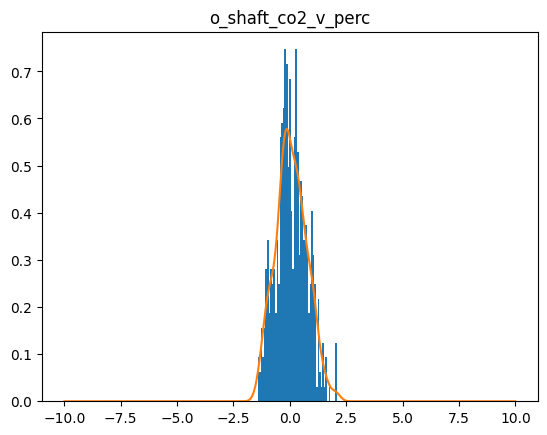

torch.Size([2000])
7101  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7102  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7103  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7104  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7105  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7106  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7107  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7108  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7109  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7110  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7111  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7112  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7113  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7114  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7115  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7116  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7117  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7118  loss=  tensor(0.0145, grad_fn=<MeanBackward0>)
7119  loss=  tensor(0.0145,

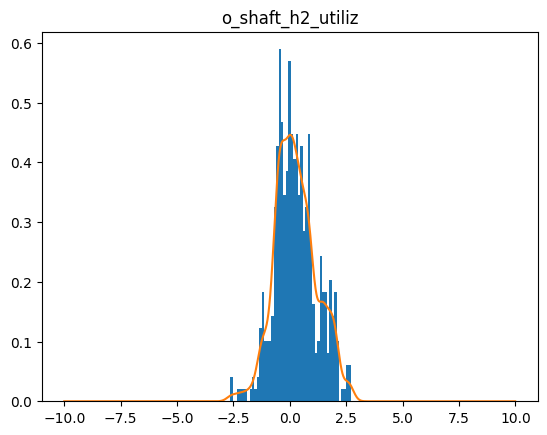

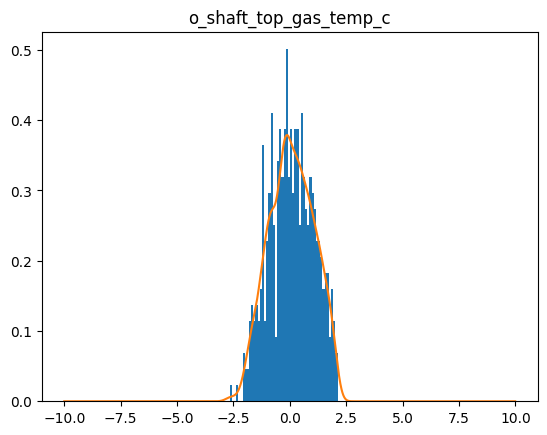

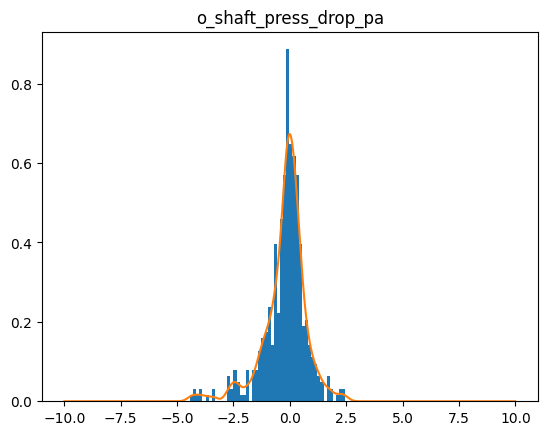

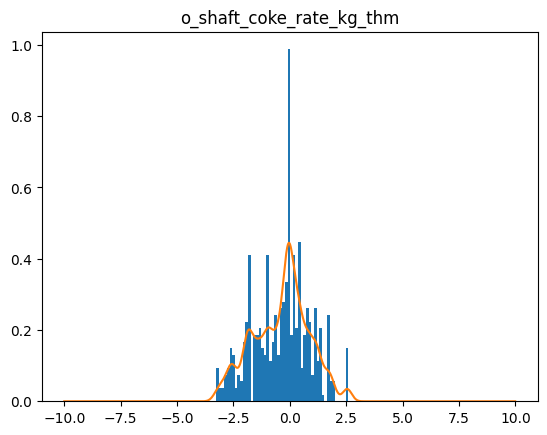

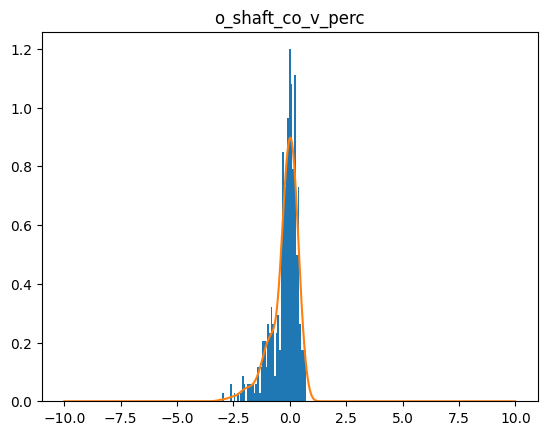

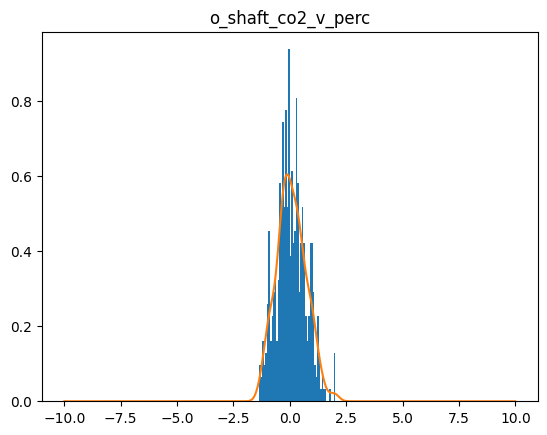

torch.Size([2000])
7201  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7202  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7203  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7204  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7205  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7206  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7207  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7208  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7209  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7210  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7211  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7212  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7213  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7214  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7215  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7216  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7217  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7218  loss=  tensor(0.0144, grad_fn=<MeanBackward0>)
7219  loss=  tensor(0.0144,

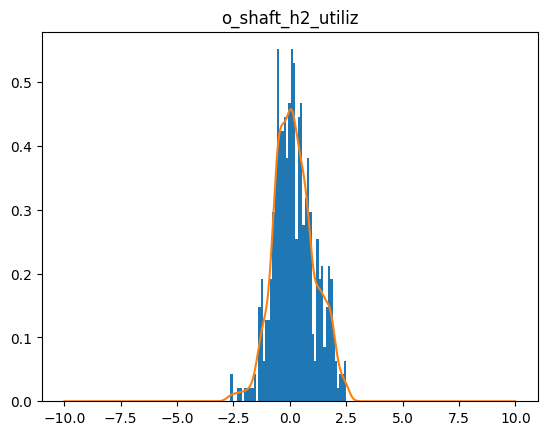

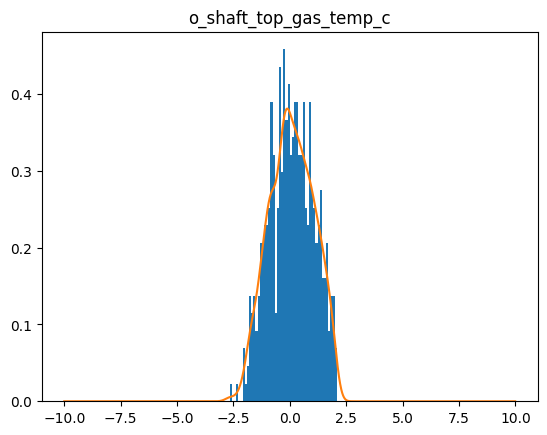

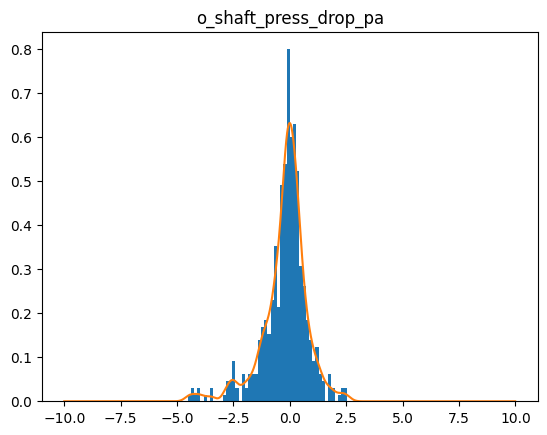

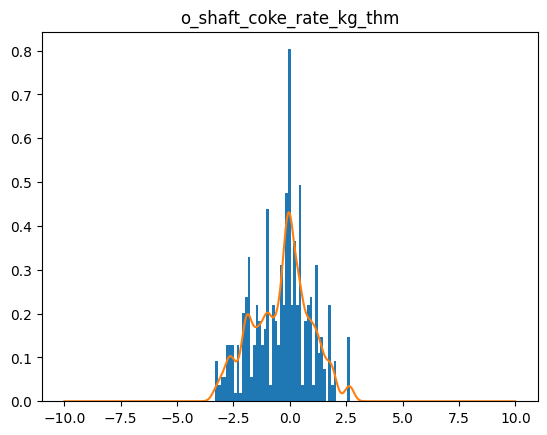

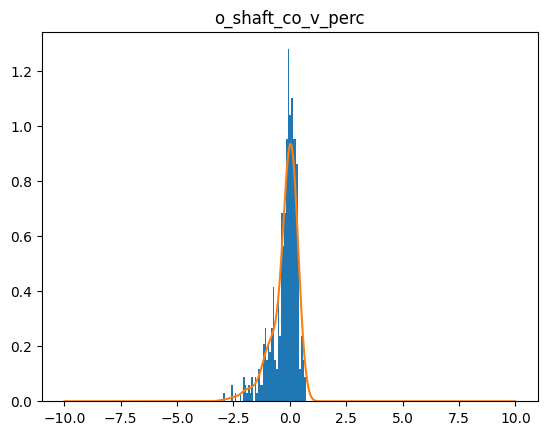

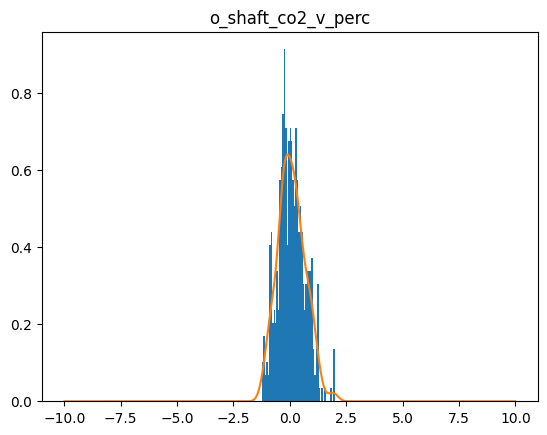

torch.Size([2000])
7301  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7302  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7303  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7304  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7305  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7306  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7307  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7308  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7309  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7310  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7311  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7312  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7313  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7314  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7315  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7316  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7317  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7318  loss=  tensor(0.0143, grad_fn=<MeanBackward0>)
7319  loss=  tensor(0.0143,

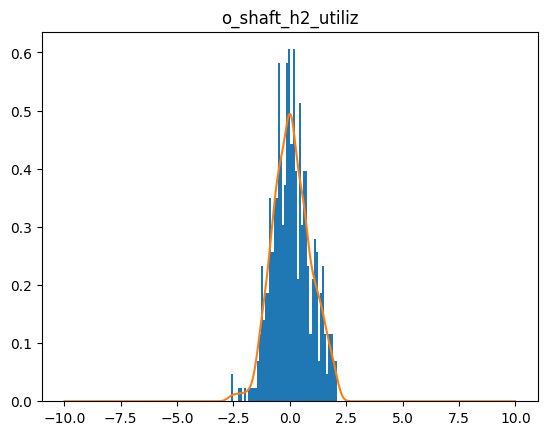

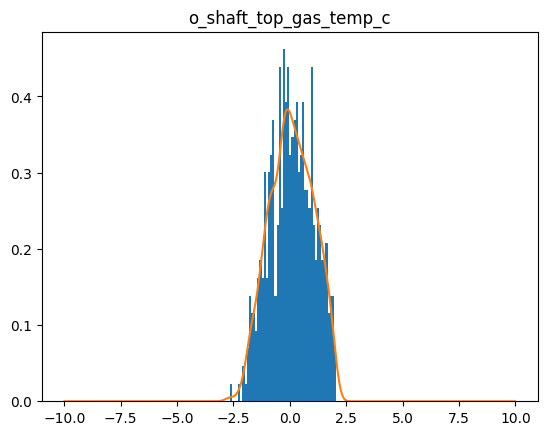

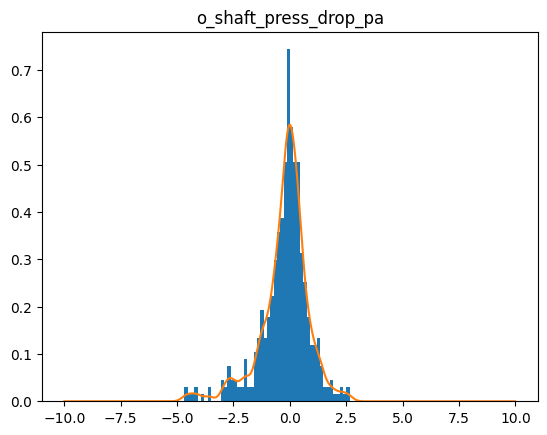

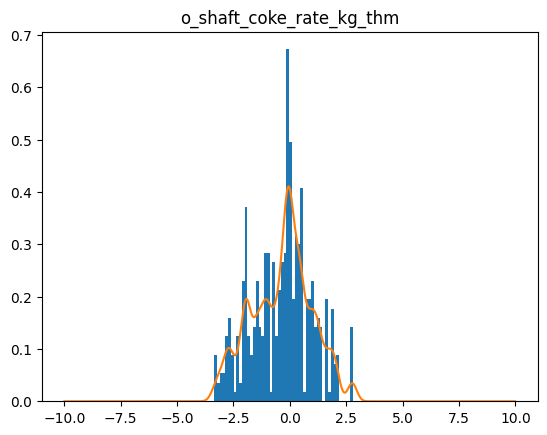

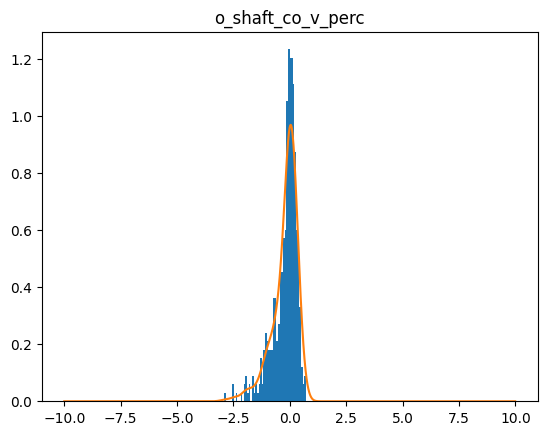

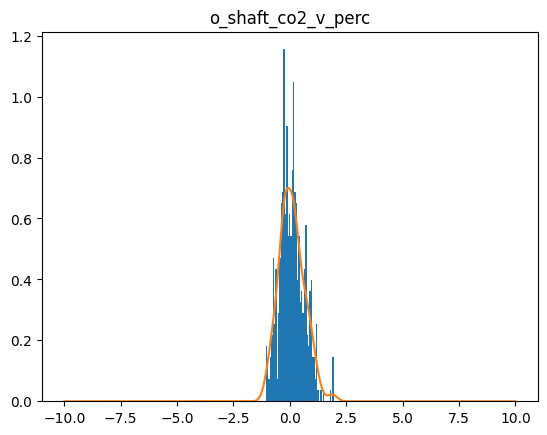

torch.Size([2000])
7401  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7402  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7403  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7404  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7405  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7406  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7407  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7408  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7409  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7410  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7411  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7412  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7413  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7414  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7415  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7416  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7417  loss=  tensor(0.0142, grad_fn=<MeanBackward0>)
7418  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7419  loss=  tensor(0.0141,

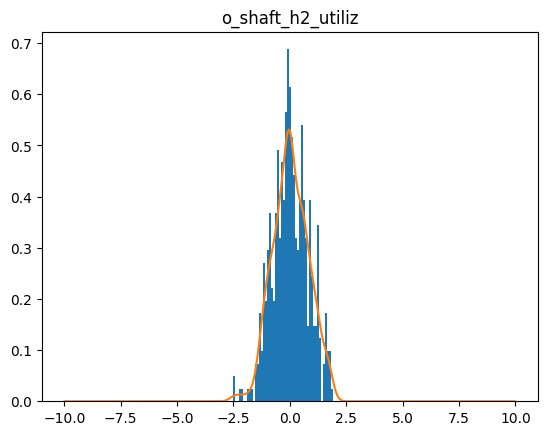

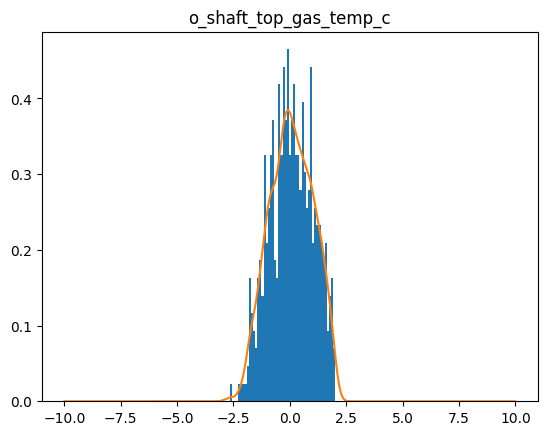

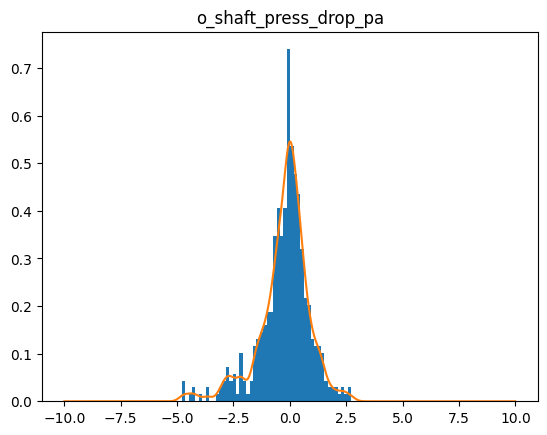

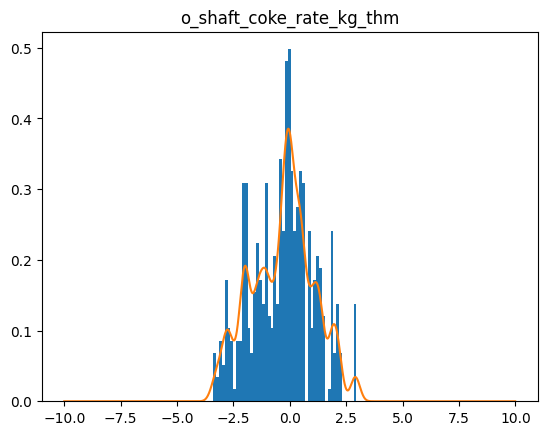

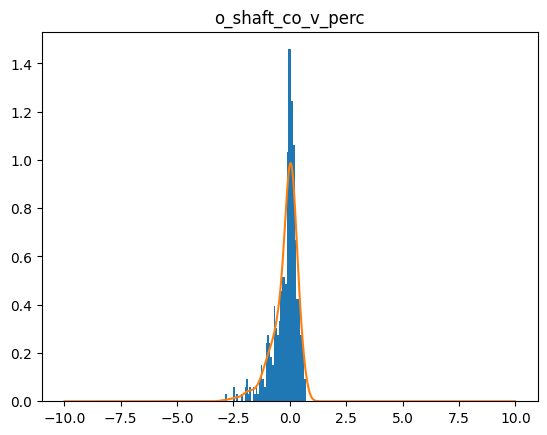

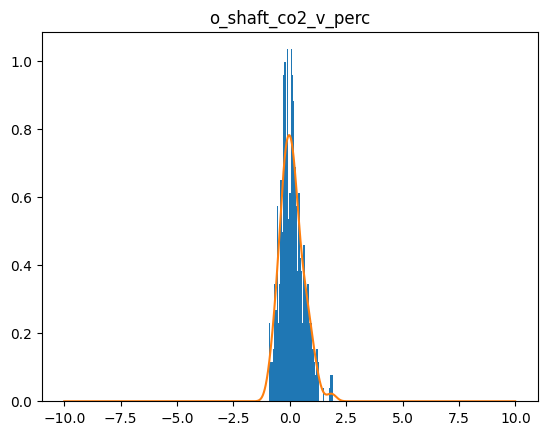

torch.Size([2000])
7501  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7502  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7503  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7504  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7505  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7506  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7507  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7508  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7509  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7510  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7511  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7512  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7513  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7514  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7515  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7516  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7517  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7518  loss=  tensor(0.0141, grad_fn=<MeanBackward0>)
7519  loss=  tensor(0.0141,

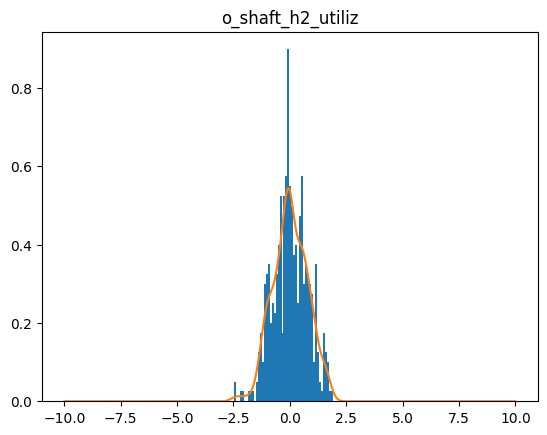

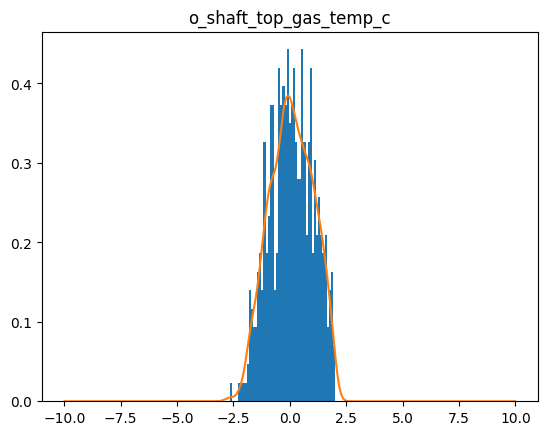

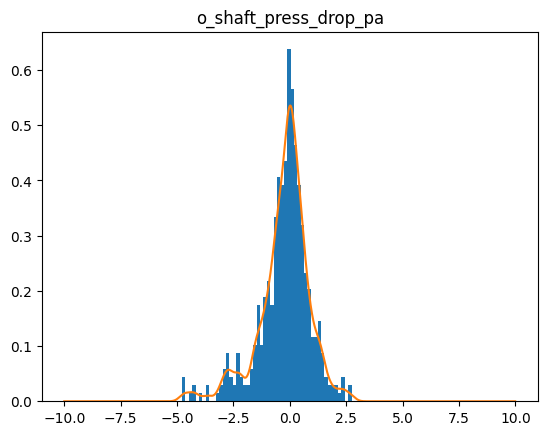

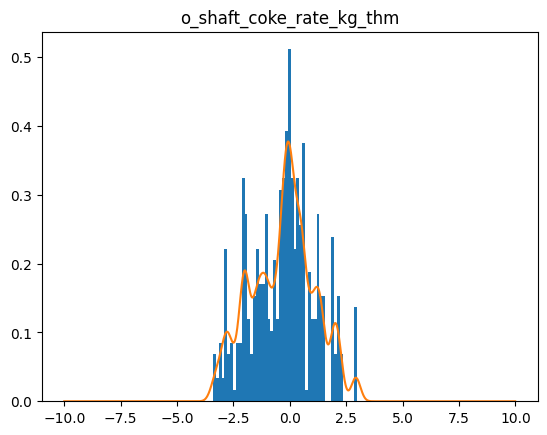

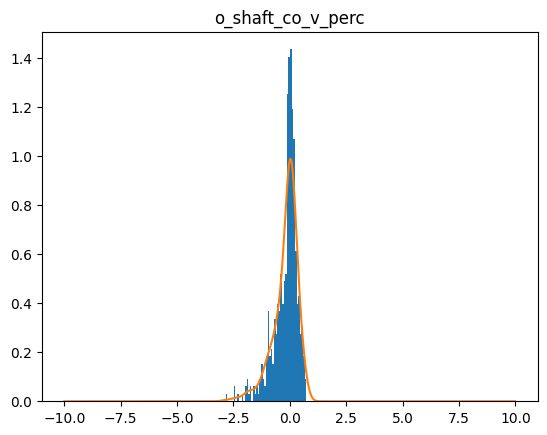

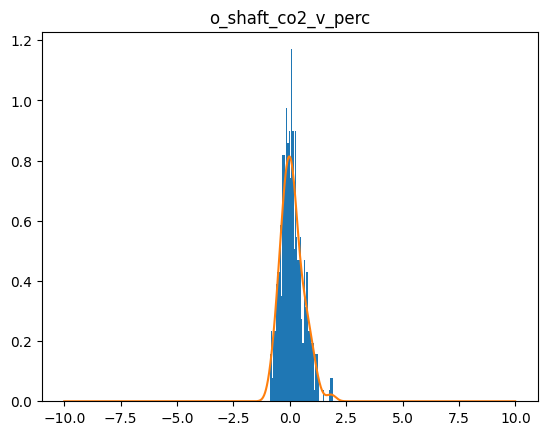

torch.Size([2000])
7601  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7602  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7603  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7604  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7605  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7606  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7607  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7608  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7609  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7610  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7611  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7612  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7613  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7614  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7615  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7616  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7617  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7618  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7619  loss=  tensor(0.0140,

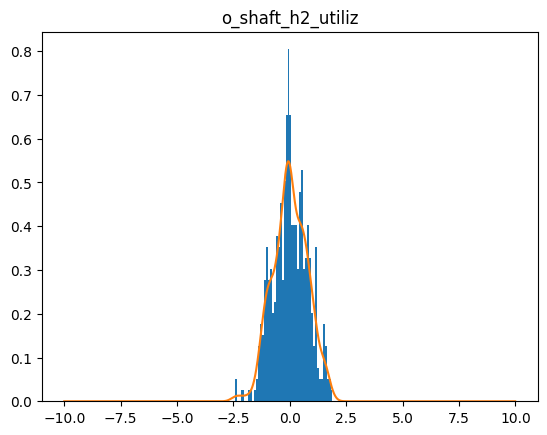

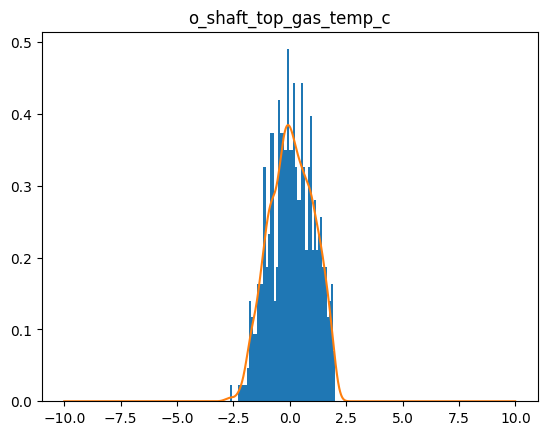

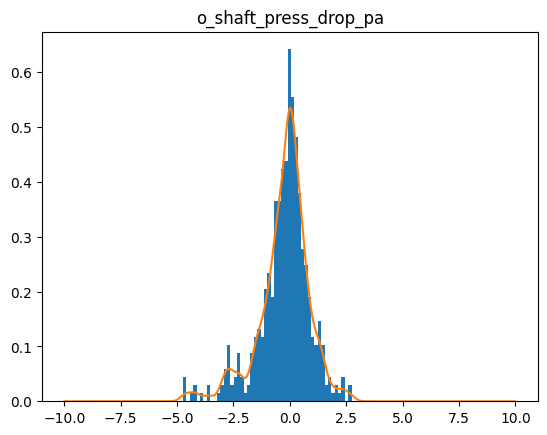

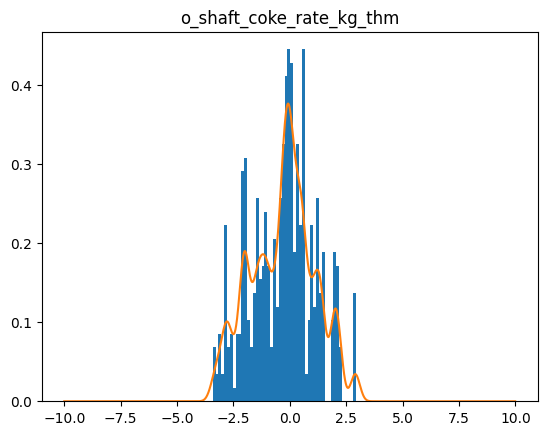

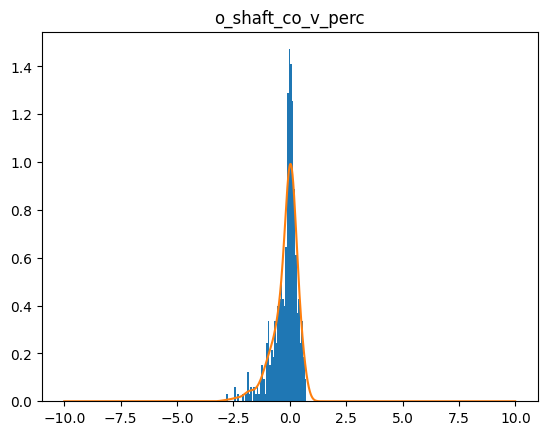

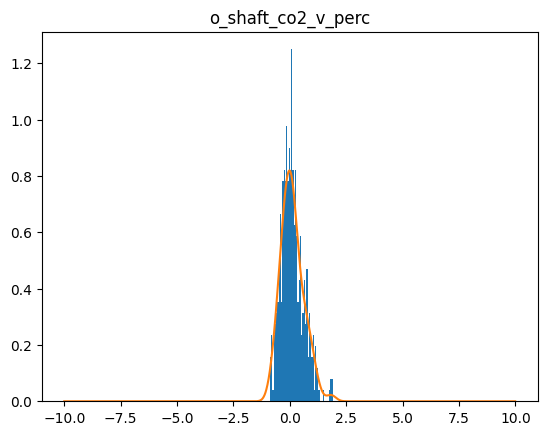

torch.Size([2000])
7701  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7702  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7703  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7704  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7705  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7706  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7707  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7708  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7709  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7710  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7711  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7712  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7713  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7714  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7715  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7716  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7717  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7718  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7719  loss=  tensor(0.0140,

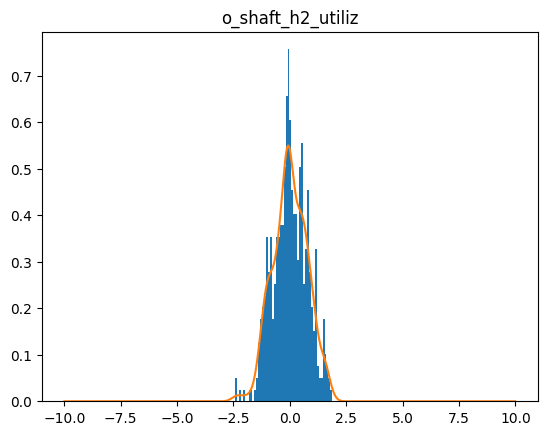

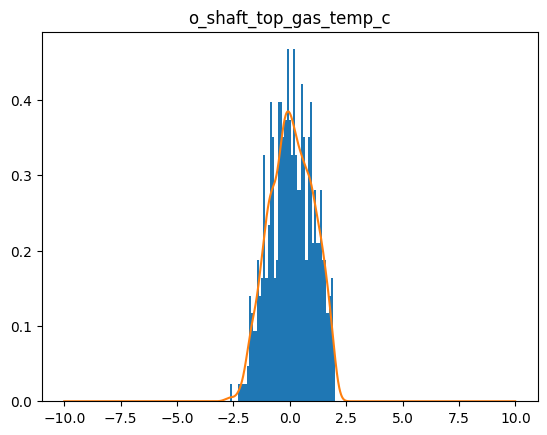

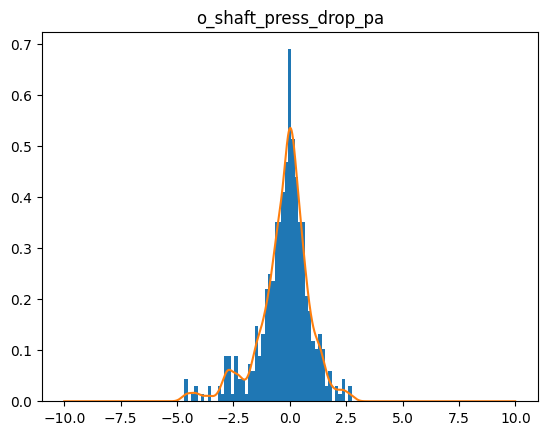

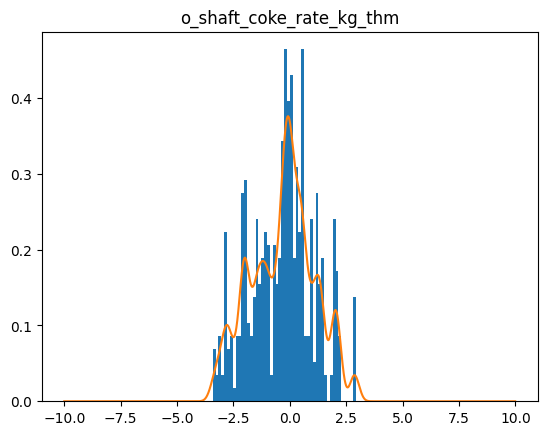

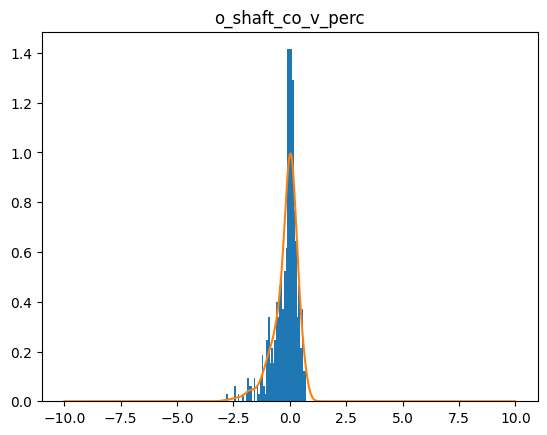

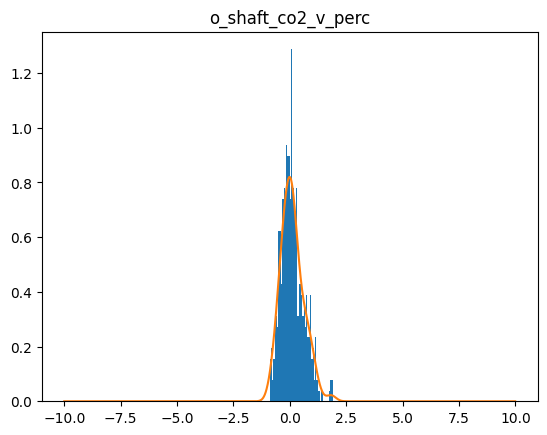

torch.Size([2000])
7801  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7802  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7803  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7804  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7805  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7806  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7807  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7808  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7809  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7810  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7811  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7812  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7813  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7814  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7815  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7816  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7817  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7818  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7819  loss=  tensor(0.0140,

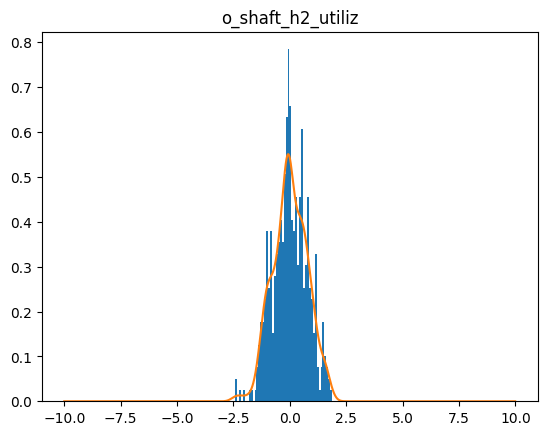

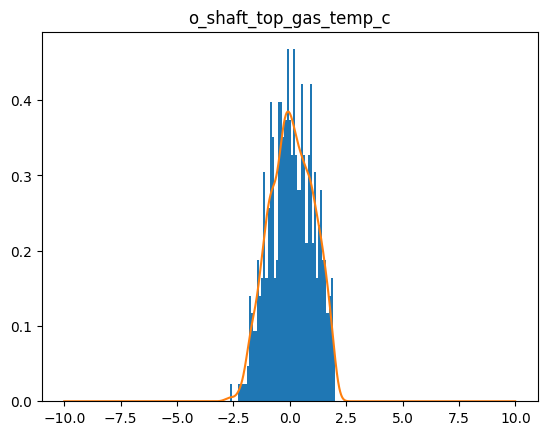

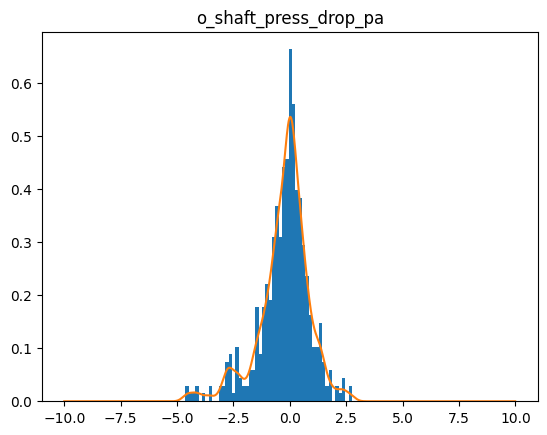

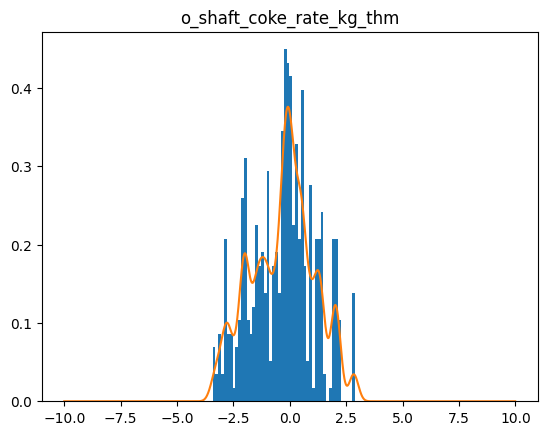

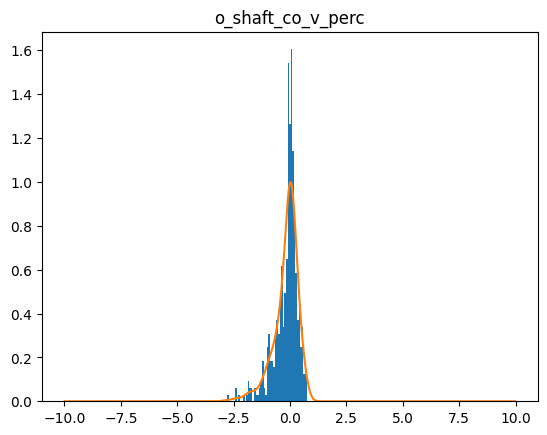

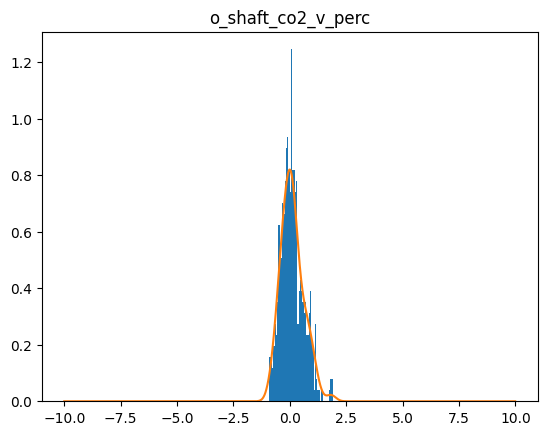

torch.Size([2000])
7901  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7902  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7903  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7904  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7905  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7906  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7907  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7908  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7909  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7910  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7911  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7912  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7913  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7914  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7915  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7916  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7917  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7918  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
7919  loss=  tensor(0.0140,

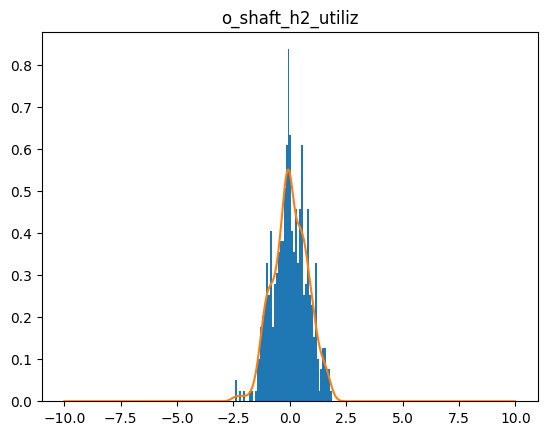

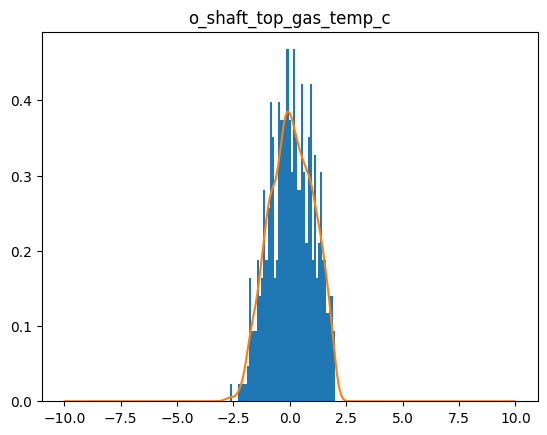

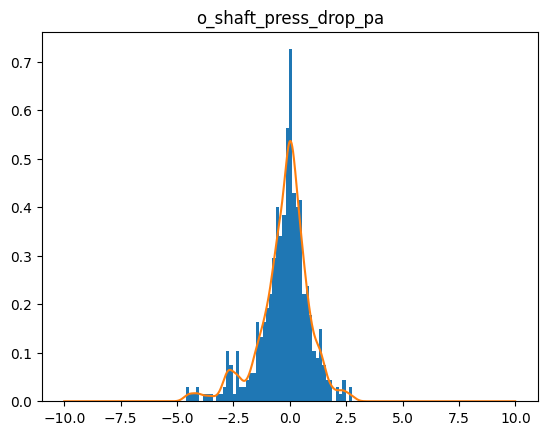

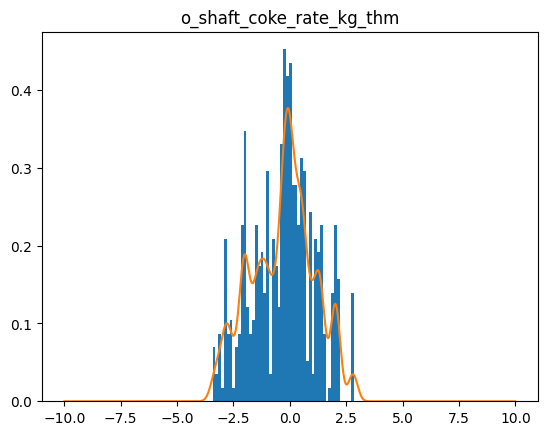

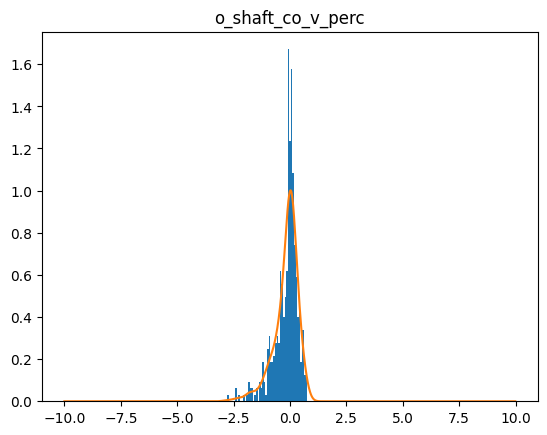

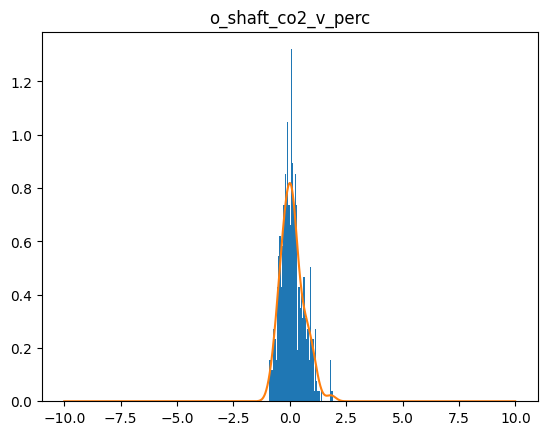

torch.Size([2000])
8001  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8002  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8003  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8004  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8005  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8006  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8007  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8008  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8009  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8010  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8011  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8012  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8013  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8014  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8015  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8016  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8017  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8018  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8019  loss=  tensor(0.0140,

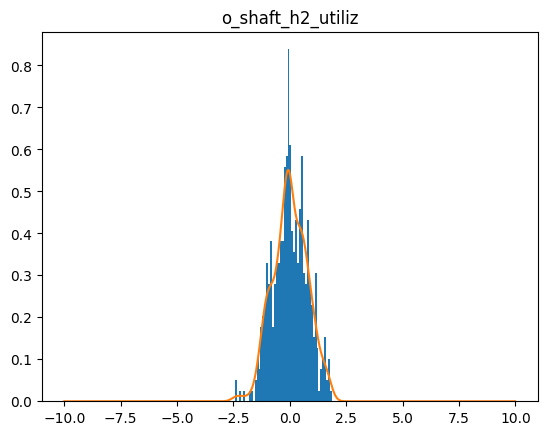

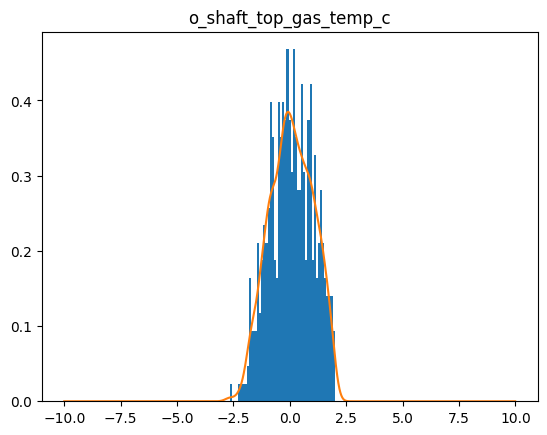

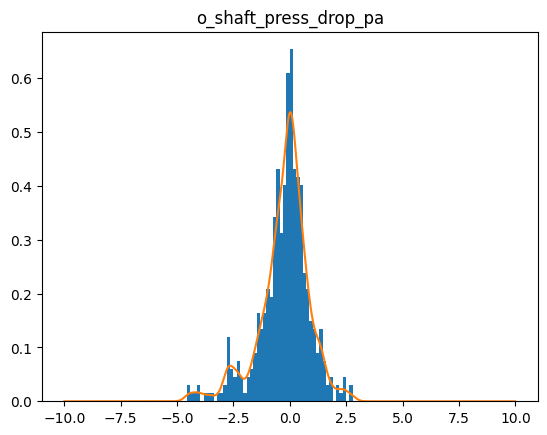

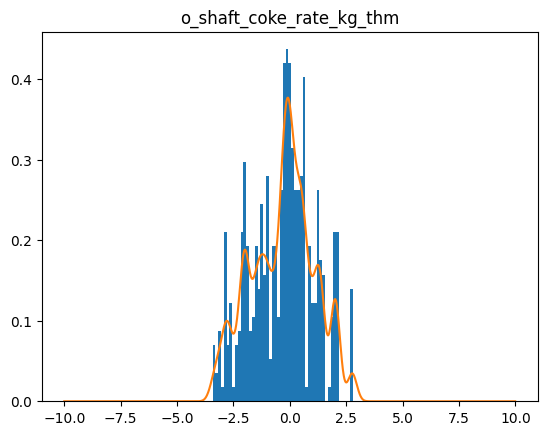

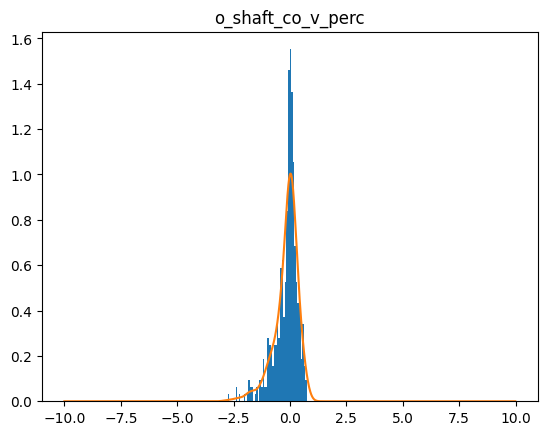

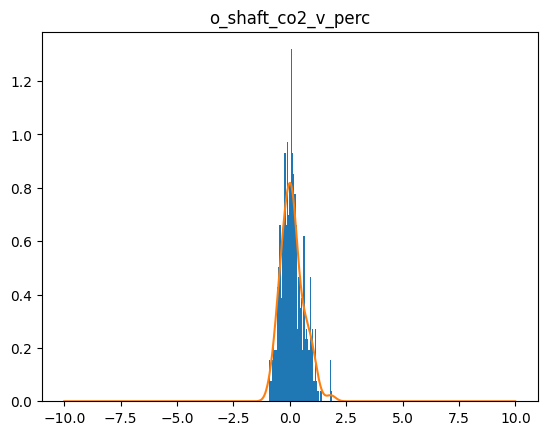

torch.Size([2000])
8101  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8102  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8103  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8104  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8105  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8106  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8107  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8108  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8109  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8110  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8111  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8112  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8113  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8114  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8115  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8116  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8117  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8118  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8119  loss=  tensor(0.0140,

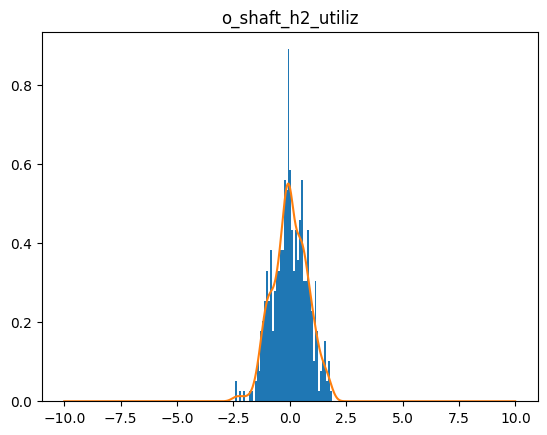

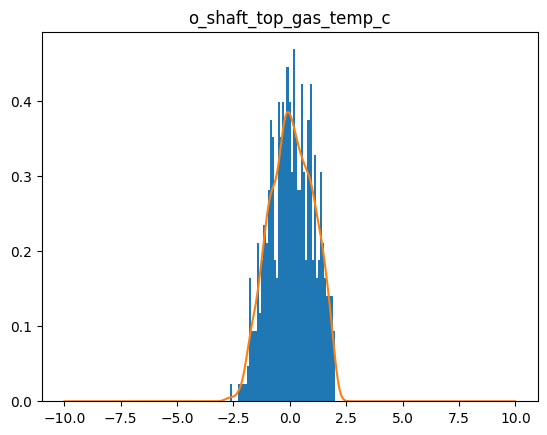

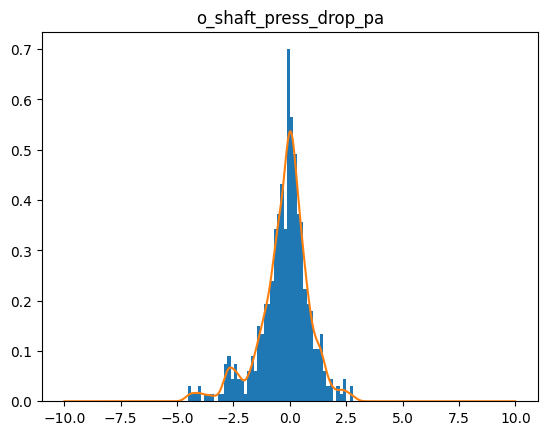

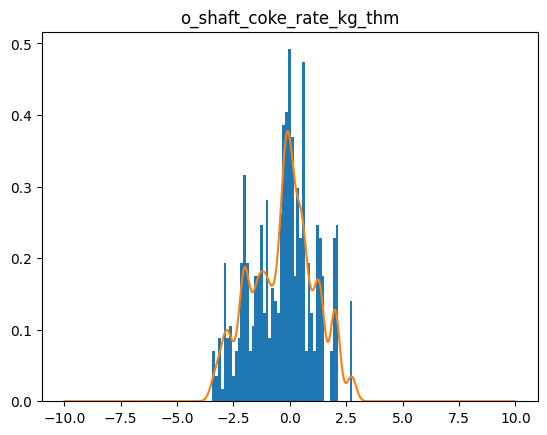

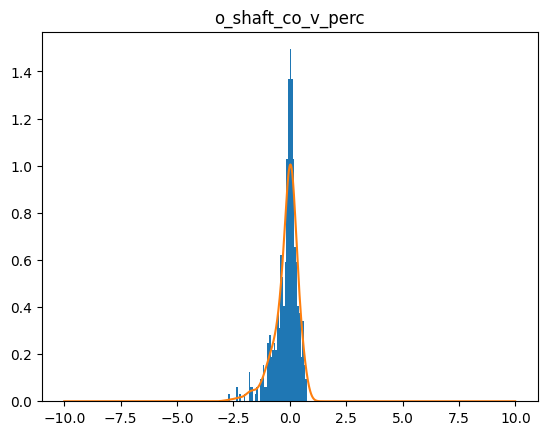

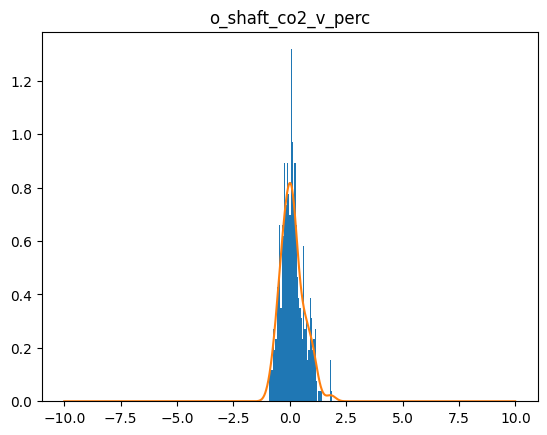

torch.Size([2000])
8201  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8202  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8203  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8204  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8205  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8206  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8207  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8208  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8209  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8210  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8211  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8212  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8213  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8214  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8215  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8216  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8217  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8218  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8219  loss=  tensor(0.0140,

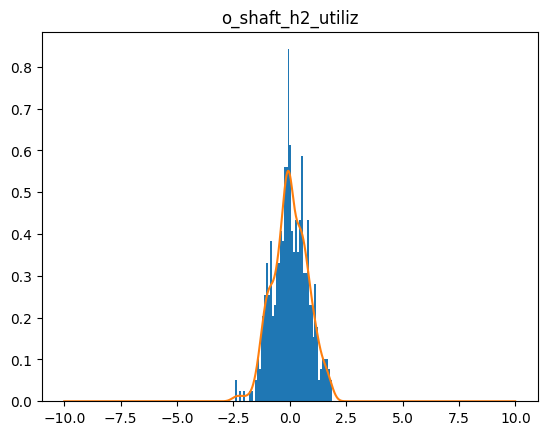

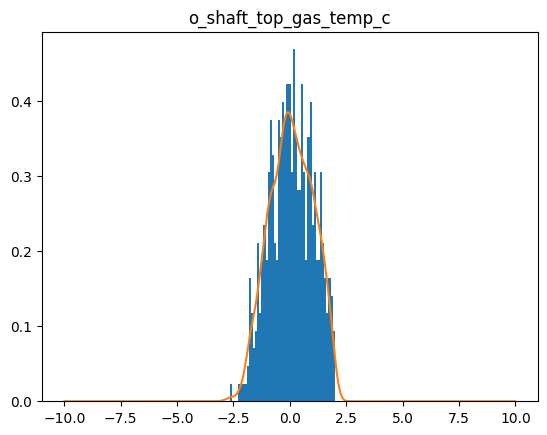

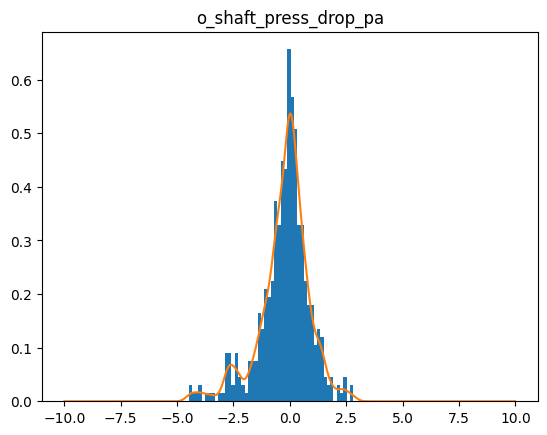

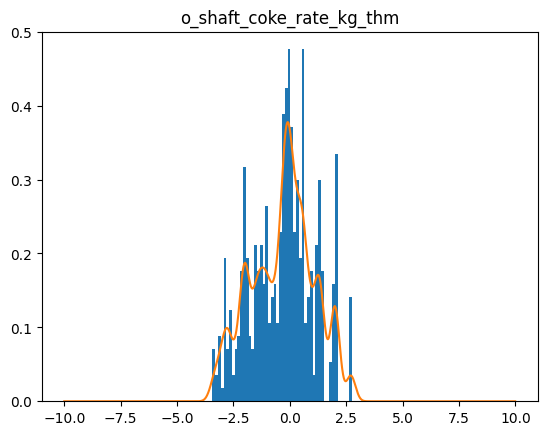

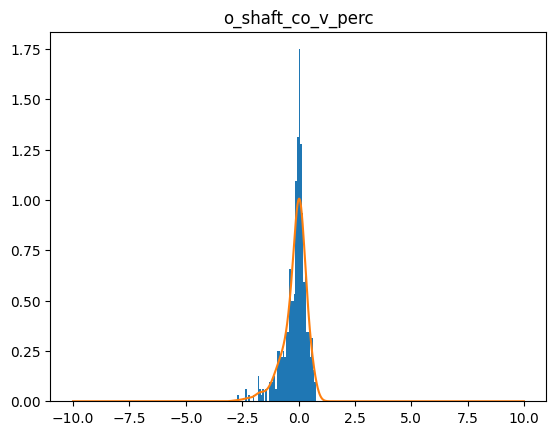

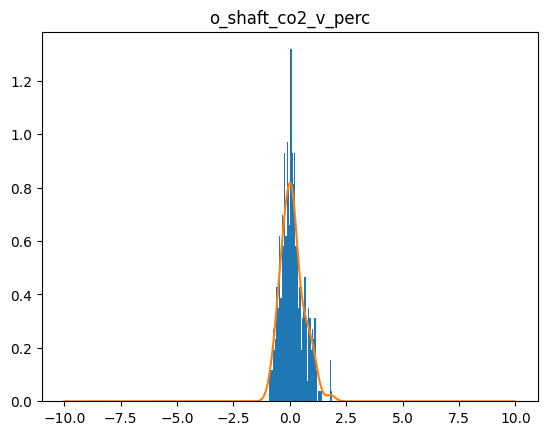

torch.Size([2000])
8301  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8302  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8303  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8304  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8305  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8306  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8307  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8308  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8309  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8310  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8311  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8312  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8313  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8314  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8315  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8316  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8317  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8318  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8319  loss=  tensor(0.0140,

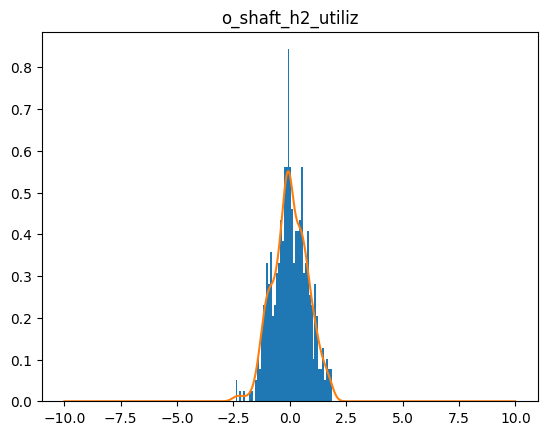

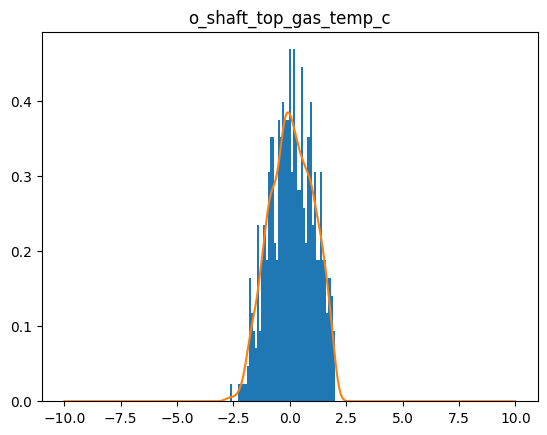

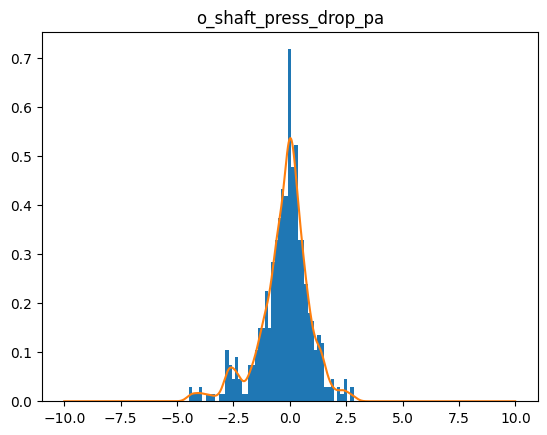

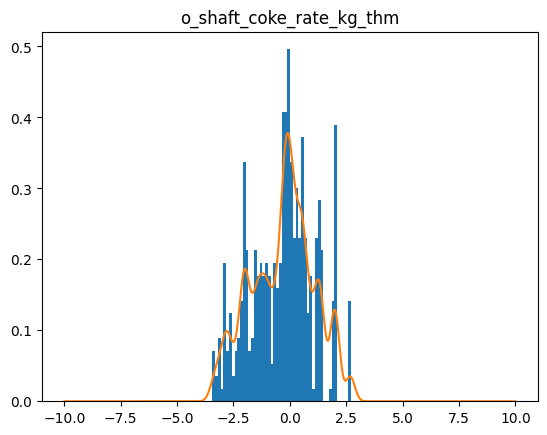

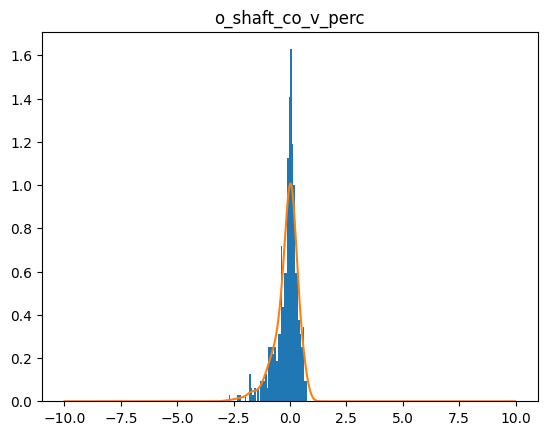

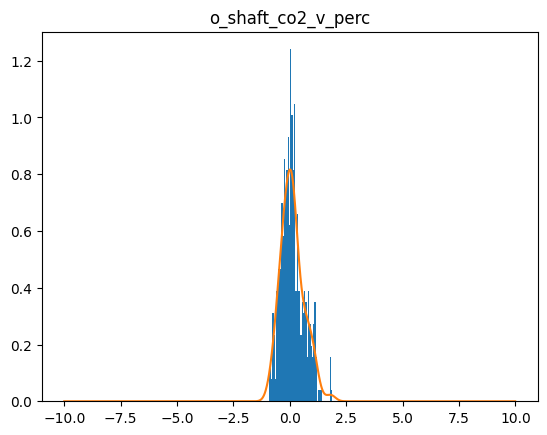

torch.Size([2000])
8401  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8402  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8403  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8404  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8405  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8406  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8407  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8408  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8409  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8410  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8411  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8412  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8413  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8414  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8415  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8416  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8417  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8418  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8419  loss=  tensor(0.0140,

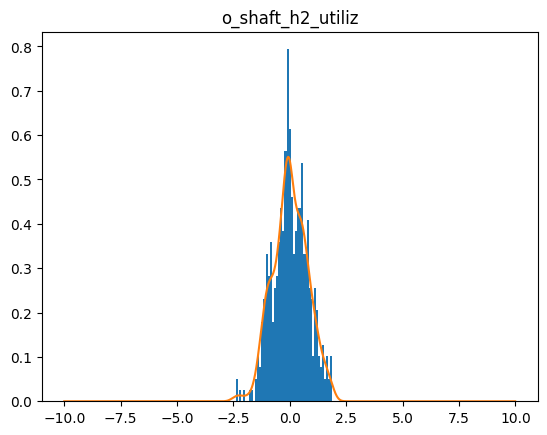

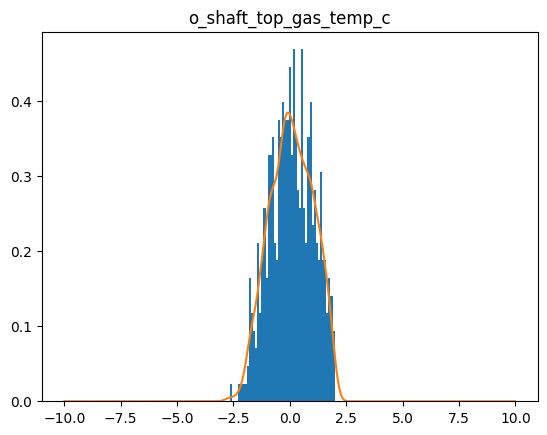

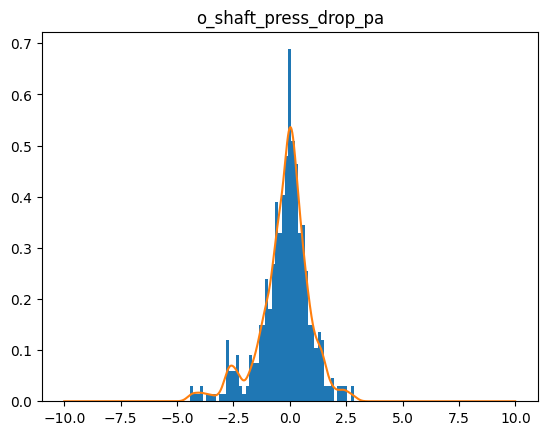

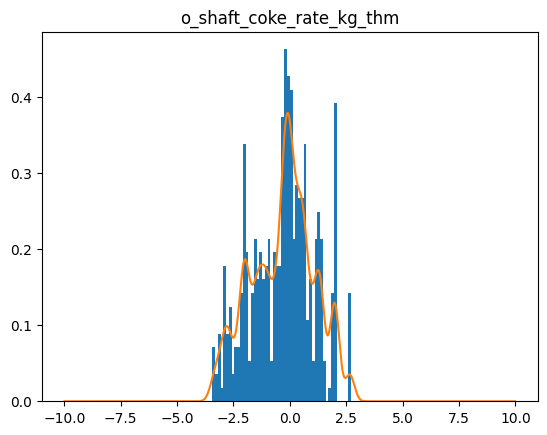

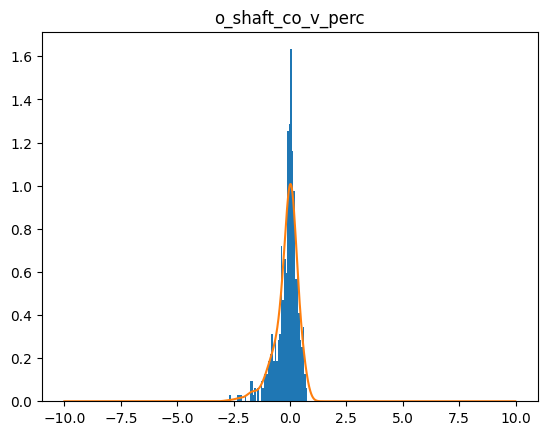

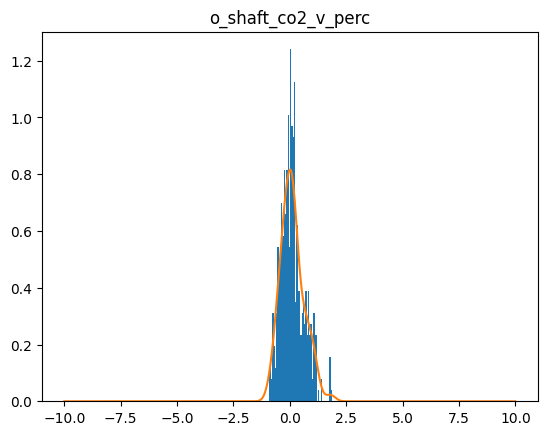

torch.Size([2000])
8501  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8502  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8503  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8504  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8505  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8506  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8507  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8508  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8509  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8510  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8511  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8512  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8513  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8514  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8515  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8516  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8517  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8518  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8519  loss=  tensor(0.0140,

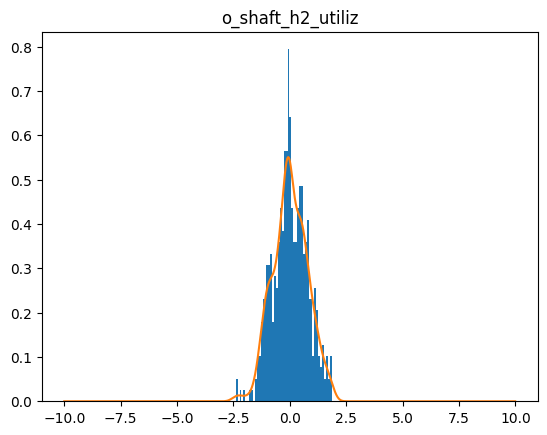

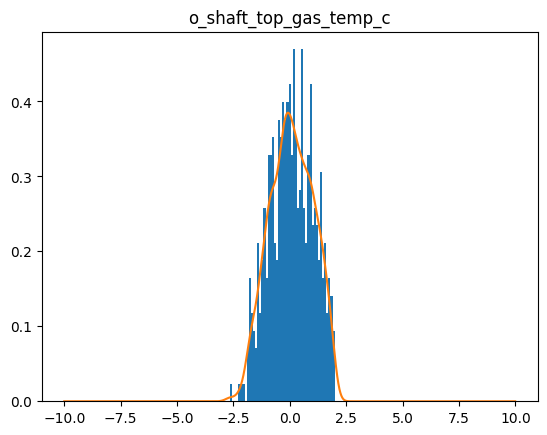

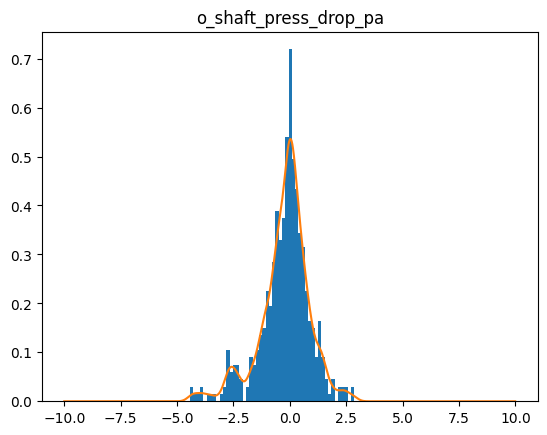

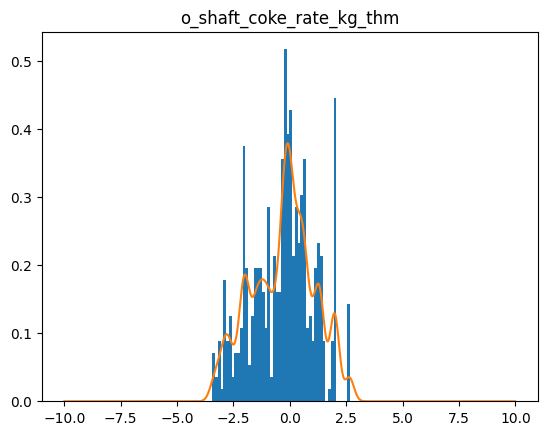

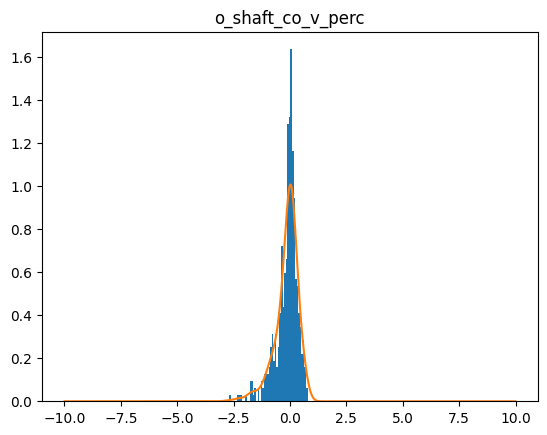

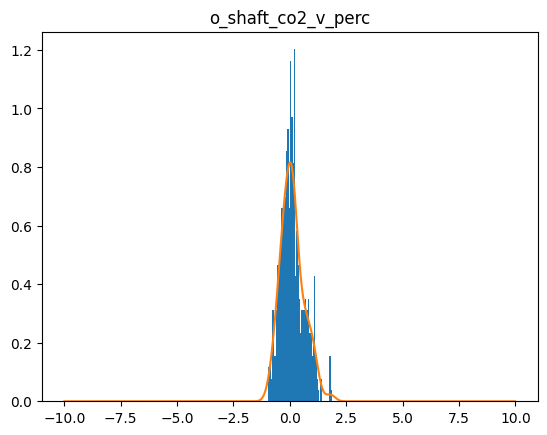

torch.Size([2000])
8601  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8602  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8603  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8604  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8605  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8606  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8607  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8608  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8609  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8610  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8611  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8612  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8613  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8614  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8615  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8616  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8617  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8618  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8619  loss=  tensor(0.0140,

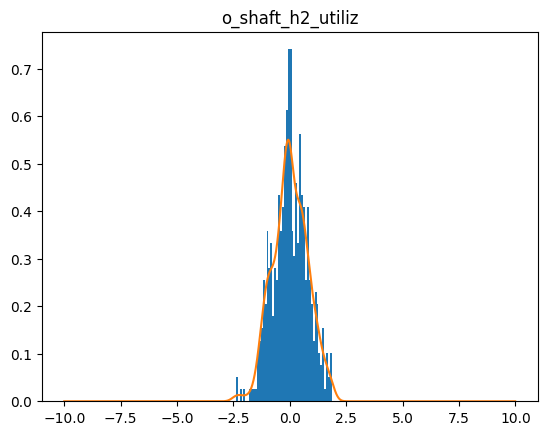

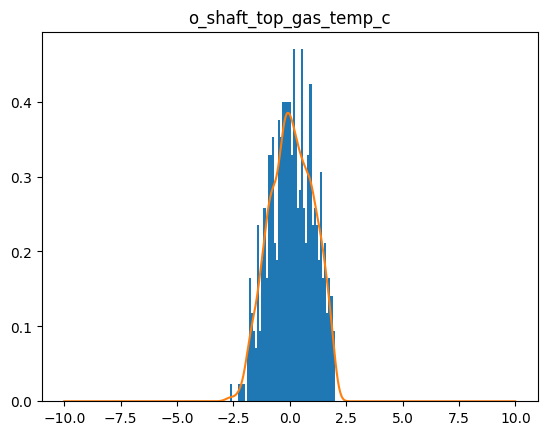

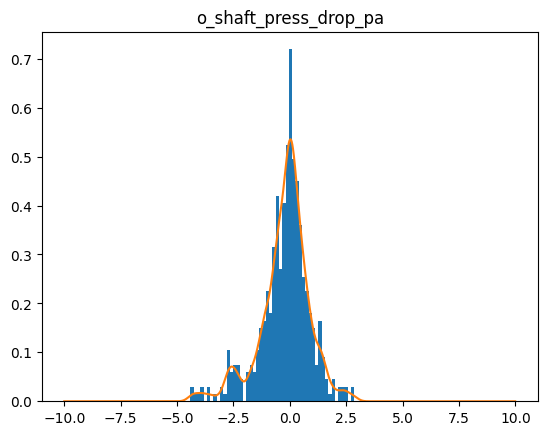

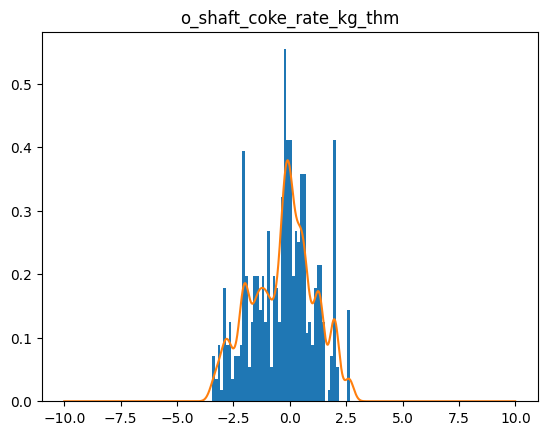

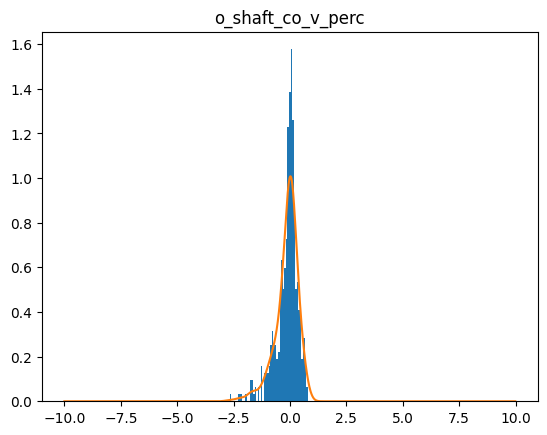

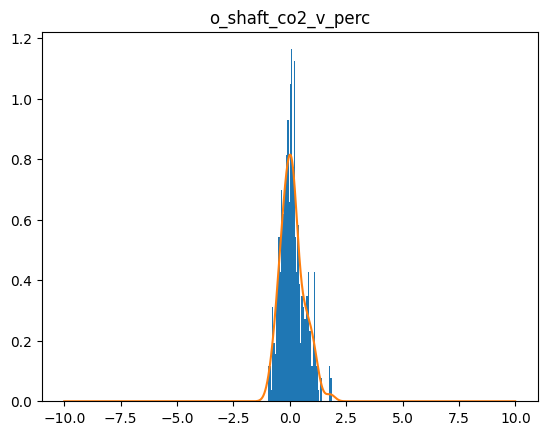

torch.Size([2000])
8701  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8702  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8703  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8704  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8705  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8706  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8707  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8708  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8709  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8710  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8711  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8712  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8713  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8714  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8715  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8716  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8717  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8718  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8719  loss=  tensor(0.0140,

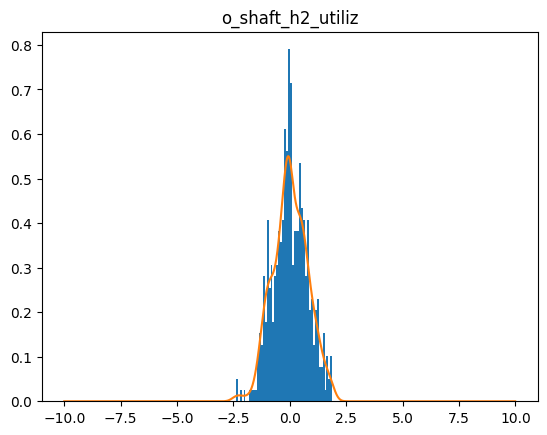

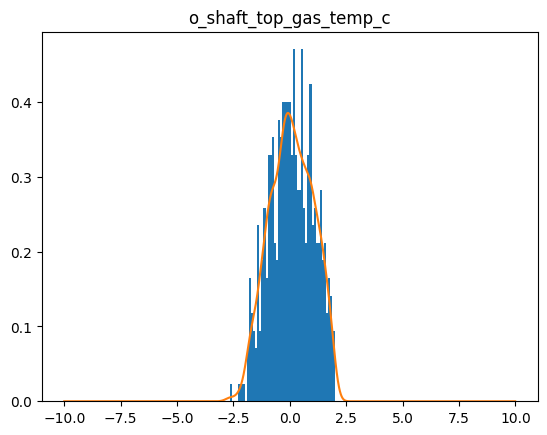

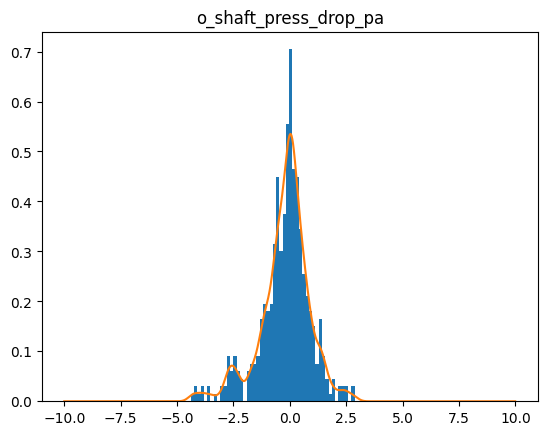

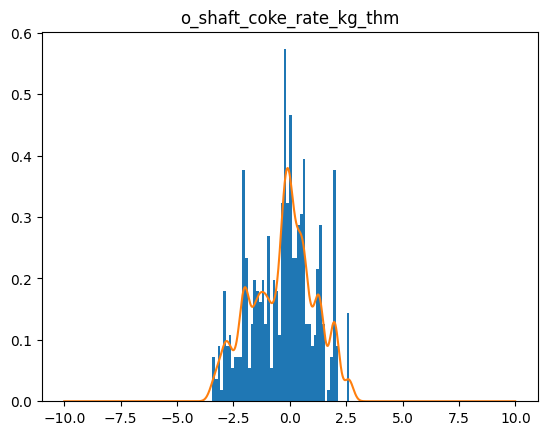

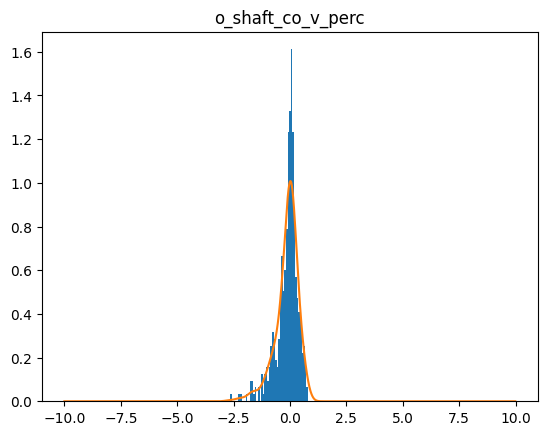

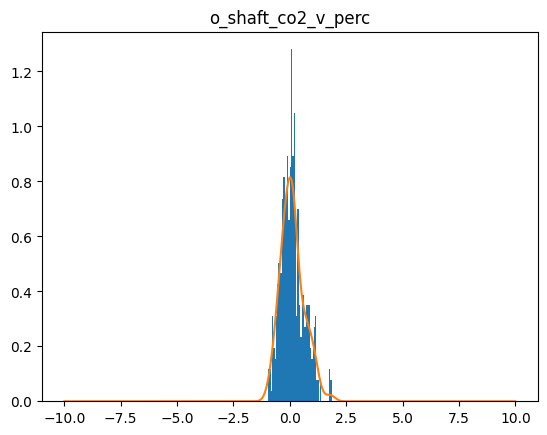

torch.Size([2000])
8801  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8802  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8803  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8804  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8805  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8806  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8807  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8808  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8809  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8810  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8811  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8812  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8813  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8814  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8815  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8816  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8817  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8818  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8819  loss=  tensor(0.0140,

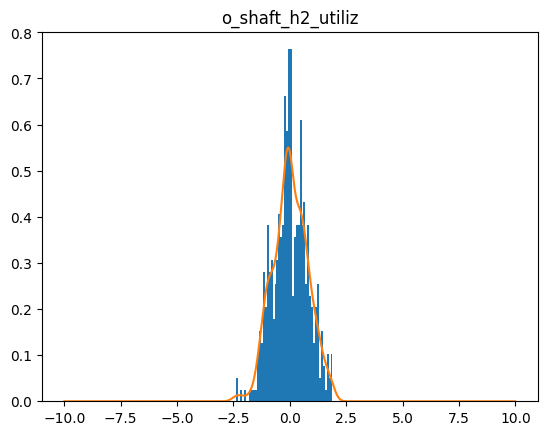

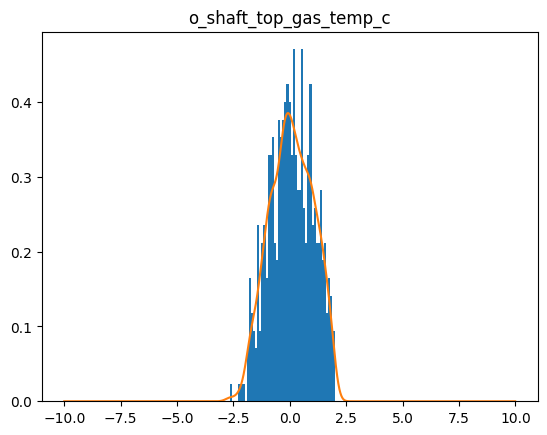

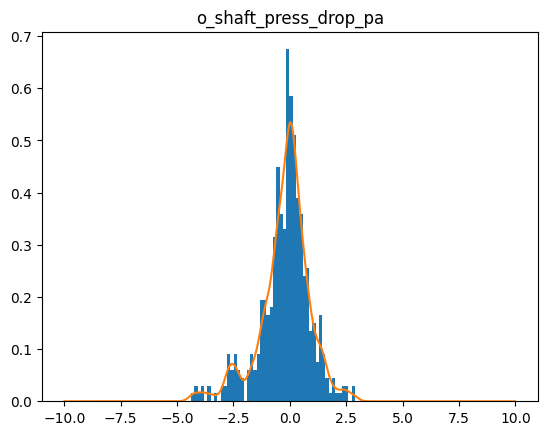

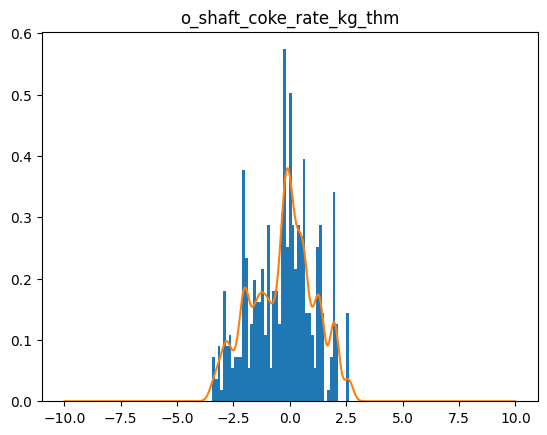

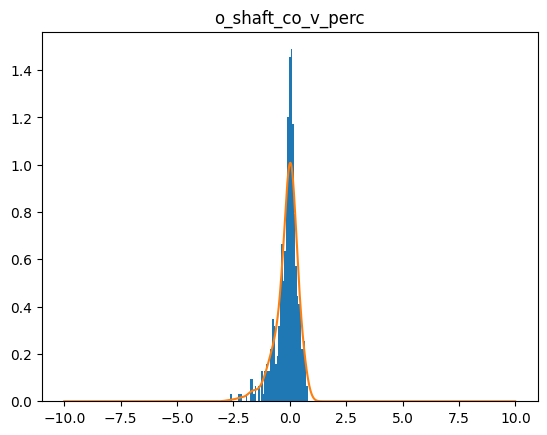

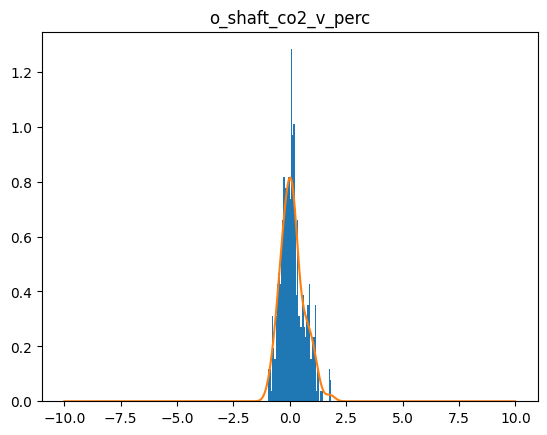

torch.Size([2000])
8901  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8902  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8903  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8904  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8905  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8906  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8907  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8908  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8909  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8910  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8911  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8912  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8913  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8914  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8915  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8916  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8917  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8918  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
8919  loss=  tensor(0.0140,

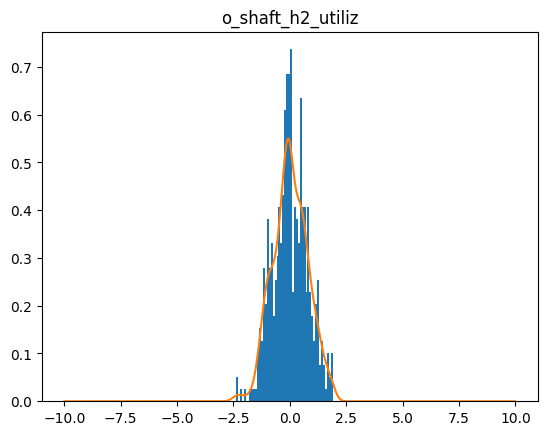

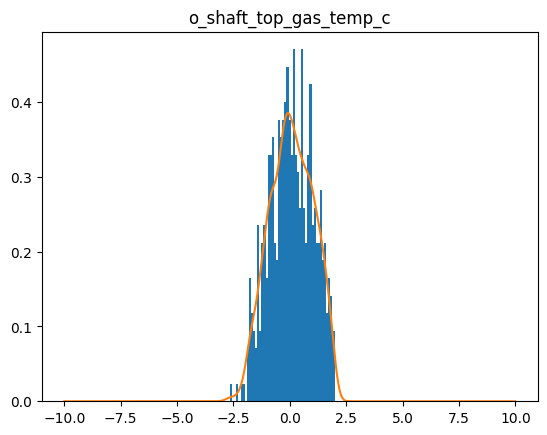

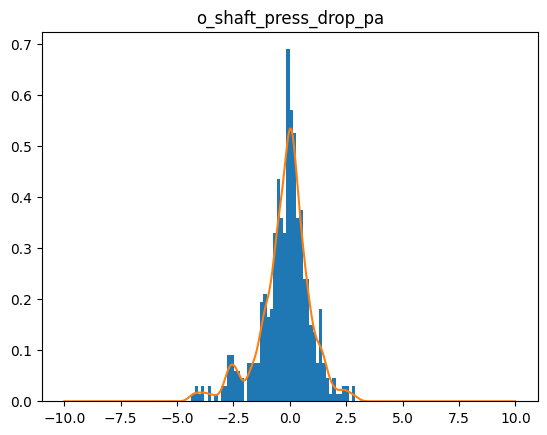

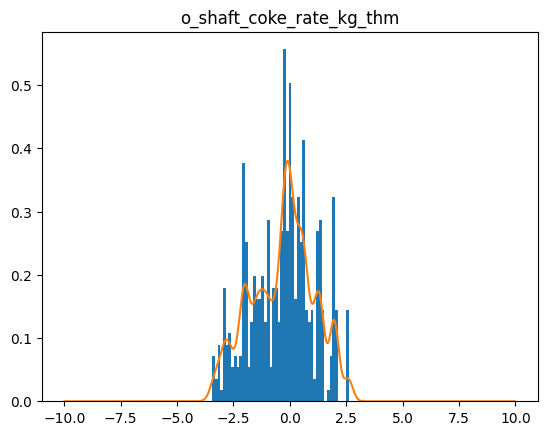

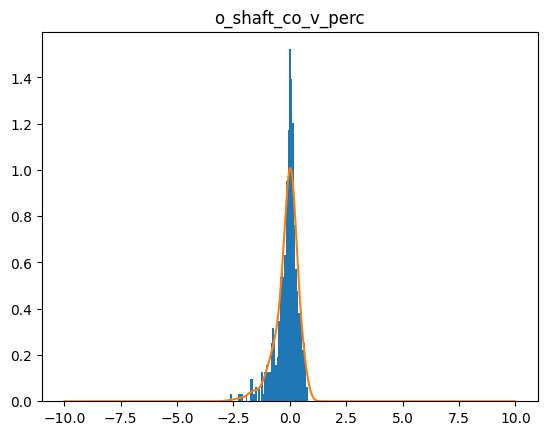

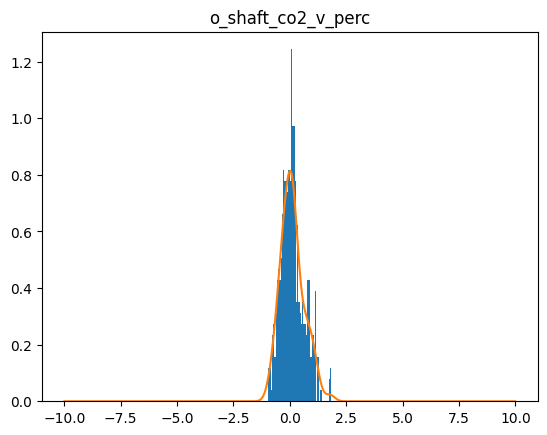

torch.Size([2000])
9001  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9002  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9003  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9004  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9005  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9006  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9007  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9008  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9009  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9010  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9011  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9012  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9013  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9014  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9015  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9016  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9017  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9018  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9019  loss=  tensor(0.0140,

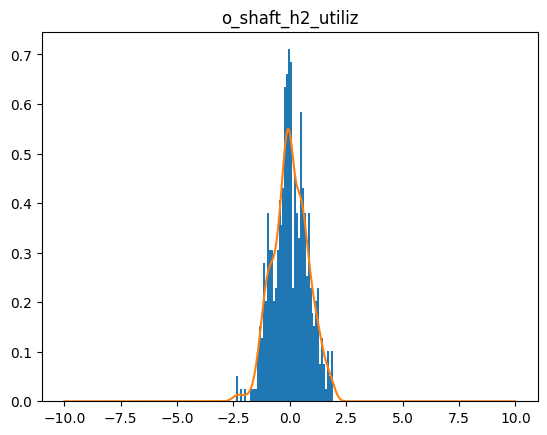

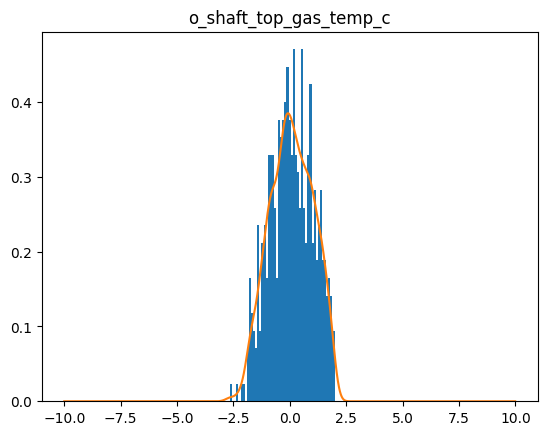

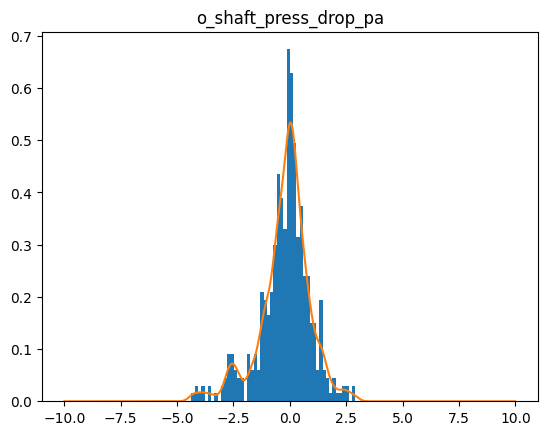

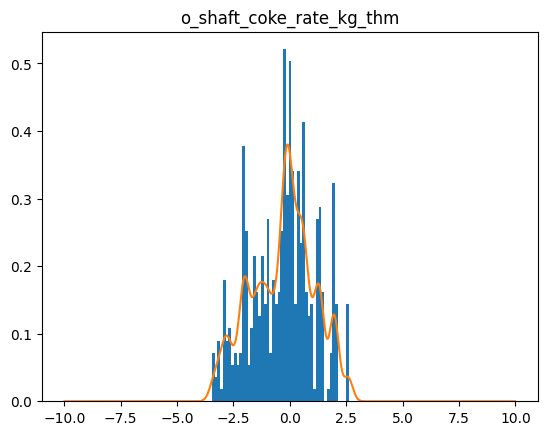

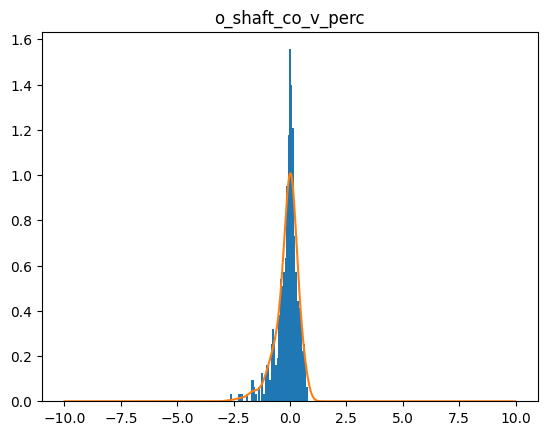

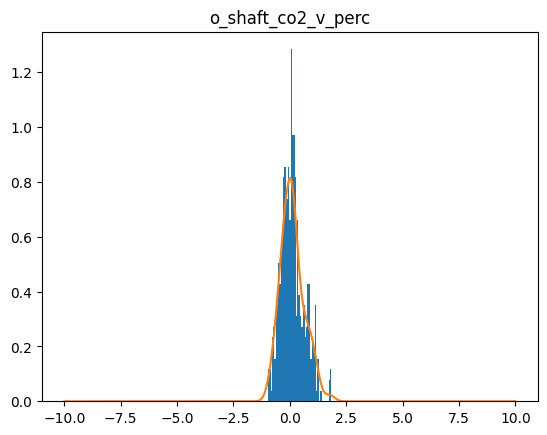

torch.Size([2000])
9101  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9102  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9103  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9104  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9105  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9106  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9107  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9108  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9109  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9110  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9111  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9112  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9113  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9114  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9115  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9116  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9117  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9118  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9119  loss=  tensor(0.0140,

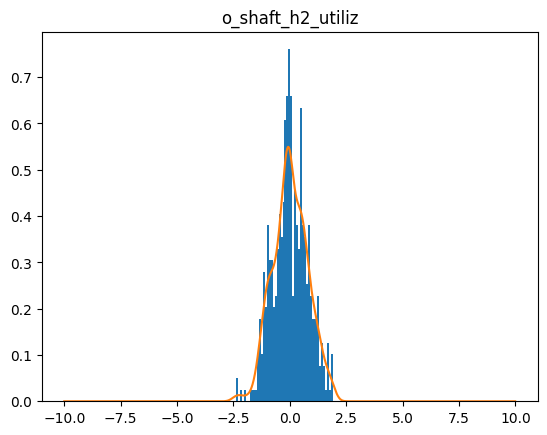

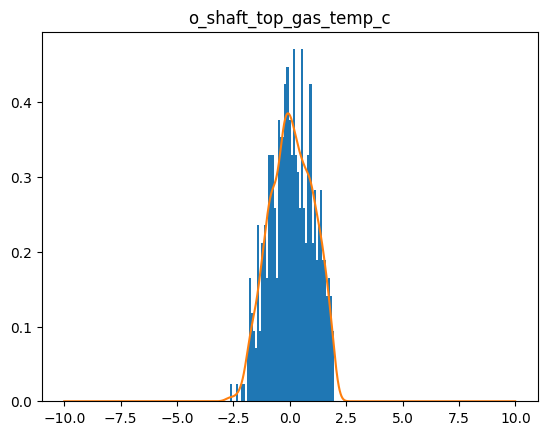

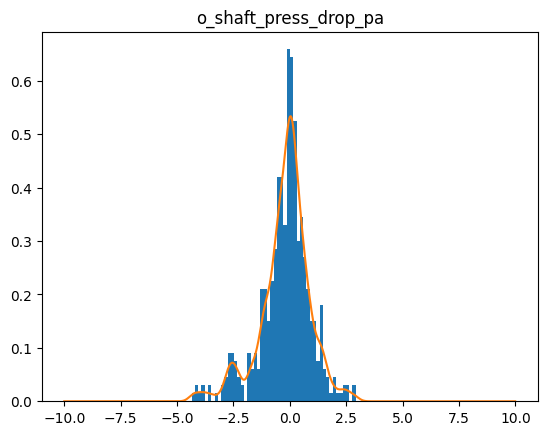

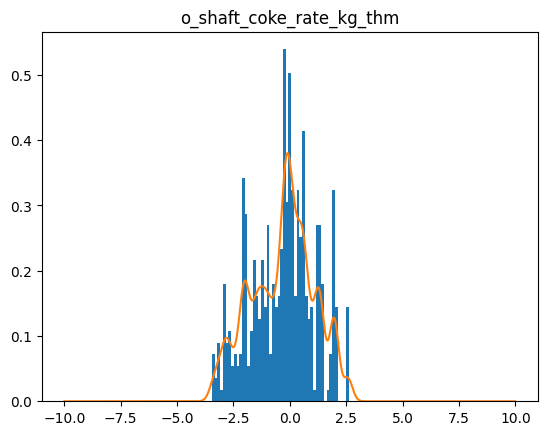

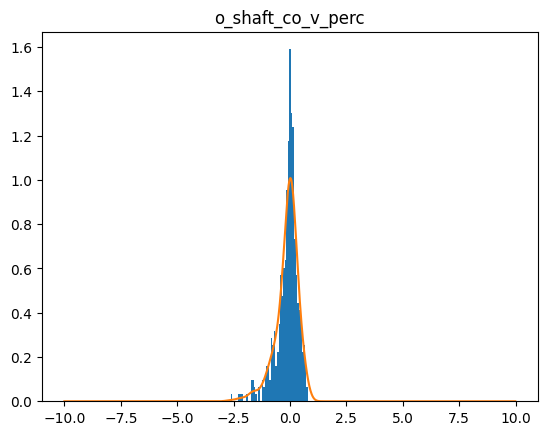

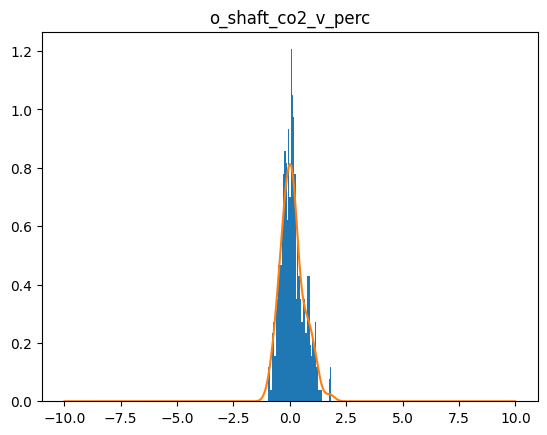

torch.Size([2000])
9201  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9202  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9203  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9204  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9205  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9206  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9207  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9208  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9209  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9210  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9211  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9212  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9213  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9214  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9215  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9216  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9217  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9218  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9219  loss=  tensor(0.0140,

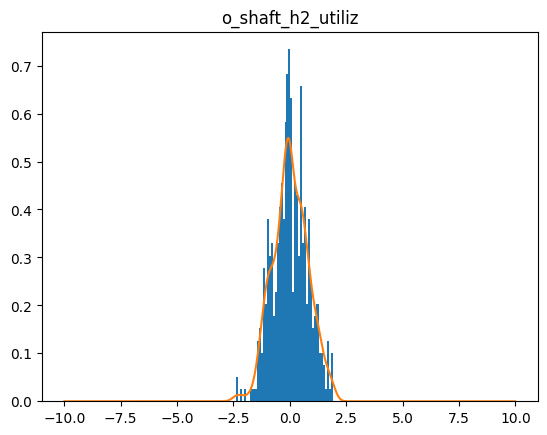

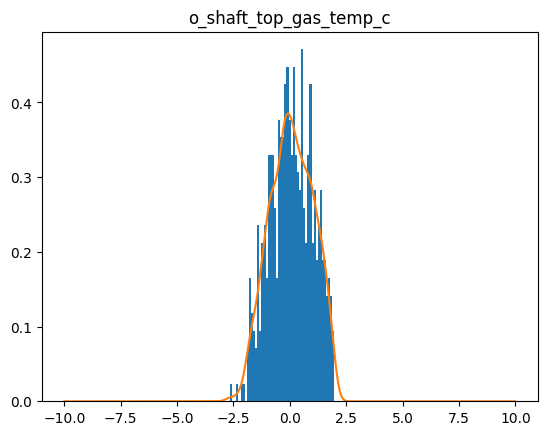

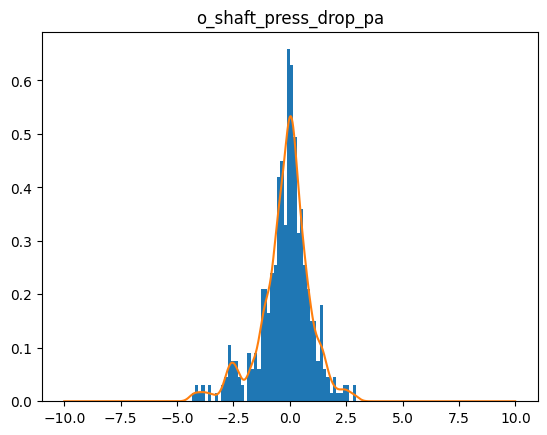

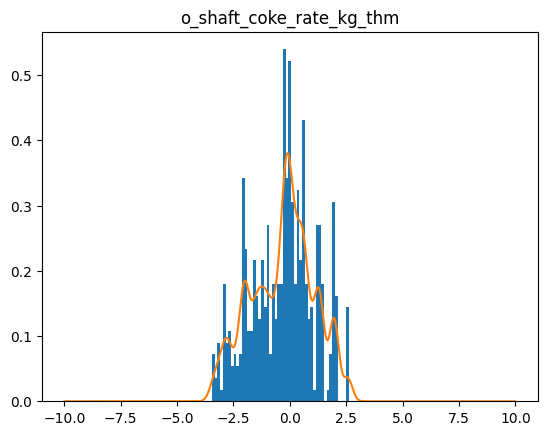

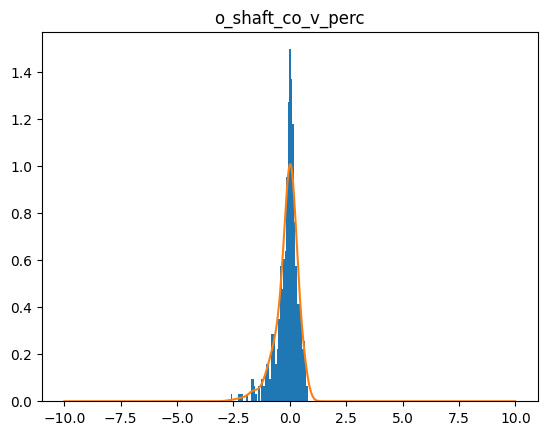

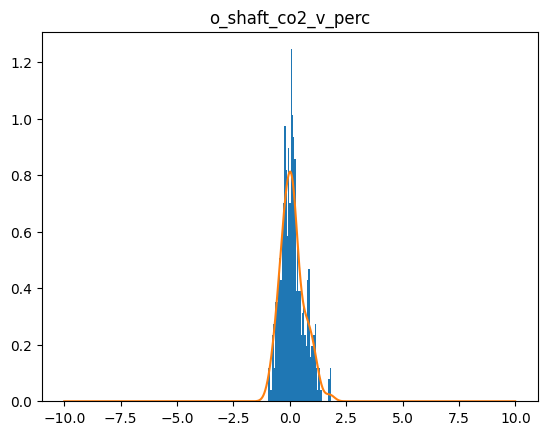

torch.Size([2000])
9301  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9302  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9303  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9304  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9305  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9306  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9307  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9308  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9309  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9310  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9311  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9312  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9313  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9314  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9315  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9316  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9317  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9318  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9319  loss=  tensor(0.0140,

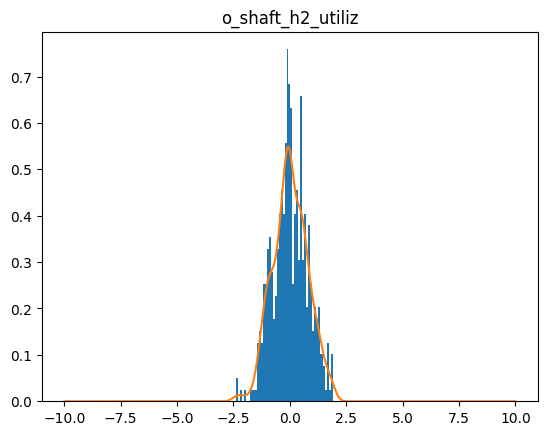

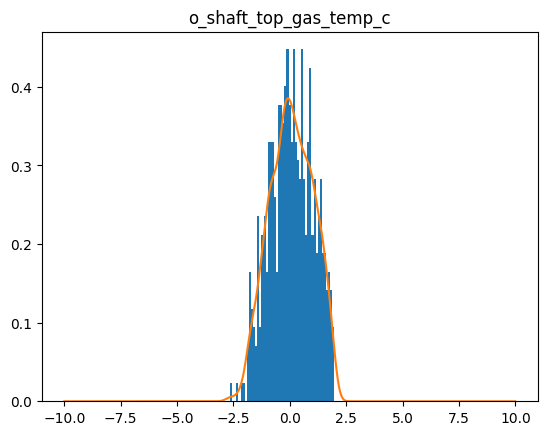

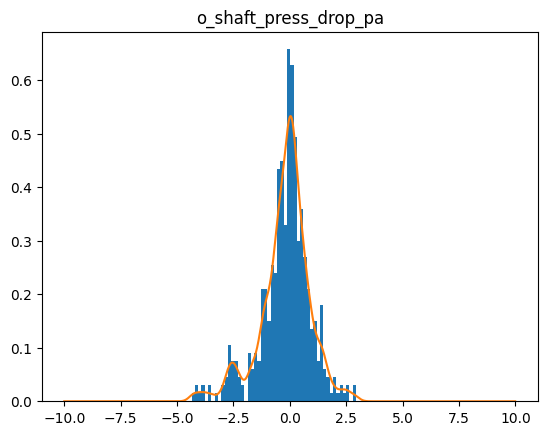

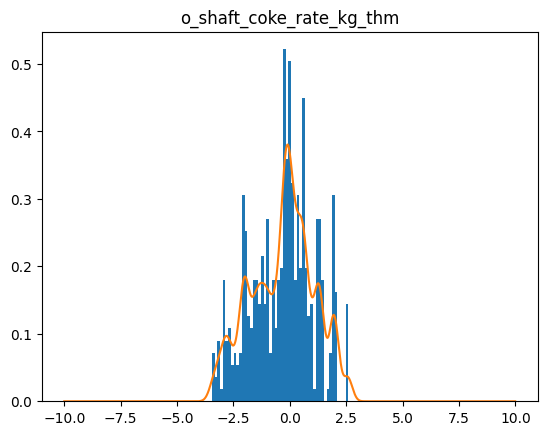

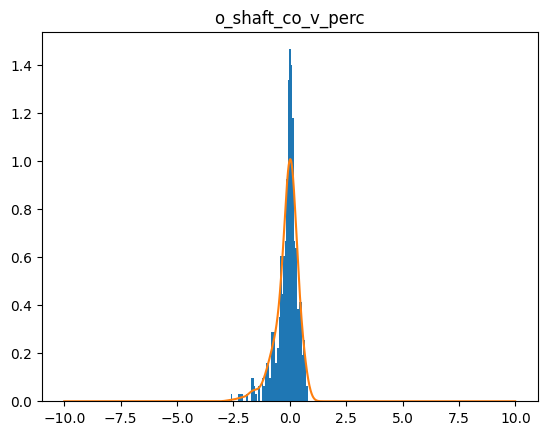

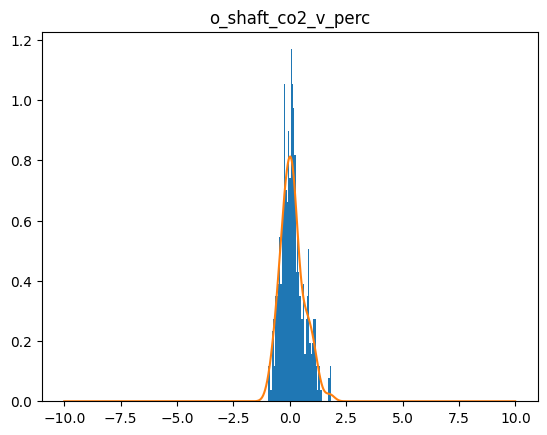

torch.Size([2000])
9401  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9402  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9403  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9404  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9405  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9406  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9407  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9408  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9409  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9410  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9411  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9412  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9413  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9414  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9415  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9416  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9417  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9418  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9419  loss=  tensor(0.0140,

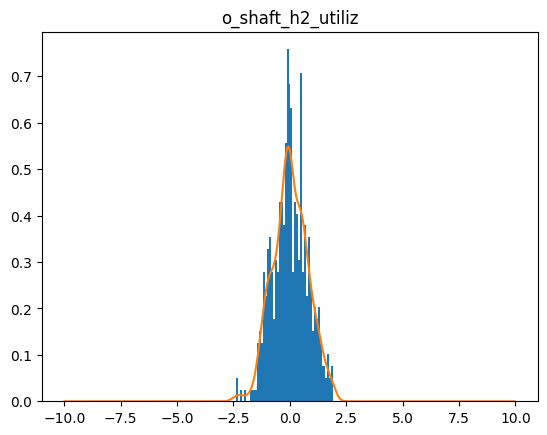

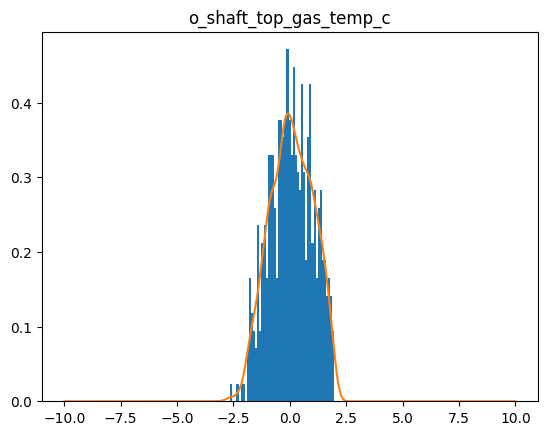

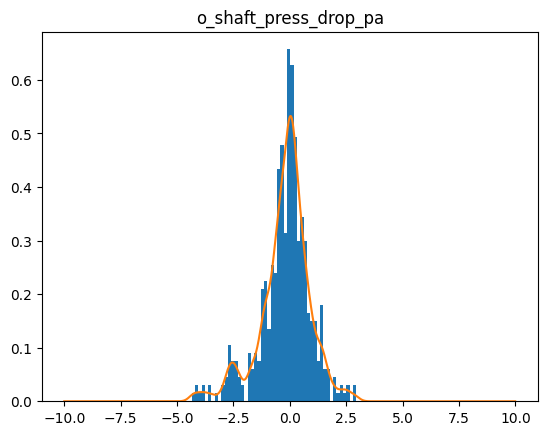

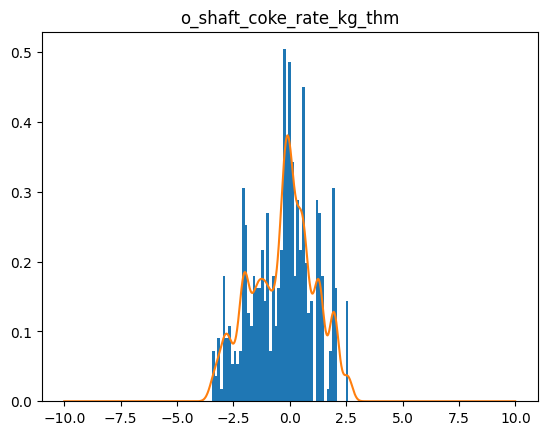

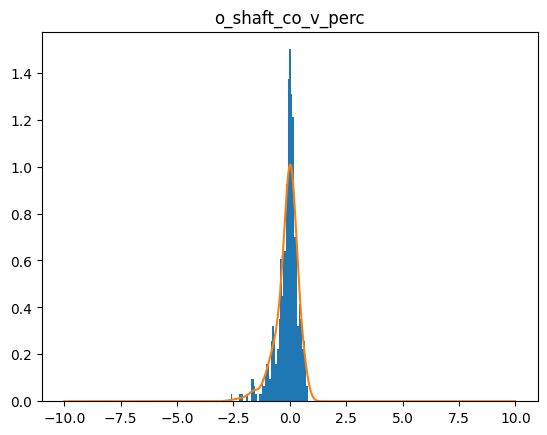

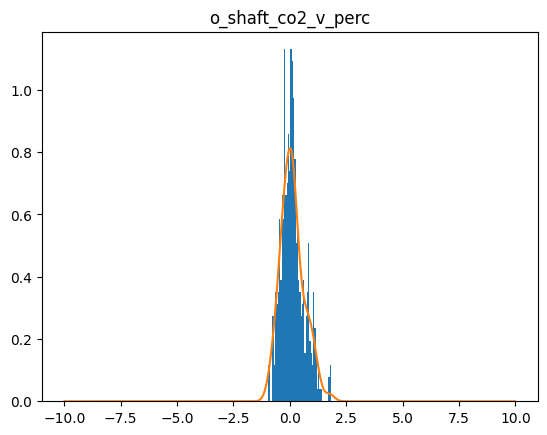

torch.Size([2000])
9501  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9502  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9503  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9504  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9505  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9506  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9507  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9508  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9509  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9510  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9511  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9512  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9513  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9514  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9515  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9516  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9517  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9518  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9519  loss=  tensor(0.0140,

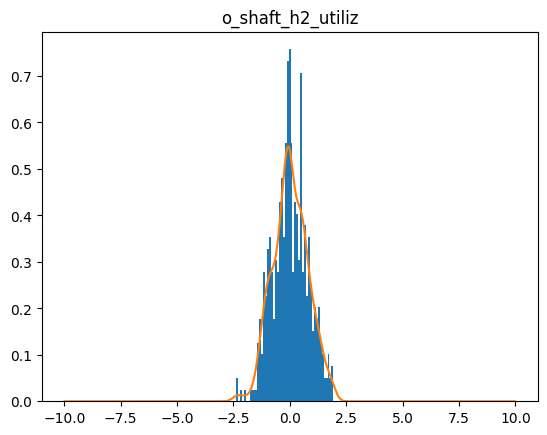

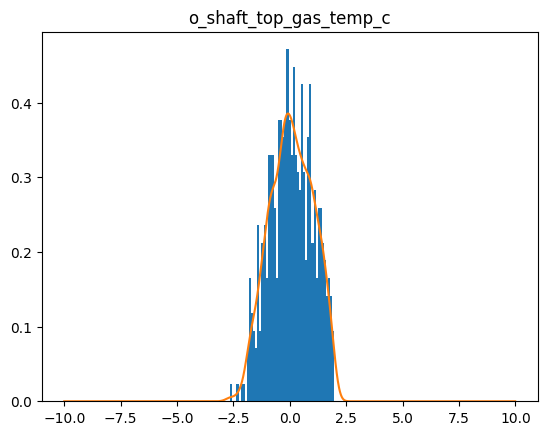

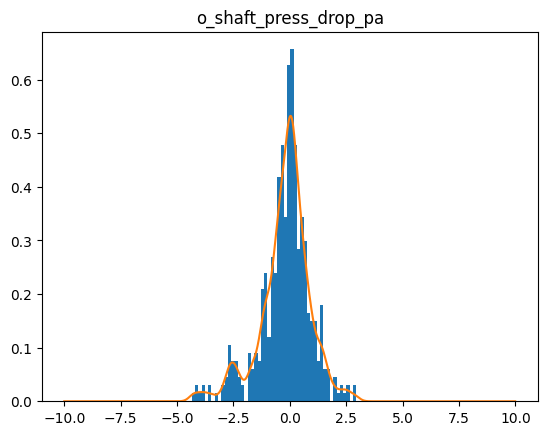

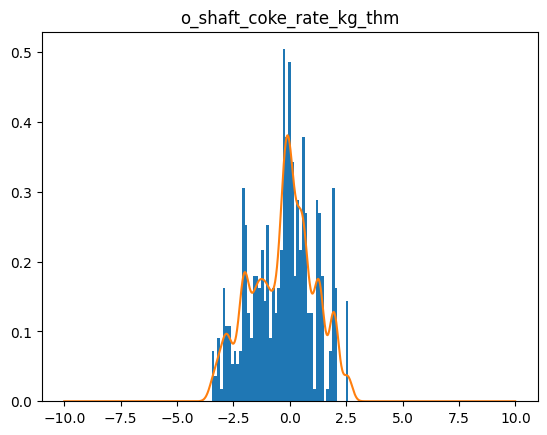

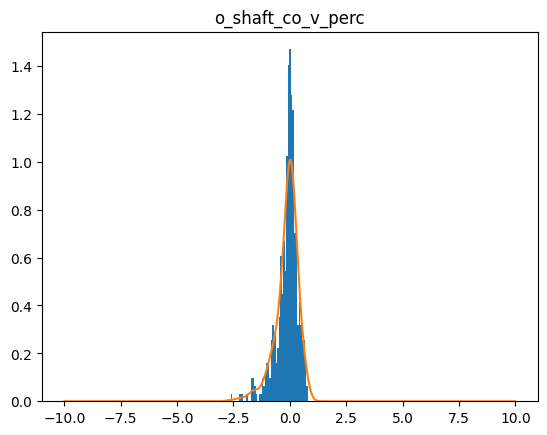

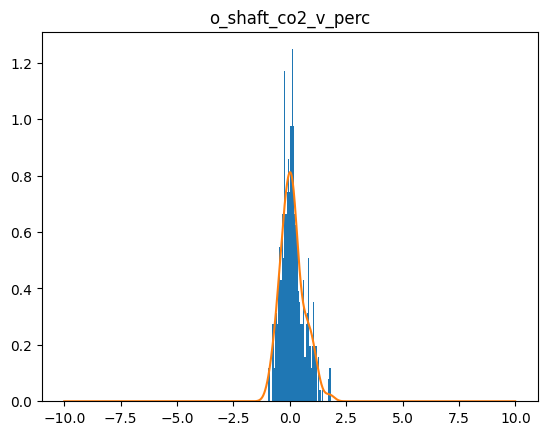

torch.Size([2000])
9601  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9602  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9603  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9604  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9605  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9606  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9607  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9608  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9609  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9610  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9611  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9612  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9613  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9614  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9615  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9616  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9617  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9618  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9619  loss=  tensor(0.0140,

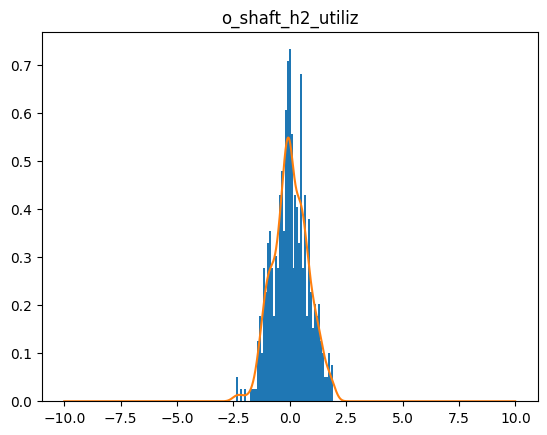

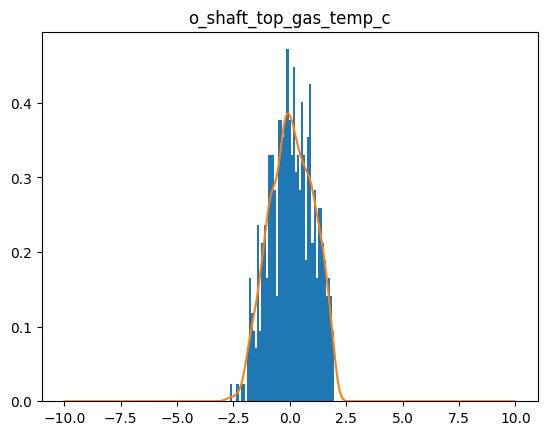

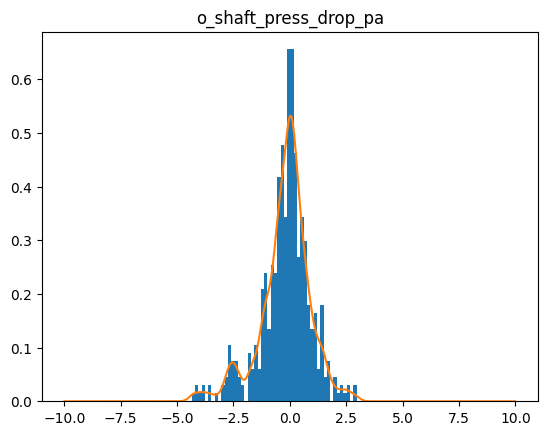

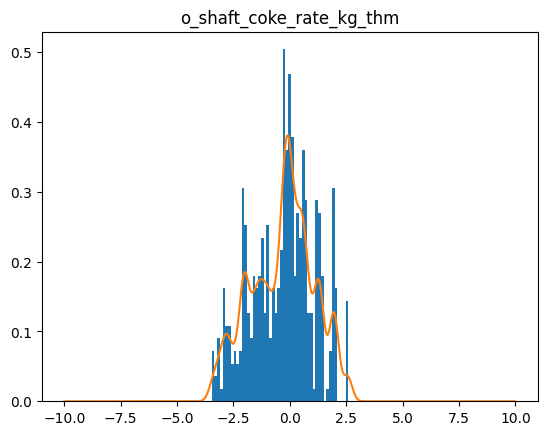

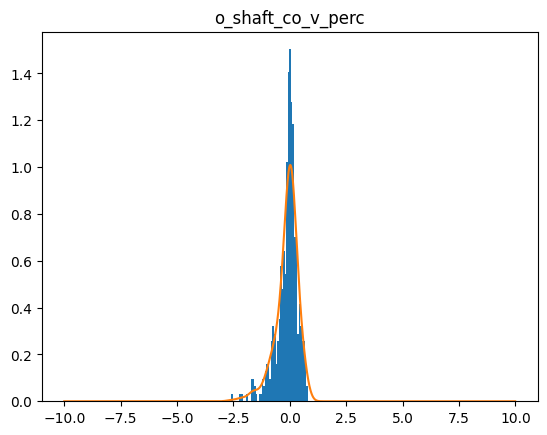

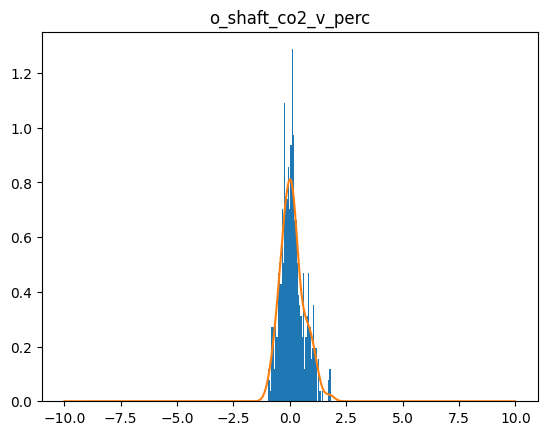

torch.Size([2000])
9701  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9702  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9703  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9704  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9705  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9706  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9707  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9708  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9709  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9710  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9711  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9712  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9713  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9714  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9715  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9716  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9717  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9718  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9719  loss=  tensor(0.0140,

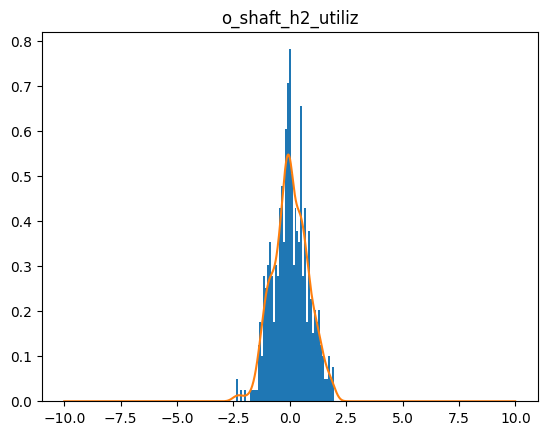

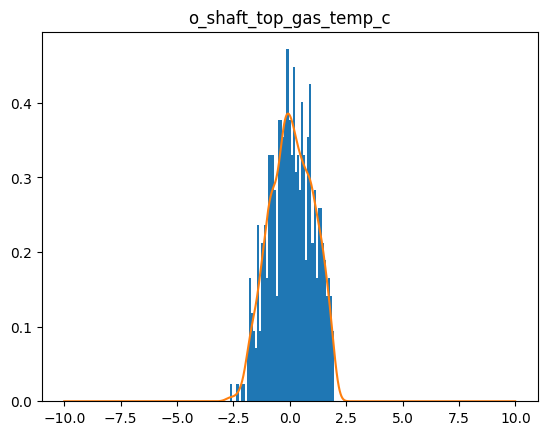

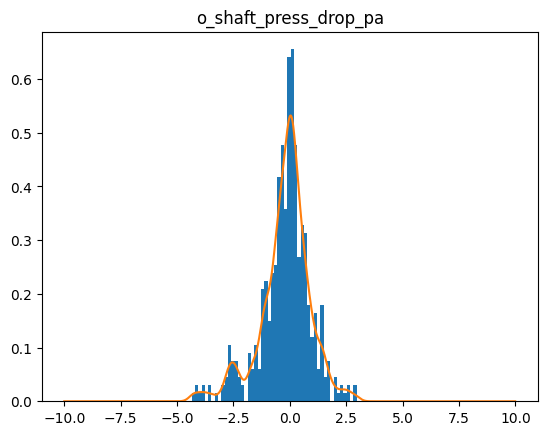

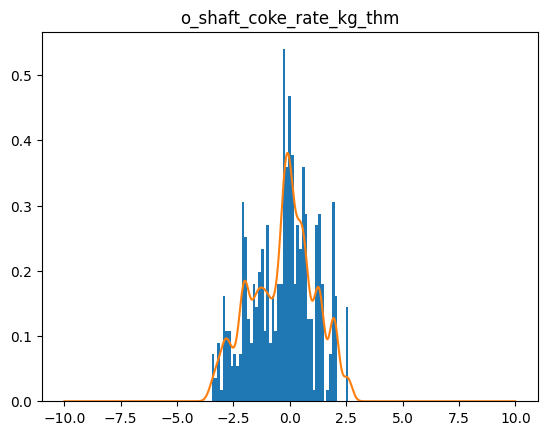

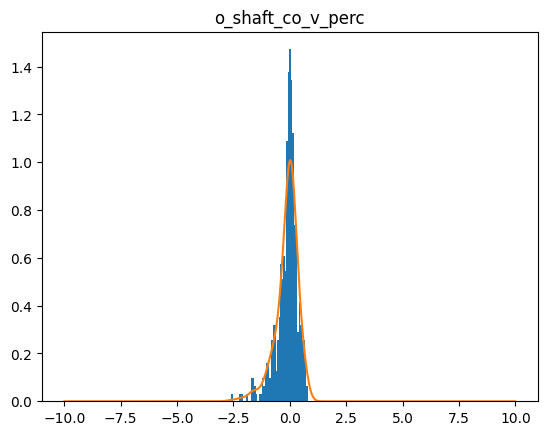

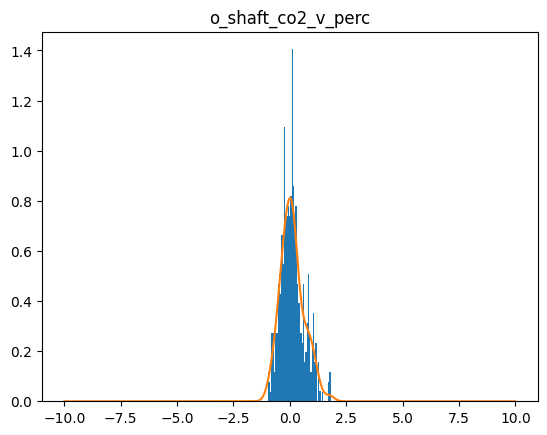

torch.Size([2000])
9801  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9802  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9803  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9804  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9805  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9806  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9807  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9808  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9809  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9810  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9811  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9812  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9813  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9814  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9815  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9816  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9817  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9818  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9819  loss=  tensor(0.0140,

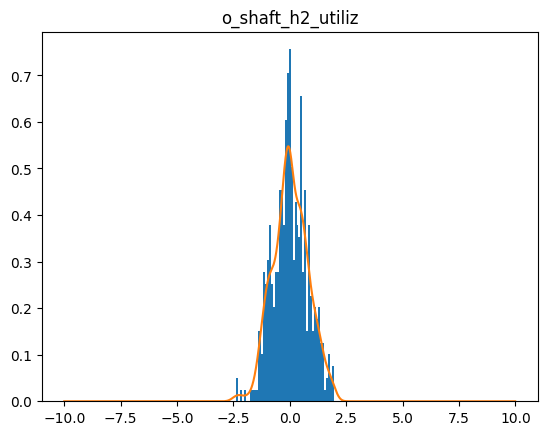

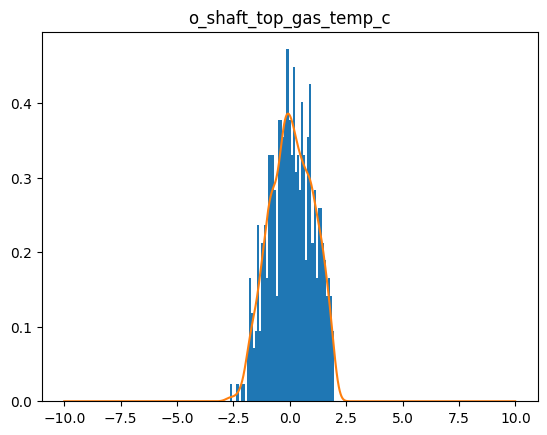

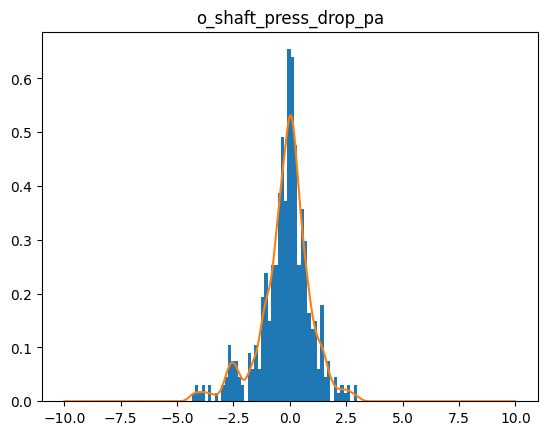

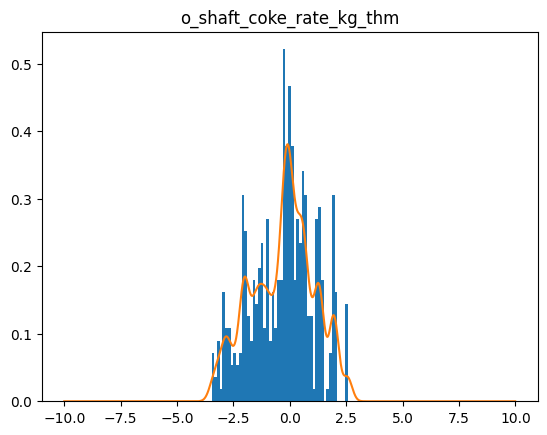

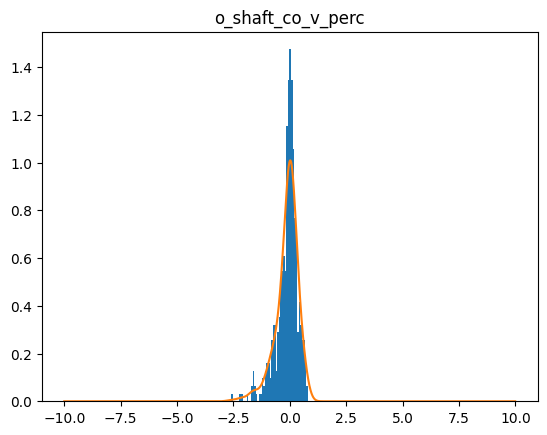

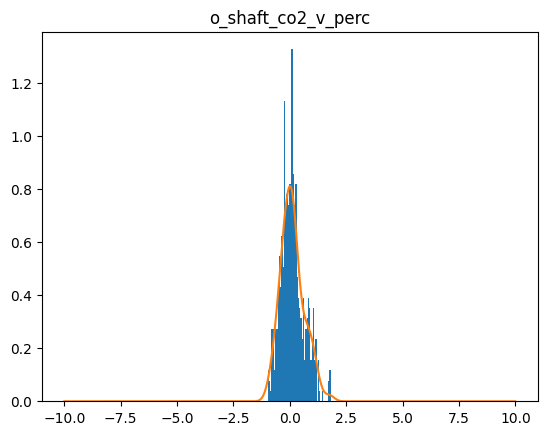

torch.Size([2000])
9901  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9902  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9903  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9904  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9905  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9906  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9907  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9908  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9909  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9910  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9911  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9912  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9913  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9914  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9915  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9916  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9917  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9918  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
9919  loss=  tensor(0.0140,

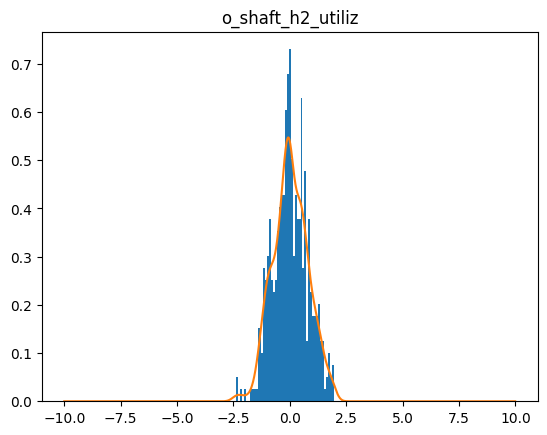

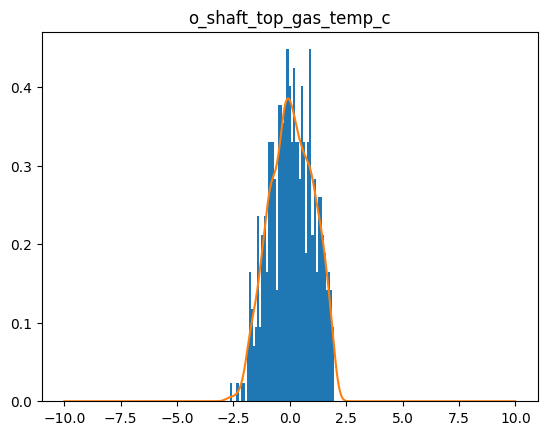

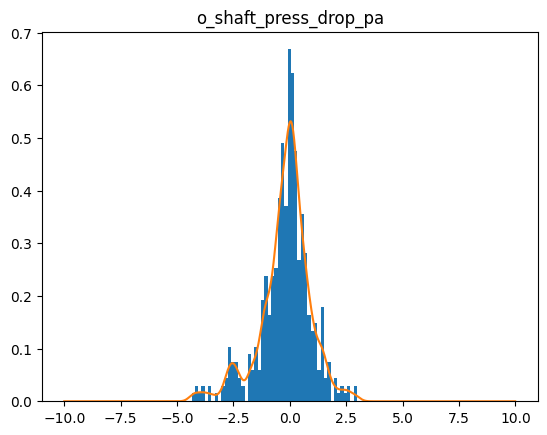

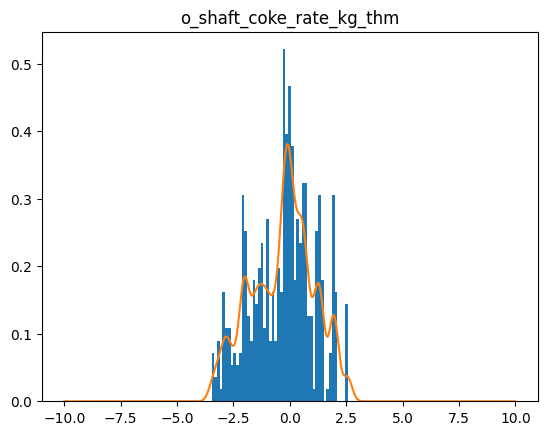

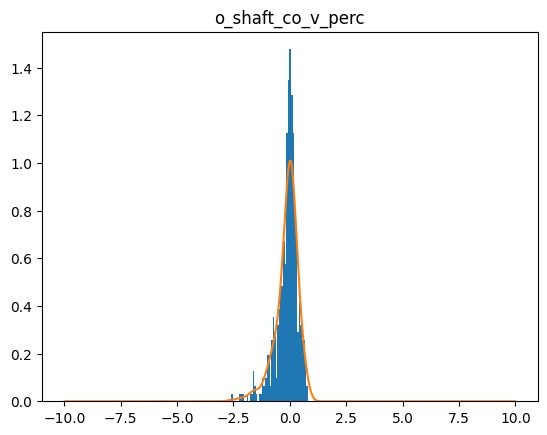

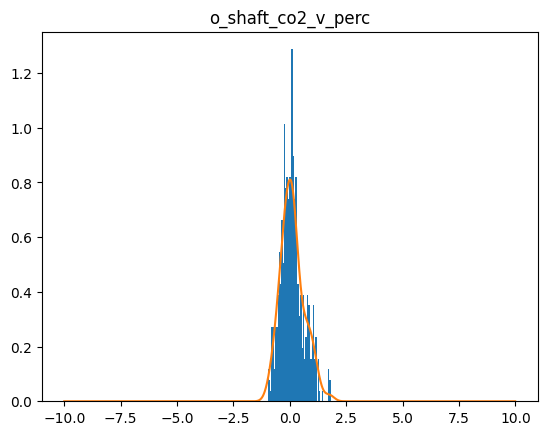

torch.Size([2000])
10001  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10002  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10003  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10004  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10005  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10006  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10007  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10008  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10009  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10010  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10011  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10012  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10013  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10014  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10015  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10016  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10017  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10018  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10019  lo

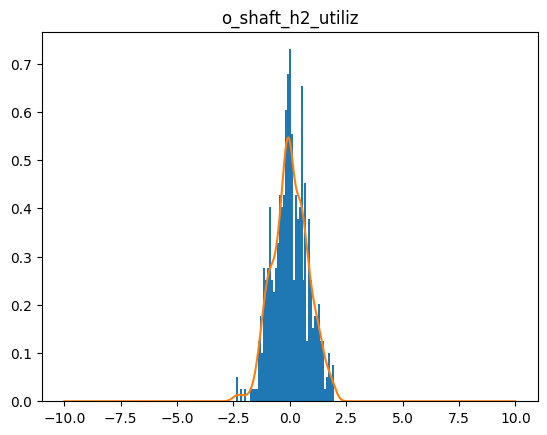

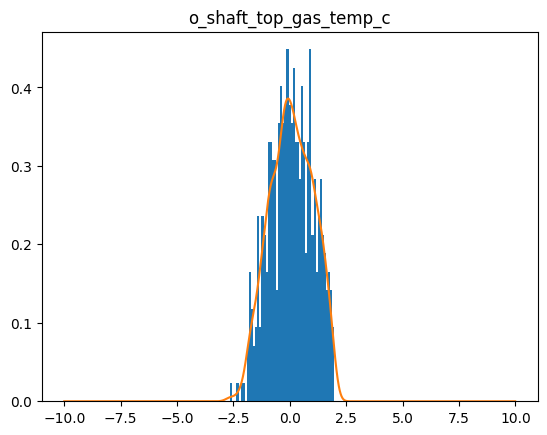

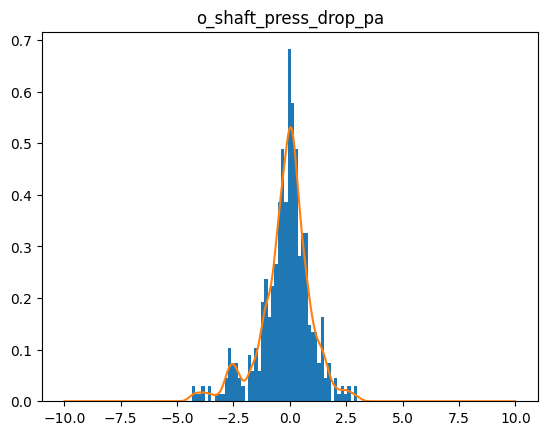

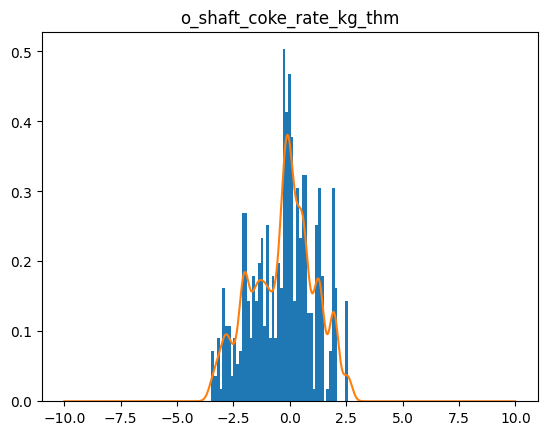

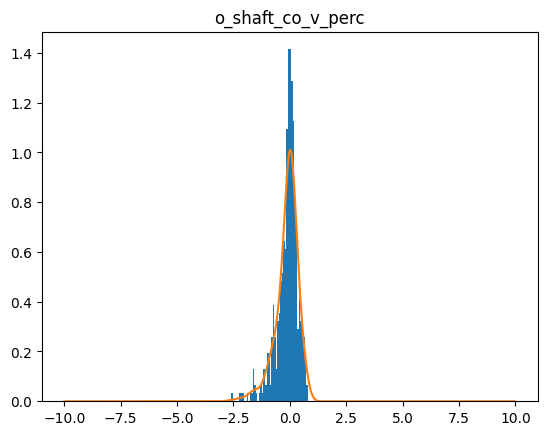

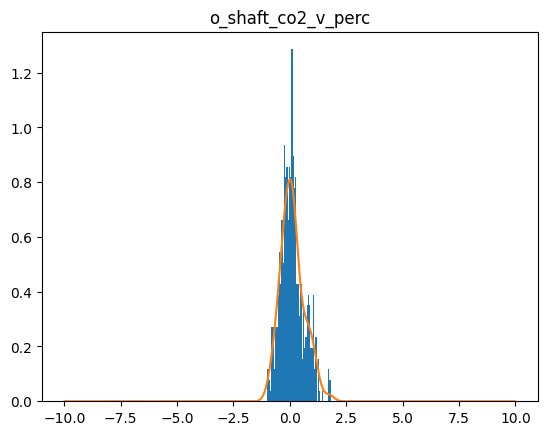

torch.Size([2000])
10101  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10102  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10103  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10104  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10105  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10106  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10107  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10108  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10109  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10110  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10111  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10112  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10113  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10114  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10115  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10116  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10117  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10118  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10119  lo

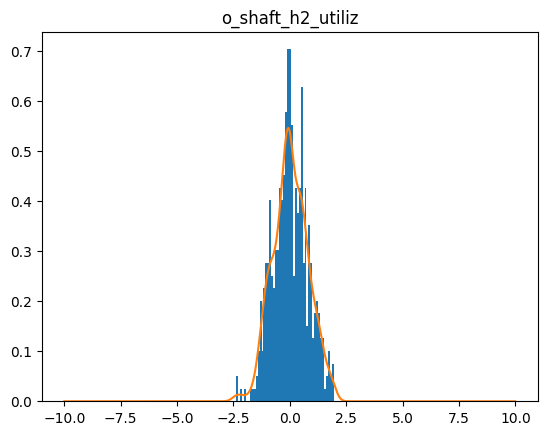

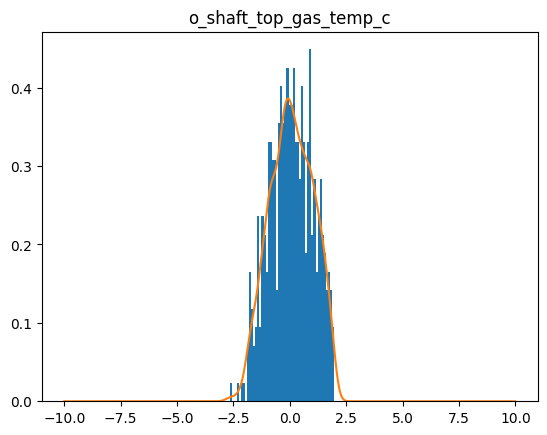

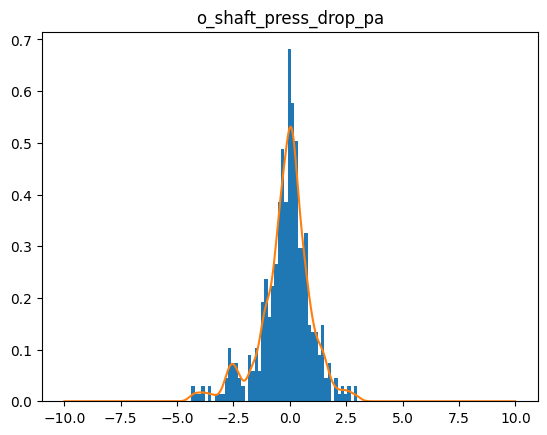

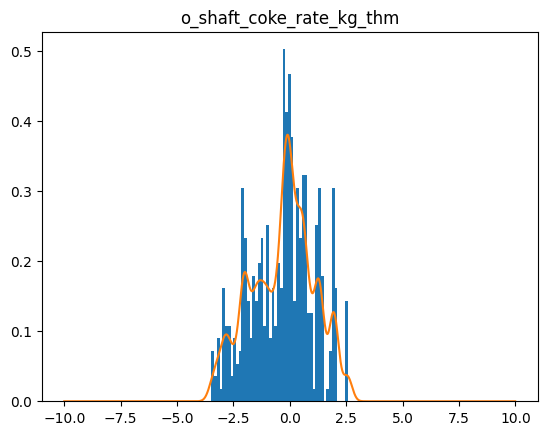

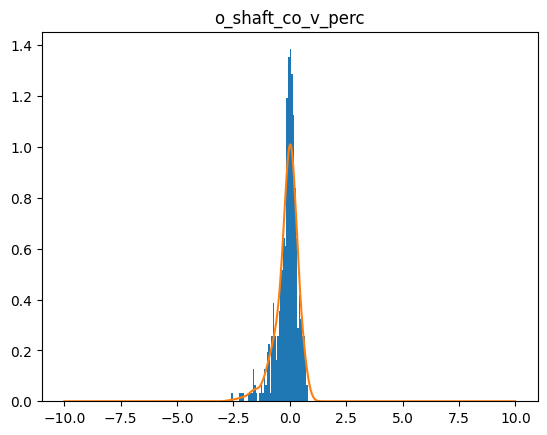

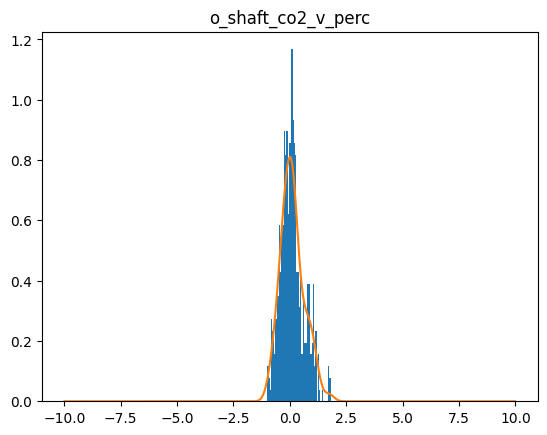

torch.Size([2000])
10201  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10202  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10203  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10204  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10205  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10206  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10207  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10208  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10209  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10210  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10211  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10212  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10213  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10214  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10215  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10216  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10217  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10218  loss=  tensor(0.0140, grad_fn=<MeanBackward0>)
10219  lo

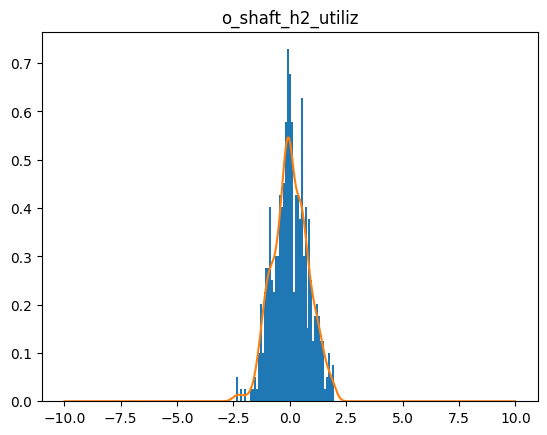

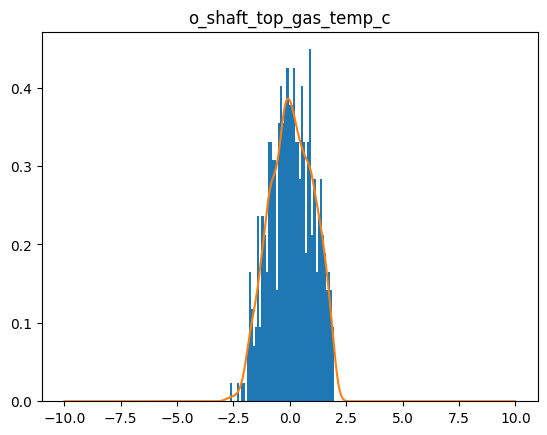

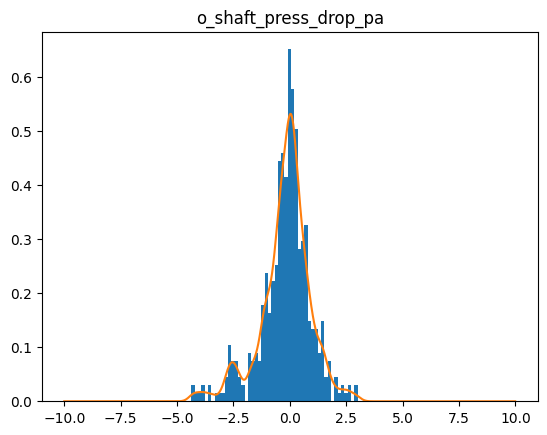

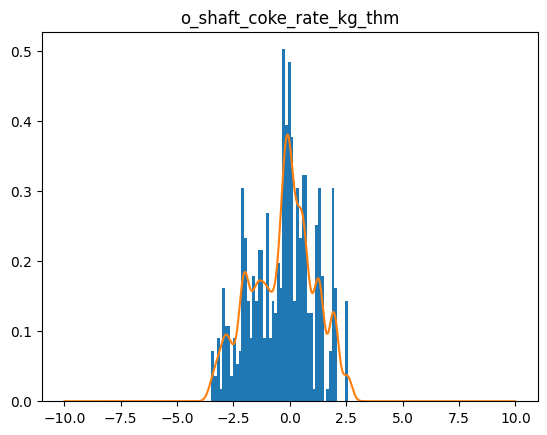

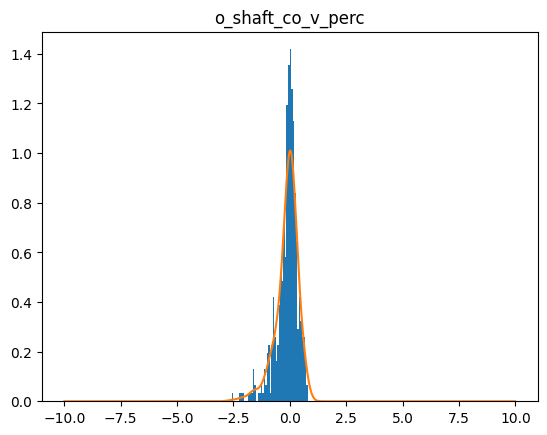

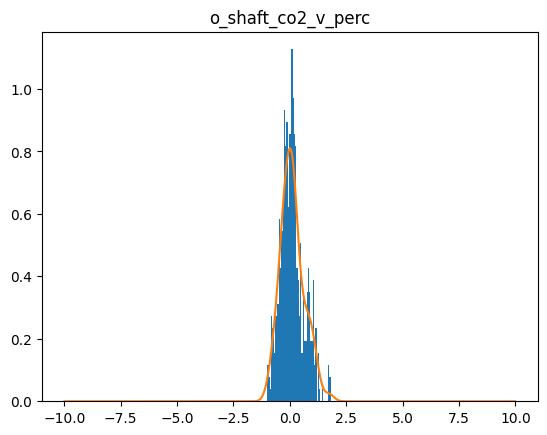

torch.Size([2000])
10301  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10302  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10303  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10304  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10305  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10306  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10307  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10308  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10309  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10310  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10311  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10312  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10313  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10314  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10315  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10316  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10317  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10318  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10319  lo

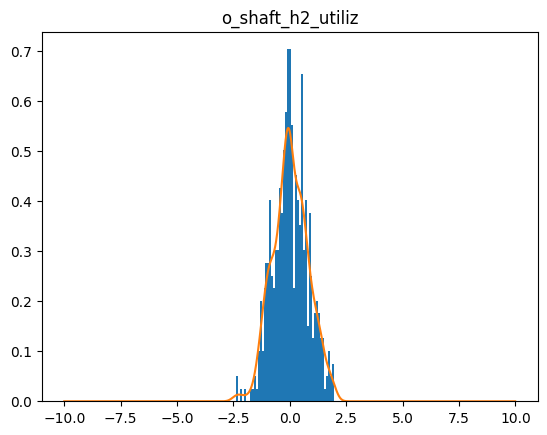

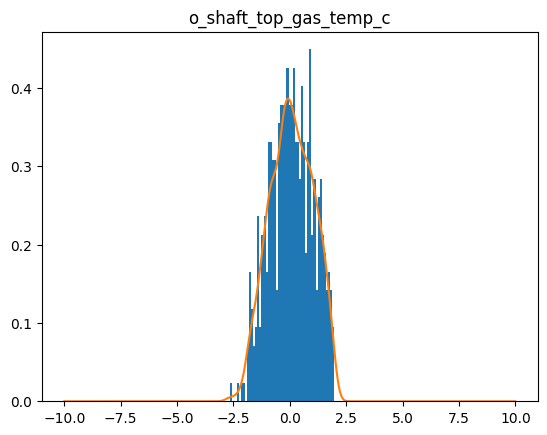

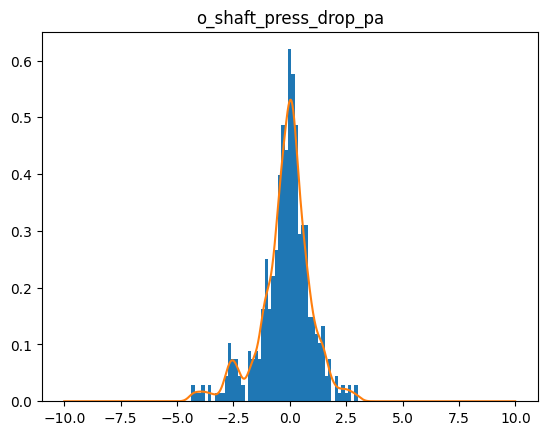

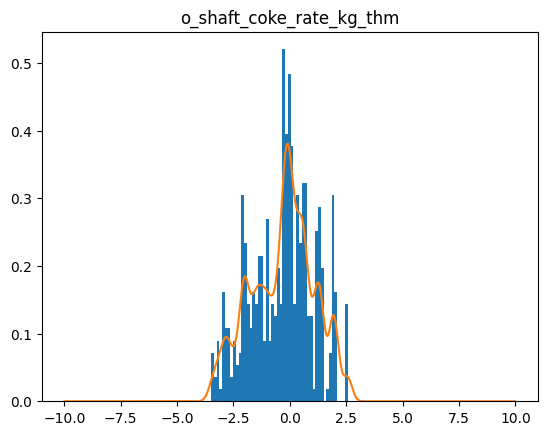

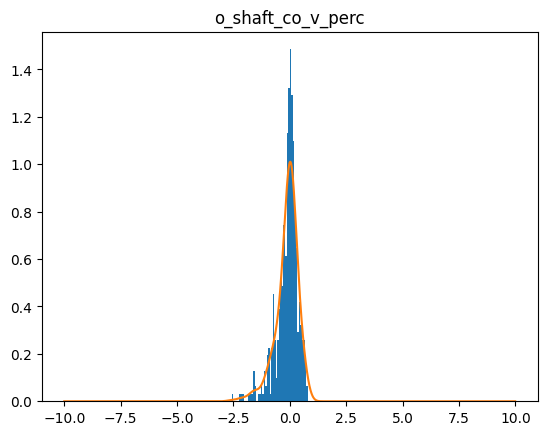

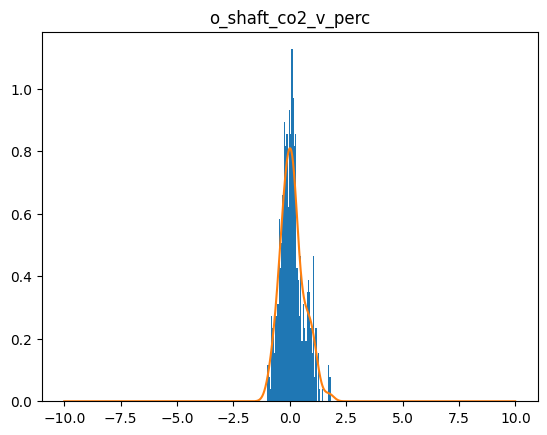

torch.Size([2000])
10401  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10402  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10403  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10404  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10405  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10406  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10407  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10408  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10409  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10410  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10411  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10412  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10413  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10414  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10415  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10416  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10417  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10418  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10419  lo

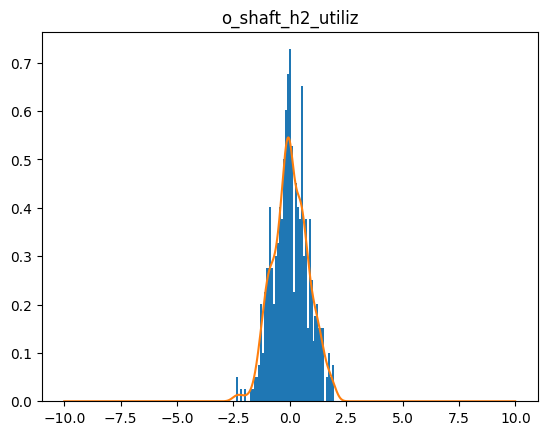

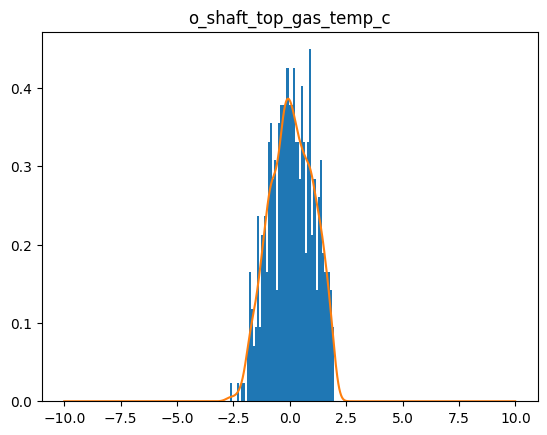

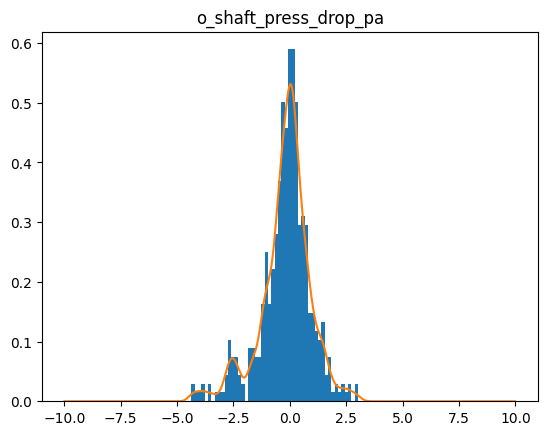

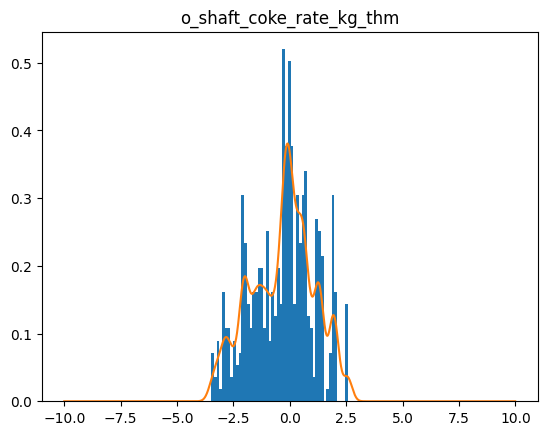

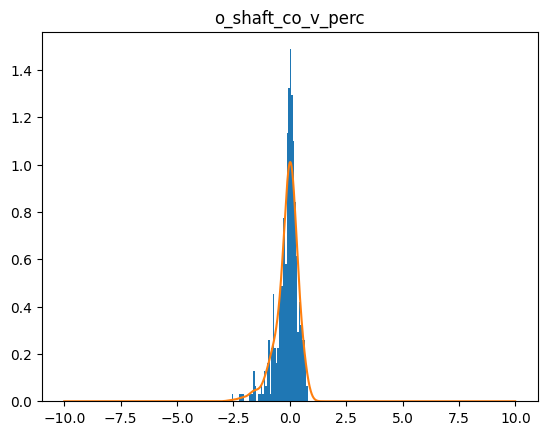

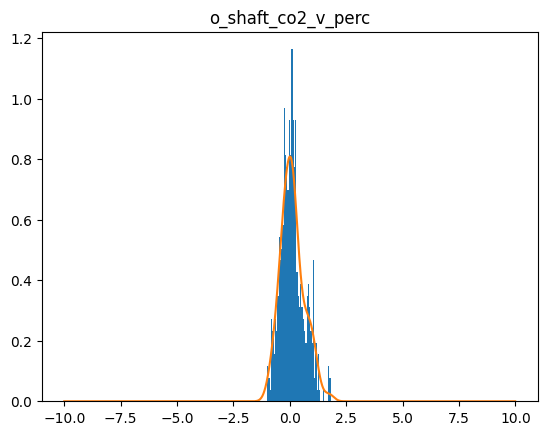

torch.Size([2000])
10501  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10502  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10503  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10504  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10505  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10506  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10507  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10508  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10509  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10510  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10511  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10512  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10513  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10514  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10515  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10516  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10517  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10518  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10519  lo

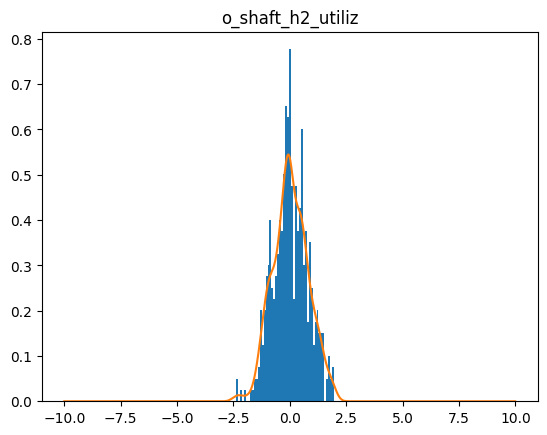

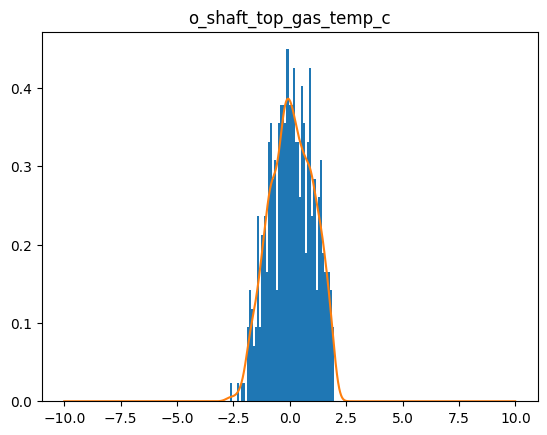

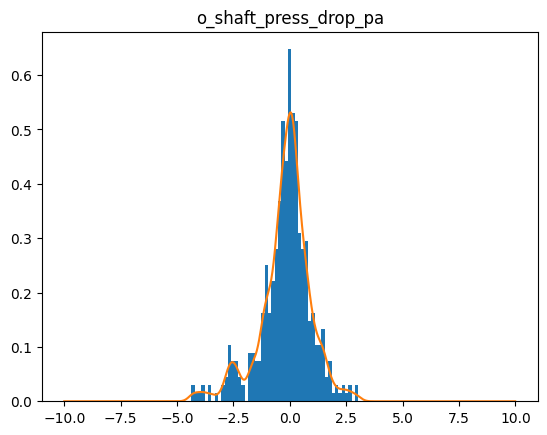

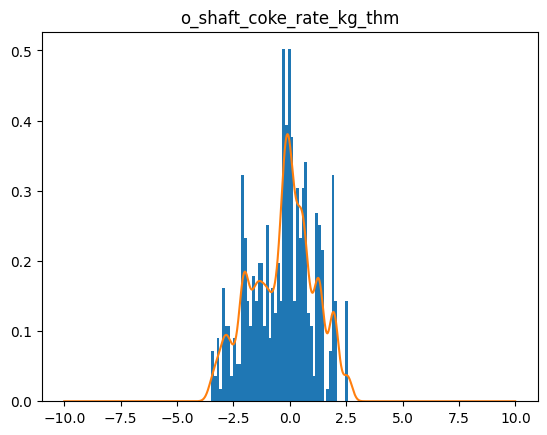

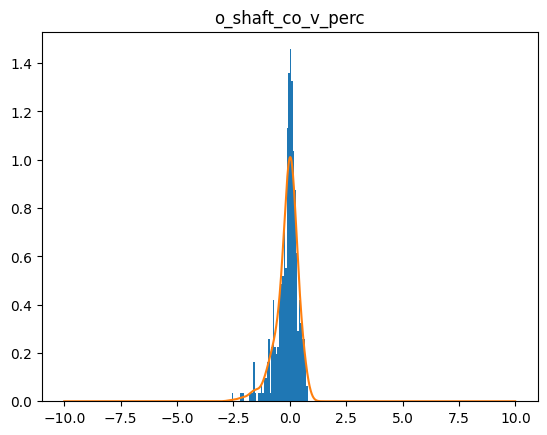

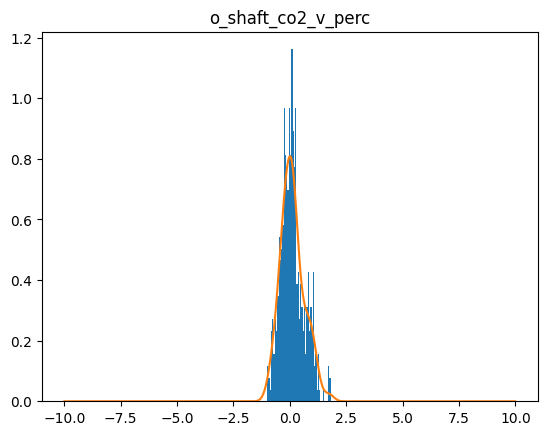

torch.Size([2000])
10601  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10602  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10603  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10604  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10605  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10606  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10607  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10608  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10609  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10610  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10611  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10612  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10613  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10614  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10615  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10616  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10617  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10618  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10619  lo

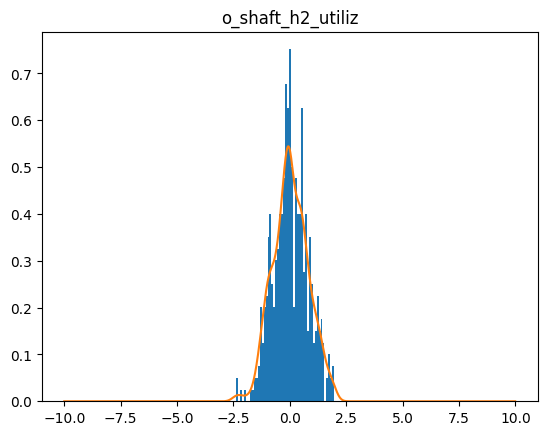

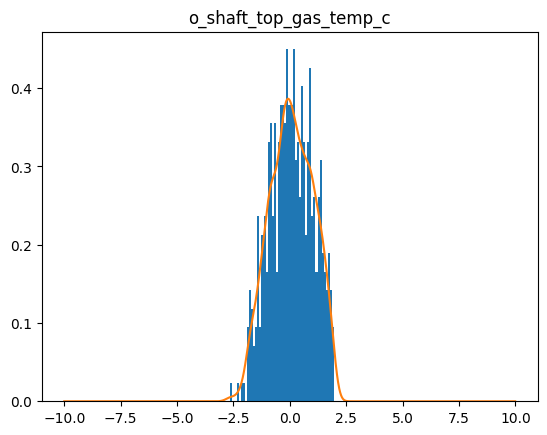

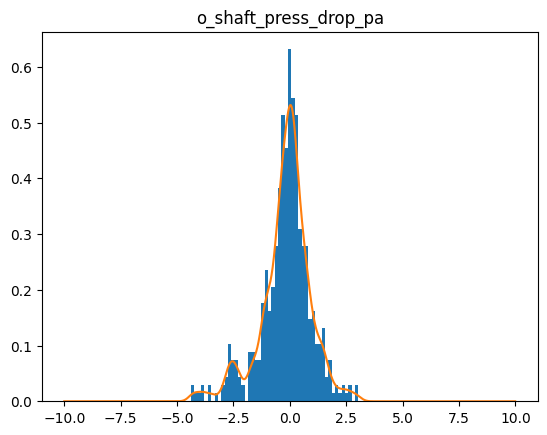

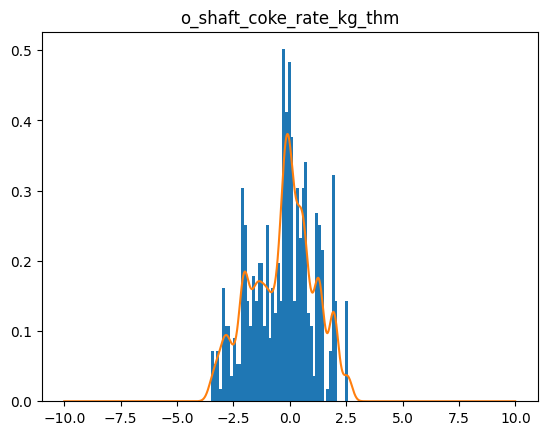

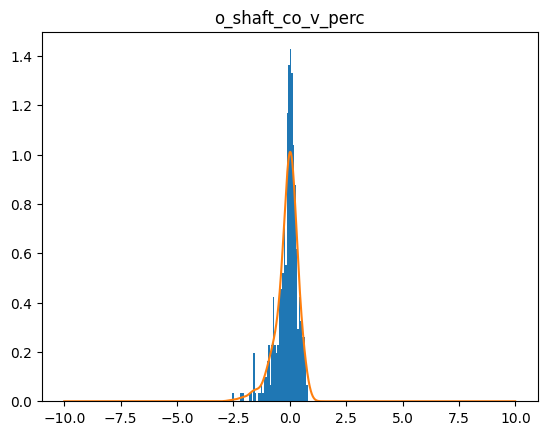

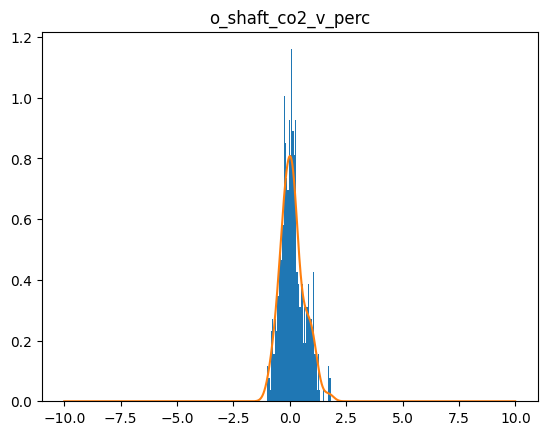

torch.Size([2000])
10701  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10702  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10703  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10704  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10705  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10706  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10707  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10708  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10709  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10710  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10711  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10712  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10713  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10714  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10715  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10716  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10717  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10718  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10719  lo

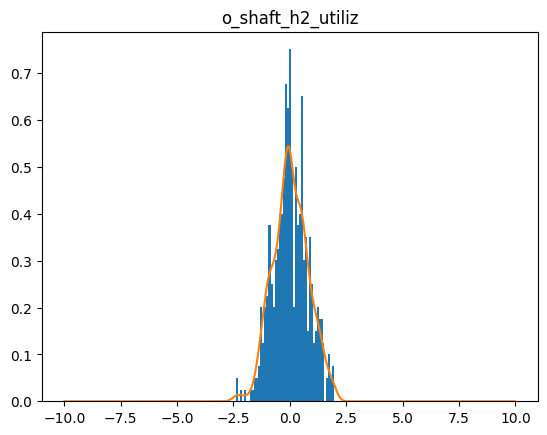

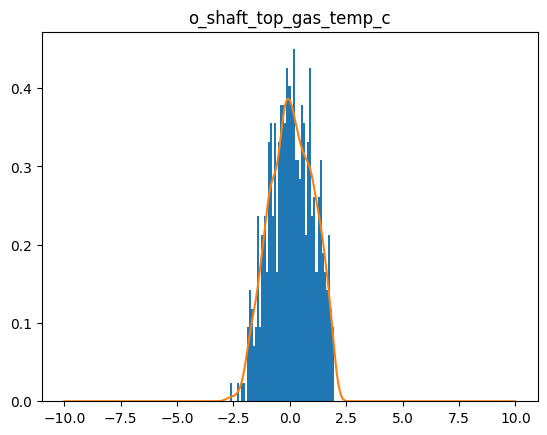

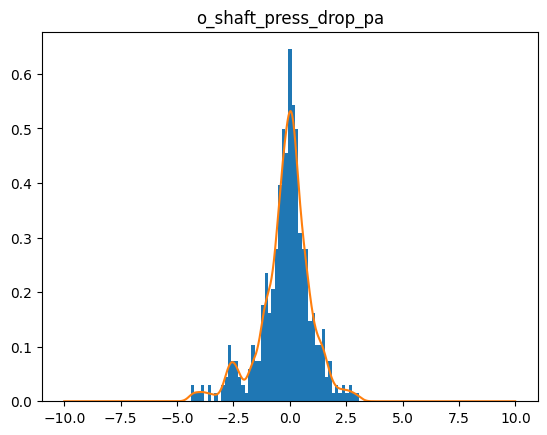

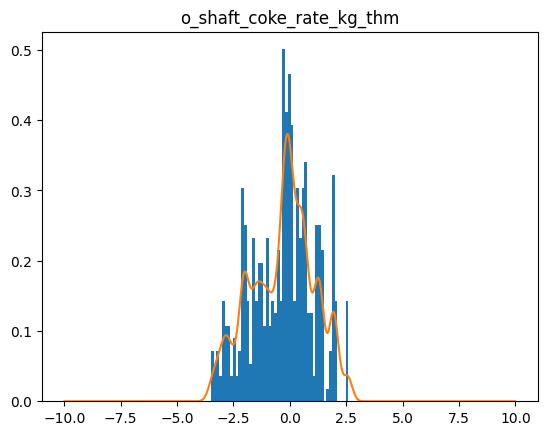

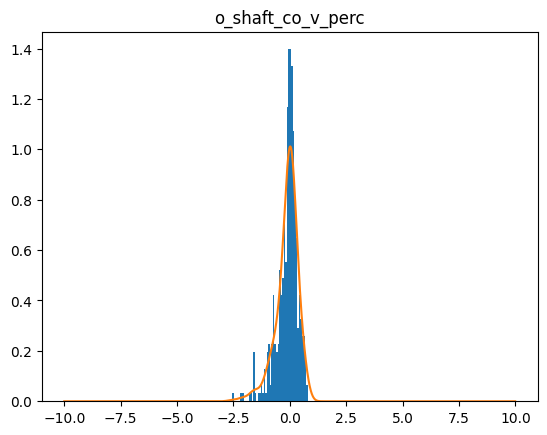

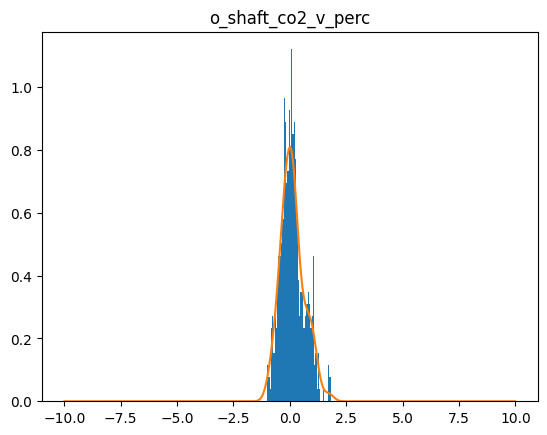

torch.Size([2000])
10801  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10802  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10803  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10804  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10805  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10806  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10807  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10808  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10809  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10810  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10811  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10812  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10813  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10814  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10815  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10816  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10817  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10818  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10819  lo

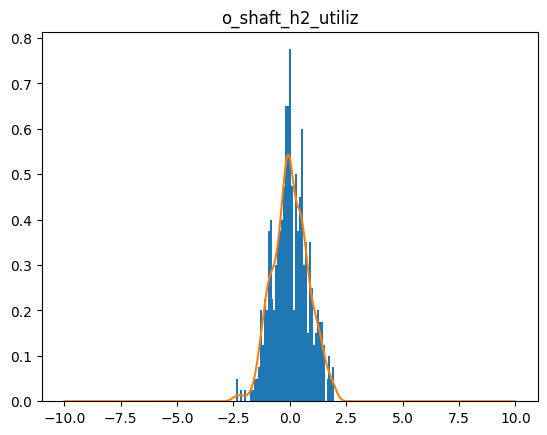

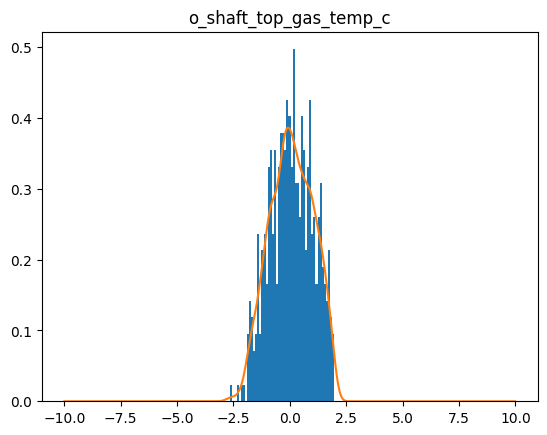

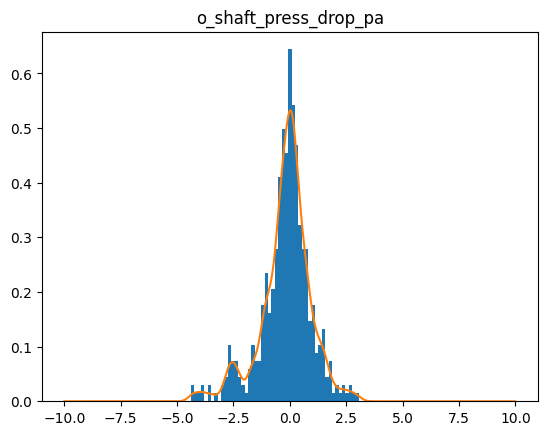

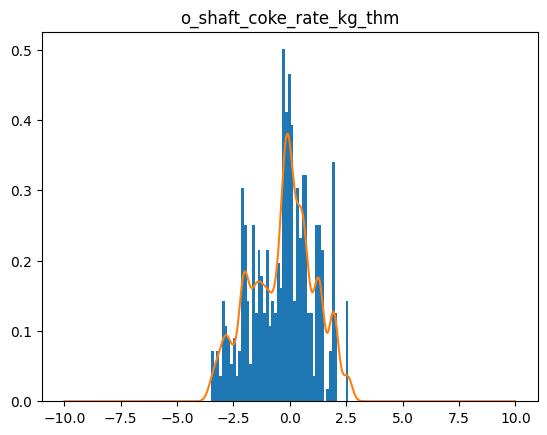

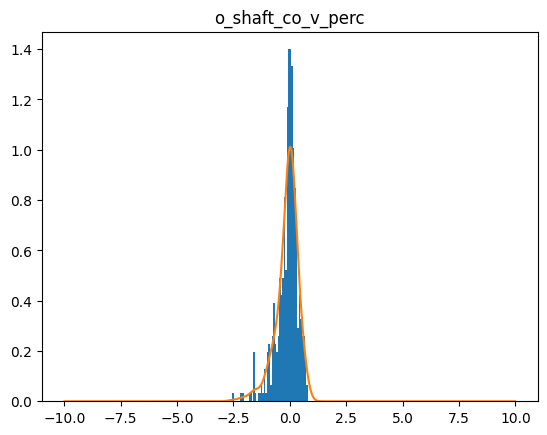

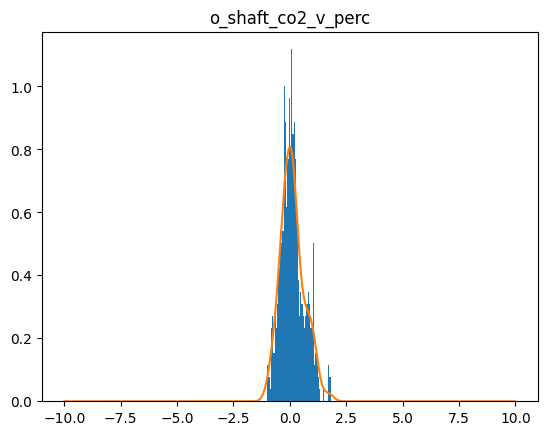

torch.Size([2000])
10901  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10902  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10903  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10904  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10905  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10906  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10907  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10908  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10909  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10910  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10911  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10912  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10913  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10914  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10915  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10916  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10917  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10918  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
10919  lo

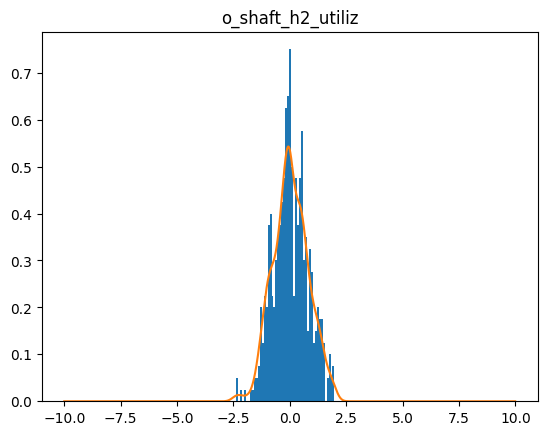

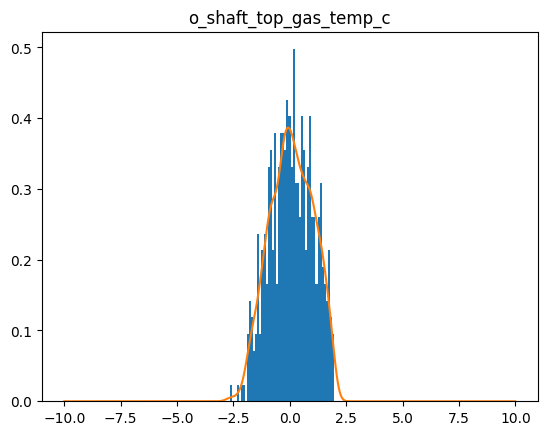

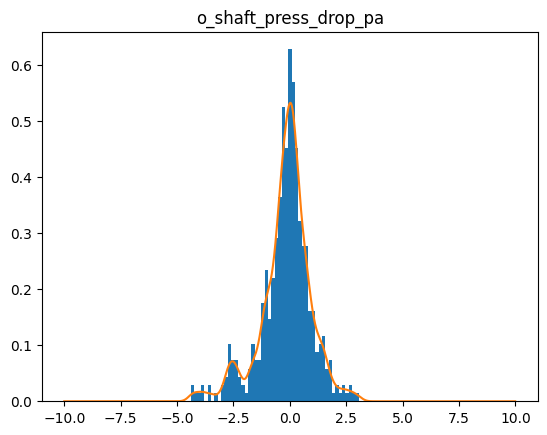

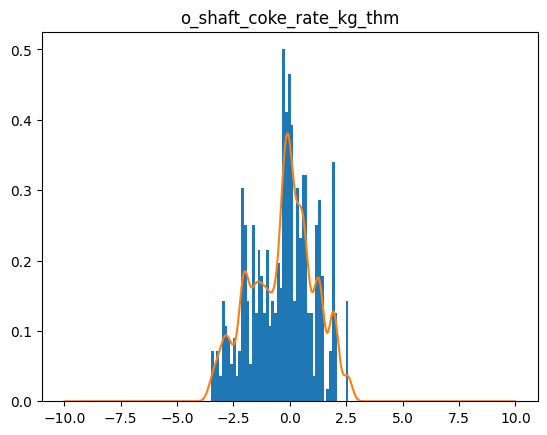

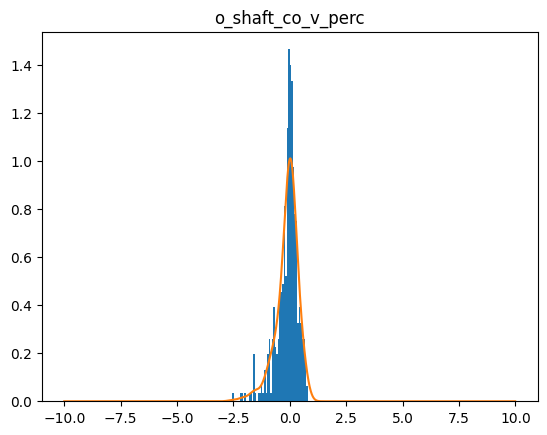

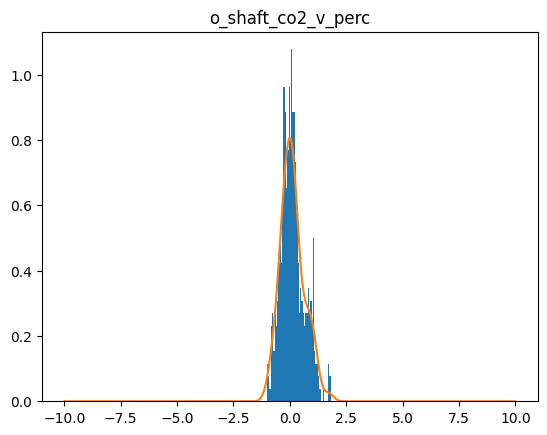

torch.Size([2000])
11001  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11002  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11003  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11004  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11005  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11006  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11007  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11008  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11009  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11010  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11011  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11012  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11013  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11014  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11015  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11016  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11017  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11018  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11019  lo

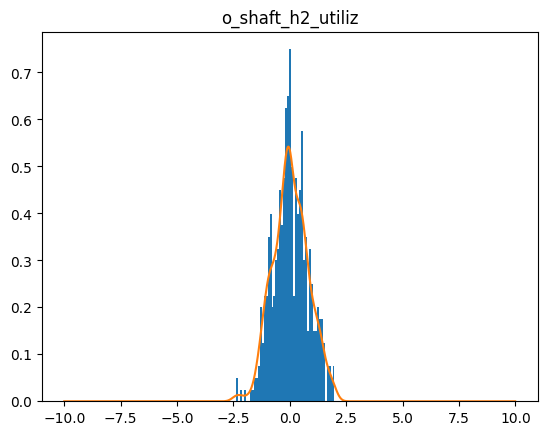

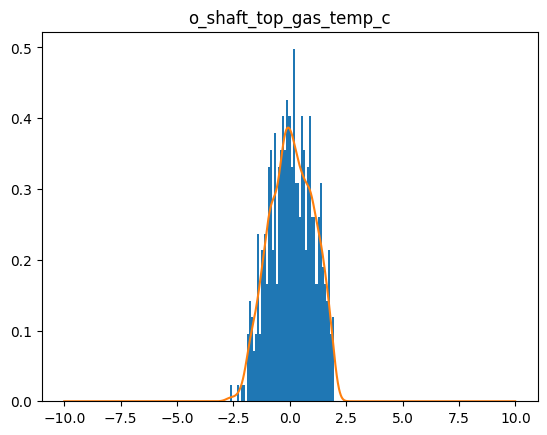

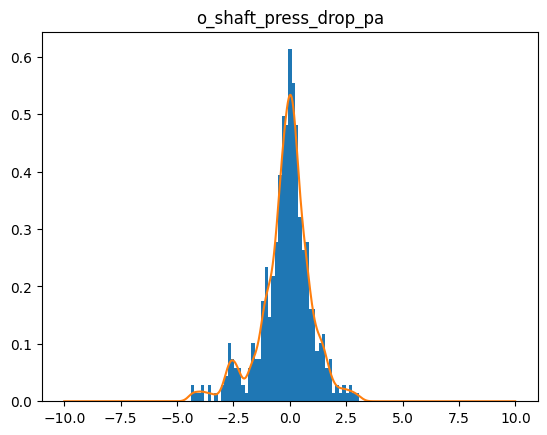

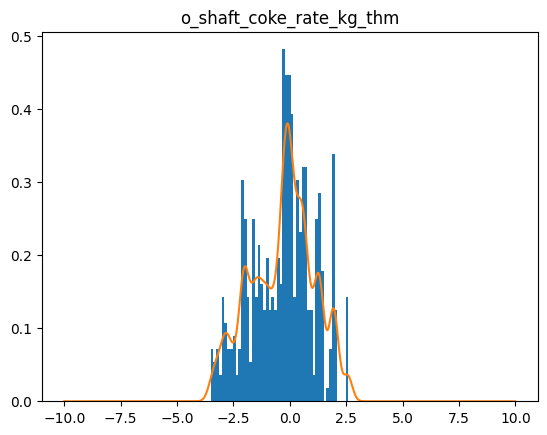

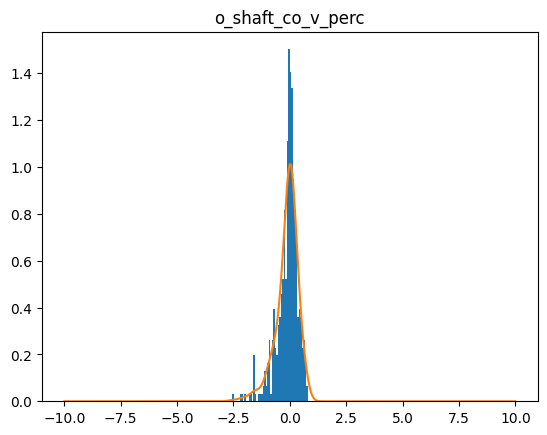

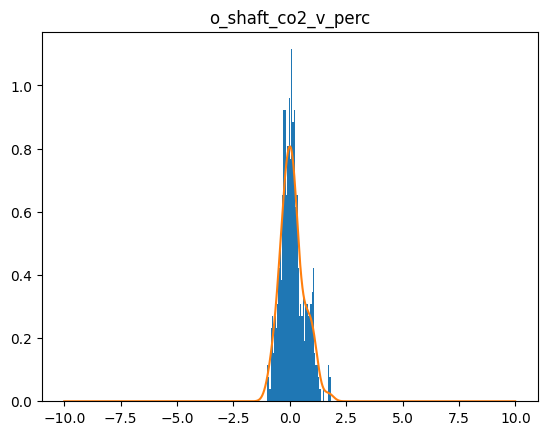

torch.Size([2000])
11101  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11102  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11103  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11104  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11105  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11106  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11107  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11108  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11109  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11110  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11111  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11112  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11113  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11114  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11115  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11116  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11117  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11118  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11119  lo

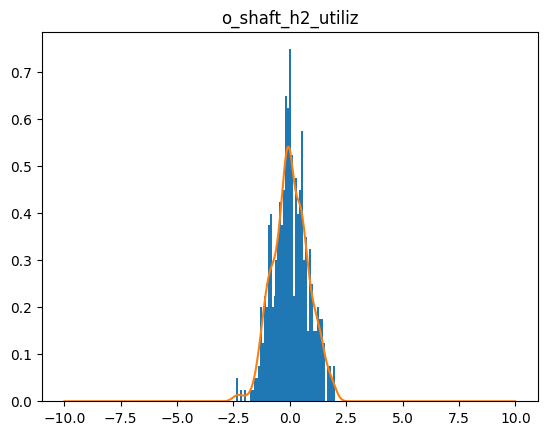

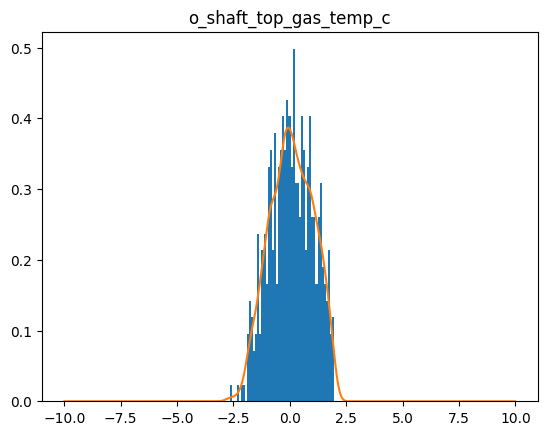

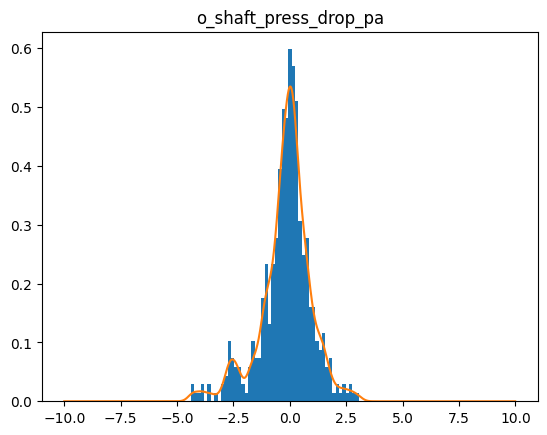

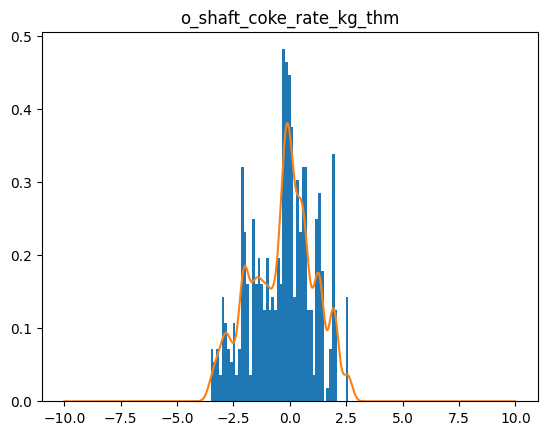

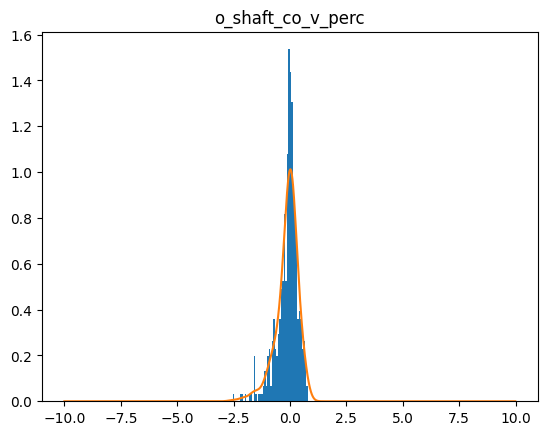

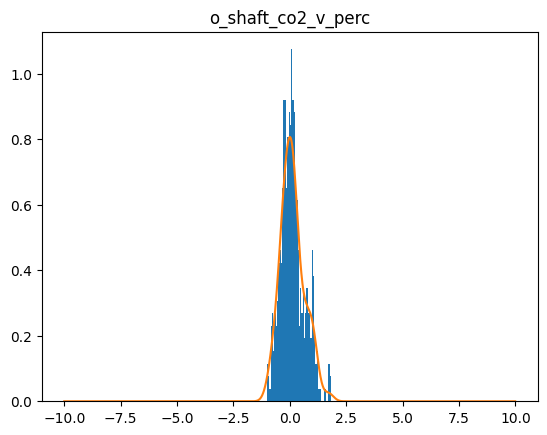

torch.Size([2000])
11201  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11202  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11203  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11204  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11205  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11206  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11207  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11208  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11209  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11210  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11211  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11212  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11213  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11214  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11215  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11216  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11217  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11218  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11219  lo

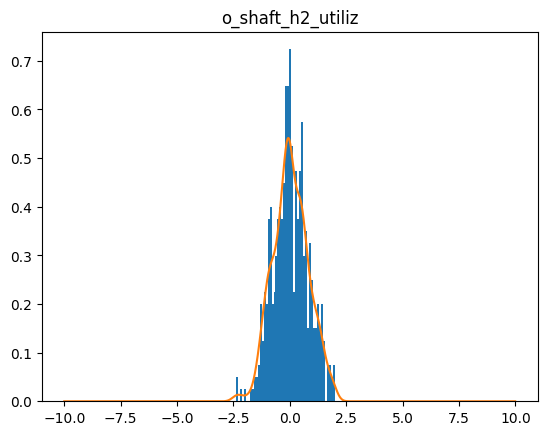

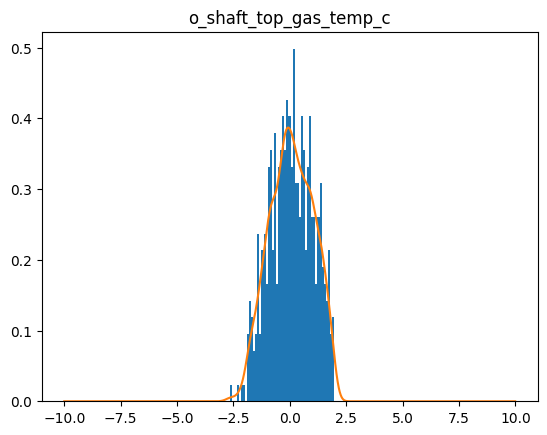

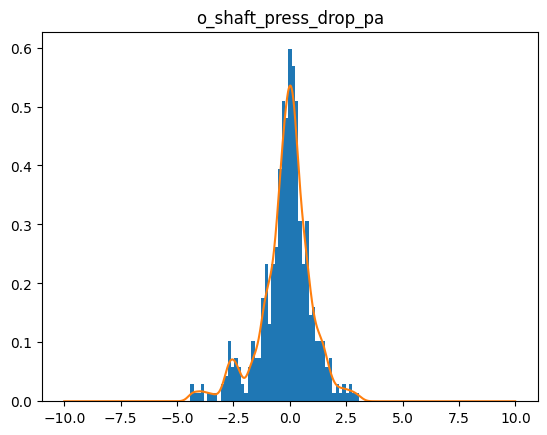

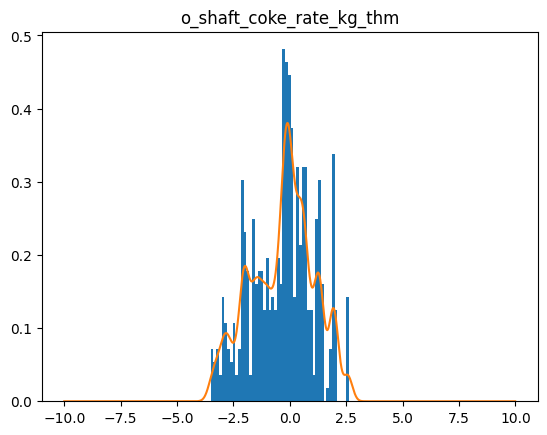

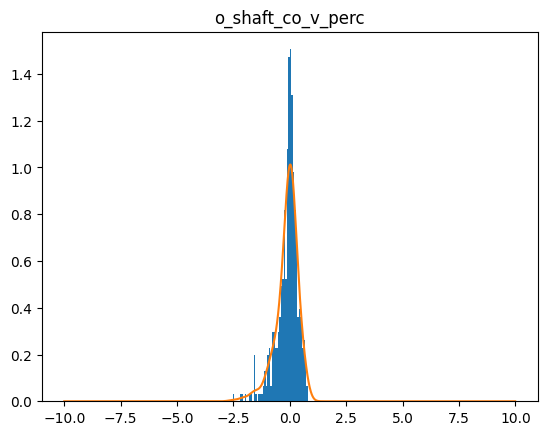

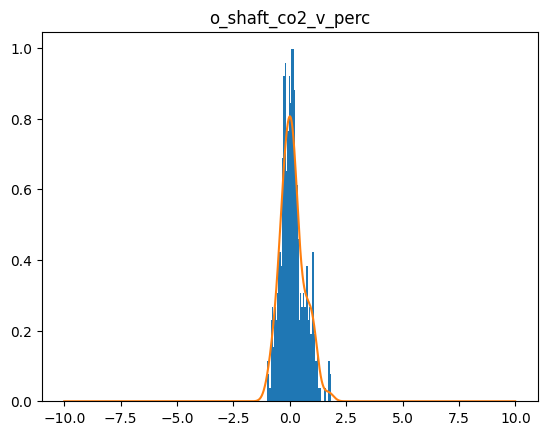

torch.Size([2000])
11301  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11302  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11303  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11304  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11305  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11306  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11307  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11308  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11309  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11310  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11311  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11312  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11313  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11314  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11315  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11316  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11317  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11318  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11319  lo

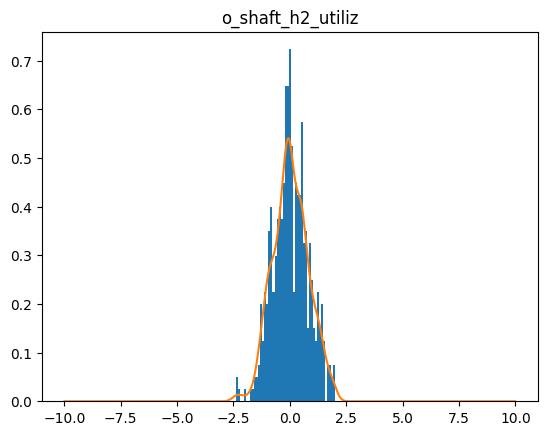

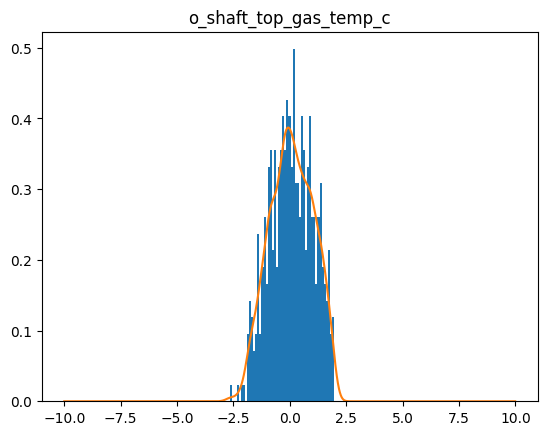

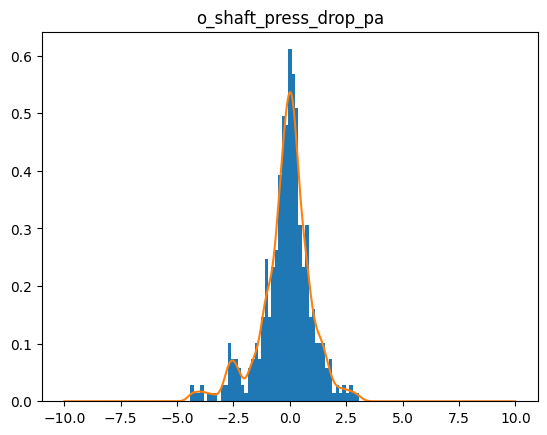

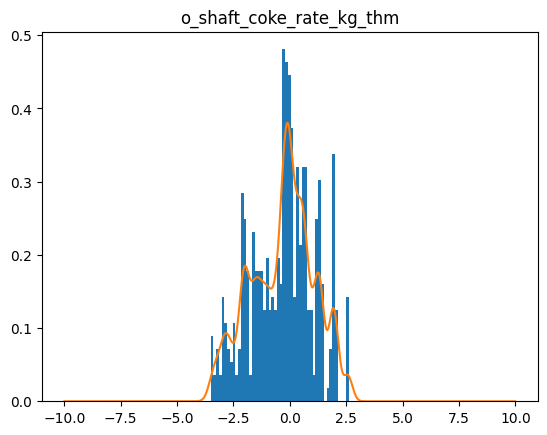

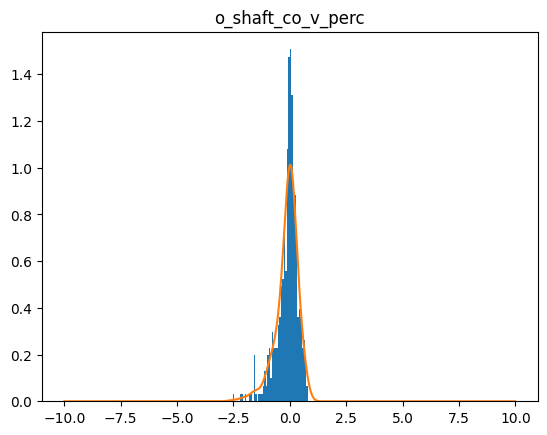

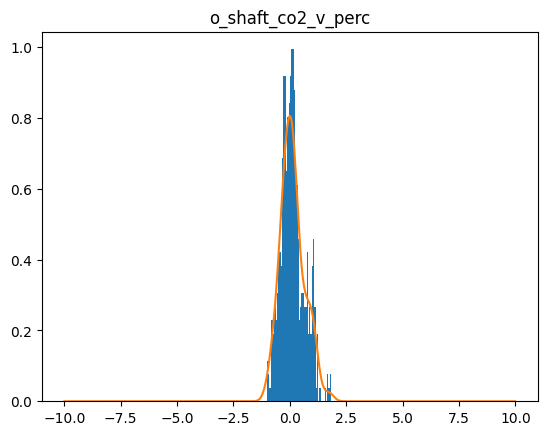

torch.Size([2000])
11401  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11402  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11403  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11404  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11405  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11406  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11407  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11408  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11409  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11410  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11411  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11412  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11413  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11414  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11415  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11416  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11417  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11418  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11419  lo

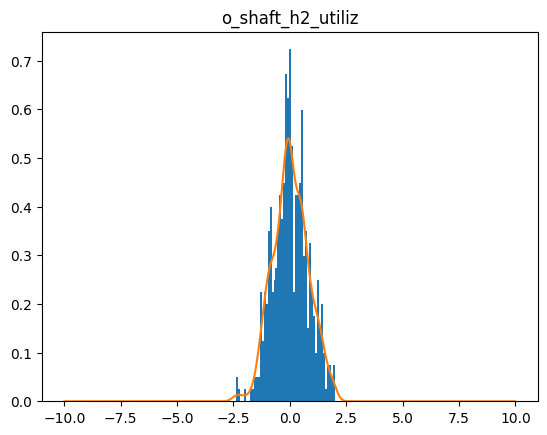

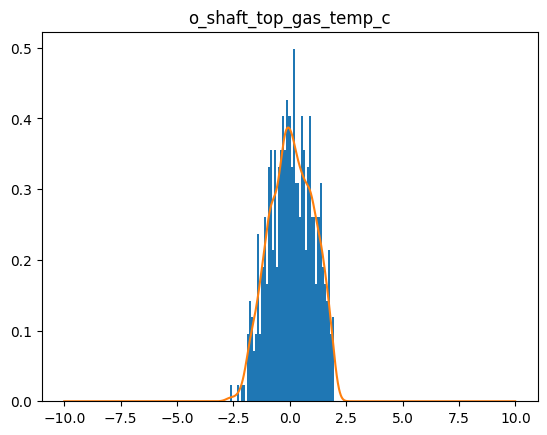

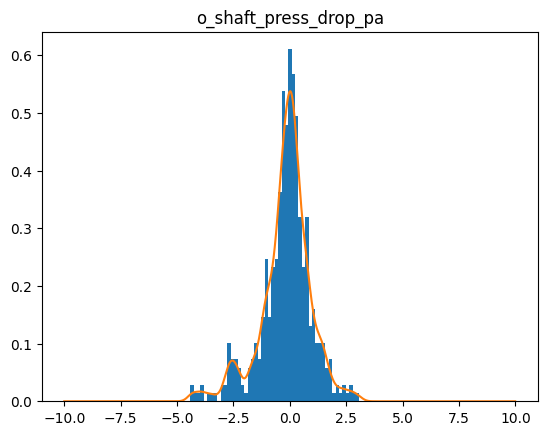

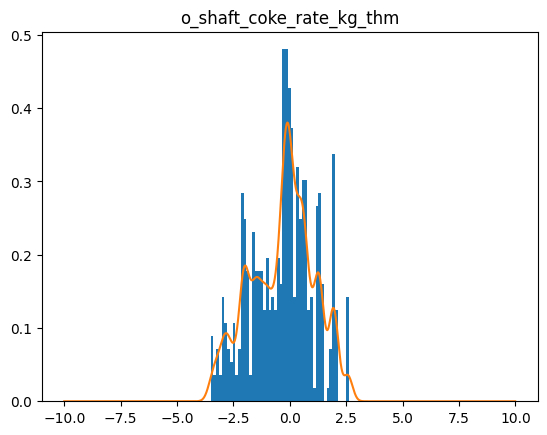

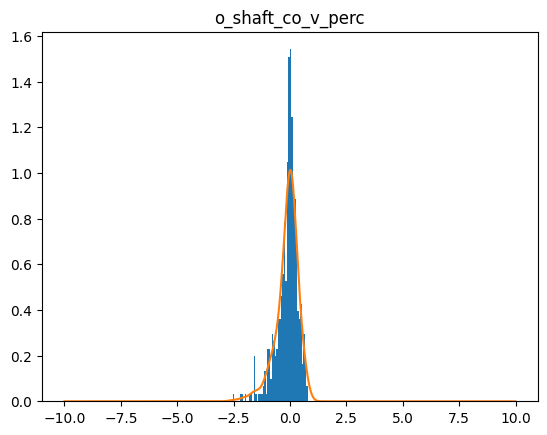

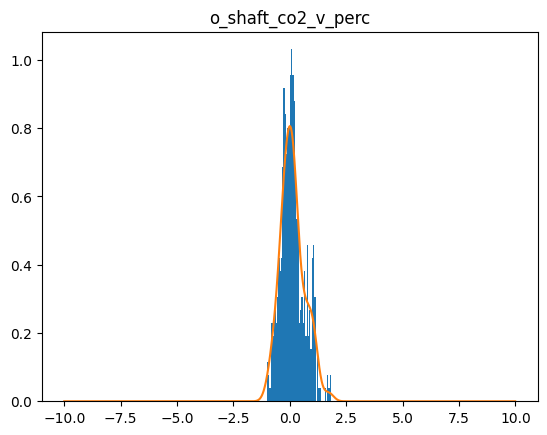

torch.Size([2000])
11501  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11502  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11503  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11504  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11505  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11506  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11507  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11508  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11509  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11510  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11511  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11512  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11513  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11514  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11515  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11516  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11517  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11518  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11519  lo

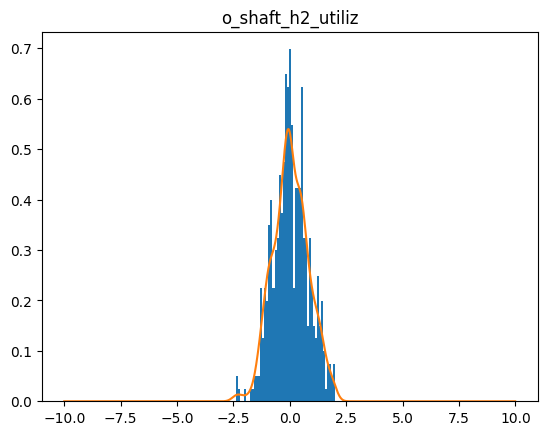

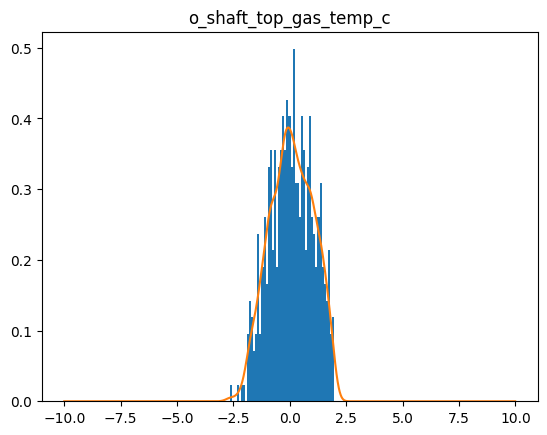

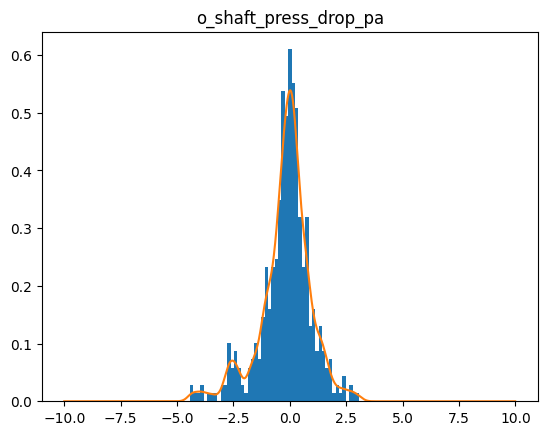

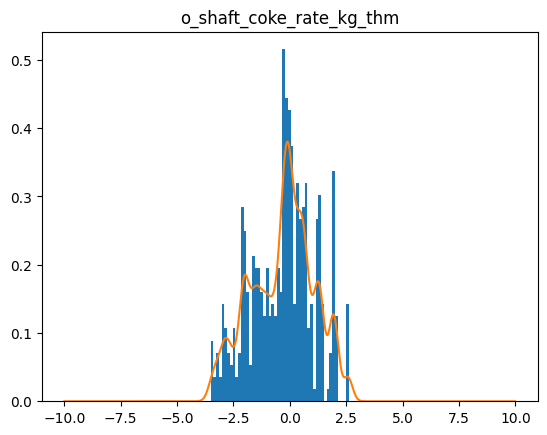

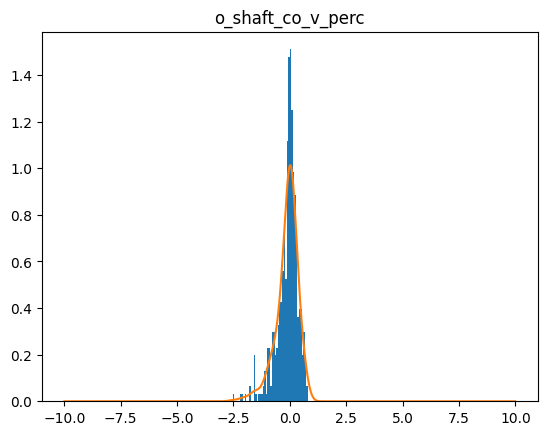

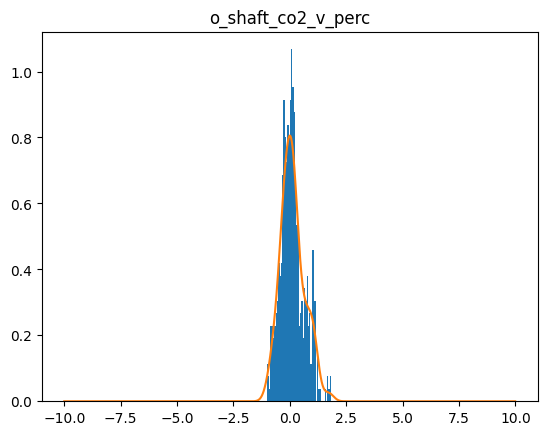

torch.Size([2000])
11601  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11602  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11603  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11604  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11605  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11606  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11607  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11608  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11609  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11610  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11611  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11612  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11613  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11614  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11615  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11616  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11617  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11618  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11619  lo

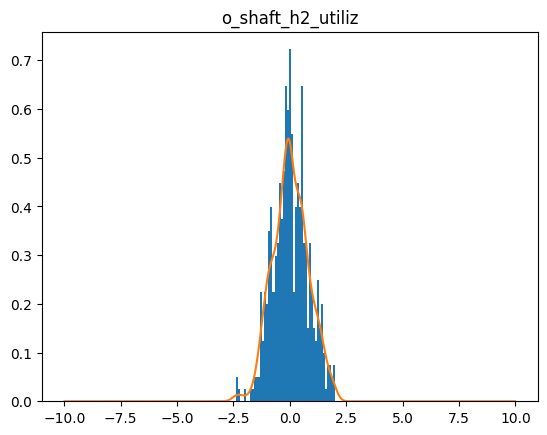

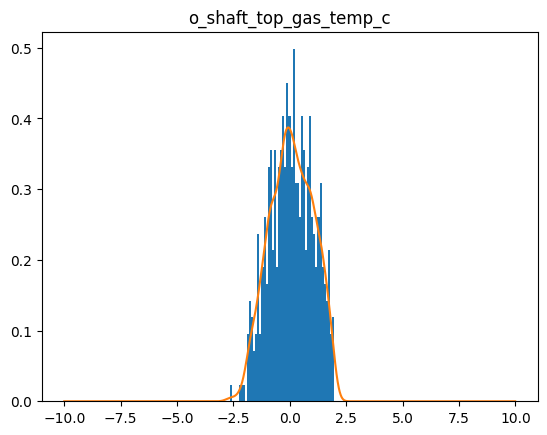

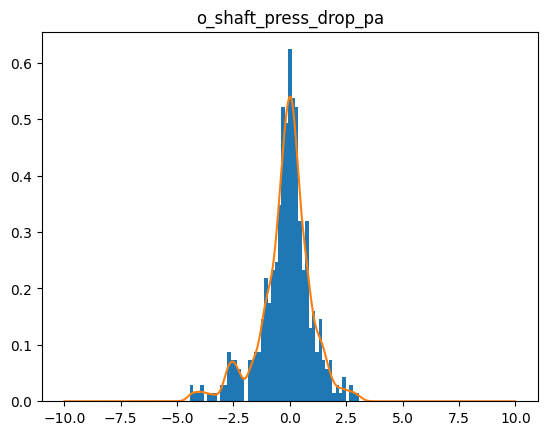

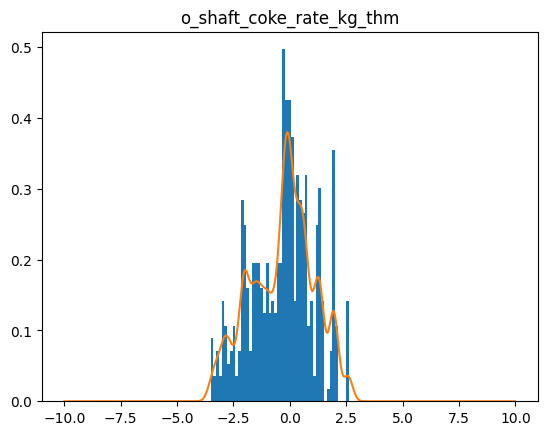

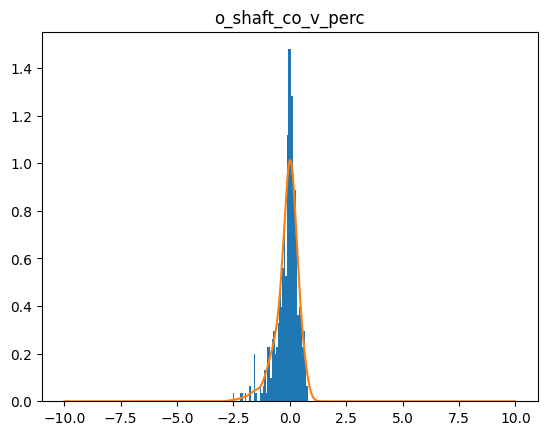

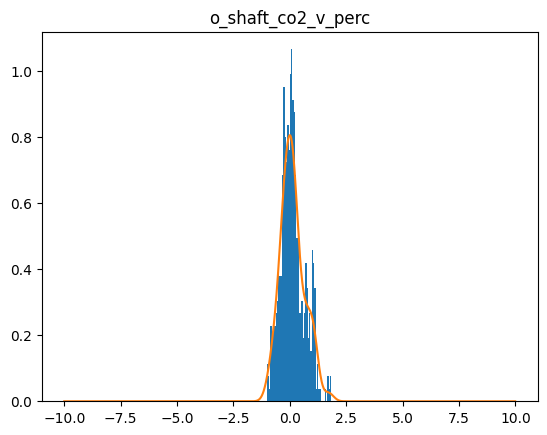

torch.Size([2000])
11701  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11702  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11703  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11704  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11705  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11706  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11707  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11708  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11709  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11710  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11711  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11712  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11713  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11714  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11715  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11716  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11717  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11718  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11719  lo

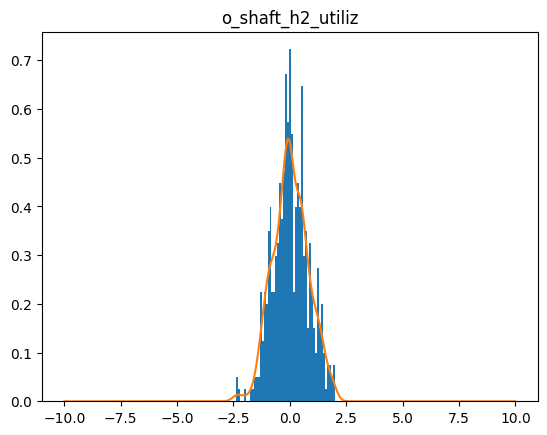

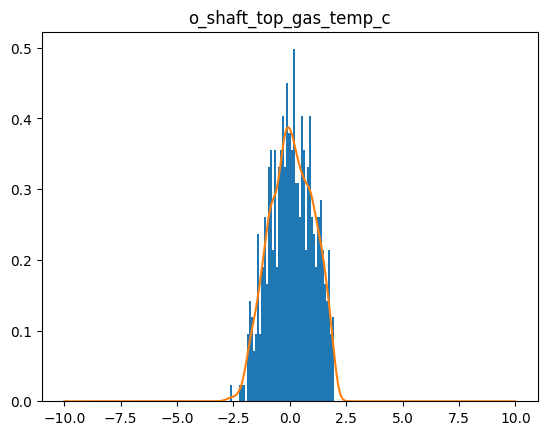

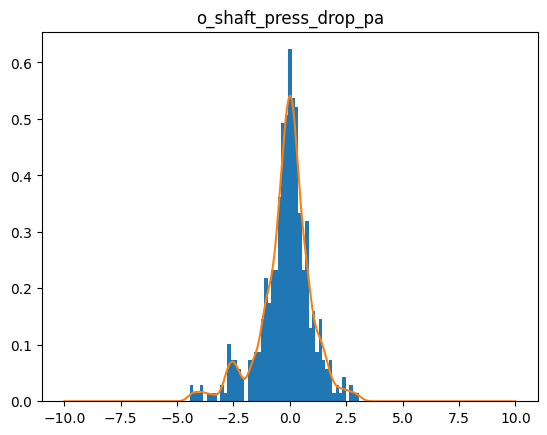

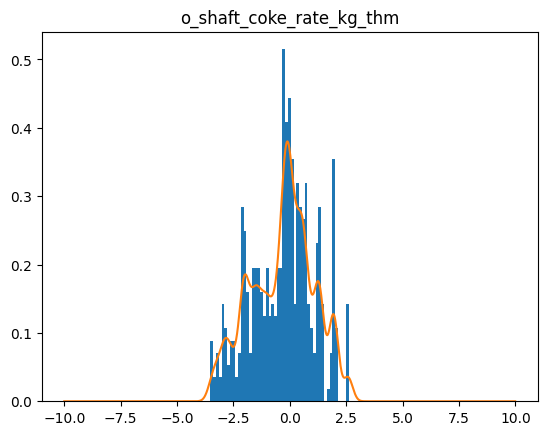

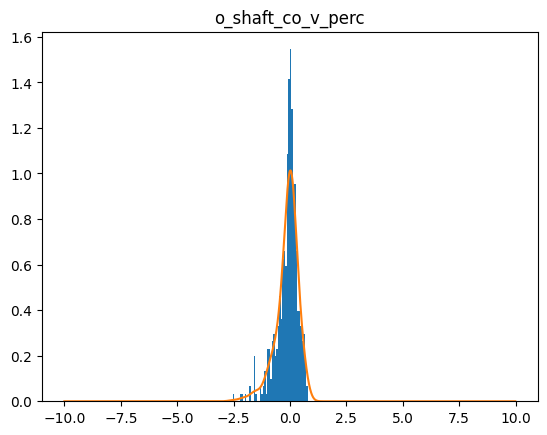

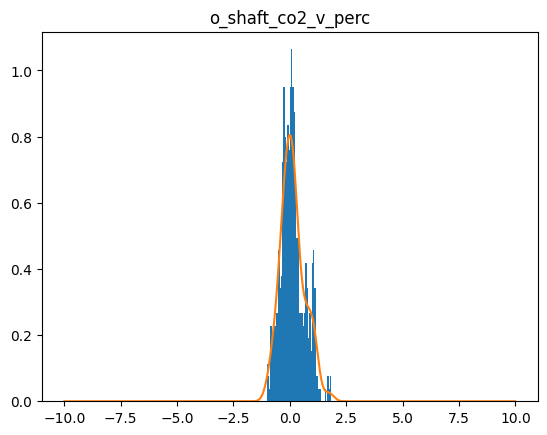

torch.Size([2000])
11801  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11802  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11803  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11804  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11805  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11806  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11807  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11808  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11809  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11810  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11811  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11812  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11813  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11814  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11815  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11816  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11817  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11818  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11819  lo

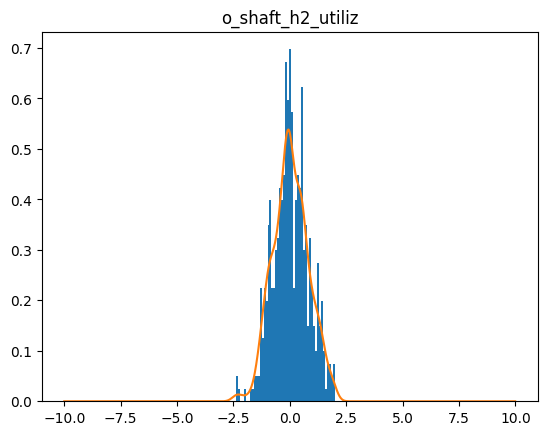

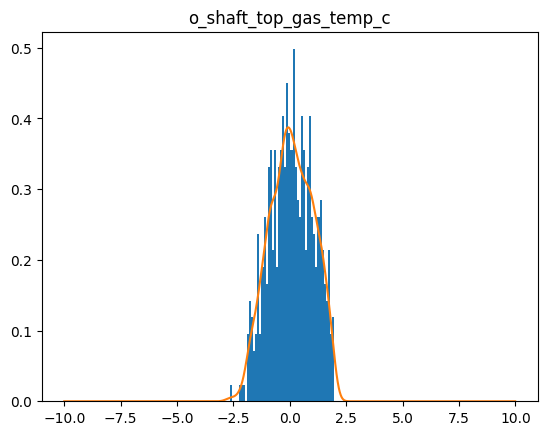

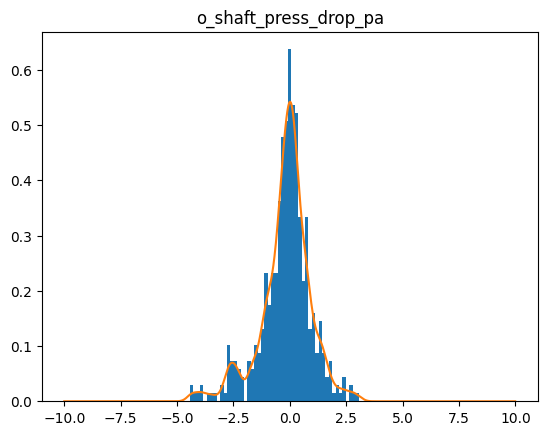

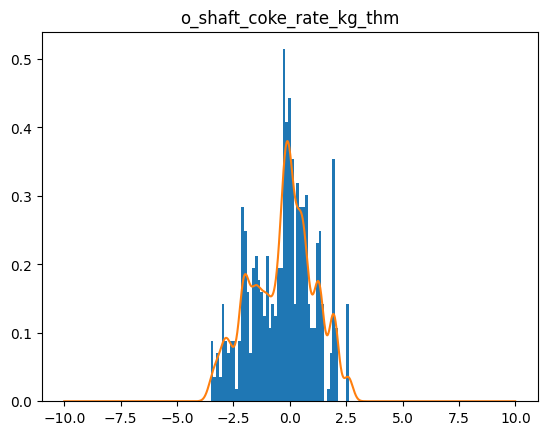

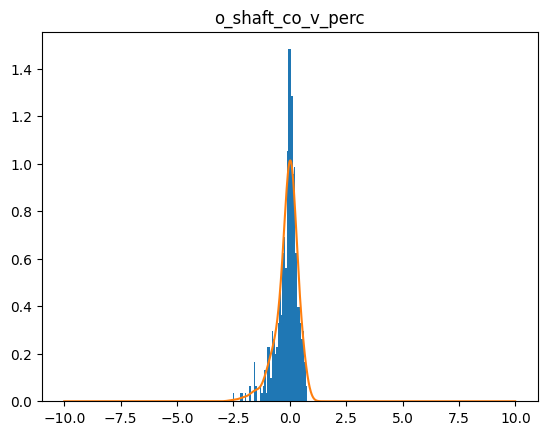

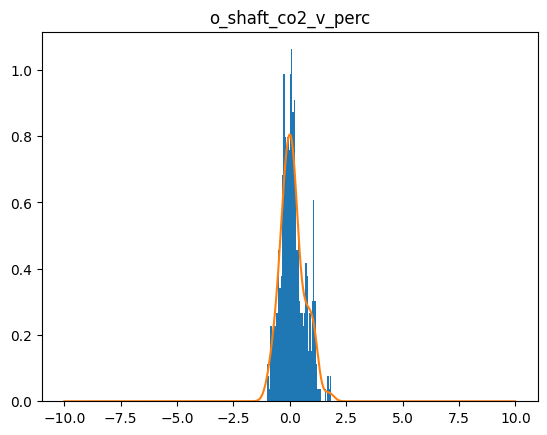

torch.Size([2000])
11901  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11902  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11903  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11904  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11905  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11906  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11907  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11908  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11909  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11910  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11911  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11912  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11913  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11914  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11915  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11916  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11917  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11918  loss=  tensor(0.0139, grad_fn=<MeanBackward0>)
11919  lo

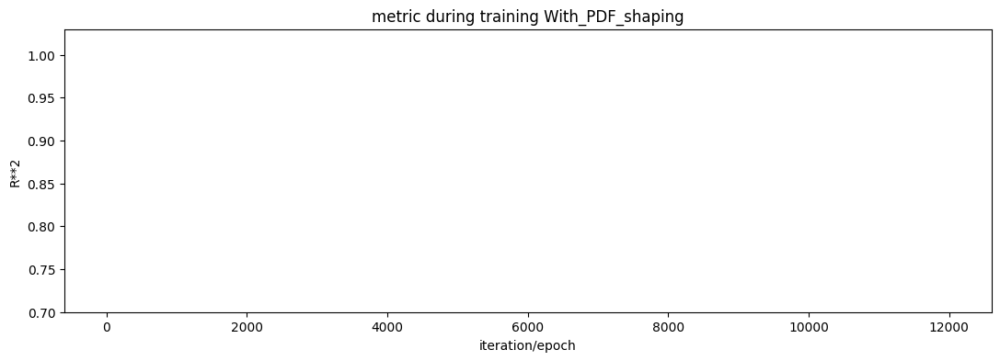

Training loss: tensor(0.9114, grad_fn=<MseLossBackward0>)
Training R**2: -6.409258469042981
Test loss - scaled: tensor(0.8350, grad_fn=<MseLossBackward0>)
Test loss - descaled: tensor(84785408., grad_fn=<MseLossBackward0>)
Testing R**2 - scaled: -6.042572274736323
Testing R**2 - descaled: -6.04257207749944
*****
*****
Testing R**2 - Output: 0 o_shaft_h2_utiliz -1.8113747690602273
*****
*****
Testing R**2 - Output: 1 o_shaft_top_gas_temp_c -31.627910149833802
*****
*****
Testing R**2 - Output: 2 o_shaft_press_drop_pa -0.4174929309517501
*****
*****
Testing R**2 - Output: 3 o_shaft_coke_rate_kg_thm -3.537268219946464
*****
*****
Testing R**2 - Output: 4 o_shaft_co_v_perc 0.5210555195834086
*****
*****
Testing R**2 - Output: 5 o_shaft_co2_v_perc 0.6175580386245807


In [27]:
modelSigma = SigmaNN()
    

model = VeryBasicMLP_Removed_Best_Practices(
          PDFshapingOBJ.x_means, 
          PDFshapingOBJ.x_deviations, 
          PDFshapingOBJ.y_means, 
          PDFshapingOBJ.y_deviations
)

opt       = torch.optim.Adam(   model.parameters(), lr=PDFshapingOBJ.learning_rate   )
opt_sigma = torch.optim.Adam(   modelSigma.parameters(), lr=PDFshapingOBJ.learning_rate   )

loss_fn     = F.mse_loss


fit_y_scaled_PDF(PDFshapingOBJ.N_EPOCHS, PDFshapingOBJ.N_EPOCHS_PDF, model, loss_fn, opt, modelSigma, opt_sigma)

pred_descaled, pred_scaled = model(PDFshapingOBJ.X_test_tr)
print('Test loss - scaled:',   loss_fn(     pred_scaled,       PDFshapingOBJ.y_test_tr_scaled          ))
print('Test loss - descaled:', loss_fn(     pred_descaled,     PDFshapingOBJ.y_test_tr                 ))
print('Testing R**2 - scaled:',   r2_score( pred_scaled.detach().numpy(),PDFshapingOBJ.y_test_tr_scaled.numpy() ))
print('Testing R**2 - descaled:', r2_score( pred_descaled.detach().numpy(), PDFshapingOBJ.y_test_tr.numpy()   ))


PDFshapingOBJ.print_individual_Rsquare(pred_descaled, PDFshapingOBJ.y_test_tr)

In [28]:
list_preds = []
list_reals = []

for i in range(len(PDFshapingOBJ.X_test_tr)):
    print("**************************************************")
    print("preds, real")
    preds_descaled, preds_scaled = model(PDFshapingOBJ.X_test_tr[i])

    np_pred = preds_descaled[0].detach().numpy()              ## [0]
    np_real = PDFshapingOBJ.y_test_tr[i].detach().numpy()

    for j in range(len(np_pred)):
        print((np_pred[j], np_real[j]))
        list_preds.append(np_pred[j])
        list_reals.append(np_real[j])

**************************************************
preds, real
(45.21664, 46.42636)
(121.074776, 141.2165)
(164361.4, 167260.5)
(356.09845, 466.68994)
(0.26072302, 0.2664488)
(0.24844362, 0.2463347)
**************************************************
preds, real
(42.911095, 43.0617)
(136.20934, 159.7076)
(118545.0, 114048.8)
(434.24374, 435.45975)
(0.22441669, 0.2157743)
(0.20245591, 0.2097598)
**************************************************
preds, real
(42.22576, 39.20885)
(140.70813, 186.6342)
(104925.94, 164842.3)
(457.4726, 362.33145)
(0.21362452, 0.2124868)
(0.18878594, 0.184583)
**************************************************
preds, real
(44.920963, 46.38947)
(123.01572, 60.8438)
(158485.64, 121061.5)
(366.12024, 540.206)
(0.2560669, 0.2885154)
(0.24254589, 0.2370163)
**************************************************
preds, real
(45.277317, 43.83788)
(120.67646, 102.8444)
(165567.22, 168383.5)
(354.0418, 460.50705)
(0.26167852, 0.2855439)
(0.24965394, 0.2301054)
***********

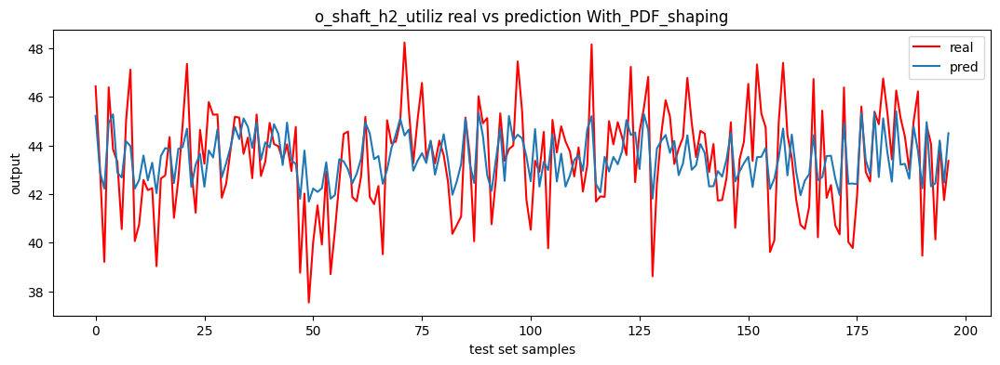

/Users/user/Desktop/DOE_CIVS/experiments/2023april/PDFshapingUtils.py:347: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(error, bins=n_bins, color="blue")


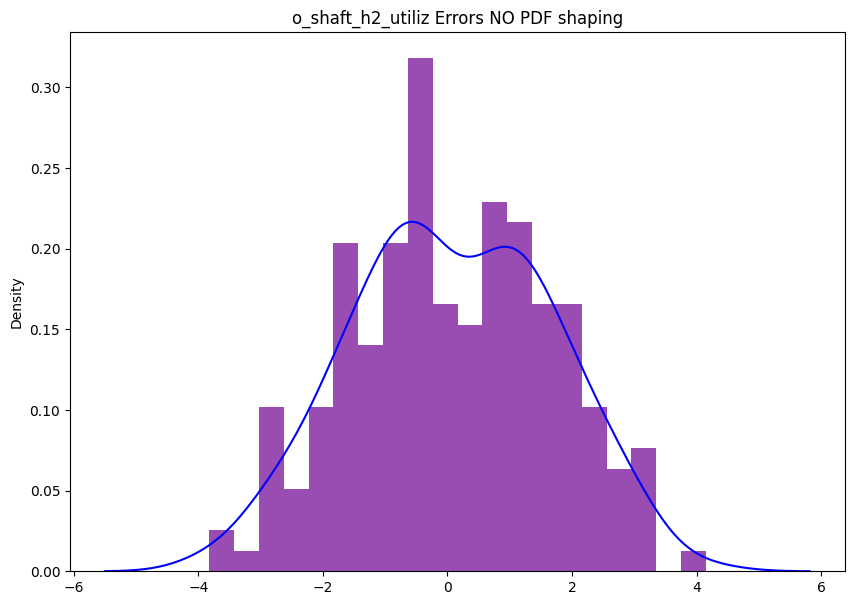

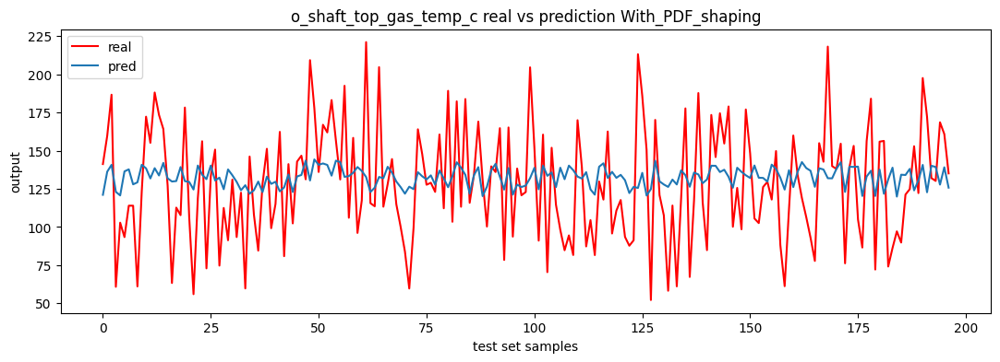

/Users/user/Desktop/DOE_CIVS/experiments/2023april/PDFshapingUtils.py:347: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(error, bins=n_bins, color="blue")


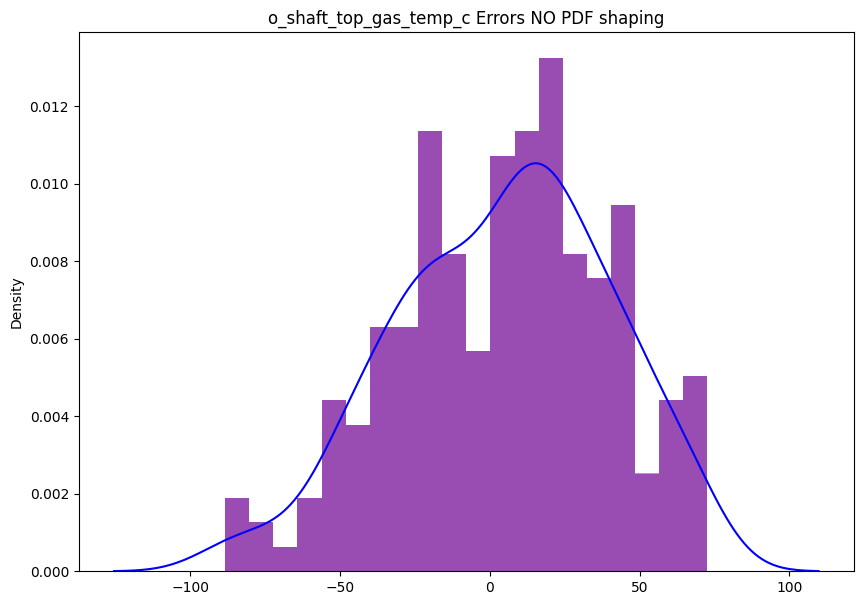

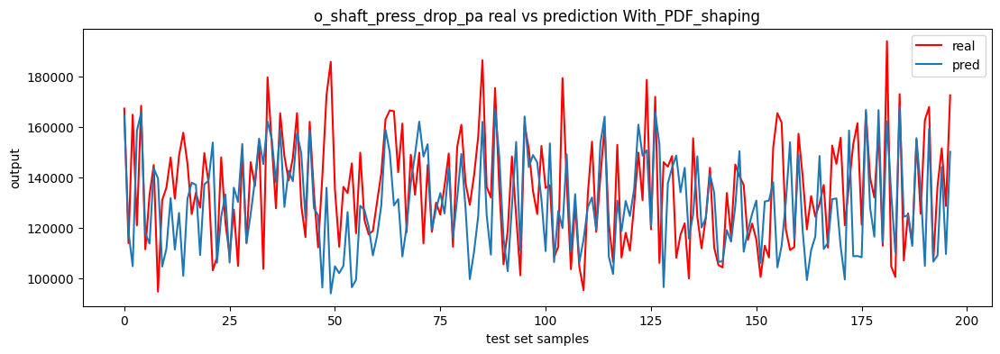

/Users/user/Desktop/DOE_CIVS/experiments/2023april/PDFshapingUtils.py:347: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(error, bins=n_bins, color="blue")


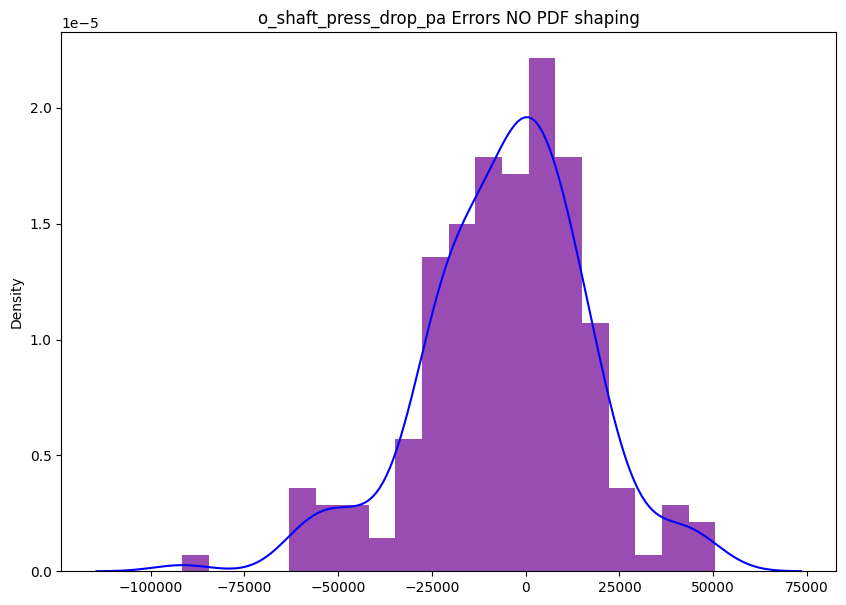

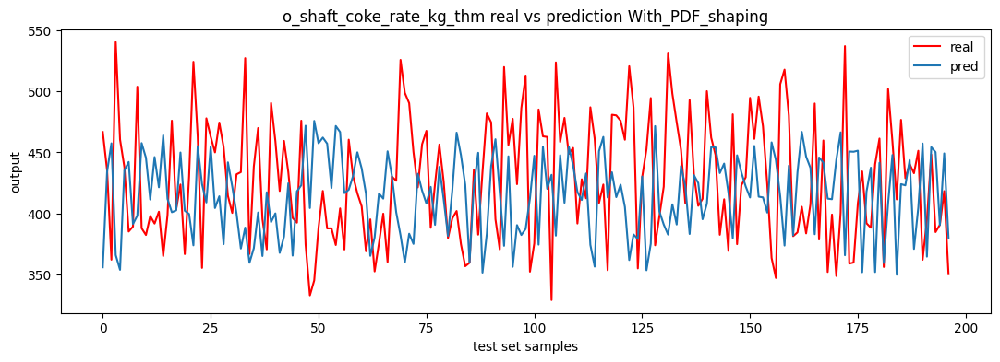

/Users/user/Desktop/DOE_CIVS/experiments/2023april/PDFshapingUtils.py:347: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(error, bins=n_bins, color="blue")


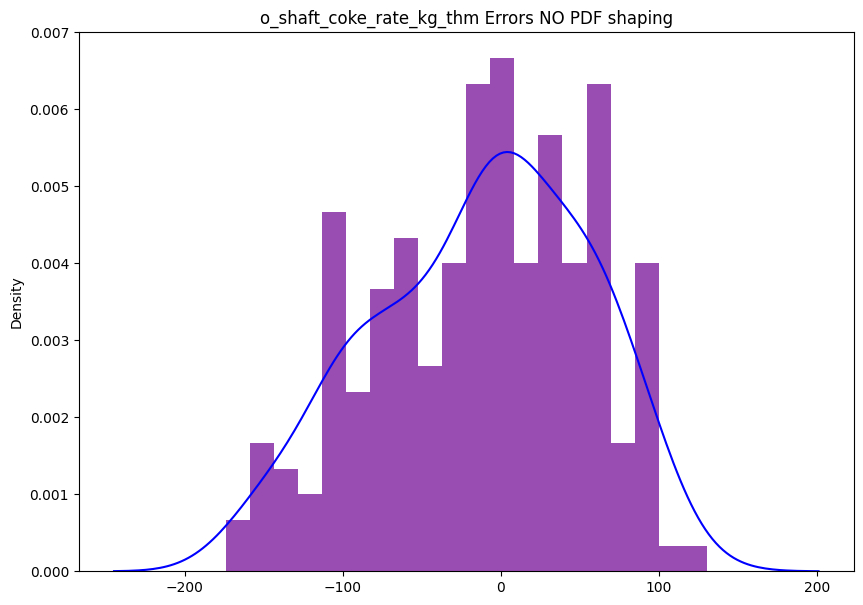

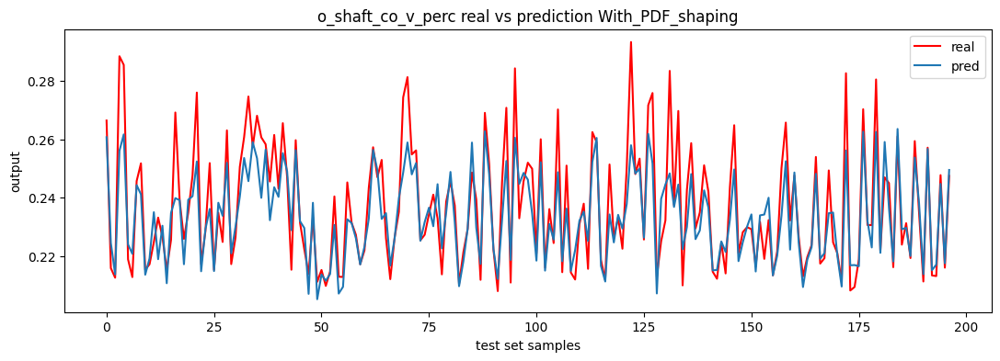

/Users/user/Desktop/DOE_CIVS/experiments/2023april/PDFshapingUtils.py:347: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(error, bins=n_bins, color="blue")


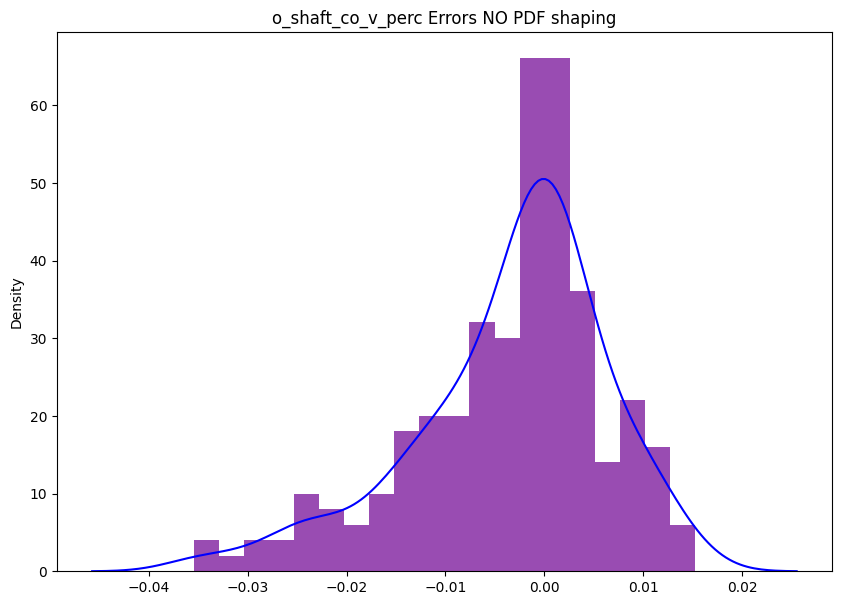

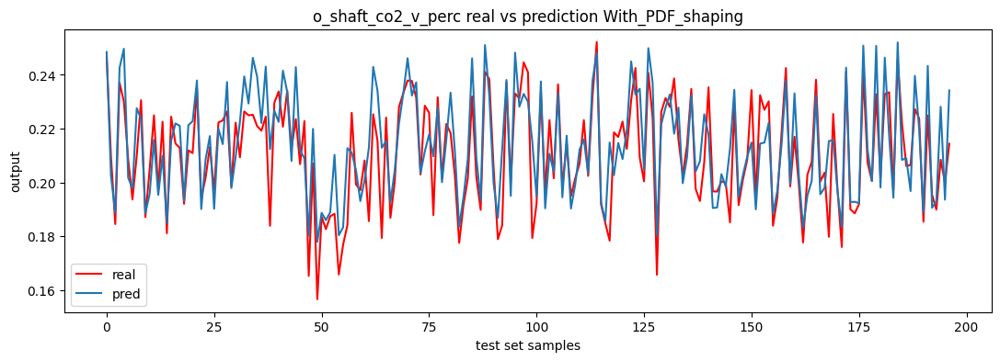

/Users/user/Desktop/DOE_CIVS/experiments/2023april/PDFshapingUtils.py:347: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(error, bins=n_bins, color="blue")


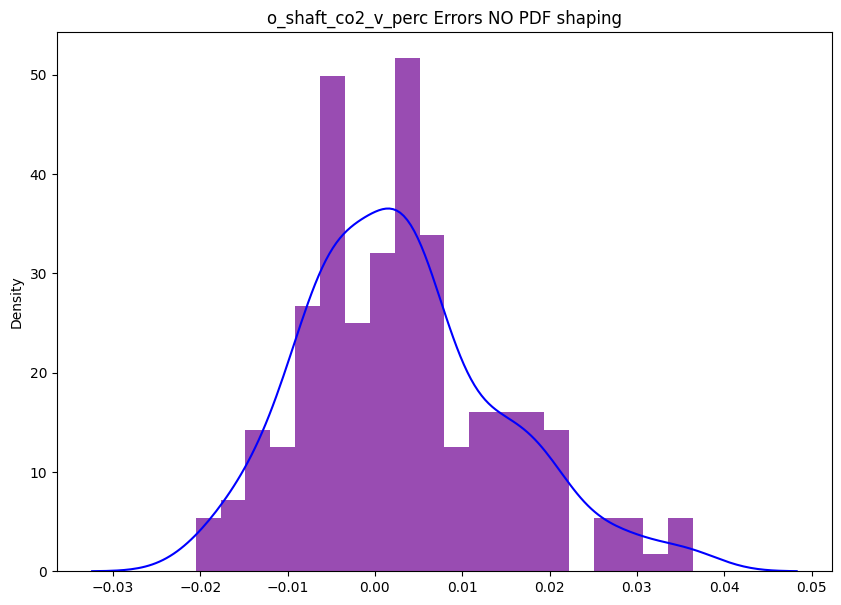

In [29]:
PDFshapingOBJ.plot_preds_vs_reals( list_preds, list_reals )

## Export ONNX model

In [ ]:
'''

model.eval()

dummy_input = torch.randn(1, 6)


input_names = ["input1"]
output_names = ["output1", "output2"]

torch.onnx.export(
  model, 
  dummy_input, 
  "ONNXmodels/s536ShaftPDFshapingRC.onnx", 
  verbose=False, 
  input_names  = input_names,
  output_names = output_names
)

'''